In [ ]:
import librosa
import librosa.display
import numpy as np
import librosa.display     # librosa's display module (for plotting features)
import IPython.display     # IPython's display module (for in-line audio)
import matplotlib.pyplot as plt # matplotlib plotting functions
import matplotlib.style as ms 
from numpy import diff
from scipy import interpolate
import math
import pandas as pd
from scipy.io.wavfile import read

In [ ]:
from IPython.display import Audio
def playHard(data):
    return Audio(data, rate = sr)
def play(data, soft = .1):
    t = np.concatenate([data, [1]])
    length = round(soft * sr)
    t[:length ] = np.multiply(t[:length ], np.linspace(0, 1, length))
    t[-length:] = np.multiply(t[-length:], np.linspace(1, 0, length))
    return playHard(t)

In [ ]:
targ_intv = [[0.1, 0.5], [0.3, 0.7], [0.7, 1.0], [1, 1.5]]


path = '/Users/yutianqin/Downloads/SchoolWork/Piano/recordings/'
dur = [0.1, 0.3, 0.7, 1]
vel = list(range(1,127,8))+[127]
sr = 48000

# Fixed Version 3

In [1]:
def time_vs_eng(wave, duration, p, d, v, e):
    name = e + '-pitch-'+str(p)+'vel-'+str(v)+'dur-'+str(d)

    C = np.abs(librosa.stft(wave, n_fft=16384, hop_length=256))
    freqs = librosa.fft_frequencies(48000, 16384)
    D_weighted = librosa.perceptual_weighting(C ** 2, freqs, ref=0.00002)
    D_weighted[D_weighted < 25] = 0

    librosa.display.specshow(D_weighted, y_axis='log', x_axis='time', sr=48000,
                             hop_length=256)
    plt.axvline(x=duration, color='g')
    plt.axvline(x=human_ear[d], color='b')
    plt.title('spectrogram--' + name)
    plt.colorbar(format='%+2.0f dB')
    # plt.savefig("./" +'Weighted_spec-' + name + ".png")
    plt.show()

    ENG = []
    for i in range(len(D_weighted[0])):
        E = D_weighted[:, i:(i + 1)]
        erg = np.sum(E)
        ENG.append(erg)

    print('ENG here: ', ENG[int(duration/1.5*282)])


    plt.plot(ENG)
    plt.axvline(x=duration/1.5*282 , color='r', alpha=0.3)
    plt.title('Weighted-amp-' + name)
    # plt.savefig("./" + 'MWeighted-amp-' + name + ".png")
    plt.show()


def plotting(wave, duration, p, d, v, e):
    D = librosa.stft(wave, n_fft=16384, hop_length=256)

    name = e + '-pitch-'+str(p)+'vel-'+str(v)+'dur-'+str(d)

    # librosa.display.specshow(librosa.amplitude_to_db(np.abs(D), ref=np.max), y_axis='log', x_axis='time', sr=48000, hop_length=256)
    # plt.axvline(x=duration , color='g')
    # plt.title('spectrogram--' + name)
    # plt.colorbar(format='%+2.0f dB')
    # # plt.savefig("./" +'MAX_spec-' + name + ".png")
    # plt.show()

    print('##### duration = ', duration, '#####')
    #     time = np.linspace(0, 1.5, len(wave))
    plt.plot(wave)
    plt.axvline(x=duration * 48000, color='r', alpha=0.3)
    plt.title('wave--' + name)
    # plt.savefig("./" + 'Wave-' + name + ".png")
    plt.show()



def loading(pitch, vel_level, dur_level, notetype):

    name = 'dictwave_' + notetype + '_pitch-' + str(pitch) + '_vel-' + str(vel[vel_level]) + \
           '_dur-' + str(dur[dur_level]) + '_idx-' + str(dur_level + 4 * vel_level + 4 * len(vel) * (pitch - 21))

    wave, sr = librosa.load(path + name + '.wav', sr=48000)

    return wave


##Onset
def findT0(wave, hop_len=256):
    # def findT0(wave, hop_len=512):
    # # maoran's method
    # energy = np.array(wave ** 2)
    # onset = np.where(energy == max(energy[:5000]))[0][0]  # maximun energy Paseval's Theorem

    # # roger's method
    W = {}

    for j in range(0, 42):
        W[j] = []
        for i in range(0, 1050):
            W[j].append(wave[i + 1050 * j])

    rms_all = []

    for j in range(0, 42):
        w_power = np.array(np.array(W[j]) ** 2)
        rms = np.sqrt(np.sum(w_power) / 1050)
        rms_all.append(rms)

    rms_all = np.array(rms_all)
    onset = np.where(rms_all == np.max(rms_all))[0][0] * 1050

    # plt.plot(wave)
    # plt.axvline(x=onset, c='r', alpha=0.5)
    # plt.show()

    t0 = librosa.samples_to_frames(onset, hop_length=hop_len)
    # t0 = 5

    t0 = t0 / (sr / hop_len)

    return t0


def get_D_matrices(wave, ref_value=1e-3):
    D = librosa.stft(wave, n_fft=16384, hop_length=256)  # set n_fft = 16384,
    Ddb = librosa.amplitude_to_db(np.abs(D), ref=ref_value)

    return D, Ddb


# midi pitch
def calc_overtone_index(p, bin_width):
    pitch = p - 20
    fund_freq = (2 ** ((pitch - 49) / (12))) * 440
    max_freq = (2 ** ((88 - 49) / (12))) * 440
    overtone = [fund_freq]
    i = 2
    while (fund_freq * i < max_freq):
        overtone.append(fund_freq * i)
        i += 1

    indices = []
    for f in overtone:
        if round(f / bin_width) < 8193:  # len(D) = 8193
            indices.append(round(f / bin_width))

    print('calc_overtone_index', overtone, indices)

    return overtone, indices

def polt_Aweighting(wave, duration, p, d, v, e):
    # D_origin = get_D_matrices(wave)[1]  # dB
    #
    # D_weighted = librosa.A_weighting(D_origin, -75.75632)

    C = np.abs(librosa.stft(wave, n_fft=16384, hop_length=256))
    freqs = librosa.fft_frequencies(48000, 16384)
    D_weighted = librosa.perceptual_weighting(C ** 2, freqs, ref = 0.00002)
    D_weighted[D_weighted < 25] = 0
    name = e + '-pitch-' + str(p) + 'vel-' + str(v) + 'dur-' + str(d)

    librosa.display.specshow(D_weighted, y_axis='log', x_axis='time', sr=48000, hop_length=256)
    plt.axvline(x=duration, color='g')
    plt.title('A_spectrogram--' + name)
    plt.colorbar(format='%+2.0f dB')
    # plt.savefig("./" +'MAX_spec-' + name + ".png")
    plt.show()

def plot_compare_curve(p, wave, no):
    D_origin = get_D_matrices(wave)[1]  # dB
    C = np.abs(librosa.stft(wave, n_fft=16384, hop_length=256))
    freqs = librosa.fft_frequencies(48000, 16384)
    D_weighted = librosa.perceptual_weighting(C ** 2, freqs, ref=0.00002)
    D_weighted[D_weighted < 25] = 0
    overtone, indices = calc_overtone_index(p, 48000 / 16384)

    #     print('plot_compare_curve', [len(D_origin[indices[i]]) for i in range(no)])

    return [D_weighted[indices[i]] for i in range(no)]

def find_d_and_weight(curve, low_b, up_b, onset=0.2, index = 2):
    dx = 1.5 / 282
    deriv = diff(curve) / dx
    deriv = deriv[int(low_b / dx): int(up_b / dx)]
    d = np.where(deriv == min(deriv))[0][0]
    D = low_b + dx * d
    D_index = int(low_b / dx) + d
    
    return max(low_b, D - onset), curve[D_index]

def compute_D(p, v, d, envir):
    wave = loading(p, v, d, envir)

    low_b, up_b = targ_intv[d][0], targ_intv[d][1]


    curves = plot_compare_curve(p, wave, 3)


    Ds, ws = [], []

    onset = findT0(wave)
    #     print('Onset = ', onset)

    for c in curves:
        D, w = find_d_and_weight(c, low_b, up_b, onset)
        Ds.append(D)
        ws.append(w)

    Duration = np.average(Ds, weights=ws)

    # Duration = min(Ds)

    # Duration = find_d_and_weight(curves, low_b, up_b, onset)

    time_vs_eng(wave, Duration, p, d, v, envir)
    plotting(wave, Duration, p, d, v, envir)
    # polt_Aweighting(wave, Duration, p, d, v, envir)
    return Duration




In [2]:
def main():

    for i in range(0, 4):
        compute_D(69, 8, i, 'audi')

In [ ]:
main()

In [ ]:


def compute_D(p, v, d, envir):
    wave = loading(p, v, d, envir)

    low_b, up_b = targ_intv[d][0], targ_intv[d][1]


    curves = plot_compare_curve(p, wave, 3)


    Ds, ws = [], []

    onset = findT0(wave)
    #     print('Onset = ', onset)

    for c in curves:
        D, w = find_d_and_weight(c, low_b, up_b, onset)
        Ds.append(D)
        ws.append(w)

    Duration = np.average(Ds, weights=ws)

    # Duration = min(Ds)

    # Duration = find_d_and_weight(curves, low_b, up_b, onset)

    time_vs_eng(wave, Duration, p, d, v, envir)
    plotting(wave, Duration, p, d, v, envir)
    # polt_Aweighting(wave, Duration, p, d, v, envir)
    return Duration

def main():

    for i in range(0, 4):
        compute_D(69, 8, i, 'audi')


    # for j in range(0, 17):
    #     compute_D(69, j, 2, 'audi')

    # for k in range(61, 89):
    #     compute_D(k, 10, 2, 'audi')
    #

if __name__ == "__main__":
    main()

# ------------------------------------------------------

In [1]:
import librosa
import librosa.display
import numpy as np
import librosa.display     # librosa's display module (for plotting features)
import IPython.display     # IPython's display module (for in-line audio)
import matplotlib.pyplot as plt # matplotlib plotting functions
import matplotlib.style as ms 
from numpy import diff
from scipy import interpolate
import math
import pandas as pd
from scipy.io.wavfile import read

In [2]:
from IPython.display import Audio
def playHard(data):
    return Audio(data, rate = sr)
def play(data, soft = .1):
    t = np.concatenate([data, [1]])
    length = round(soft * sr)
    t[:length ] = np.multiply(t[:length ], np.linspace(0, 1, length))
    t[-length:] = np.multiply(t[-length:], np.linspace(1, 0, length))
    return playHard(t)

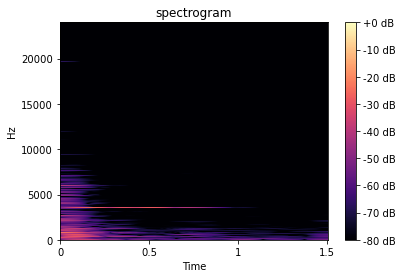

In [27]:


targ_intv = [[0.1, 0.5], [0.3, 0.7], [0.7, 1.0], [1, 1.5]]


path = '/Users/yutianqin/Downloads/SchoolWork/Piano/recordings/'
dur = [0.1, 0.3, 0.7, 1]
vel = list(range(1,127,8))+[127]
sr = 48000



name = 'dictwave_audi_pitch-69_vel-81_dur-0.7_idx-3306'
    
    
wave, sr = librosa.load(path + name + '.wav', sr = 48000)
D = librosa.stft(wave, n_fft = 16384, hop_length = 256)
    
librosa.display.specshow(librosa.amplitude_to_db(np.abs(D), ref=np.max), x_axis='time', y_axis='log', sr=48000, hop_length=256)
plt.title('spectrogram')
plt.colorbar(format='%+2.0f dB')
plt.show()

# P

In [3]:
targ_intv = [[0.1, 0.5], [0.3, 0.7], [0.7, 1.0], [1, 1.5]]


path = '/Users/yutianqin/Downloads/SchoolWork/Piano/recordings/'
dur = [0.1, 0.3, 0.7, 1]
vel = list(range(1,127,8))+[127]
sr = 48000

In [5]:
notetype = 'audi'
pitch = 69
vel_level = 10
dur_level = 2


name = 'dictwave_' + notetype + '_pitch-' + str(pitch) + '_vel-' + str(vel[vel_level]) +\
'_dur-' + str(dur[dur_level]) + '_idx-' + str(dur_level + 4 * vel_level + 4 * len(vel) * (pitch - 21))

wave, sr = librosa.load(path + name + '.wav', sr = 48000)

D = librosa.stft(wave, n_fft = 16384, hop_length = 256) # set n_fft = 16384, 
Ddb = librosa.amplitude_to_db(np.abs(D), ref = 0.00002)

print(D.shape)

(8193, 282)


/Users/yutianqin/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


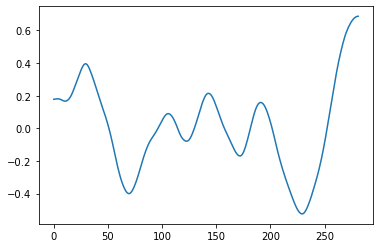

In [13]:
ENG = []
for i in range(len(Ddb[0])):
    E = Ddb[:, i:(i+1)]
    erg = np.sum(E)
    ENG.append(erg)
plt.plot(ENG)
        

In [5]:
def plotting(wave, duration):
    
    D = librosa.stft(wave, n_fft = 16384, hop_length = 256)
    
    librosa.display.specshow(librosa.amplitude_to_db(np.abs(D), ref=np.max), y_axis='log', x_axis='time', sr=48000, hop_length=256)
    
    plt.title('spectrogram')
    plt.colorbar(format='%+2.0f dB')
    plt.show()
    
    
    print('##### duration = ', duration, '#####')
#     time = np.linspace(0, 1.5, len(wave))
    plt.plot(wave)
    plt.axvline(x=duration*48000, color='r', alpha=0.3)
    plt.show()


In [6]:
def loading(pitch, vel_level, dur_level, notetype): 
#          if notetype == 'audi':
#         path = '/Users/yutianqin/Downloads/SchoolWork/Piano/new_npz/'
#     else:
#         path = '/Users/yutianqin/Downloads/SchoolWork/Piano/new_npz_lab/'
    name = 'dictwave_' + notetype + '_pitch-' + str(pitch) + '_vel-' + str(vel[vel_level]) +\
    '_dur-' + str(dur[dur_level]) + '_idx-' + str(dur_level + 4 * vel_level + 4 * len(vel) * (pitch - 21))
    
    wave, sr = librosa.load(path + name + '.wav', sr = 48000)
    
    return wave

In [7]:
##Onset
def findT0(wave, hop_len=256):
# def findT0(wave, hop_len=512):
    # # maoran's method
    # energy = np.array(wave ** 2)
    # onset = np.where(energy == max(energy[:5000]))[0][0]  # maximun energy Paseval's Theorem

    # # roger's method
    W = {}
    
    for j in range(0, 42):
        W[j] = []
        for i in range(0, 1050):
            W[j].append(wave[i + 1050 * j])

    rms_all = []
    
    for j in range(0, 42):
        w_power = np.array(np.array(W[j]) ** 2)
        rms = np.sqrt(np.sum(w_power) / 1050)
        rms_all.append(rms)

    rms_all = np.array(rms_all)
    onset = np.where(rms_all == np.max(rms_all))[0][0] * 1050

    # plt.plot(wave)
    # plt.axvline(x=onset, c='r', alpha=0.5)
    # plt.show()

    t0 = librosa.samples_to_frames(onset, hop_length=hop_len)
    # t0 = 5
    
    t0 = t0/(sr/hop_len)

    return t0

In [8]:
def get_D_matrices(wave, ref_value = 1e-3):
    
    D = librosa.stft(wave, n_fft = 16384, hop_length = 256) # set n_fft = 16384, 
    Ddb = librosa.amplitude_to_db(np.abs(D), ref = ref_value)
    
    
    return D, Ddb

In [9]:
# midi pitch
def calc_overtone_index(p, bin_width):
    pitch = p - 20
    fund_freq = (2 ** ((pitch - 49) / (12))) * 440
    max_freq = (2 ** ((88 - 49) / (12))) * 440
    overtone = [fund_freq]
    i = 2
    while (fund_freq * i < max_freq):
        overtone.append(fund_freq * i)
        i += 1

    indices = []
    for f in overtone:
        if round(f / bin_width) < 8193: # len(D) = 8193
            indices.append(round(f / bin_width))
            
    print('calc_overtone_index', overtone, indices)
    
    return overtone, indices

In [10]:
def plot_compare_curve(p, wave, no):
    D_origin = get_D_matrices(wave)[1] #dB
    D_weighted = librosa.A_weighting(D_origin, 75.75632)
    overtone, indices = calc_overtone_index(p, 48000 /16384)
    
#     print('plot_compare_curve', [len(D_origin[indices[i]]) for i in range(no)])
    
    return [D_origin[indices[i]] for i in range(no)]

In [11]:
def find_d_and_weight(curve, low_b, up_b, onset = 0.2):
    dx = 1.5 / 282
    deriv = diff(curve) / dx
    deriv = deriv[int(low_b / dx) : int(up_b / dx)]
    d = np.where(deriv == min(deriv))[0][0]
    D = low_b + dx * d
    D_index = int(low_b / dx) + d
    
#     plt.plot(curve)
#     plt.axvline(x=D_index, color='r', alpha=0.3)
#     plt.show()
    
#     plt.plot(diff(curve) / dx, c = 'r', alpha = 0.7)
#     plt.axvline(x=int(low_b / dx), color='g', alpha=0.3)
#     plt.axvline(x=int(up_b / dx), color='g', alpha=0.3)
#     plt.axvline(x=D_index, color='r', alpha=0.3)
#     plt.show()
    
    
#     print('D = ', D, 'D_index = ', D_index)
#     print('max', max(low_b, D - onset), ' Cueve[D_index]', curve[D_index])
    
    
    return max(low_b, D - onset), curve[D_index]

In [12]:
def compute_D(p, v, d, envir):
    
    wave = loading(p, v, d, envir)
    
    low_b, up_b = targ_intv[d][0], targ_intv[d][1]
    
    if p <= 88:
        curves = plot_compare_curve(p, wave, 3)
    else: 
        print('p>=88')  #start from: 
        return 1.2 #Why 1.2 here???
    
    
    Ds, ws = [], []
    
    onset = findT0(wave)
#     print('Onset = ', onset)
    
    for c in curves:
        D, w = find_d_and_weight(c, low_b, up_b, onset)
        Ds.append(D)
        ws.append(w)
        
    Duration = np.average(Ds, weights = ws)
    
#     plotting(wave, Duration)
    return Duration

In [13]:
def compute_D_II(p, v, d, envir):
    
    wave = loading(p, v, d, envir)
    
    low_b, up_b = targ_intv[d][0], targ_intv[d][1]
    
#     if p <= 88:
#         curves = plot_compare_curve(p, wave, 12)
#     else: 
#         print('p>=88')  #start from: 
#         return 1.2  
    curves = plot_compare_curve(p, wave, 8)
    
    Ds, ws = [], []
    
    onset = findT0(wave)
    print('Onset = ', onset)
    
    for c in curves:
        D, w = find_d_and_weight(c, low_b, up_b, onset)
        Ds.append(D)
        ws.append(w)
        
    Duration = max(Ds)
    
    plotting(wave, Duration)
    return Duration

In [14]:
def compute_delay(notetype):
    delay_list = []
    for p in range(21, 109):
        for v in range(17):
            for d in range(4):
                delay = compute_D(p, v, d, notetype)
                delay_list.append(delay)
    
    return delay_list

In [15]:
D = compute_D(69, 10, 3, 'lab')
print('Duration', D)

calc_overtone_index [440.0, 880.0, 1320.0, 1760.0, 2200.0, 2640.0, 3080.0, 3520.0, 3960.0] [150, 300, 451, 601, 751, 901, 1051, 1201, 1352]
Duration 1.143420453878331


In [16]:
# Audi, A4, 1s
D = compute_D(69, 10, 3, 'audi')
print('Duration', D)

calc_overtone_index [440.0, 880.0, 1320.0, 1760.0, 2200.0, 2640.0, 3080.0, 3520.0, 3960.0] [150, 300, 451, 601, 751, 901, 1051, 1201, 1352]
Duration 1.2667712367557822


calc_overtone_index [440.0, 880.0, 1320.0, 1760.0, 2200.0, 2640.0, 3080.0, 3520.0, 3960.0] [150, 300, 451, 601, 751, 901, 1051, 1201, 1352]
Onset =  0.064


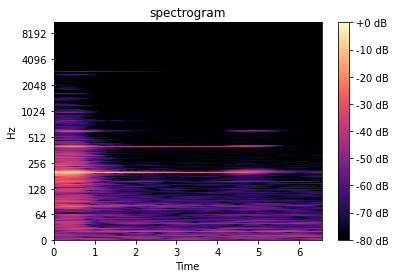

##### duration =  1.1700425531914893 #####


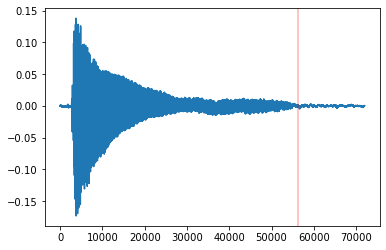

Duration 1.1700425531914893


In [17]:
# Lab, A4, 1s
D = compute_D_II(69, 10, 3, 'lab')
print('Duration', D)

calc_overtone_index [440.0, 880.0, 1320.0, 1760.0, 2200.0, 2640.0, 3080.0, 3520.0, 3960.0] [150, 300, 451, 601, 751, 901, 1051, 1201, 1352]
Onset =  0.064


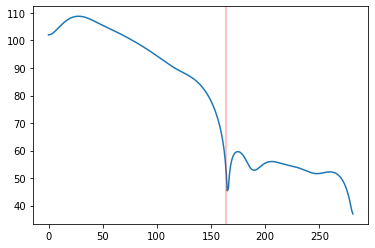

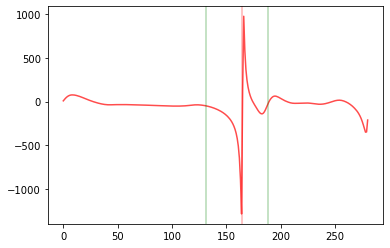

D =  0.8755319148936169 D_index =  164
max 0.8115319148936169  Cueve[D_index] 52.233505


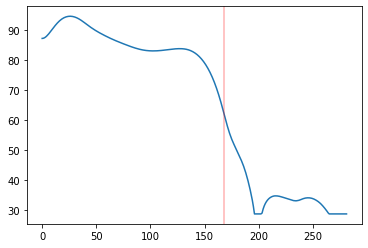

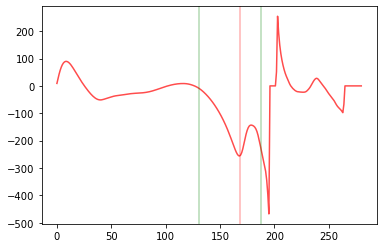

D =  0.8968085106382978 D_index =  168
max 0.8328085106382979  Cueve[D_index] 61.98601


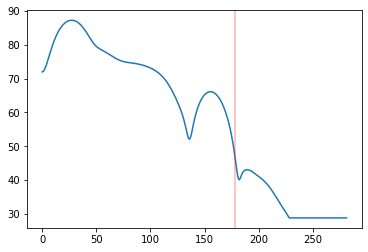

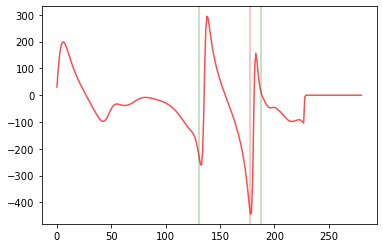

D =  0.95 D_index =  178
max 0.8859999999999999  Cueve[D_index] 46.938244


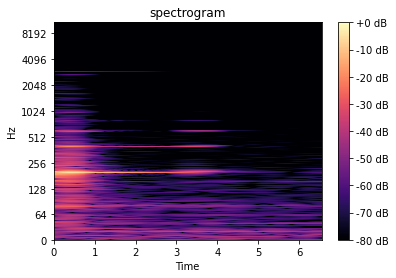

##### duration =  0.8414048321459416 #####


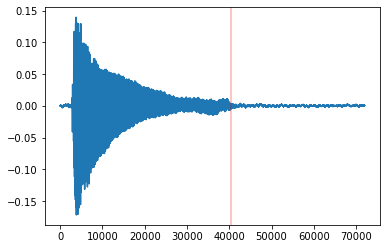

Duration 0.8414048321459416


In [23]:
# Lab, A4, 0.7s
D = compute_D(69, 10, 2, 'lab')
print('Duration', D)

calc_overtone_index [440.0, 880.0, 1320.0, 1760.0, 2200.0, 2640.0, 3080.0, 3520.0, 3960.0] [150, 300, 451, 601, 751, 901, 1051, 1201, 1352]
Onset =  0.064


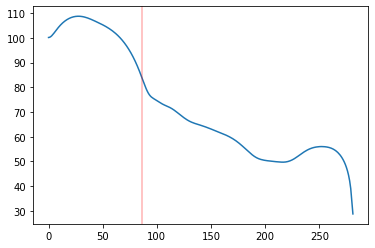

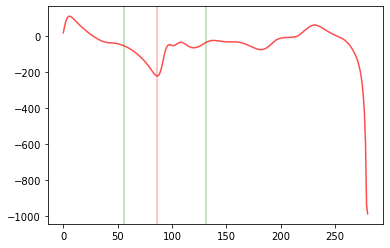

D =  0.4595744680851064 D_index =  86
max 0.3955744680851064  Cueve[D_index] 84.1546


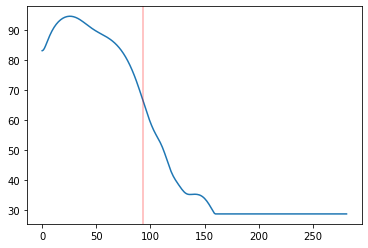

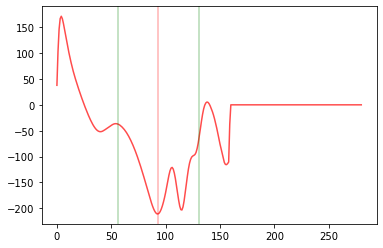

D =  0.4968085106382979 D_index =  93
max 0.4328085106382979  Cueve[D_index] 66.523964


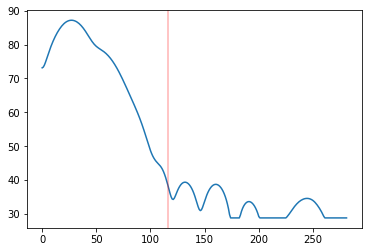

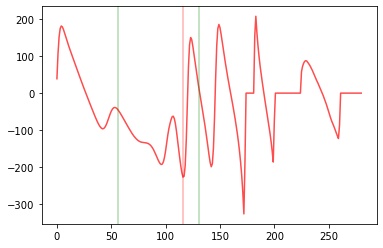

D =  0.6191489361702127 D_index =  116
max 0.5551489361702127  Cueve[D_index] 38.501114


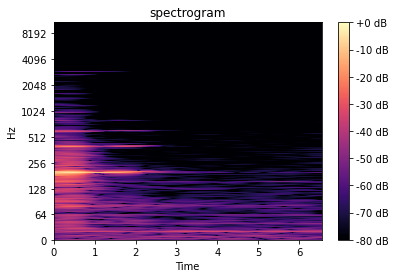

##### duration =  0.4411435845966854 #####


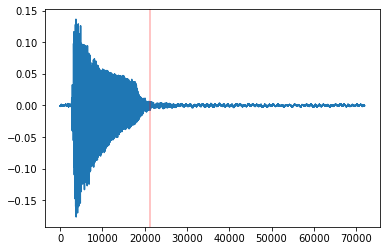

Duration 0.4411435845966854


In [24]:
# Lab, A4, 0.3s
D = compute_D(69, 10, 1, 'lab')
print('Duration', D)

calc_overtone_index [440.0, 880.0, 1320.0, 1760.0, 2200.0, 2640.0, 3080.0, 3520.0, 3960.0] [150, 300, 451, 601, 751, 901, 1051, 1201, 1352]
Onset =  0.064


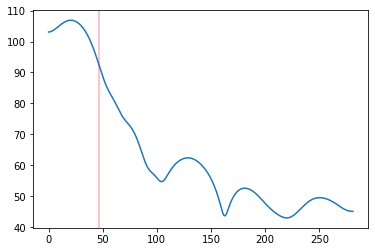

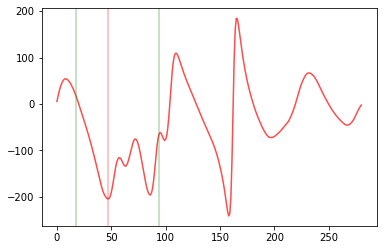

D =  0.2542553191489362 D_index =  47
max 0.19025531914893618  Cueve[D_index] 91.99002


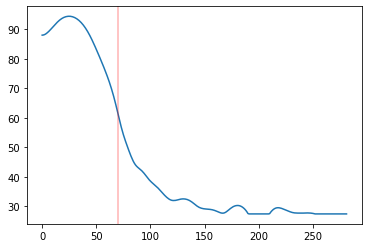

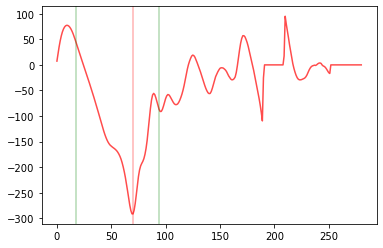

D =  0.3765957446808511 D_index =  70
max 0.3125957446808511  Cueve[D_index] 61.41865


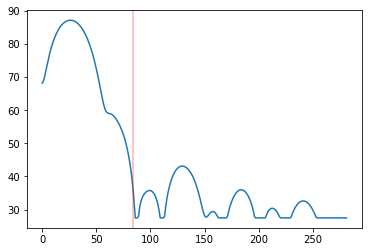

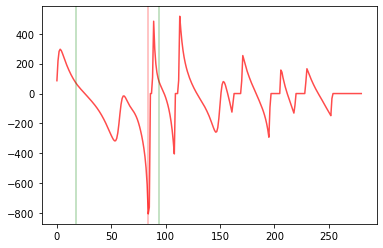

D =  0.451063829787234 D_index =  84
max 0.387063829787234  Cueve[D_index] 35.799522


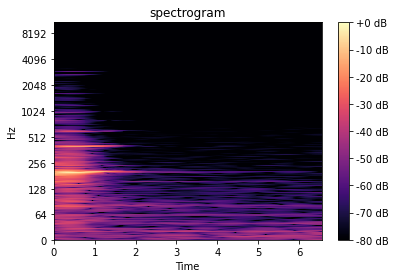

##### duration =  0.2672056577727542 #####


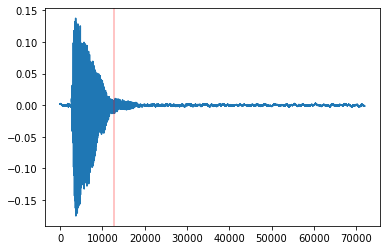

Duration 0.2672056577727542


In [25]:
# Lab, A4, 0.1s
D = compute_D(69, 10, 0, 'lab')
print('Duration', D)

calc_overtone_index [440.0, 880.0, 1320.0, 1760.0, 2200.0, 2640.0, 3080.0, 3520.0, 3960.0] [150, 300, 451, 601, 751, 901, 1051, 1201, 1352]
Onset =  0.064


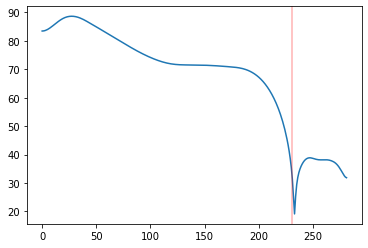

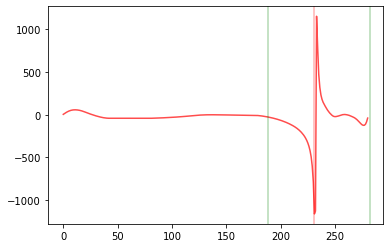

D =  1.2287234042553192 D_index =  231
max 1.1647234042553192  Cueve[D_index] 31.270182


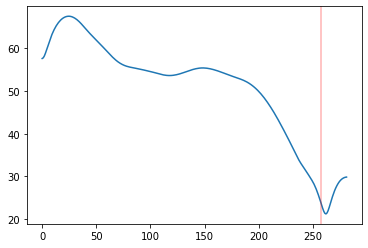

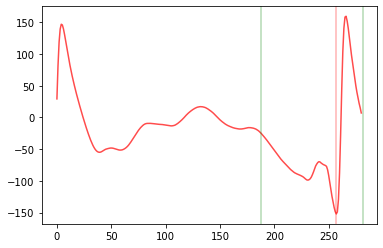

D =  1.3670212765957448 D_index =  257
max 1.3030212765957447  Cueve[D_index] 24.120926


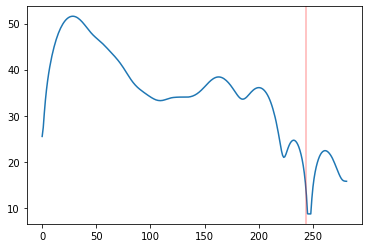

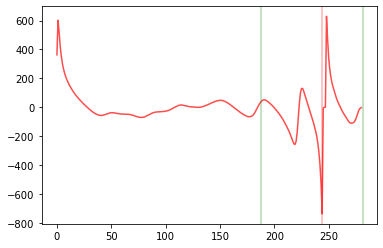

D =  1.297872340425532 D_index =  244
max 1.2338723404255318  Cueve[D_index] 12.618942


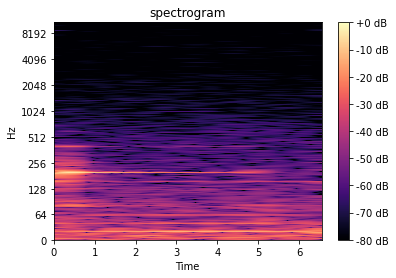

##### duration =  1.2266033642814569 #####


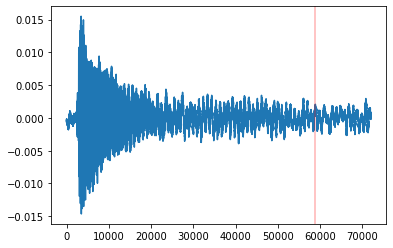

Duration 1.2266033642814569


In [26]:
# Lab, A4, velocity
D = compute_D(69, 0, 3, 'lab')
print('Duration', D)

calc_overtone_index [440.0, 880.0, 1320.0, 1760.0, 2200.0, 2640.0, 3080.0, 3520.0, 3960.0] [150, 300, 451, 601, 751, 901, 1051, 1201, 1352]
Onset =  0.064


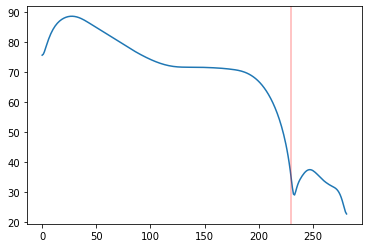

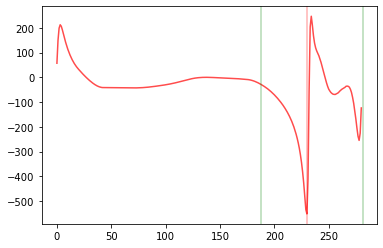

D =  1.2234042553191489 D_index =  230
max 1.1594042553191488  Cueve[D_index] 34.318687


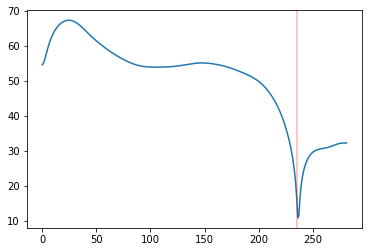

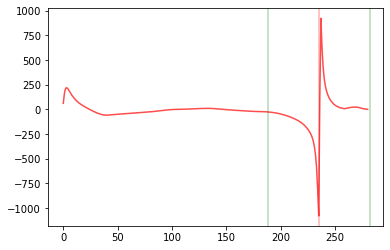

D =  1.25 D_index =  235
max 1.186  Cueve[D_index] 16.55888


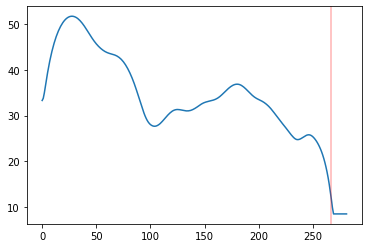

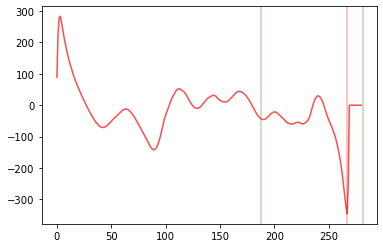

D =  1.4202127659574468 D_index =  267
max 1.3562127659574468  Cueve[D_index] 11.737015


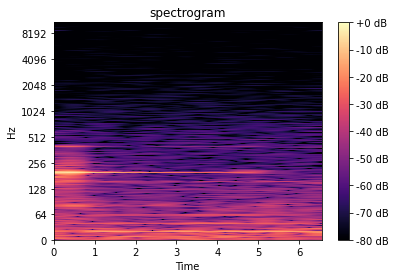

##### duration =  1.203329169396875 #####


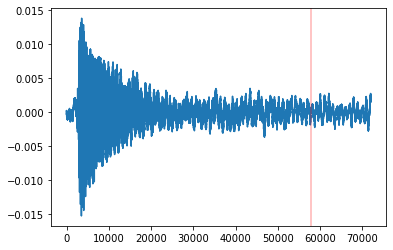

Duration 1.203329169396875


In [27]:
D = compute_D(69, 1, 3, 'lab')
print('Duration', D)

calc_overtone_index [440.0, 880.0, 1320.0, 1760.0, 2200.0, 2640.0, 3080.0, 3520.0, 3960.0] [150, 300, 451, 601, 751, 901, 1051, 1201, 1352]
Onset =  0.064


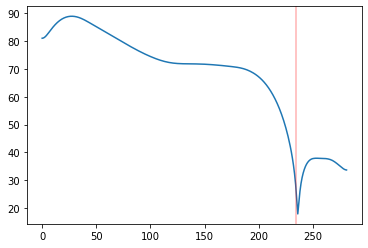

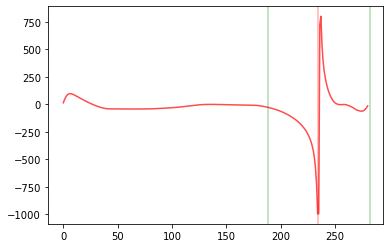

D =  1.2446808510638299 D_index =  234
max 1.1806808510638298  Cueve[D_index] 28.505516


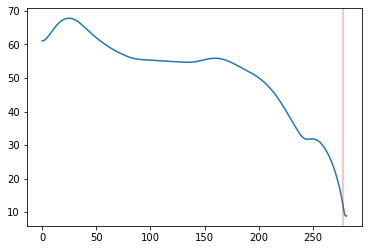

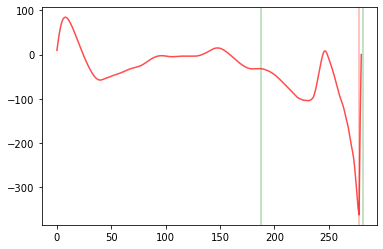

D =  1.478723404255319 D_index =  278
max 1.414723404255319  Cueve[D_index] 11.58131


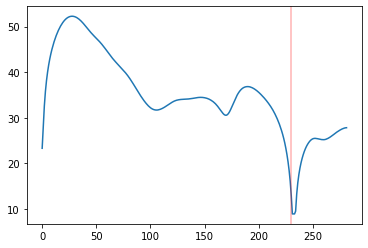

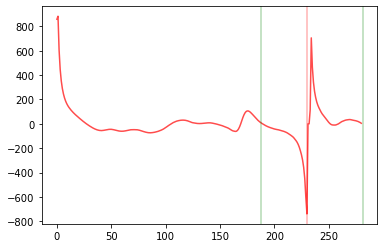

D =  1.2234042553191489 D_index =  230
max 1.1594042553191488  Cueve[D_index] 12.818649


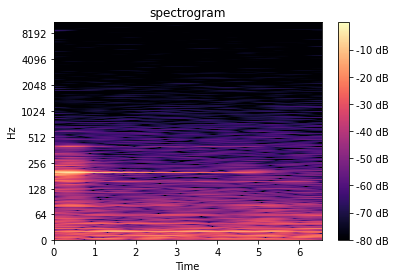

##### duration =  1.226758921018382 #####


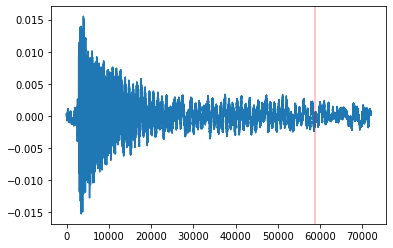

Duration 1.226758921018382


In [28]:
D = compute_D(69, 2, 3, 'lab')
print('Duration', D)

calc_overtone_index [440.0, 880.0, 1320.0, 1760.0, 2200.0, 2640.0, 3080.0, 3520.0, 3960.0] [150, 300, 451, 601, 751, 901, 1051, 1201, 1352]
Onset =  0.064


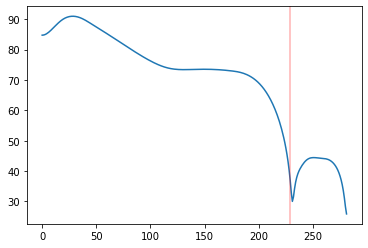

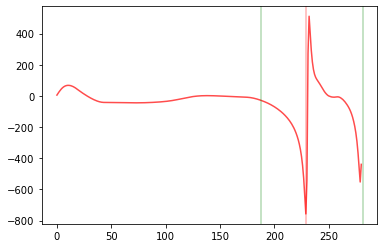

D =  1.2180851063829787 D_index =  229
max 1.1540851063829787  Cueve[D_index] 36.91868


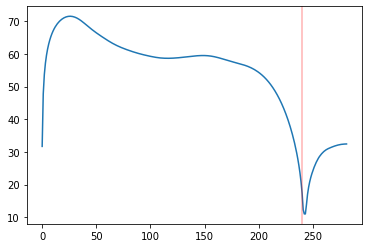

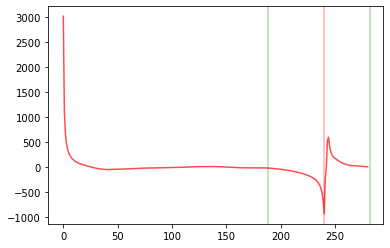

D =  1.2765957446808511 D_index =  240
max 1.212595744680851  Cueve[D_index] 17.30246


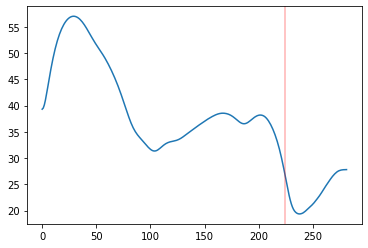

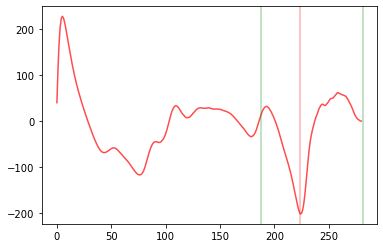

D =  1.1914893617021276 D_index =  224
max 1.1274893617021275  Cueve[D_index] 27.007862


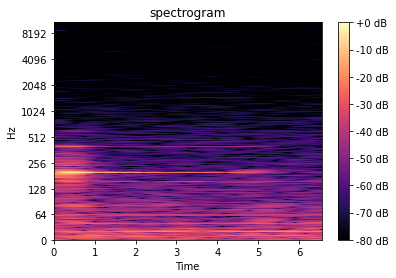

##### duration =  1.1577055345215987 #####


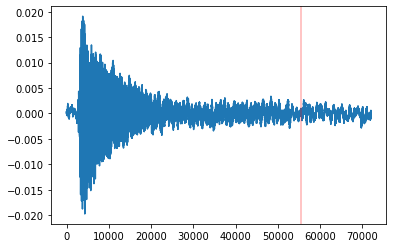

Duration 1.1577055345215987


In [29]:
D = compute_D(69, 3, 3, 'lab')
print('Duration', D)

calc_overtone_index [440.0, 880.0, 1320.0, 1760.0, 2200.0, 2640.0, 3080.0, 3520.0, 3960.0] [150, 300, 451, 601, 751, 901, 1051, 1201, 1352]
Onset =  0.064


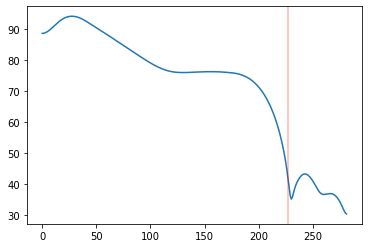

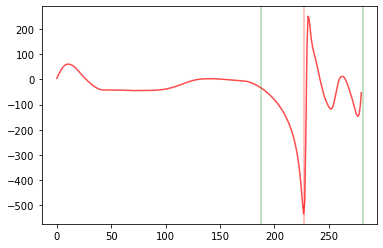

D =  1.2074468085106382 D_index =  227
max 1.1434468085106382  Cueve[D_index] 41.67192


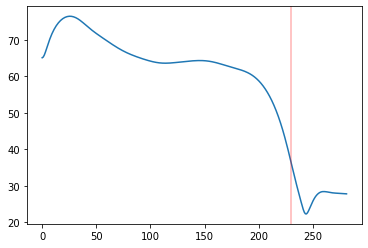

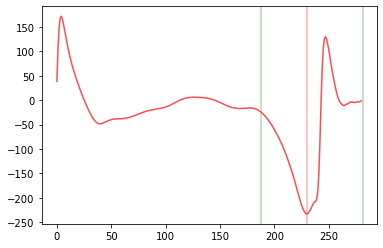

D =  1.2234042553191489 D_index =  230
max 1.1594042553191488  Cueve[D_index] 36.21373


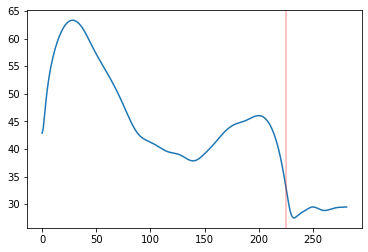

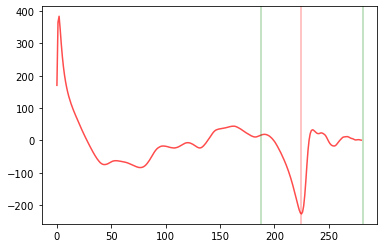

D =  1.196808510638298 D_index =  225
max 1.132808510638298  Cueve[D_index] 33.114647


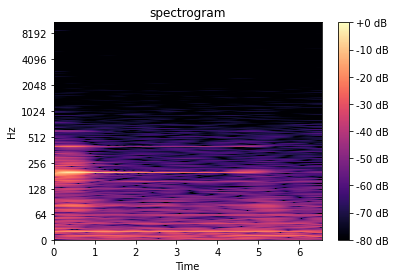

##### duration =  1.1454791921632648 #####


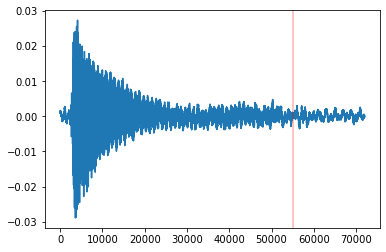

Duration 1.1454791921632648


In [30]:
D = compute_D(69, 4, 3, 'lab')
print('Duration', D)

calc_overtone_index [440.0, 880.0, 1320.0, 1760.0, 2200.0, 2640.0, 3080.0, 3520.0, 3960.0] [150, 300, 451, 601, 751, 901, 1051, 1201, 1352]
Onset =  0.064


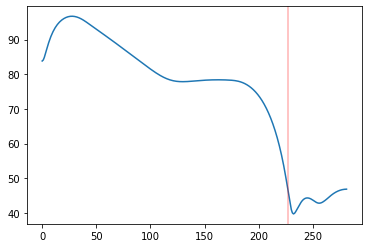

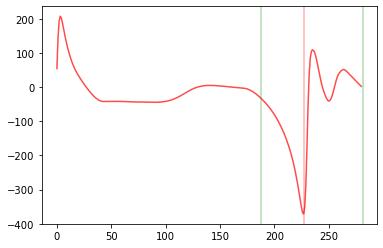

D =  1.2074468085106382 D_index =  227
max 1.1434468085106382  Cueve[D_index] 46.3721


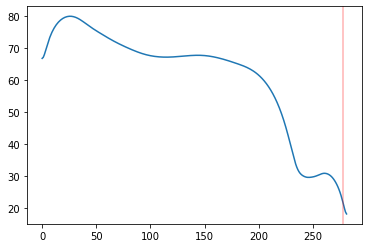

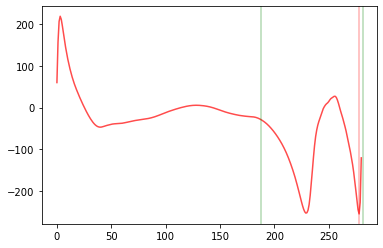

D =  1.478723404255319 D_index =  278
max 1.414723404255319  Cueve[D_index] 21.470066


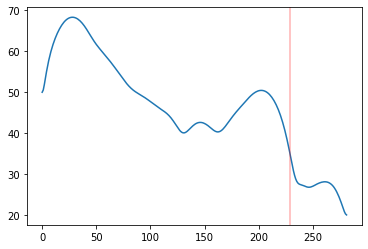

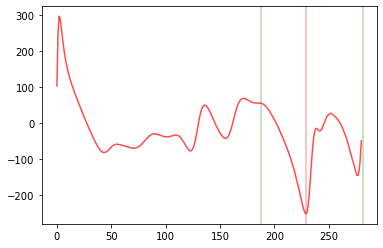

D =  1.2180851063829787 D_index =  229
max 1.1540851063829787  Cueve[D_index] 34.68351


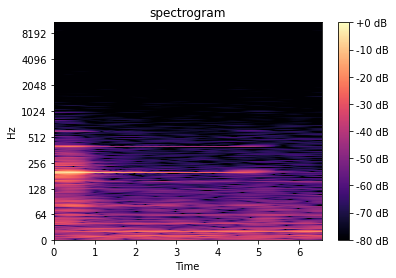

##### duration =  1.2038541146657744 #####


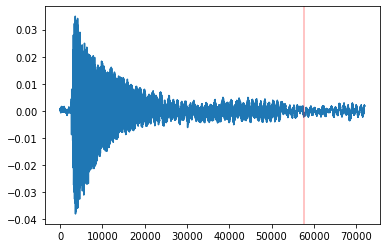

Duration 1.2038541146657744


In [31]:
D = compute_D(69, 5, 3, 'lab')
print('Duration', D)

calc_overtone_index [440.0, 880.0, 1320.0, 1760.0, 2200.0, 2640.0, 3080.0, 3520.0, 3960.0] [150, 300, 451, 601, 751, 901, 1051, 1201, 1352]
Onset =  0.064


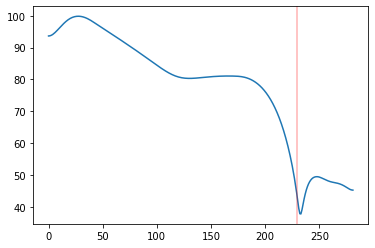

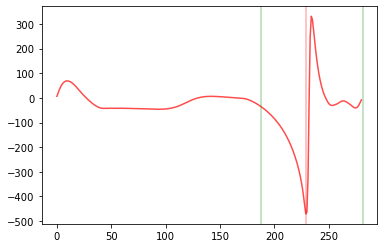

D =  1.2180851063829787 D_index =  229
max 1.1540851063829787  Cueve[D_index] 44.512257


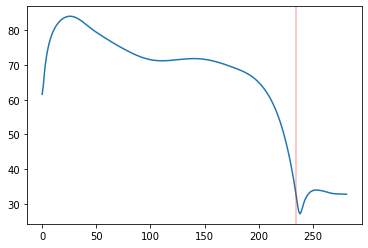

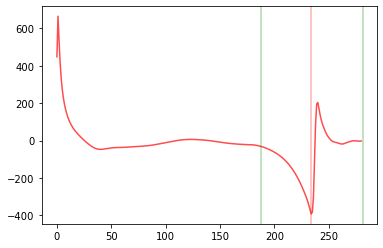

D =  1.2446808510638299 D_index =  234
max 1.1806808510638298  Cueve[D_index] 33.446312


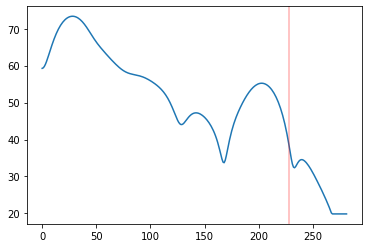

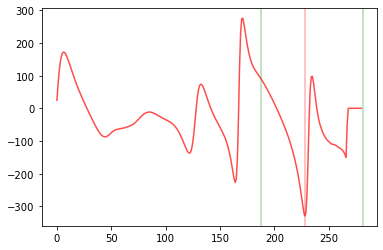

D =  1.2127659574468086 D_index =  228
max 1.1487659574468085  Cueve[D_index] 38.266716


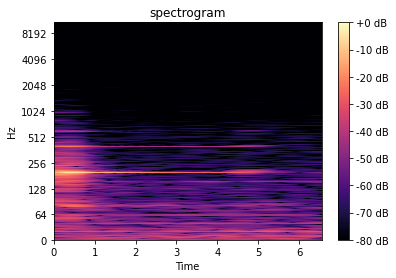

##### duration =  1.159987292072919 #####


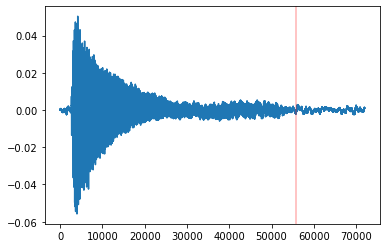

Duration 1.159987292072919


In [32]:
D = compute_D(69, 6, 3, 'lab')
print('Duration', D)

calc_overtone_index [440.0, 880.0, 1320.0, 1760.0, 2200.0, 2640.0, 3080.0, 3520.0, 3960.0] [150, 300, 451, 601, 751, 901, 1051, 1201, 1352]
Onset =  0.064


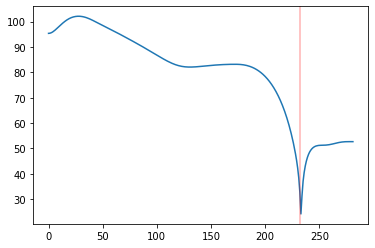

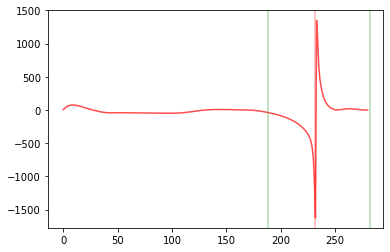

D =  1.2340425531914894 D_index =  232
max 1.1700425531914893  Cueve[D_index] 32.783928


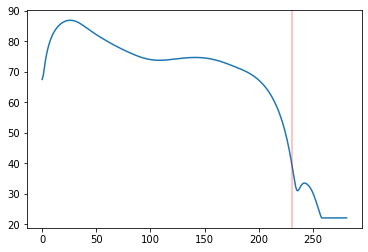

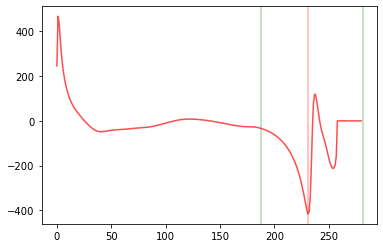

D =  1.2287234042553192 D_index =  231
max 1.1647234042553192  Cueve[D_index] 38.587402


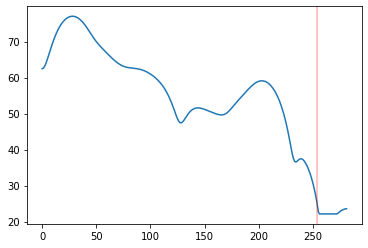

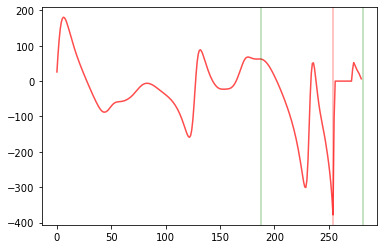

D =  1.351063829787234 D_index =  254
max 1.2870638297872339  Cueve[D_index] 24.703236


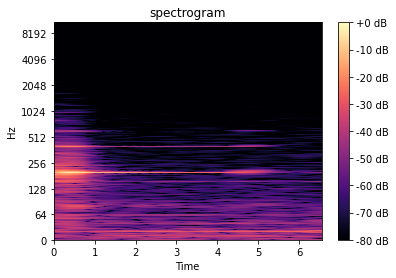

##### duration =  1.1979953417791114 #####


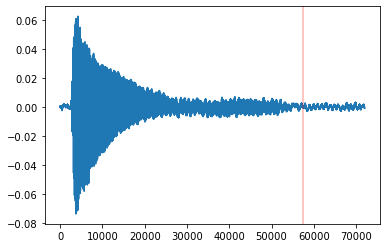

Duration 1.1979953417791114


In [33]:
D = compute_D(69, 7, 3, 'lab')
print('Duration', D)

calc_overtone_index [440.0, 880.0, 1320.0, 1760.0, 2200.0, 2640.0, 3080.0, 3520.0, 3960.0] [150, 300, 451, 601, 751, 901, 1051, 1201, 1352]
Onset =  0.064


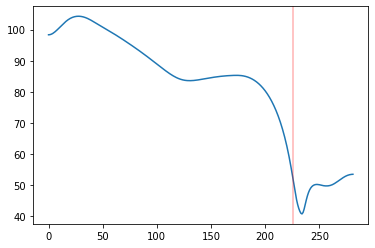

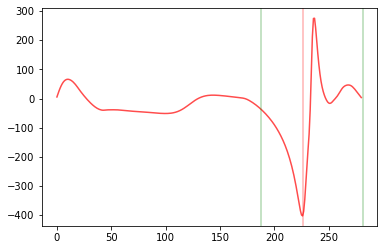

D =  1.202127659574468 D_index =  226
max 1.138127659574468  Cueve[D_index] 51.327286


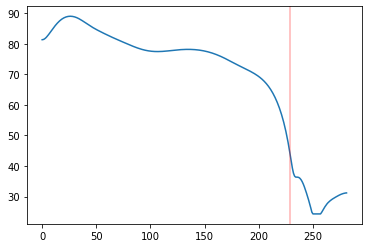

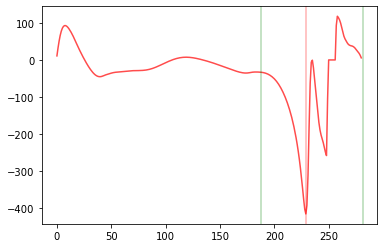

D =  1.2180851063829787 D_index =  229
max 1.1540851063829787  Cueve[D_index] 43.619522


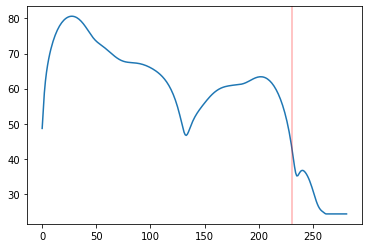

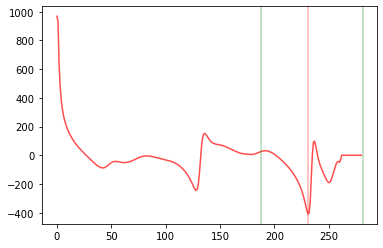

D =  1.2287234042553192 D_index =  231
max 1.1647234042553192  Cueve[D_index] 42.07602


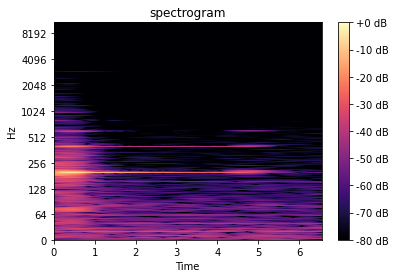

##### duration =  1.151374352169852 #####


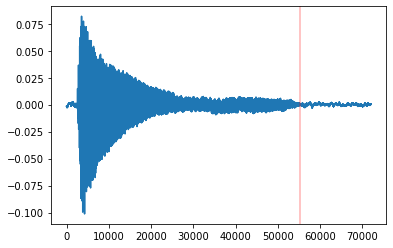

Duration 1.151374352169852


In [34]:
D = compute_D(69, 8, 3, 'lab')
print('Duration', D)

calc_overtone_index [440.0, 880.0, 1320.0, 1760.0, 2200.0, 2640.0, 3080.0, 3520.0, 3960.0] [150, 300, 451, 601, 751, 901, 1051, 1201, 1352]
Onset =  0.064


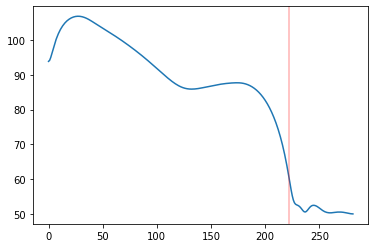

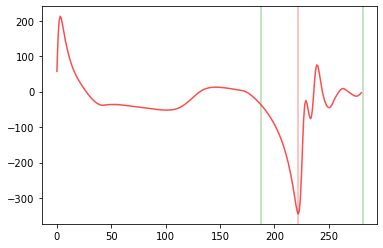

D =  1.1808510638297873 D_index =  222
max 1.1168510638297873  Cueve[D_index] 60.47046


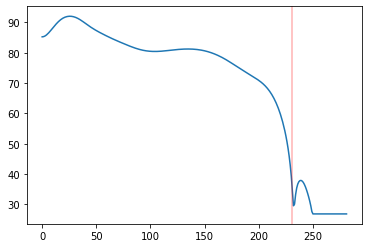

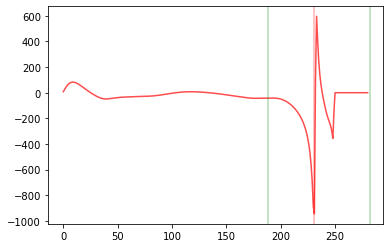

D =  1.2287234042553192 D_index =  231
max 1.1647234042553192  Cueve[D_index] 34.562027


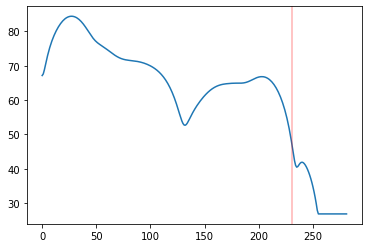

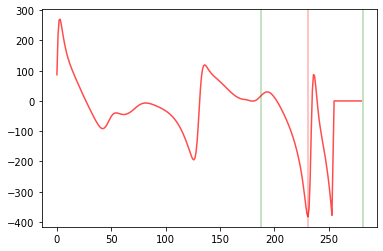

D =  1.2287234042553192 D_index =  231
max 1.1647234042553192  Cueve[D_index] 46.228374


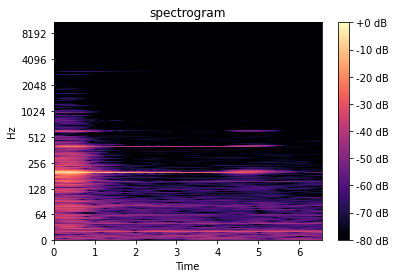

##### duration =  1.1442303788758377 #####


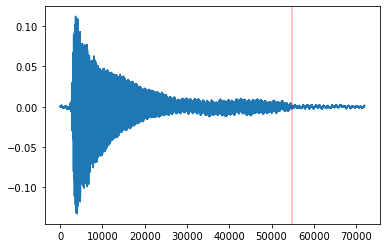

Duration 1.1442303788758377


In [35]:
D = compute_D(69, 9, 3, 'lab')
print('Duration', D)

calc_overtone_index [440.0, 880.0, 1320.0, 1760.0, 2200.0, 2640.0, 3080.0, 3520.0, 3960.0] [150, 300, 451, 601, 751, 901, 1051, 1201, 1352]
Onset =  0.064


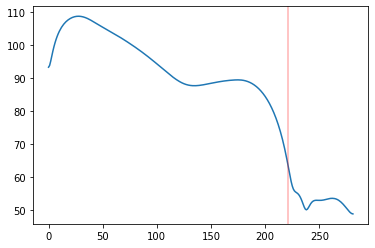

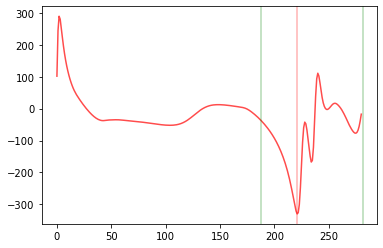

D =  1.175531914893617 D_index =  221
max 1.111531914893617  Cueve[D_index] 63.699226


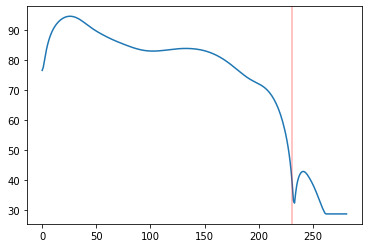

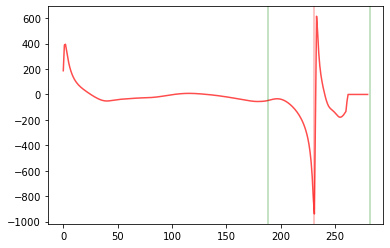

D =  1.2287234042553192 D_index =  231
max 1.1647234042553192  Cueve[D_index] 38.046074


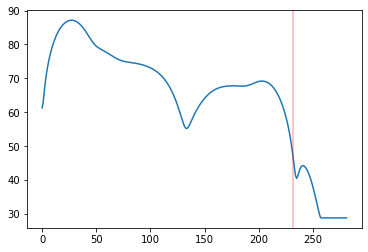

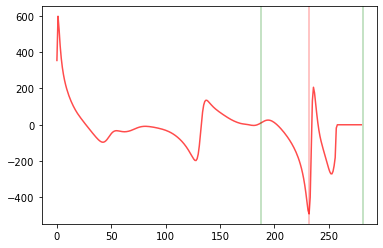

D =  1.2340425531914894 D_index =  232
max 1.1700425531914893  Cueve[D_index] 45.85595


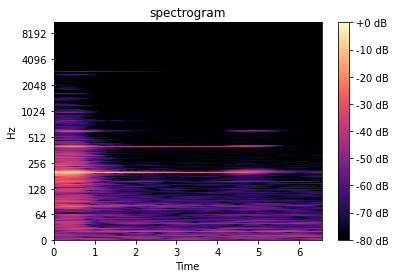

##### duration =  1.143420453878331 #####


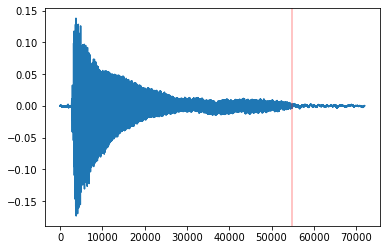

Duration 1.143420453878331


In [36]:
D = compute_D(69, 10, 3, 'lab')
print('Duration', D)

calc_overtone_index [440.0, 880.0, 1320.0, 1760.0, 2200.0, 2640.0, 3080.0, 3520.0, 3960.0] [150, 300, 451, 601, 751, 901, 1051, 1201, 1352]
Onset =  0.064


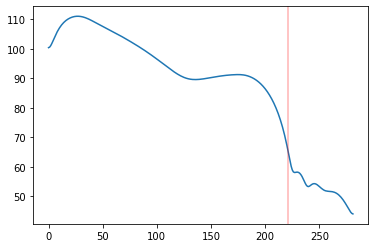

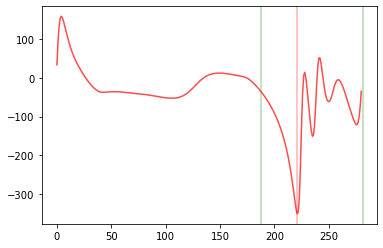

D =  1.175531914893617 D_index =  221
max 1.111531914893617  Cueve[D_index] 65.587845


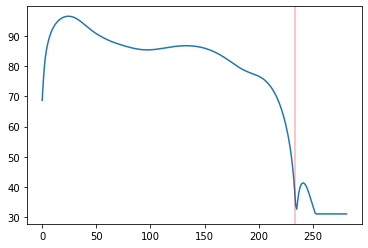

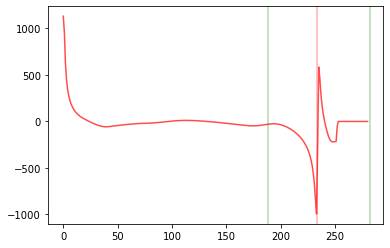

D =  1.2393617021276595 D_index =  233
max 1.1753617021276594  Cueve[D_index] 39.286766


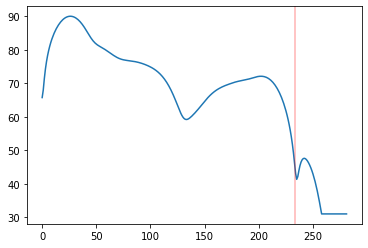

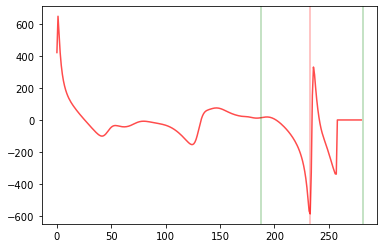

D =  1.2393617021276595 D_index =  233
max 1.1753617021276594  Cueve[D_index] 46.23018


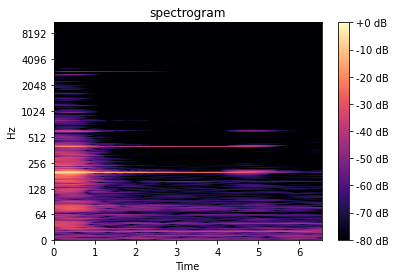

##### duration =  1.1476560404527352 #####


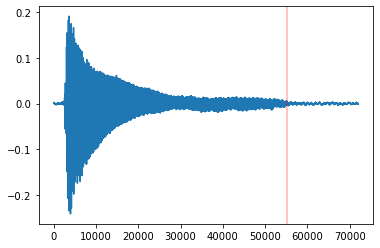

Duration 1.1476560404527352


In [37]:
D = compute_D(69, 11, 3, 'lab')
print('Duration', D)

calc_overtone_index [440.0, 880.0, 1320.0, 1760.0, 2200.0, 2640.0, 3080.0, 3520.0, 3960.0] [150, 300, 451, 601, 751, 901, 1051, 1201, 1352]
Onset =  0.064


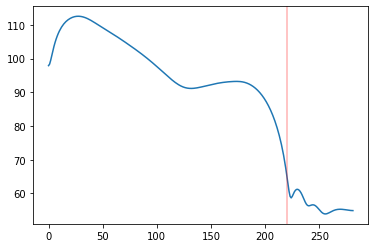

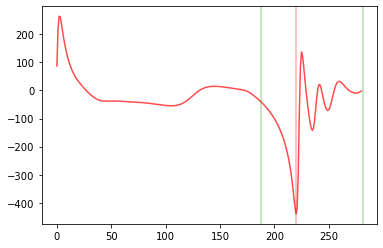

D =  1.1702127659574468 D_index =  220
max 1.1062127659574468  Cueve[D_index] 65.27024


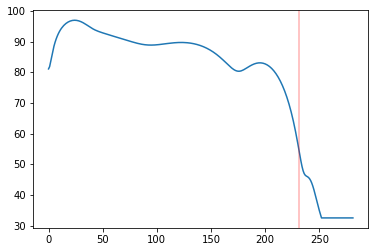

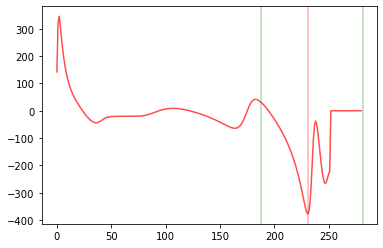

D =  1.2287234042553192 D_index =  231
max 1.1647234042553192  Cueve[D_index] 55.050247


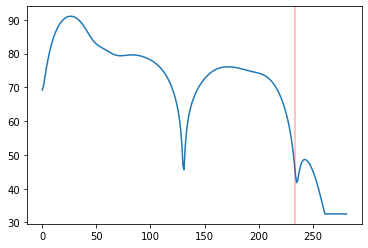

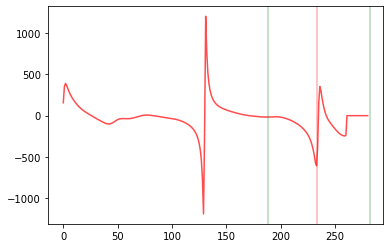

D =  1.2393617021276595 D_index =  233
max 1.1753617021276594  Cueve[D_index] 46.98259


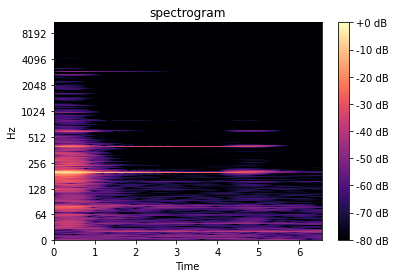

##### duration =  1.1448840282467512 #####


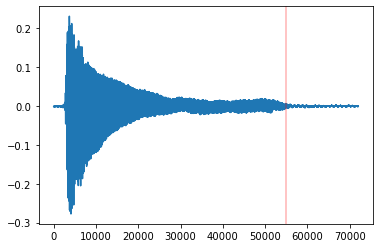

Duration 1.1448840282467512


In [38]:
D = compute_D(69, 12, 3, 'lab')
print('Duration', D)

calc_overtone_index [440.0, 880.0, 1320.0, 1760.0, 2200.0, 2640.0, 3080.0, 3520.0, 3960.0] [150, 300, 451, 601, 751, 901, 1051, 1201, 1352]
Onset =  0.064


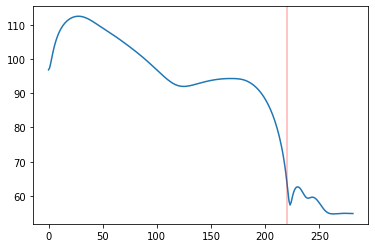

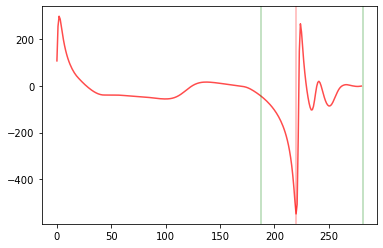

D =  1.1702127659574468 D_index =  220
max 1.1062127659574468  Cueve[D_index] 64.115555


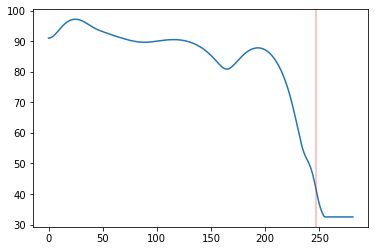

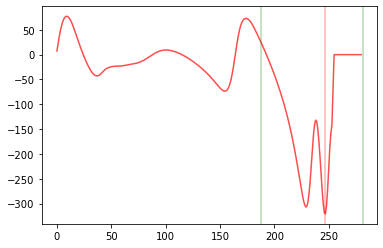

D =  1.3138297872340425 D_index =  247
max 1.2498297872340425  Cueve[D_index] 41.49048


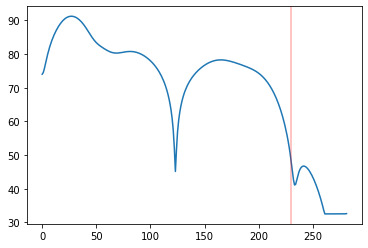

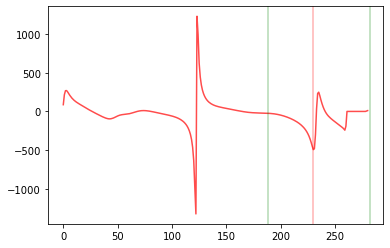

D =  1.2234042553191489 D_index =  230
max 1.1594042553191488  Cueve[D_index] 47.877487


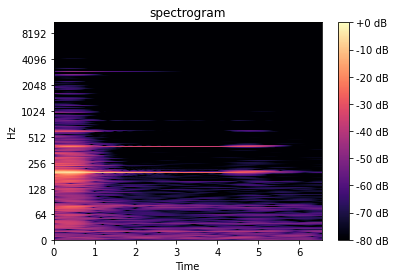

##### duration =  1.1616285770996007 #####


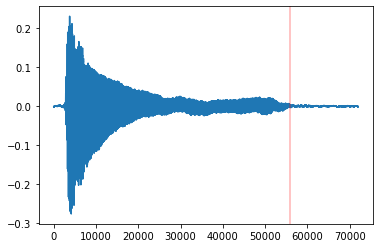

Duration 1.1616285770996007


In [39]:
D = compute_D(69, 13, 3, 'lab')
print('Duration', D)

calc_overtone_index [440.0, 880.0, 1320.0, 1760.0, 2200.0, 2640.0, 3080.0, 3520.0, 3960.0] [150, 300, 451, 601, 751, 901, 1051, 1201, 1352]
Onset =  0.064


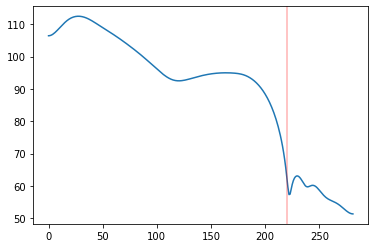

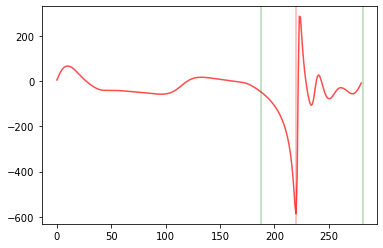

D =  1.1702127659574468 D_index =  220
max 1.1062127659574468  Cueve[D_index] 62.65187


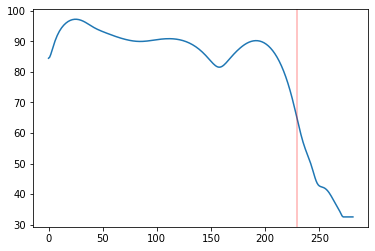

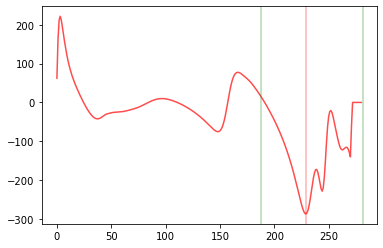

D =  1.2180851063829787 D_index =  229
max 1.1540851063829787  Cueve[D_index] 65.442566


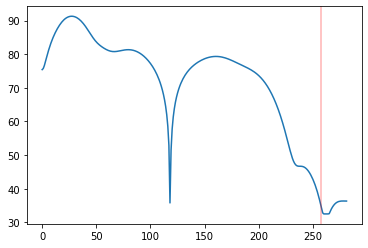

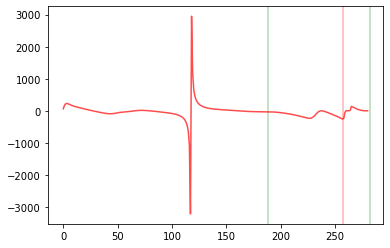

D =  1.3670212765957448 D_index =  257
max 1.3030212765957447  Cueve[D_index] 35.472023


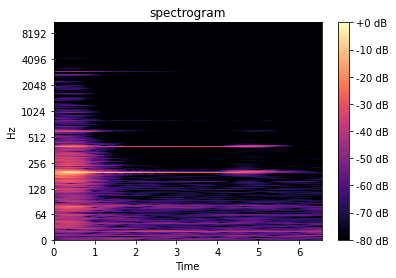

##### duration =  1.1680474772619935 #####


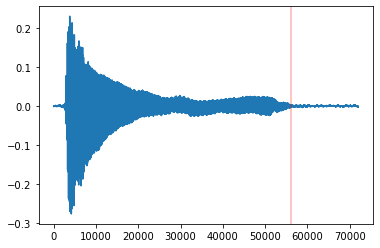

Duration 1.1680474772619935


In [40]:
D = compute_D(69, 14, 3, 'lab')
print('Duration', D)

calc_overtone_index [440.0, 880.0, 1320.0, 1760.0, 2200.0, 2640.0, 3080.0, 3520.0, 3960.0] [150, 300, 451, 601, 751, 901, 1051, 1201, 1352]
Onset =  0.064


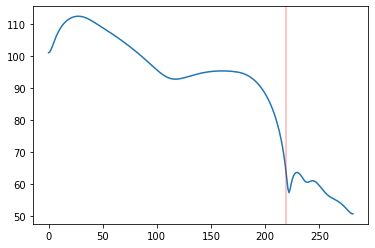

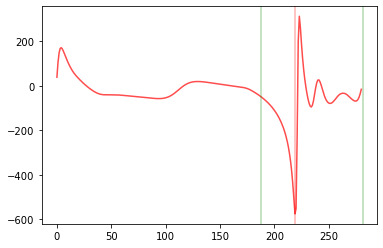

D =  1.1648936170212765 D_index =  219
max 1.1008936170212764  Cueve[D_index] 64.52352


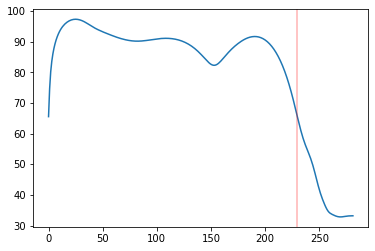

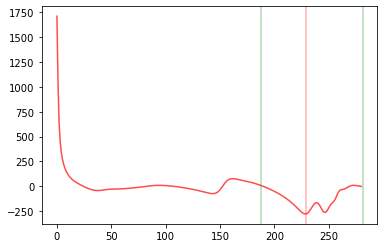

D =  1.2180851063829787 D_index =  229
max 1.1540851063829787  Cueve[D_index] 66.57839


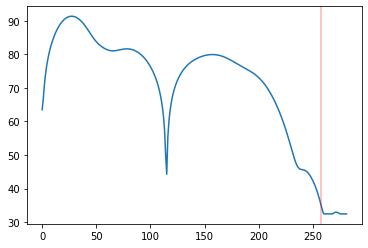

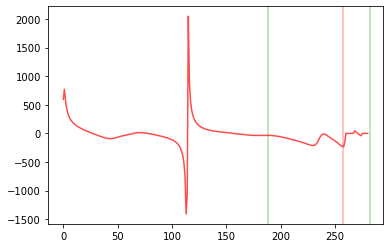

D =  1.3670212765957448 D_index =  257
max 1.3030212765957447  Cueve[D_index] 35.698387


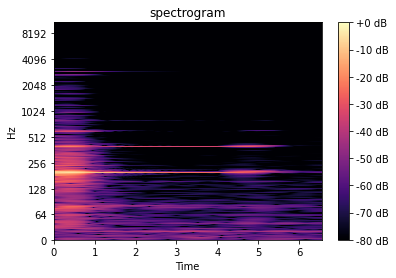

##### duration =  1.165384119958912 #####


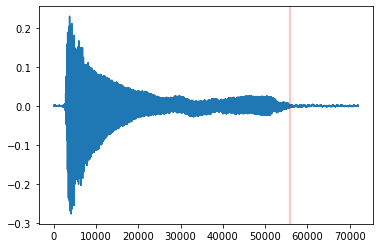

Duration 1.165384119958912


In [41]:
D = compute_D(69, 15, 3, 'lab')
print('Duration', D)

calc_overtone_index [440.0, 880.0, 1320.0, 1760.0, 2200.0, 2640.0, 3080.0, 3520.0, 3960.0] [150, 300, 451, 601, 751, 901, 1051, 1201, 1352]
Onset =  0.064


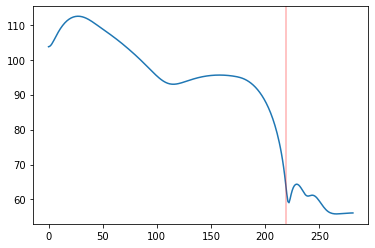

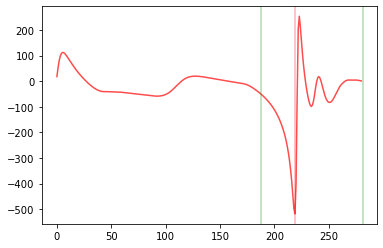

D =  1.1648936170212765 D_index =  219
max 1.1008936170212764  Cueve[D_index] 64.27847


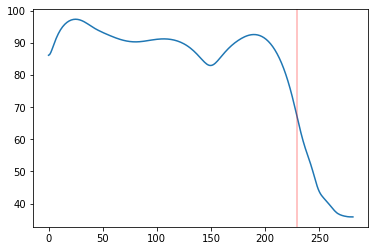

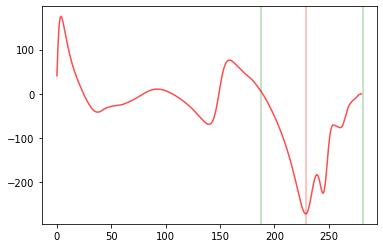

D =  1.2180851063829787 D_index =  229
max 1.1540851063829787  Cueve[D_index] 67.697044


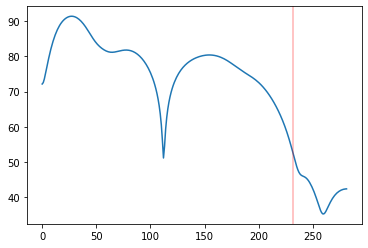

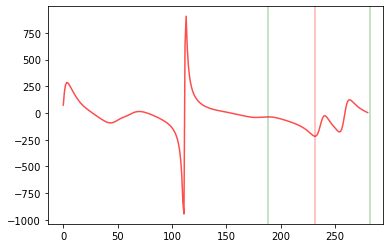

D =  1.2340425531914894 D_index =  232
max 1.1700425531914893  Cueve[D_index] 52.039577


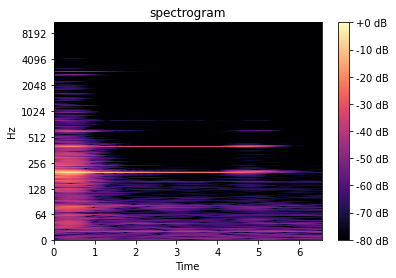

##### duration =  1.1400175163233452 #####


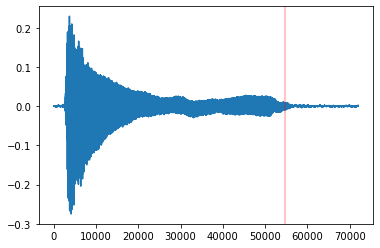

Duration 1.1400175163233452


In [42]:
D = compute_D(69, 16, 3, 'lab')
print('Duration', D)

In [68]:
Dura = []
for i in range(17):
    D = compute_D(69, i, 3, 'lab')
    Dura.append(D)
    

plt.plot(Dura)

/Users/yutianqin/opt/anaconda3/lib/python3.8/site-packages/librosa/core/audio.py:162: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


FileNotFoundError: [Errno 2] No such file or directory: '/Users/yutianqin/Downloads/SchoolWork/Piano/recordings/dictwave_lab_pitch-69_vel-0.0_dur-1_idx-3267.wav'

# Original Code

In [190]:
##Onset
def findT0(pitch, vel_level, dur_level, notetype, hop_len=256):
# def findT0(wave, hop_len=512):
    # # maoran's method
    # energy = np.array(wave ** 2)
    # onset = np.where(energy == max(energy[:5000]))[0][0]  # 最大峰值

    # # roger's method
    
    path = '/Users/yutianqin/Downloads/SchoolWork/Piano/recordings/'
    dur = [0.1, 0.3, 0.7, 1]
    vel = list(range(1,127,8))+[127]
    sr = 48000
    name = 'dictwave_' + notetype + '_pitch-' + str(pitch) + '_vel-' + str(vel[vel_level]) +\
    '_dur-' + str(dur[dur_level]) + '_idx-' + str(dur_level + 4 * vel_level + 4 * len(vel) * (pitch - 21))
    
    wave, sr = librosa.load(path + name + '.wav', sr = 48000)
    
    W = {}
    for j in range(0, 42):
        W[j] = []
        for i in range(0, 1050):
            W[j].append(wave[i + 1050 * j])

    rms_all = []
    for j in range(0, 42):
        w_power = np.array(np.array(W[j]) ** 2)
        rms = np.sqrt(np.sum(w_power) / 1050)
        rms_all.append(rms)

    rms_all = np.array(rms_all)
    onset = np.where(rms_all == np.max(rms_all))[0][0] * 1050

    # plt.plot(wave)
    # plt.axvline(x=onset, c='r', alpha=0.5)
    # plt.show()

    t0 = librosa.samples_to_frames(onset, hop_length=hop_len)
    # t0 = 5
    
    t0 = t0/hop_len

    return t0

In [191]:
def showing(pitch, vel_level, dur_level, notetype, duration):
    path = '/Users/yutianqin/Downloads/SchoolWork/Piano/recordings/'
    dur = [0.1, 0.3, 0.7, 1]
    vel = list(range(1,127,8))+[127]
    sr = 48000
    name = 'dictwave_' + notetype + '_pitch-' + str(pitch) + '_vel-' + str(vel[vel_level]) +\
    '_dur-' + str(dur[dur_level]) + '_idx-' + str(dur_level + 4 * vel_level + 4 * len(vel) * (pitch - 21))
    
    wave, sr = librosa.load(path + name + '.wav', sr = 48000)
    
    D = librosa.stft(wave, n_fft = 16384, hop_length = 256)
    
    librosa.display.specshow(librosa.amplitude_to_db(np.abs(D), ref=np.max), y_axis='log', x_axis='time')
    plt.title('spectrogram')
    plt.colorbar(format='%+2.0f dB')
    plt.show()
    
    
    print('duration = ', duration)
#     time = np.linspace(0, 1.5, len(wave))
    plt.plot(wave)
#     plt.axvline(x=duration*48000, color='r', alpha=0.3)
    plt.show()


In [192]:
def get_D_matrices(pitch, vel_level, dur_level, notetype, ref_value = 1e-3):
    path = '/Users/yutianqin/Downloads/SchoolWork/Piano/recordings/'
#     if notetype == 'audi':
#         path = '/Users/yutianqin/Downloads/SchoolWork/Piano/new_npz/'
#     else:
#         path = '/Users/yutianqin/Downloads/SchoolWork/Piano/new_npz_lab/'
    dur = [0.1, 0.3, 0.7, 1]
    vel = list(range(1,127,8))+[127]
    sr = 48000
    name = 'dictwave_' + notetype + '_pitch-' + str(pitch) + '_vel-' + str(vel[vel_level]) +\
    '_dur-' + str(dur[dur_level]) + '_idx-' + str(dur_level + 4 * vel_level + 4 * len(vel) * (pitch - 21))
    
    wave, sr = librosa.load(path + name + '.wav', sr = 48000)
#     wave = np.load(path + name + '.npy')
#     y_resample = librosa.resample(wave, sr, 22050) # resample to rate = 22050

    D = librosa.stft(wave, n_fft = 16384, hop_length = 256) # set n_fft = 16384, 
    Ddb = librosa.amplitude_to_db(np.abs(D), ref = ref_value)
    
    
    return D, Ddb

In [193]:
# midi pitch
def calc_overtone_index(p, bin_width):
    pitch = p - 20
    fund_freq = (2 ** ((pitch - 49) / (12))) * 440
    max_freq = (2 ** ((88 - 49) / (12))) * 440
    overtone = [fund_freq]
    i = 2
    while (fund_freq * i < max_freq):
        overtone.append(fund_freq * i)
        i += 1

    indices = []
    for f in overtone:
        if round(f / bin_width) < 8193: # len(D) = 8193
            indices.append(round(f / bin_width))
            
    print('calc_overtone_index', overtone, indices)
    
    return overtone, indices

In [194]:
def plot_compare_curve(p, v, d, notetype, no):
    D_origin = get_D_matrices(p, v, d, notetype)[1] #dB
    overtone, indices = calc_overtone_index(p, 48000 /16384)
    
#     print('plot_compare_curve', [len(D_origin[indices[i]]) for i in range(no)])
    
    return [D_origin[indices[i]] for i in range(no)]

In [199]:
def find_d_and_weight(curve, low_b, up_b, onset = 0.2):
#     dx = 1.5 / 129 #微分
    dx = 1.5 / 282
    deriv = diff(curve) / dx
    deriv = deriv[int(low_b / dx) : int(up_b / dx)]
    d = np.where(deriv == min(deriv))[0][0]
    D = low_b + dx * d
    D_index = int(low_b / dx) + d
    
    plt.plot(curve)
    plt.show()
    
    plt.plot(diff(curve) / dx, c = 'r', alpha = 0.7)
#     plt.plot(curve, c = 'b', alpha = 0.6)
    plt.axvline(x=int(low_b / dx), color='g', alpha=0.3)
    plt.axvline(x=int(up_b / dx), color='g', alpha=0.3)
    plt.axvline(x=D_index, color='r', alpha=0.3)
    plt.show()
    
    
    print('D = ', D, 'D_index = ', D_index)
    print('max', max(low_b, D - onset), 'Cueve[D_index]', curve[D_index])
    
    
    return max(low_b, D - onset), curve[D_index]

In [200]:
def compute_D(p, v, d, envir):
    targ_intv = [[0.1, 0.5], [0.3, 0.7], [0.7, 1.0], [1, 1.5]]
    low_b, up_b = targ_intv[d][0], targ_intv[d][1]
    if p <= 88:
        curves = plot_compare_curve(p, v, d, envir, 3)
    else: 
        print('p>=88')
        return 1.2
    Ds, ws = [], []
    
    onset = findT0(p, v, d, envir)
    print('Onset = ', onset)
    
    for c in curves:
        D, w = find_d_and_weight(c, low_b, up_b, onset)
        Ds.append(D)
        ws.append(w)
    return np.average(Ds, weights = ws)

In [201]:
def compute_delay(notetype):
    delay_list = []
    for p in range(21, 109):
        for v in range(17):
            for d in range(4):
                delay = compute_D(p, v, d, notetype)
                delay_list.append(delay)
    
    return delay_list

calc_overtone_index [440.0, 880.0, 1320.0, 1760.0, 2200.0, 2640.0, 3080.0, 3520.0, 3960.0] [150, 300, 451, 601, 751, 901, 1051, 1201, 1352]
plot_compare_curve [282, 282, 282]
Onset =  0.046875


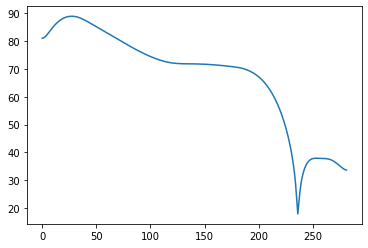

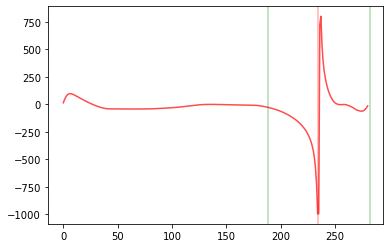

D =  1.2446808510638299 D_index =  234
max 1.1978058510638299 Cueve[D_index] 28.505516


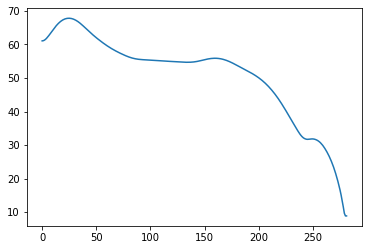

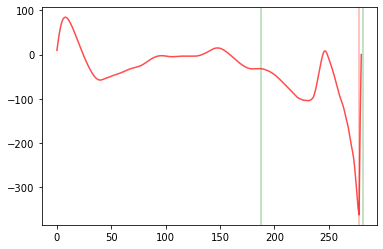

D =  1.478723404255319 D_index =  278
max 1.431848404255319 Cueve[D_index] 11.58131


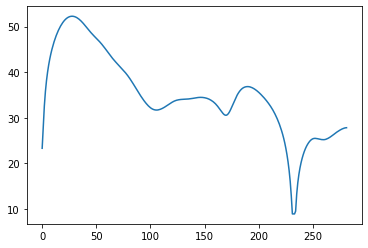

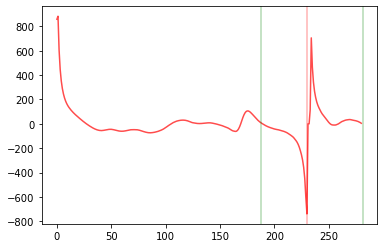

D =  1.2234042553191489 D_index =  230
max 1.1765292553191489 Cueve[D_index] 12.818649
Duration 1.243883921018382


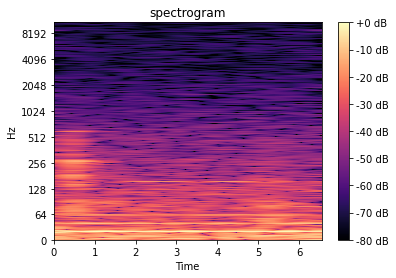

duration =  1.243883921018382


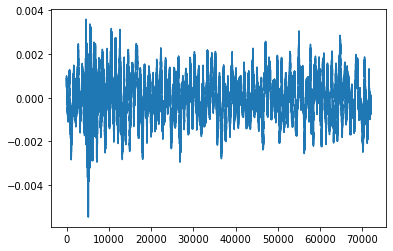

In [202]:
D = compute_D(69, 2, 3, 'lab')
print('Duration', D)
showing(88, 2, 3, 'lab', D)

In [203]:
notetype = 'lab'
pitch = 88
vel_level = 2
dur_level = 3

path = '/Users/yutianqin/Downloads/SchoolWork/Piano/recordings/'
dur = [0.1, 0.3, 0.7, 1]
vel = list(range(1,127,8))+[127]
sr = 48000
name = 'dictwave_' + notetype + '_pitch-' + str(pitch) + '_vel-' + str(vel[vel_level]) +\
'_dur-' + str(dur[dur_level]) + '_idx-' + str(dur_level + 4 * vel_level + 4 * len(vel) * (pitch - 21))

wave, sr = librosa.load(path + name + '.wav', sr = 48000)
IPython.display.Audio(wave, rate=48000)

calc_overtone_index [32.70319566257483, 65.40639132514966, 98.10958698772448, 130.8127826502993, 163.51597831287415, 196.21917397544897, 228.92236963802378, 261.6255653005986, 294.32876096317347, 327.0319566257483, 359.7351522883231, 392.43834795089793, 425.1415436134728, 457.84473927604756, 490.5479349386224, 523.2511306011972, 555.954326263772, 588.6575219263469, 621.3607175889217, 654.0639132514966, 686.7671089140714, 719.4703045766462, 752.1735002392211, 784.8766959017959, 817.5798915643707, 850.2830872269456, 882.9862828895203, 915.6894785520951, 948.39267421467, 981.0958698772448, 1013.7990655398197, 1046.5022612023945, 1079.2054568649694, 1111.908652527544, 1144.611848190119, 1177.3150438526939, 1210.0182395152685, 1242.7214351778434, 1275.4246308404183, 1308.1278265029932, 1340.831022165568, 1373.5342178281428, 1406.2374134907177, 1438.9406091532924, 1471.6438048158673, 1504.3470004784422, 1537.0501961410168, 1569.7533918035917, 1602.4565874661666, 1635.1597831287413, 1667.8629

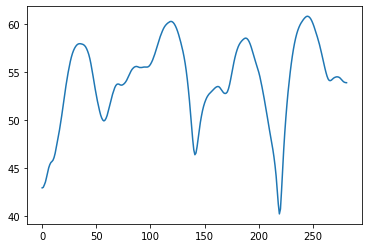

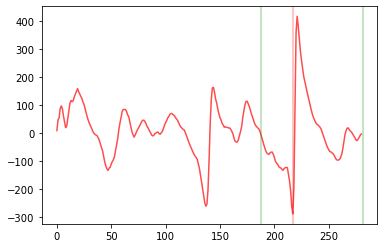

D =  1.1542553191489362 D_index =  217
max 1.0605053191489362 Cueve[D_index] 42.79453


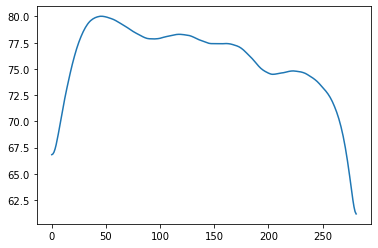

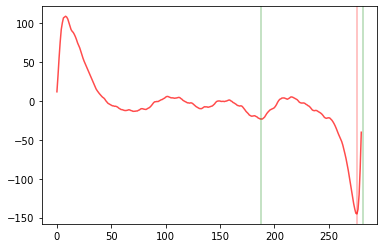

D =  1.4680851063829787 D_index =  276
max 1.3743351063829787 Cueve[D_index] 64.01791


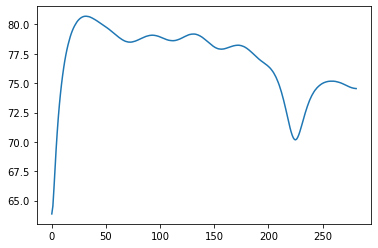

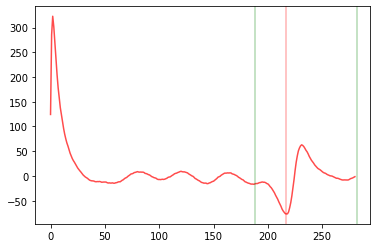

D =  1.1542553191489362 D_index =  217
max 1.0605053191489362 Cueve[D_index] 72.38346
Duration 1.1726213123733689


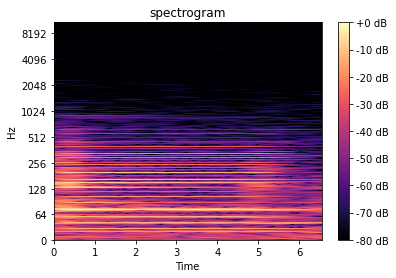

duration =  1.1726213123733689


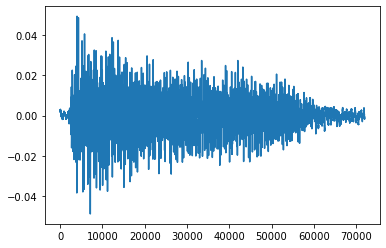

In [204]:
D = compute_D(24, 5, 3, 'lab')

print('Duration', D)
showing(24, 5, 3, 'lab', D)


pitch = 24
vel_level = 5
dur_level = 3
name = 'dictwave_' + notetype + '_pitch-' + str(pitch) + '_vel-' + str(vel[vel_level]) +\
'_dur-' + str(dur[dur_level]) + '_idx-' + str(dur_level + 4 * vel_level + 4 * len(vel) * (pitch - 21))

wave, sr = librosa.load(path + name + '.wav', sr = 48000)
IPython.display.Audio(wave, rate=48000)

calc_overtone_index [65.40639132514966, 130.8127826502993, 196.21917397544897, 261.6255653005986, 327.0319566257483, 392.43834795089793, 457.84473927604756, 523.2511306011972, 588.6575219263469, 654.0639132514966, 719.4703045766462, 784.8766959017959, 850.2830872269456, 915.6894785520951, 981.0958698772448, 1046.5022612023945, 1111.908652527544, 1177.3150438526939, 1242.7214351778434, 1308.1278265029932, 1373.5342178281428, 1438.9406091532924, 1504.3470004784422, 1569.7533918035917, 1635.1597831287413, 1700.566174453891, 1765.9725657790407, 1831.3789571041902, 1896.78534842934, 1962.1917397544896, 2027.5981310796394, 2093.004522404789, 2158.410913729939, 2223.817305055088, 2289.223696380238, 2354.6300877053877, 2420.036479030537, 2485.442870355687, 2550.8492616808367, 2616.2556530059865, 2681.662044331136, 2747.0684356562856, 2812.4748269814354, 2877.8812183065847, 2943.2876096317345, 3008.6940009568843, 3074.1003922820337, 3139.5067836071835, 3204.9131749323333, 3270.3195662574826, 33

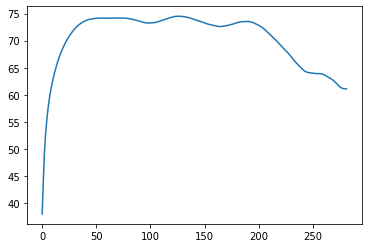

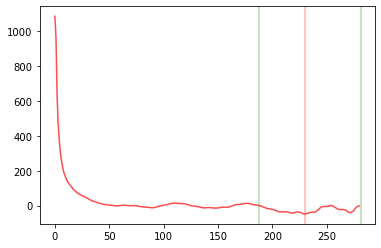

D =  1.2234042553191489 D_index =  230
max 1.1452792553191489 Cueve[D_index] 66.99889


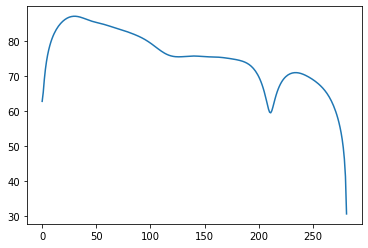

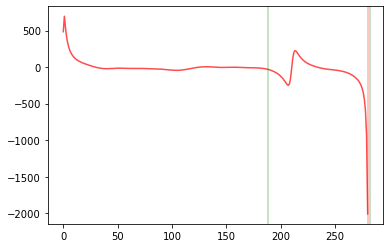

D =  1.4893617021276595 D_index =  280
max 1.4112367021276595 Cueve[D_index] 41.351517


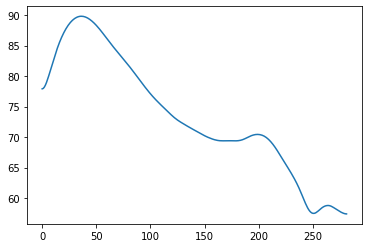

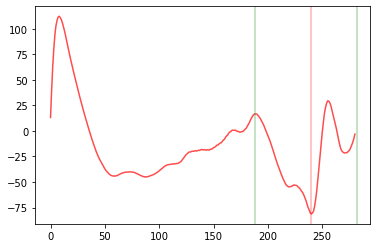

D =  1.2765957446808511 D_index =  240
max 1.1984707446808511 Cueve[D_index] 60.440456
Duration 1.2294820440580707


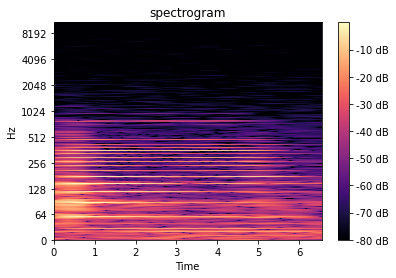

duration =  1.2294820440580707


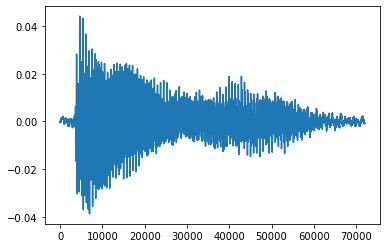

In [205]:
D = compute_D(36, 5, 3, 'lab')

print('Duration', D)
showing(36, 5, 3, 'lab', D)

pitch = 36
name = 'dictwave_' + notetype + '_pitch-' + str(pitch) + '_vel-' + str(vel[vel_level]) +\
'_dur-' + str(dur[dur_level]) + '_idx-' + str(dur_level + 4 * vel_level + 4 * len(vel) * (pitch - 21))

wave, sr = librosa.load(path + name + '.wav', sr = 48000)
IPython.display.Audio(wave, rate=48000)

calc_overtone_index [130.8127826502993, 261.6255653005986, 392.43834795089793, 523.2511306011972, 654.0639132514966, 784.8766959017959, 915.6894785520951, 1046.5022612023945, 1177.3150438526939, 1308.1278265029932, 1438.9406091532924, 1569.7533918035917, 1700.566174453891, 1831.3789571041902, 1962.1917397544896, 2093.004522404789, 2223.817305055088, 2354.6300877053877, 2485.442870355687, 2616.2556530059865, 2747.0684356562856, 2877.8812183065847, 3008.6940009568843, 3139.5067836071835, 3270.3195662574826, 3401.132348907782, 3531.9451315580814, 3662.7579142083805, 3793.57069685868, 3924.3834795089792, 4055.196262159279] [45, 89, 134, 179, 223, 268, 313, 357, 402, 447, 491, 536, 580, 625, 670, 714, 759, 804, 848, 893, 938, 982, 1027, 1072, 1116, 1161, 1206, 1250, 1295, 1340, 1384]
plot_compare_curve [282, 282, 282]
Onset =  0.09375


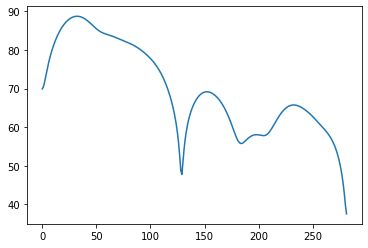

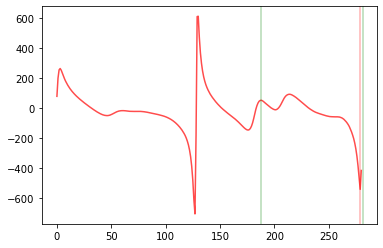

D =  1.4840425531914894 D_index =  279
max 1.3902925531914894 Cueve[D_index] 42.6019


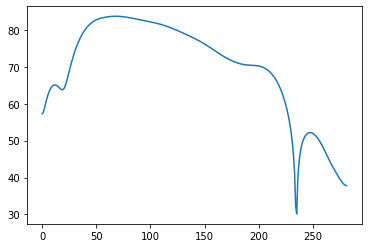

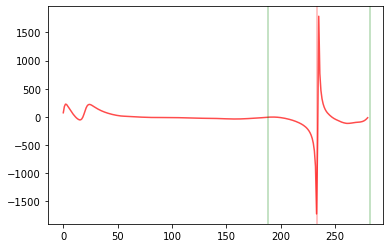

D =  1.2393617021276595 D_index =  233
max 1.1456117021276595 Cueve[D_index] 41.48486


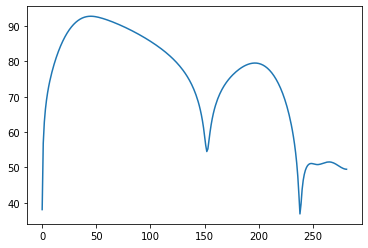

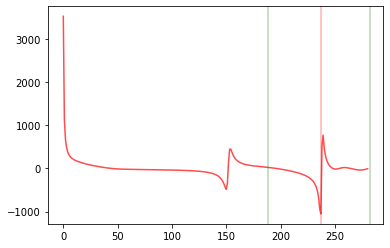

D =  1.2606382978723405 D_index =  237
max 1.1668882978723405 Cueve[D_index] 42.468834
Duration 1.2351175135762922


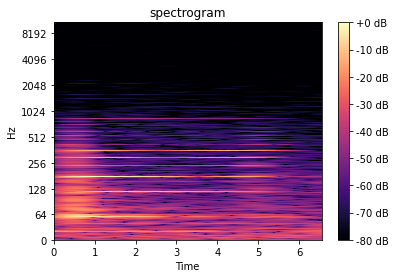

duration =  1.2351175135762922


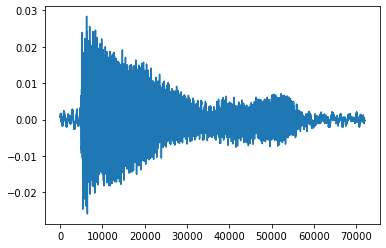

In [206]:
D = compute_D(48, 5, 3, 'lab')

print('Duration', D)
showing(48, 5, 3, 'lab', D)

pitch = 48
name = 'dictwave_' + notetype + '_pitch-' + str(pitch) + '_vel-' + str(vel[vel_level]) +\
'_dur-' + str(dur[dur_level]) + '_idx-' + str(dur_level + 4 * vel_level + 4 * len(vel) * (pitch - 21))

wave, sr = librosa.load(path + name + '.wav', sr = 48000)
IPython.display.Audio(wave, rate=48000)

calc_overtone_index [261.6255653005986, 523.2511306011972, 784.8766959017959, 1046.5022612023945, 1308.1278265029932, 1569.7533918035917, 1831.3789571041902, 2093.004522404789, 2354.6300877053877, 2616.2556530059865, 2877.8812183065847, 3139.5067836071835, 3401.132348907782, 3662.7579142083805, 3924.3834795089792] [89, 179, 268, 357, 447, 536, 625, 714, 804, 893, 982, 1072, 1161, 1250, 1340]
plot_compare_curve [282, 282, 282]
Onset =  0.09375


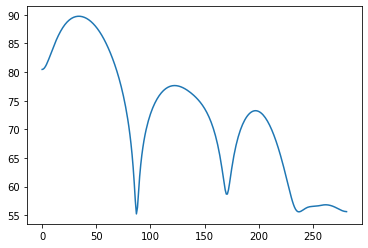

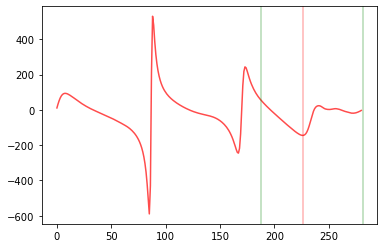

D =  1.202127659574468 D_index =  226
max 1.108377659574468 Cueve[D_index] 61.13374


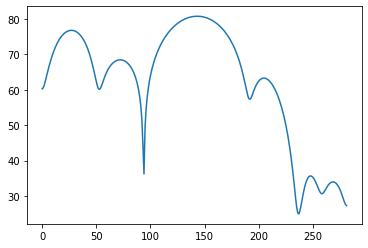

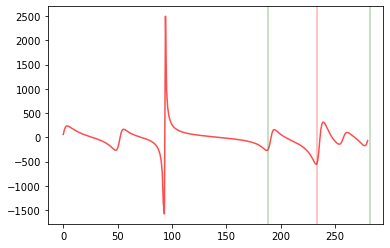

D =  1.2393617021276595 D_index =  233
max 1.1456117021276595 Cueve[D_index] 32.329224


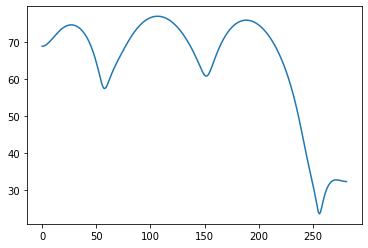

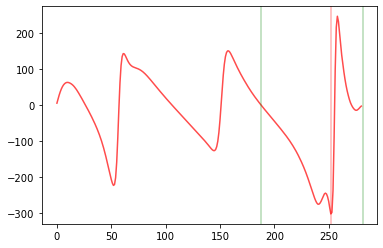

D =  1.3404255319148937 D_index =  252
max 1.2466755319148937 Cueve[D_index] 28.49621
Duration 1.1505615542313214


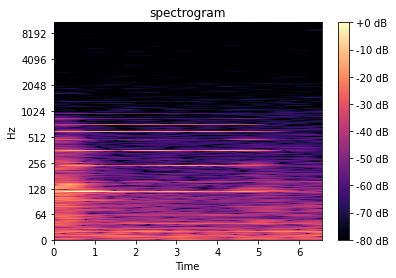

duration =  1.1505615542313214


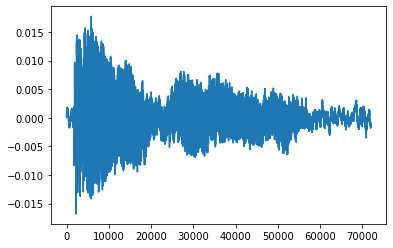

In [207]:
D = compute_D(60, 5, 3, 'lab')

print('Duration', D)
showing(60, 5, 3, 'lab', D)


pitch = 60
name = 'dictwave_' + notetype + '_pitch-' + str(pitch) + '_vel-' + str(vel[vel_level]) +\
'_dur-' + str(dur[dur_level]) + '_idx-' + str(dur_level + 4 * vel_level + 4 * len(vel) * (pitch - 21))

wave, sr = librosa.load(path + name + '.wav', sr = 48000)
IPython.display.Audio(wave, rate=48000)

calc_overtone_index [523.2511306011972, 1046.5022612023945, 1569.7533918035917, 2093.004522404789, 2616.2556530059865, 3139.5067836071835, 3662.7579142083805] [179, 357, 536, 714, 893, 1072, 1250]
plot_compare_curve [282, 282, 282]
Onset =  0.078125


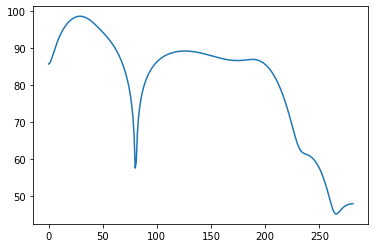

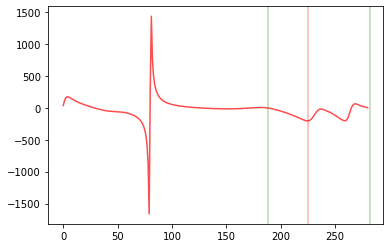

D =  1.196808510638298 D_index =  225
max 1.118683510638298 Cueve[D_index] 68.98686


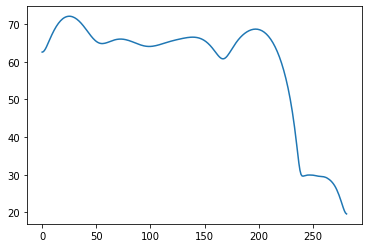

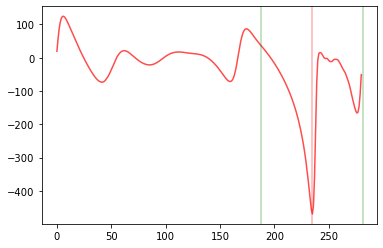

D =  1.25 D_index =  235
max 1.171875 Cueve[D_index] 37.949715


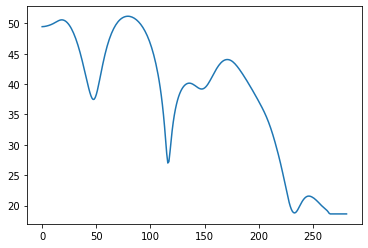

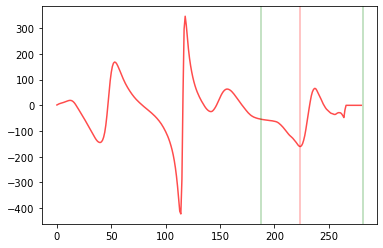

D =  1.1914893617021276 D_index =  224
max 1.1133643617021276 Cueve[D_index] 23.74908
Duration 1.133163117526428


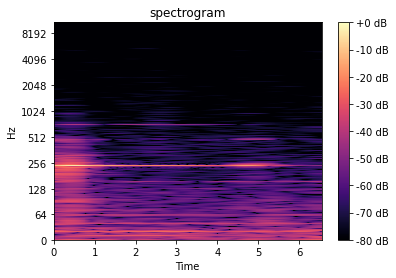

duration =  1.133163117526428


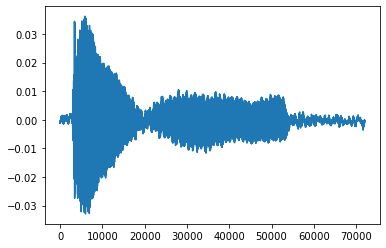

In [208]:
D = compute_D(72, 5, 3, 'lab')

print('Duration', D)
showing(72, 5, 3, 'lab', D)


pitch = 72
name = 'dictwave_' + notetype + '_pitch-' + str(pitch) + '_vel-' + str(vel[vel_level]) +\
'_dur-' + str(dur[dur_level]) + '_idx-' + str(dur_level + 4 * vel_level + 4 * len(vel) * (pitch - 21))

wave, sr = librosa.load(path + name + '.wav', sr = 48000)
IPython.display.Audio(wave, rate=48000)

calc_overtone_index [1046.5022612023945, 2093.004522404789, 3139.5067836071835] [357, 714, 1072]
plot_compare_curve [282, 282, 282]
Onset =  0.078125


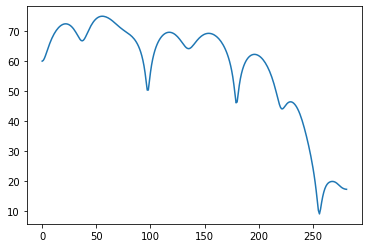

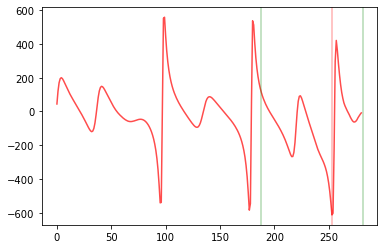

D =  1.3457446808510638 D_index =  253
max 1.2676196808510638 Cueve[D_index] 16.800606


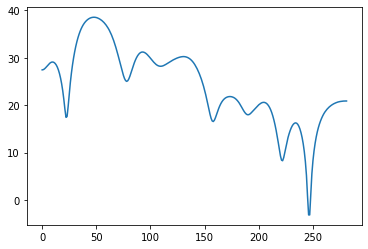

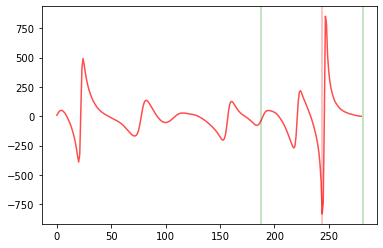

D =  1.297872340425532 D_index =  244
max 1.219747340425532 Cueve[D_index] 5.163391


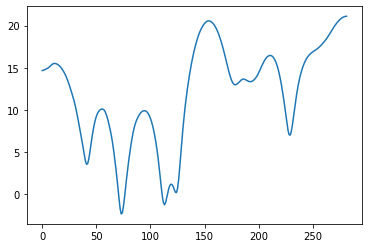

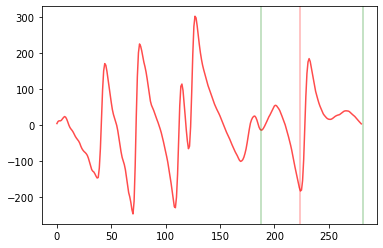

D =  1.1914893617021276 D_index =  224
max 1.1133643617021276 Cueve[D_index] 10.350437
Duration 1.2105617852277941


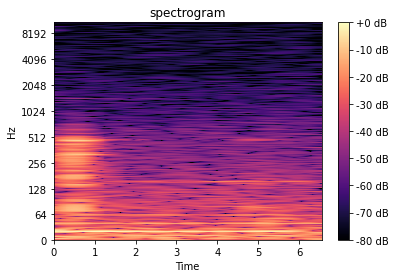

duration =  1.2105617852277941


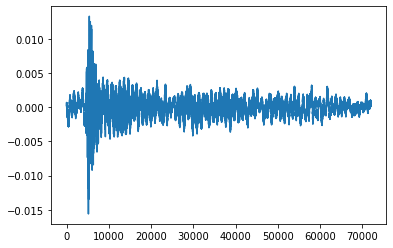

In [209]:
D = compute_D(84, 5, 3, 'lab')

print('Duration', D)
showing(84, 5, 3, 'lab', D)

pitch = 84
name = 'dictwave_' + notetype + '_pitch-' + str(pitch) + '_vel-' + str(vel[vel_level]) +\
'_dur-' + str(dur[dur_level]) + '_idx-' + str(dur_level + 4 * vel_level + 4 * len(vel) * (pitch - 21))

wave, sr = librosa.load(path + name + '.wav', sr = 48000)
IPython.display.Audio(wave, rate=48000)

p>=88
Duration 1.2


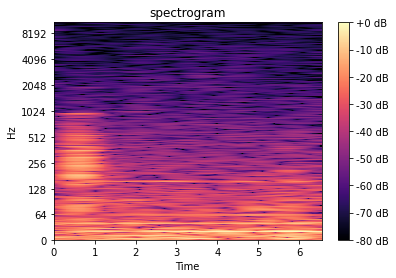

duration =  1.2


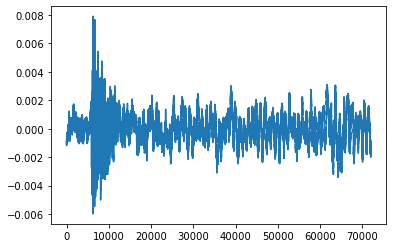

In [210]:
D = compute_D(96, 5, 3, 'lab')

print('Duration', D)
showing(96, 5, 3, 'lab', D)


pitch = 96
name = 'dictwave_' + notetype + '_pitch-' + str(pitch) + '_vel-' + str(vel[vel_level]) +\
'_dur-' + str(dur[dur_level]) + '_idx-' + str(dur_level + 4 * vel_level + 4 * len(vel) * (pitch - 21))

wave, sr = librosa.load(path + name + '.wav', sr = 48000)
IPython.display.Audio(wave, rate=48000)

p>=88
Duration 1.2


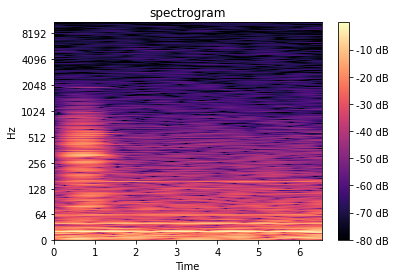

duration =  1.2


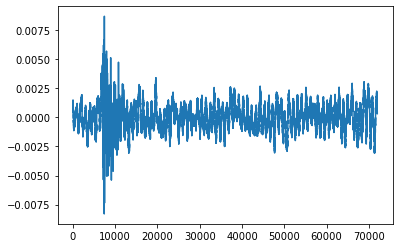

In [211]:
D = compute_D(108, 5, 3, 'lab')

print('Duration', D)
showing(108, 5, 3, 'lab', D)


calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 3217.5, 3245.0, 3272.5, 3300.0, 3327.5, 3355.0, 3382.5, 3410.0, 3437.5, 3465.0, 3492.5, 35

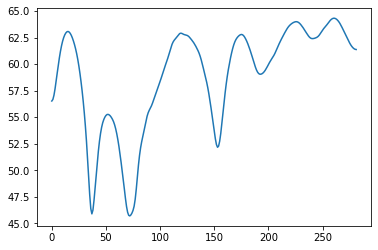

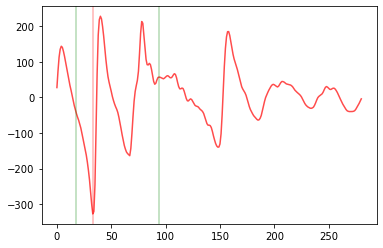

D =  0.1797872340425532 D_index =  33
max 0.1016622340425532 Cueve[D_index] 51.15664


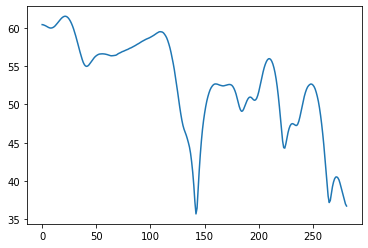

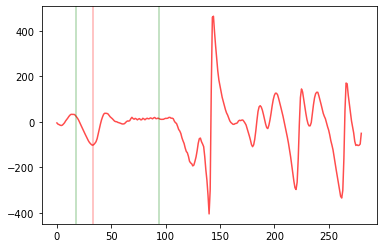

D =  0.1797872340425532 D_index =  33
max 0.1016622340425532 Cueve[D_index] 57.891487


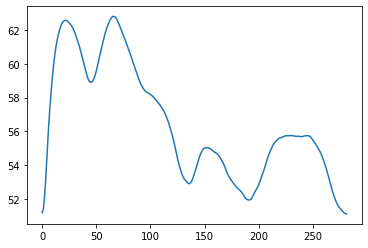

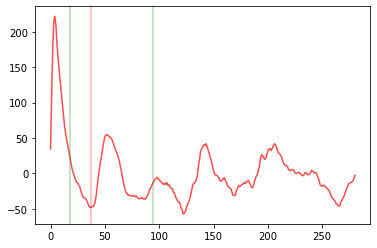

D =  0.20106382978723403 D_index =  37
max 0.12293882978723403 Cueve[D_index] 60.389503
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 32

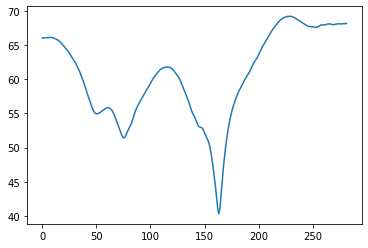

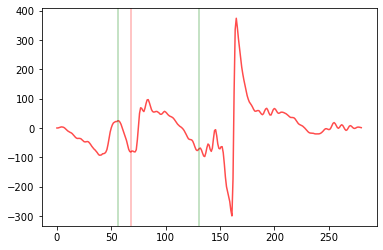

D =  0.3638297872340425 D_index =  68
max 0.3 Cueve[D_index] 54.17579


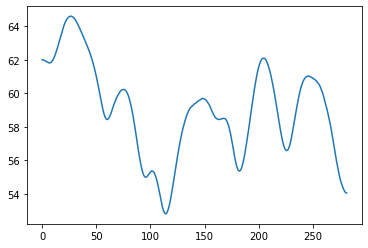

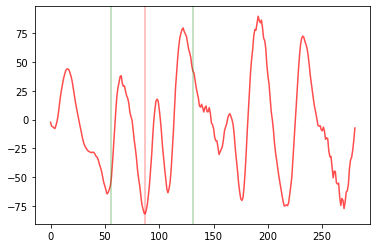

D =  0.4648936170212766 D_index =  87
max 0.3867686170212766 Cueve[D_index] 57.382534


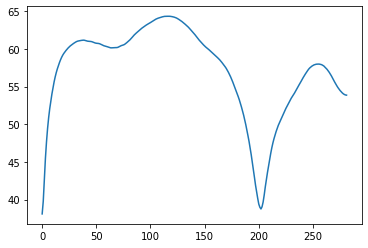

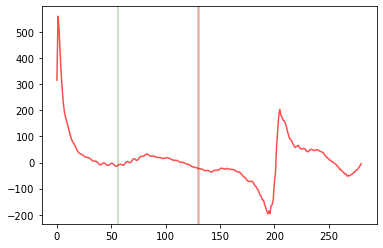

D =  0.6936170212765957 D_index =  130
max 0.6154920212765957 Cueve[D_index] 63.532475
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 321

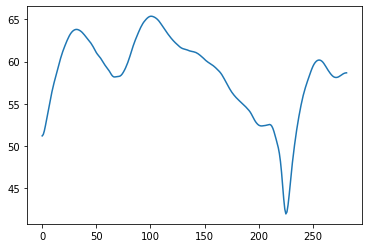

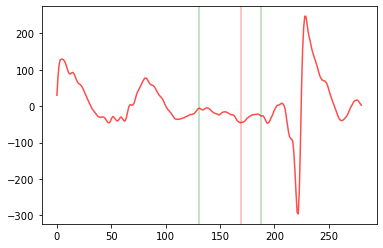

D =  0.902127659574468 D_index =  169
max 0.824002659574468 Cueve[D_index] 57.7408


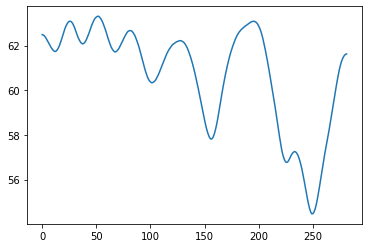

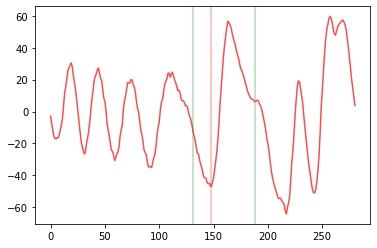

D =  0.7904255319148936 D_index =  148
max 0.7123005319148936 Cueve[D_index] 59.139034


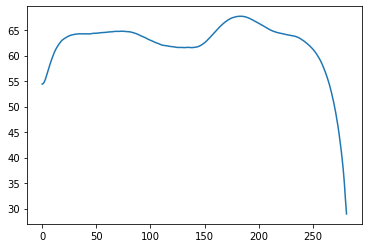

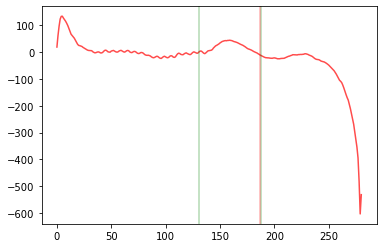

D =  0.9978723404255319 D_index =  187
max 0.9197473404255319 Cueve[D_index] 67.62524
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 3217

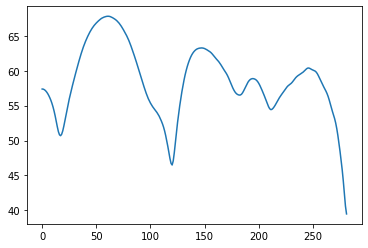

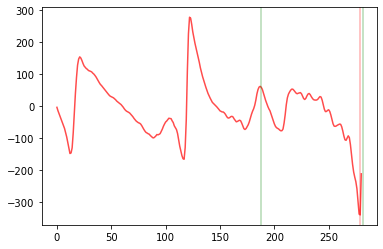

D =  1.4840425531914894 D_index =  279
max 1.4059175531914894 Cueve[D_index] 42.426594


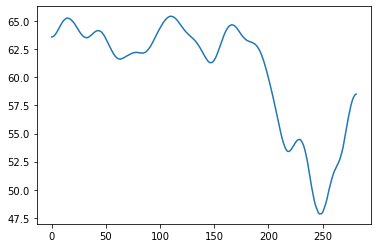

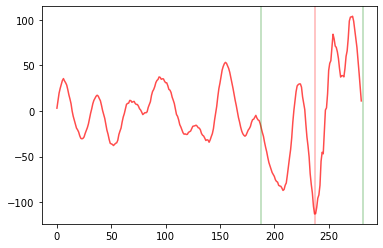

D =  1.2606382978723405 D_index =  237
max 1.1825132978723405 Cueve[D_index] 51.947556


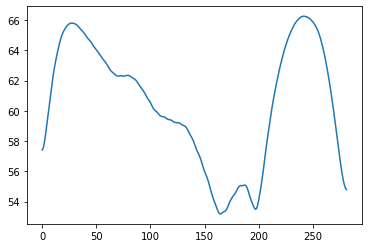

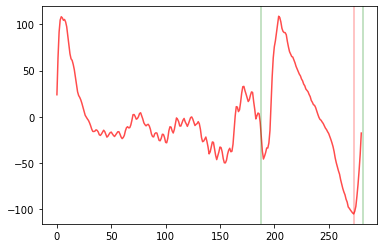

D =  1.452127659574468 D_index =  273
max 1.374002659574468 Cueve[D_index] 57.87979
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 3217.5

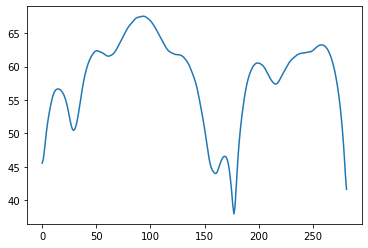

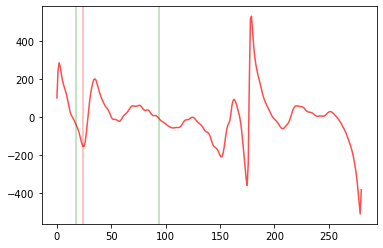

D =  0.13191489361702127 D_index =  24
max 0.1 Cueve[D_index] 53.444138


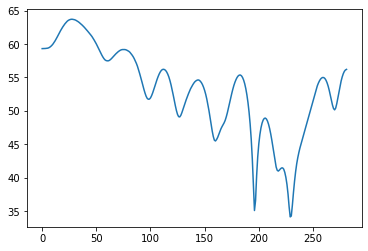

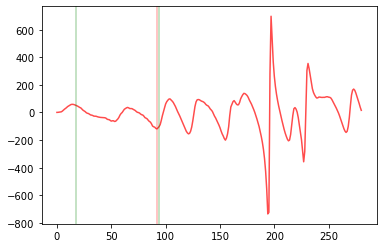

D =  0.4936170212765958 D_index =  92
max 0.4154920212765958 Cueve[D_index] 54.395615


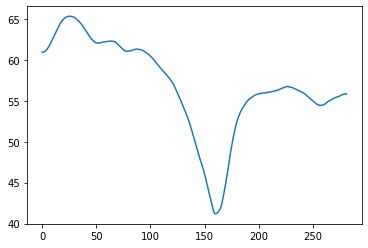

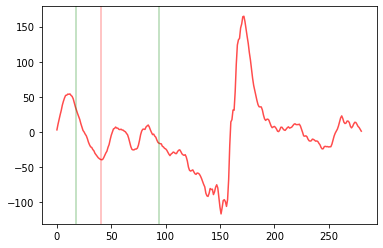

D =  0.2223404255319149 D_index =  41
max 0.1442154255319149 Cueve[D_index] 63.460342
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 3217

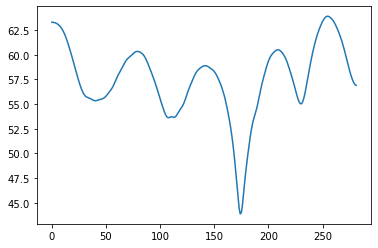

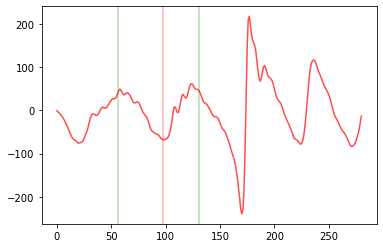

D =  0.5234042553191489 D_index =  98
max 0.4452792553191489 Cueve[D_index] 56.25732


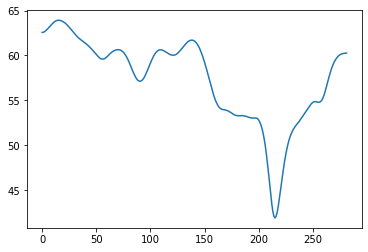

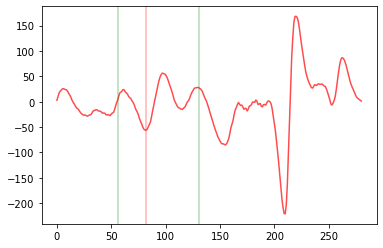

D =  0.4382978723404255 D_index =  82
max 0.3601728723404255 Cueve[D_index] 58.73464


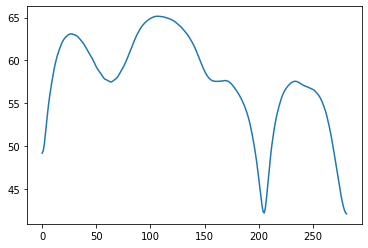

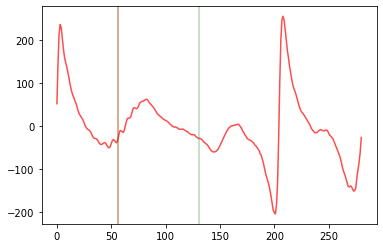

D =  0.3 D_index =  56
max 0.3 Cueve[D_index] 58.096107
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 3217.5, 3245.0, 3272.5, 3300.0, 33

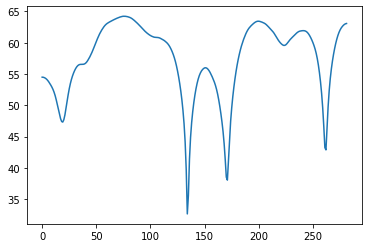

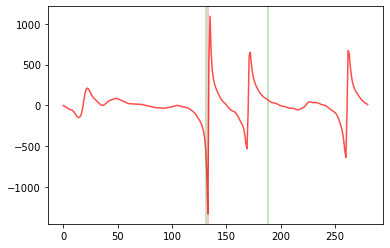

D =  0.7106382978723403 D_index =  133
max 0.7 Cueve[D_index] 39.704807


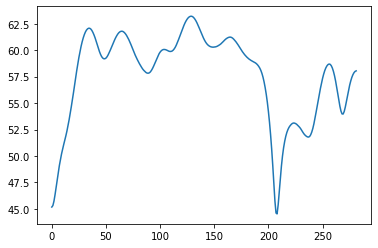

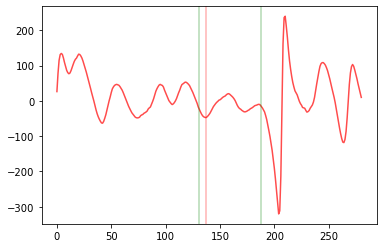

D =  0.7319148936170212 D_index =  137
max 0.7 Cueve[D_index] 61.87065


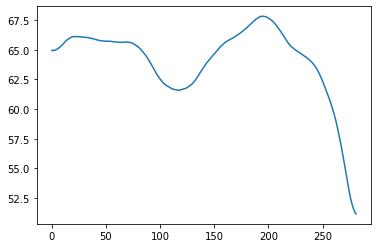

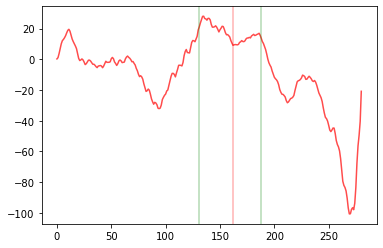

D =  0.8648936170212765 D_index =  162
max 0.7867686170212765 Cueve[D_index] 65.74199
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 3217

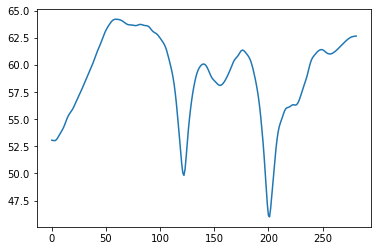

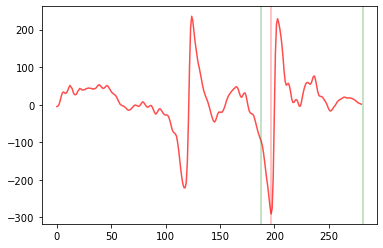

D =  1.047872340425532 D_index =  197
max 1 Cueve[D_index] 50.173557


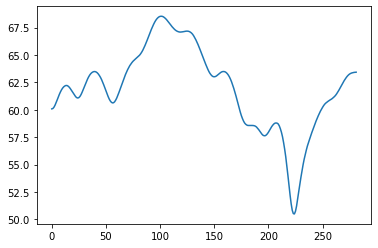

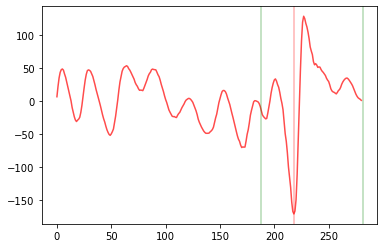

D =  1.1595744680851063 D_index =  218
max 1.0814494680851063 Cueve[D_index] 54.004475


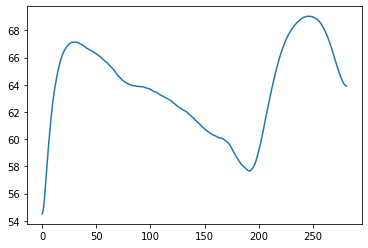

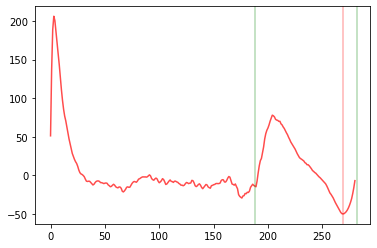

D =  1.4308510638297873 D_index =  269
max 1.3527260638297873 Cueve[D_index] 66.21834
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 3217

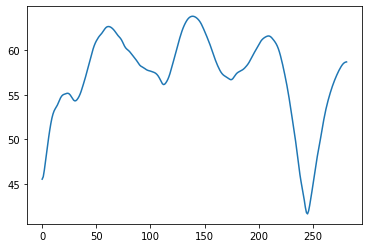

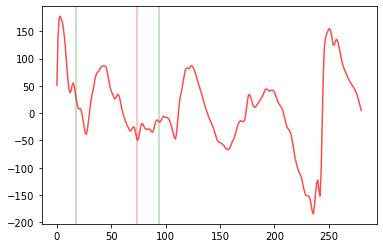

D =  0.3978723404255319 D_index =  74
max 0.3197473404255319 Cueve[D_index] 60.97396


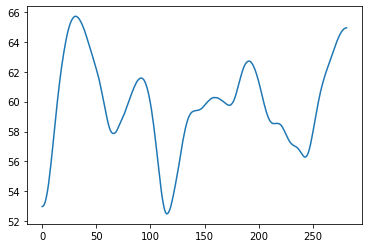

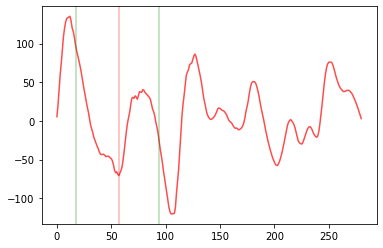

D =  0.3074468085106383 D_index =  57
max 0.22932180851063833 Cueve[D_index] 59.922382


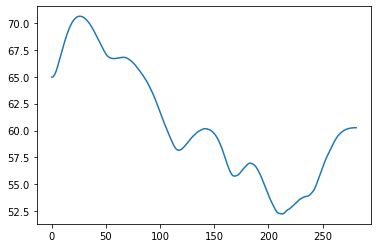

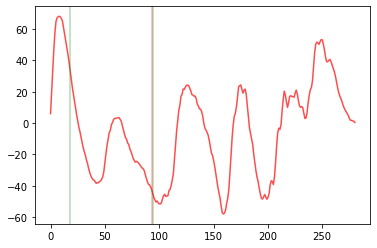

D =  0.49893617021276593 D_index =  93
max 0.42081117021276593 Cueve[D_index] 63.488914
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 32

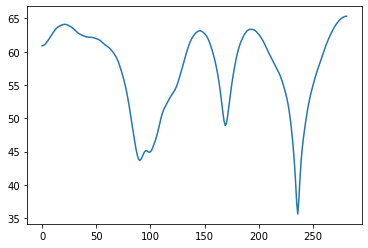

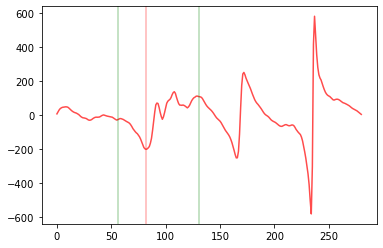

D =  0.4382978723404255 D_index =  82
max 0.3 Cueve[D_index] 50.127525


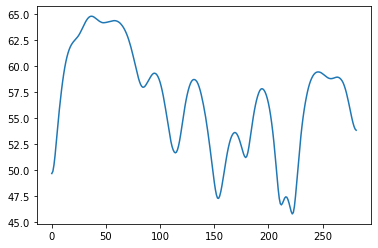

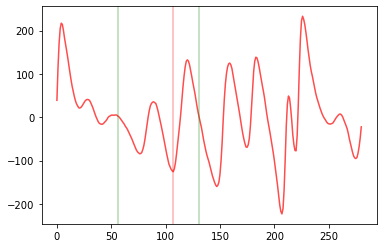

D =  0.5712765957446808 D_index =  107
max 0.3798703457446808 Cueve[D_index] 54.623203


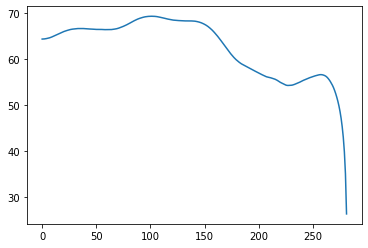

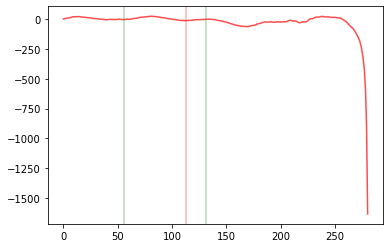

D =  0.6031914893617021 D_index =  113
max 0.4117852393617021 Cueve[D_index] 68.869644
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 321

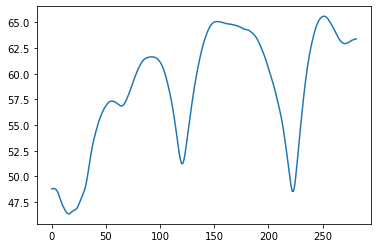

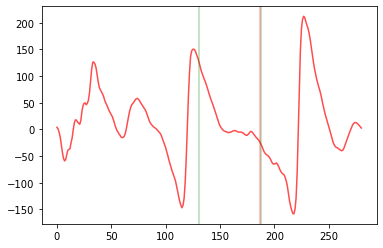

D =  0.9978723404255319 D_index =  187
max 0.9197473404255319 Cueve[D_index] 63.77053


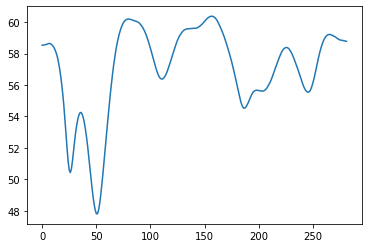

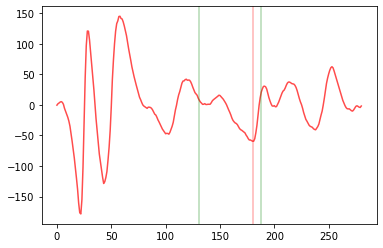

D =  0.9606382978723405 D_index =  180
max 0.8825132978723405 Cueve[D_index] 55.96889


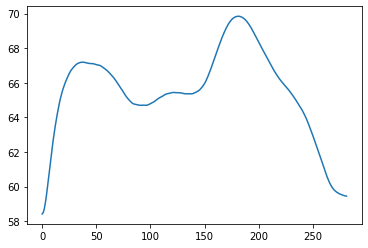

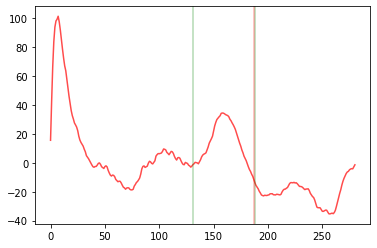

D =  0.9978723404255319 D_index =  187
max 0.9197473404255319 Cueve[D_index] 69.67204
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 3217

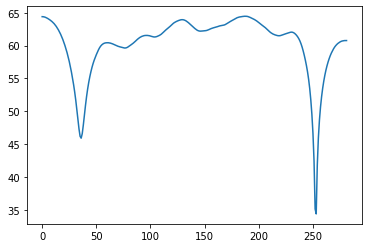

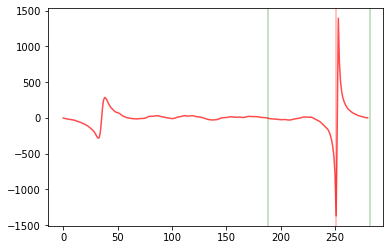

D =  1.3351063829787235 D_index =  251
max 1.0343251329787235 Cueve[D_index] 42.428207


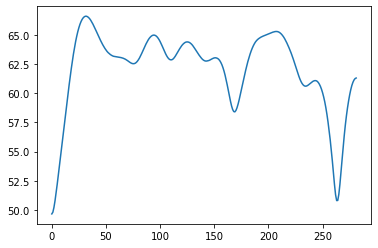

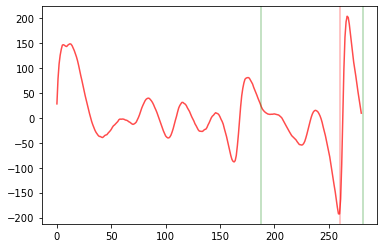

D =  1.3829787234042552 D_index =  260
max 1.0821974734042552 Cueve[D_index] 53.191116


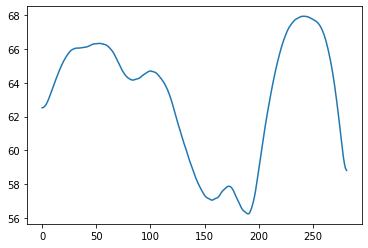

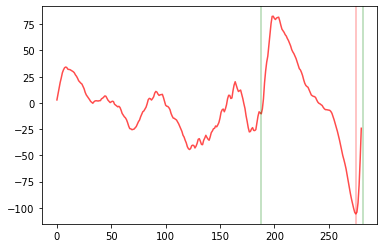

D =  1.4627659574468086 D_index =  275
max 1.1619847074468086 Cueve[D_index] 61.276062
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 321

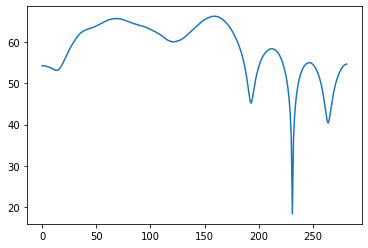

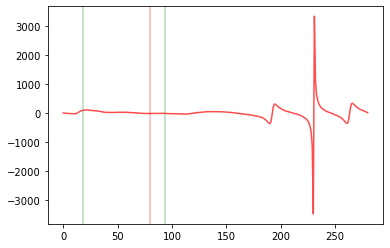

D =  0.42978723404255315 D_index =  80
max 0.36728723404255315 Cueve[D_index] 64.94754


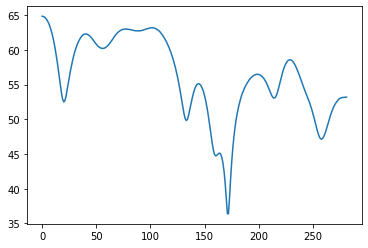

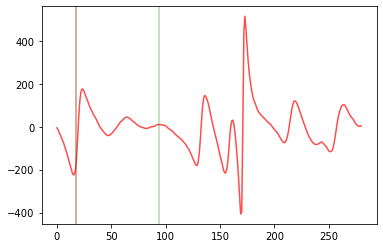

D =  0.1 D_index =  18
max 0.1 Cueve[D_index] 53.606888


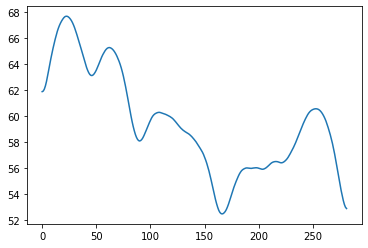

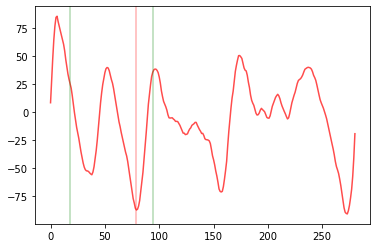

D =  0.424468085106383 D_index =  79
max 0.361968085106383 Cueve[D_index] 61.404053
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 3217.5

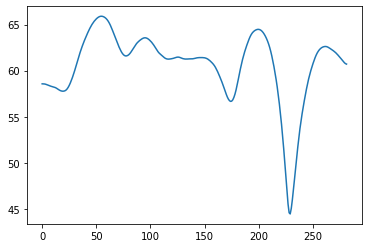

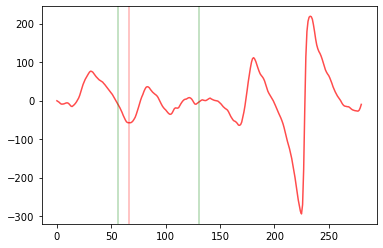

D =  0.35319148936170214 D_index =  66
max 0.3 Cueve[D_index] 64.04666


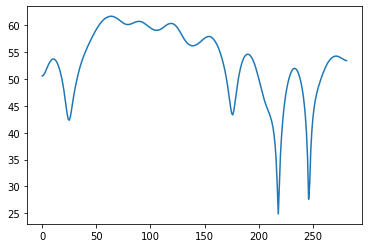

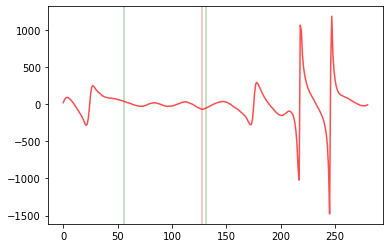

D =  0.6829787234042553 D_index =  128
max 0.6048537234042553 Cueve[D_index] 58.529896


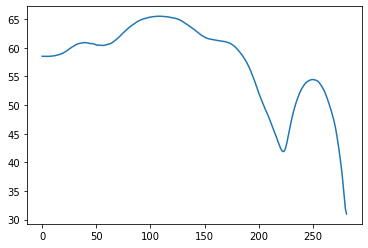

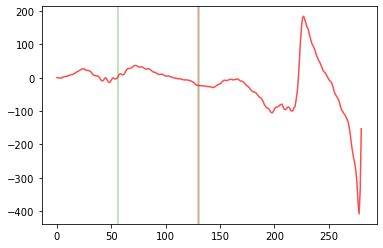

D =  0.6936170212765957 D_index =  130
max 0.6154920212765957 Cueve[D_index] 64.55749
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 3217

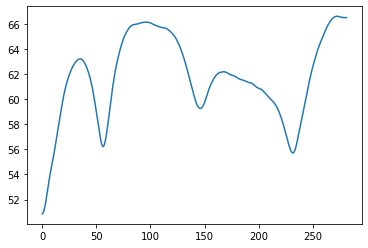

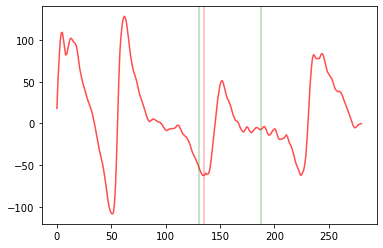

D =  0.7212765957446808 D_index =  135
max 0.7 Cueve[D_index] 61.975864


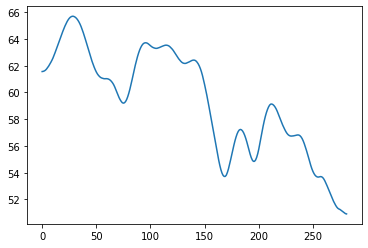

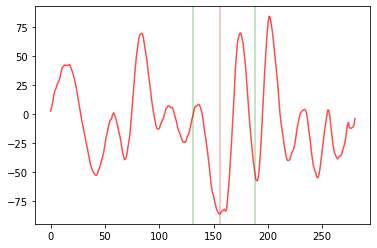

D =  0.8329787234042553 D_index =  156
max 0.7 Cueve[D_index] 58.03413


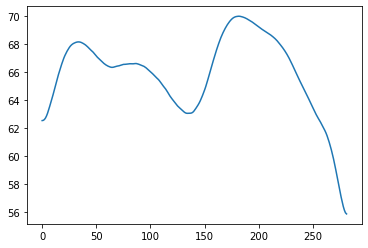

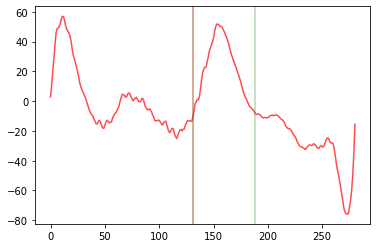

D =  0.7 D_index =  131
max 0.7 Cueve[D_index] 63.1582
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 3217.5, 3245.0, 3272.5, 3300.0, 332

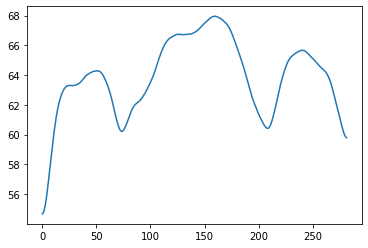

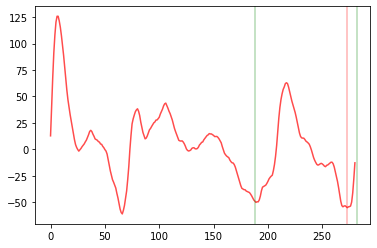

D =  1.452127659574468 D_index =  273
max 1.291971409574468 Cueve[D_index] 61.65278


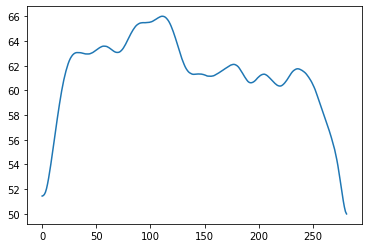

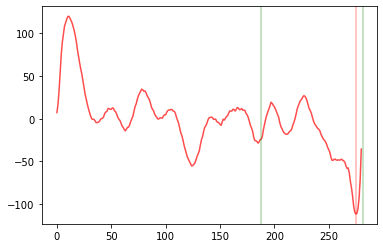

D =  1.4627659574468086 D_index =  275
max 1.3026097074468086 Cueve[D_index] 52.789177


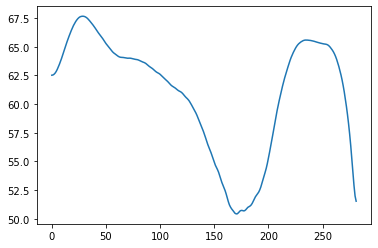

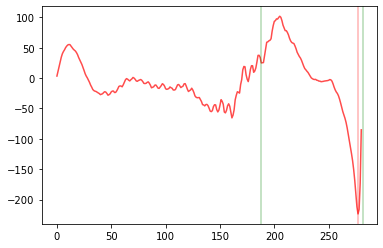

D =  1.4734042553191489 D_index =  277
max 1.3132480053191489 Cueve[D_index] 55.24366
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 3217

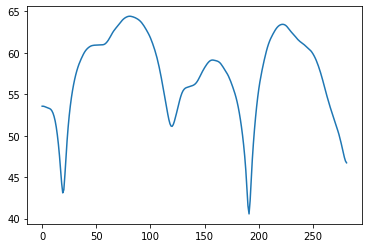

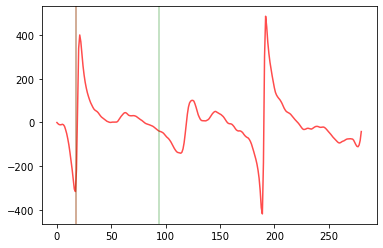

D =  0.1 D_index =  18
max 0.1 Cueve[D_index] 44.24952


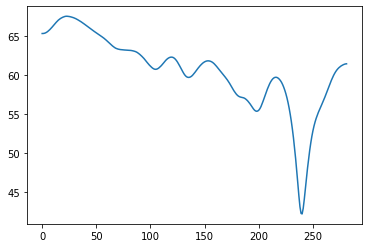

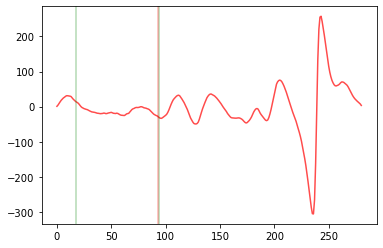

D =  0.49893617021276593 D_index =  93
max 0.42081117021276593 Cueve[D_index] 62.274433


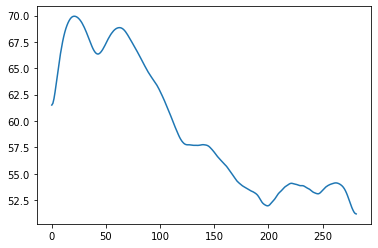

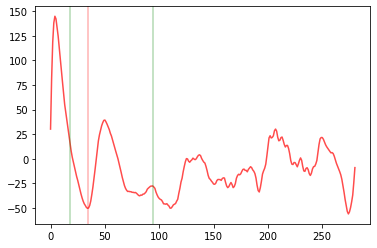

D =  0.1851063829787234 D_index =  34
max 0.1069813829787234 Cueve[D_index] 67.87933
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 3217.

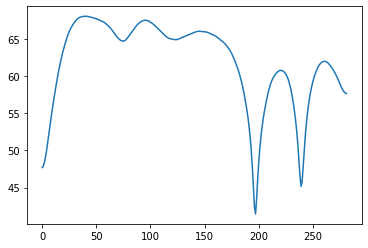

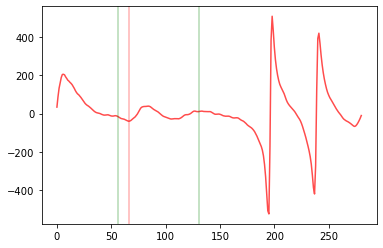

D =  0.35319148936170214 D_index =  66
max 0.3 Cueve[D_index] 65.8966


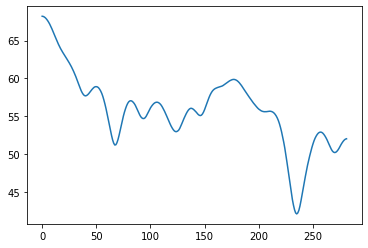

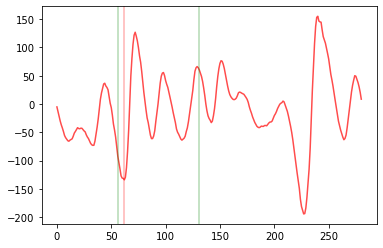

D =  0.33191489361702126 D_index =  62
max 0.3 Cueve[D_index] 53.89895


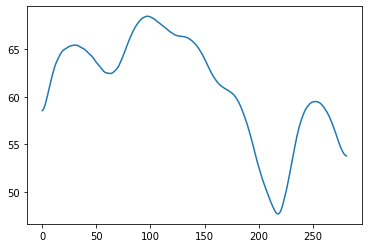

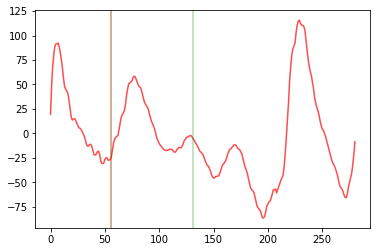

D =  0.3 D_index =  56
max 0.3 Cueve[D_index] 62.779778
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 3217.5, 3245.0, 3272.5, 3300.0, 33

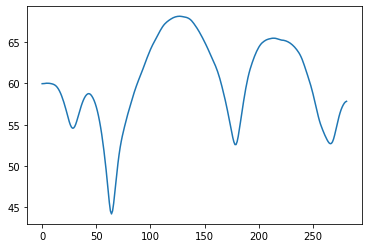

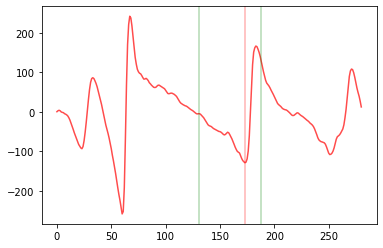

D =  0.9234042553191488 D_index =  173
max 0.8452792553191488 Cueve[D_index] 55.428368


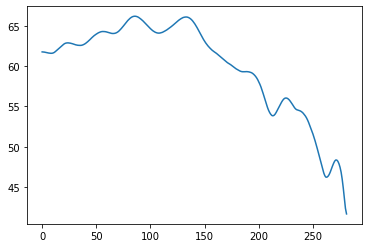

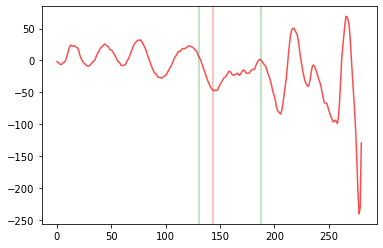

D =  0.7691489361702127 D_index =  144
max 0.7 Cueve[D_index] 64.539505


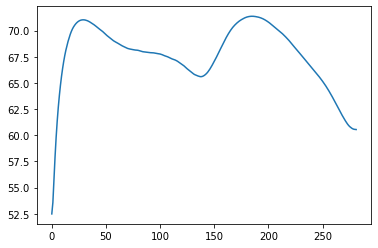

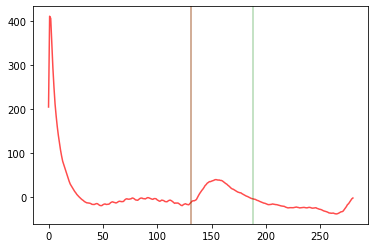

D =  0.7 D_index =  131
max 0.7 Cueve[D_index] 65.84906
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 3217.5, 3245.0, 3272.5, 3300.0, 33

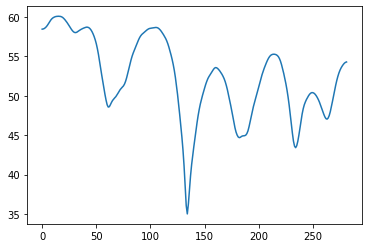

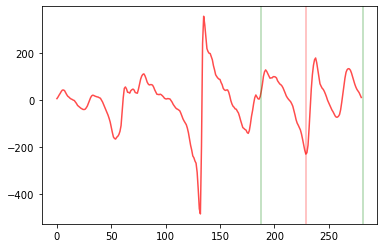

D =  1.2180851063829787 D_index =  229
max 1.1399601063829787 Cueve[D_index] 47.70466


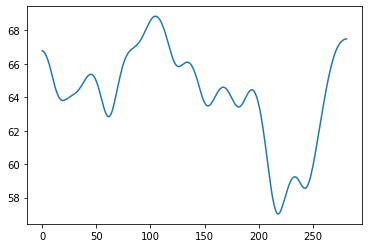

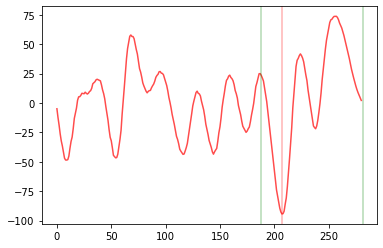

D =  1.101063829787234 D_index =  207
max 1.022938829787234 Cueve[D_index] 60.672337


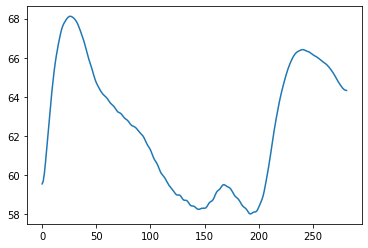

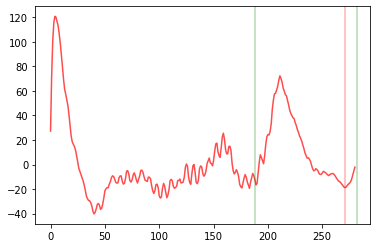

D =  1.4414893617021276 D_index =  271
max 1.3633643617021276 Cueve[D_index] 65.00118
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 3217

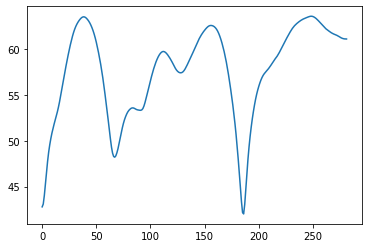

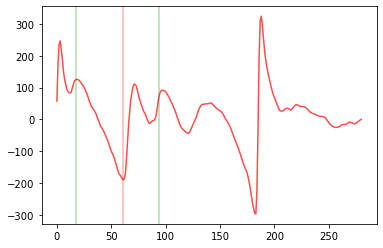

D =  0.32872340425531915 D_index =  61
max 0.25059840425531915 Cueve[D_index] 52.222


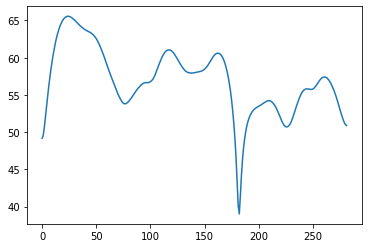

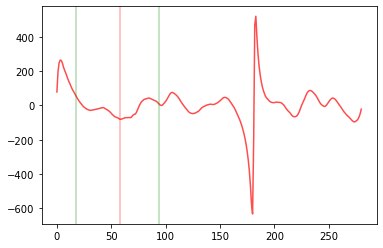

D =  0.3127659574468085 D_index =  58
max 0.23464095744680852 Cueve[D_index] 59.809193


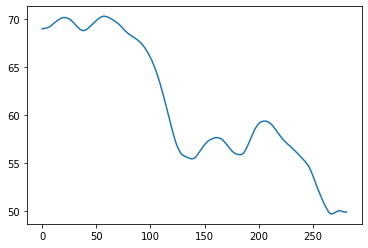

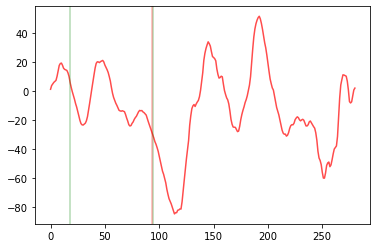

D =  0.49893617021276593 D_index =  93
max 0.42081117021276593 Cueve[D_index] 67.25814
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 321

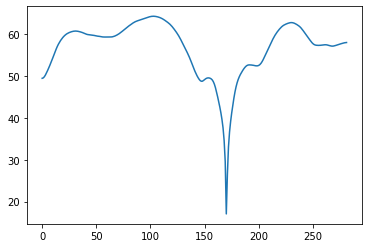

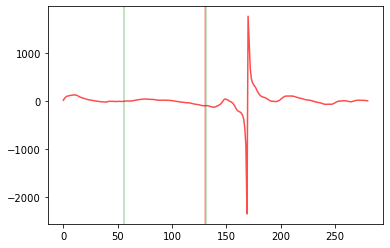

D =  0.6936170212765957 D_index =  130
max 0.6154920212765957 Cueve[D_index] 57.700333


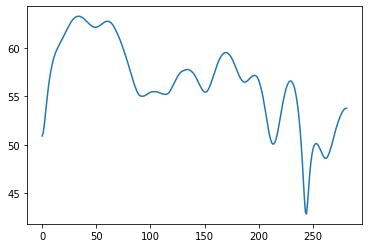

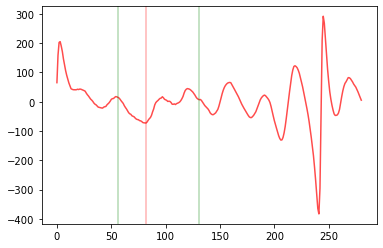

D =  0.4382978723404255 D_index =  82
max 0.3601728723404255 Cueve[D_index] 57.3507


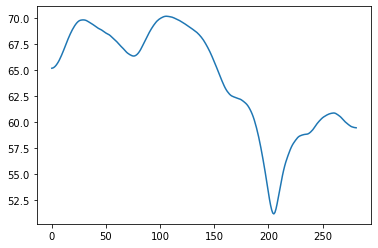

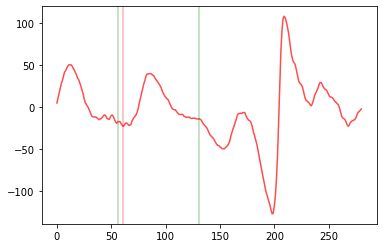

D =  0.32659574468085106 D_index =  61
max 0.3 Cueve[D_index] 67.61928
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 3217.5, 3245.0, 327

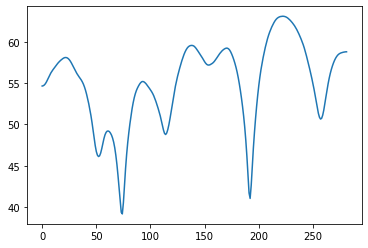

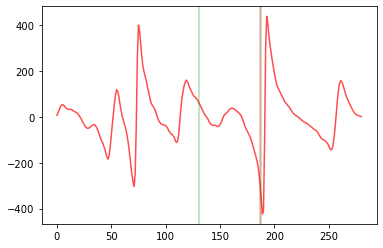

D =  0.9978723404255319 D_index =  187
max 0.9197473404255319 Cueve[D_index] 49.68746


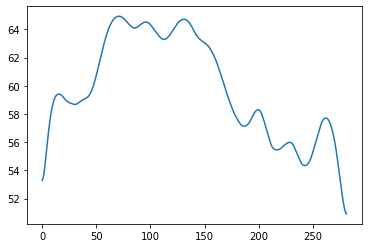

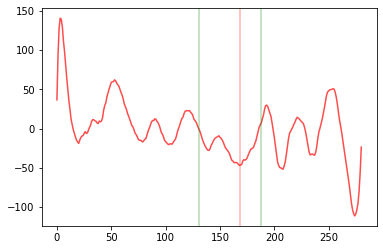

D =  0.8968085106382978 D_index =  168
max 0.8186835106382978 Cueve[D_index] 60.074333


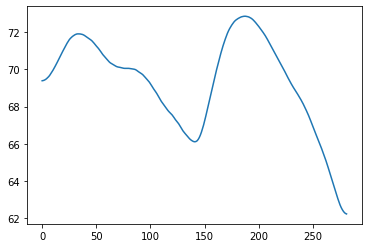

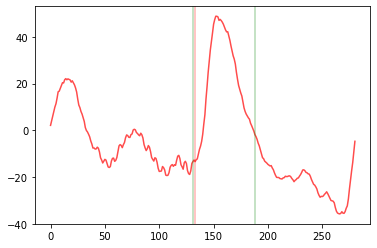

D =  0.7106382978723403 D_index =  133
max 0.7 Cueve[D_index] 66.48137
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 3217.5, 3245.0, 327

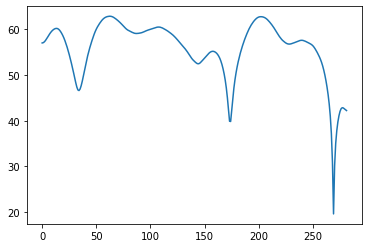

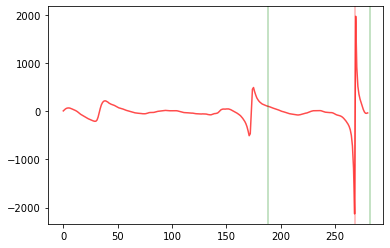

D =  1.425531914893617 D_index =  268
max 1.347406914893617 Cueve[D_index] 30.93315


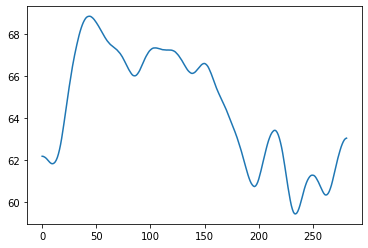

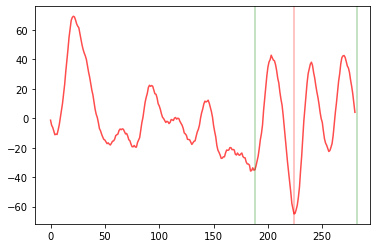

D =  1.1914893617021276 D_index =  224
max 1.1133643617021276 Cueve[D_index] 61.700447


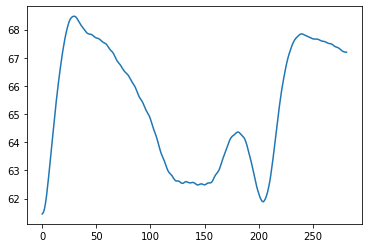

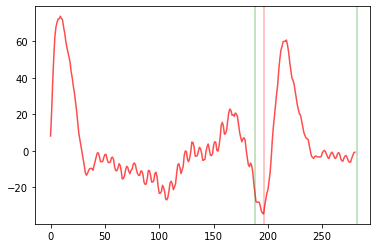

D =  1.0425531914893618 D_index =  196
max 1 Cueve[D_index] 62.784355
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 3217.5, 3245.0, 3272

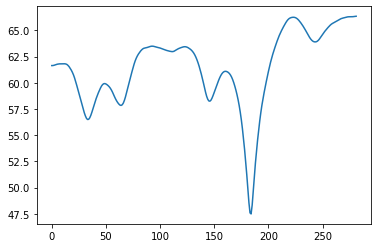

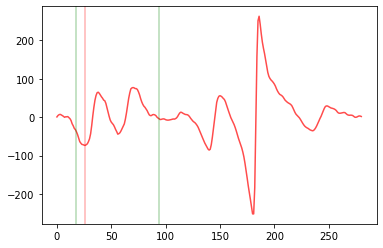

D =  0.1425531914893617 D_index =  26
max 0.1 Cueve[D_index] 58.62121


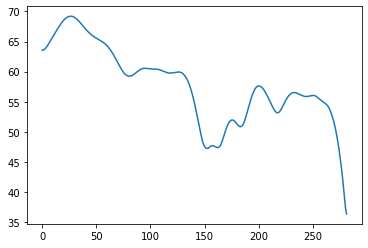

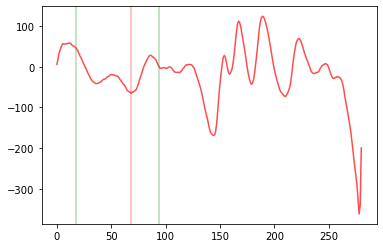

D =  0.3659574468085106 D_index =  68
max 0.3190824468085106 Cueve[D_index] 62.08951


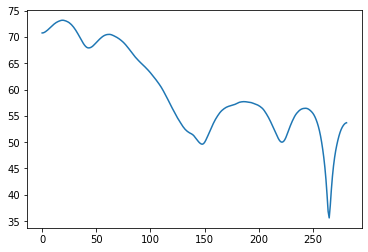

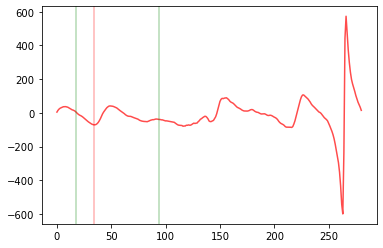

D =  0.1851063829787234 D_index =  34
max 0.1382313829787234 Cueve[D_index] 70.22606
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 3217.

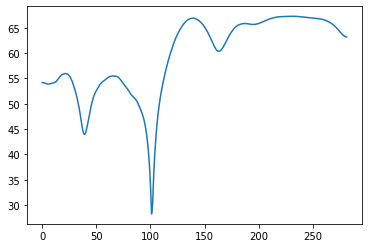

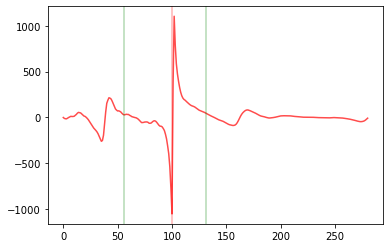

D =  0.5340425531914894 D_index =  100
max 0.4559175531914894 Cueve[D_index] 33.84026


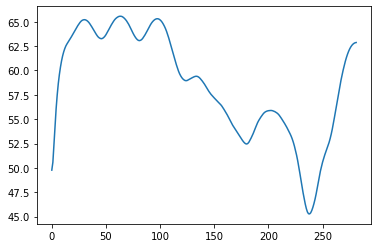

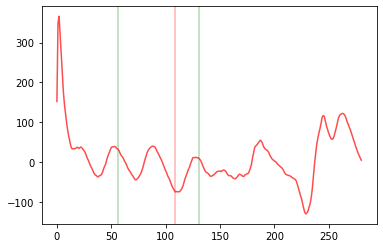

D =  0.5819148936170213 D_index =  109
max 0.5037898936170213 Cueve[D_index] 62.93867


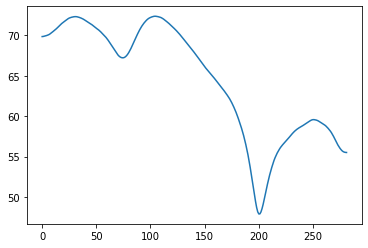

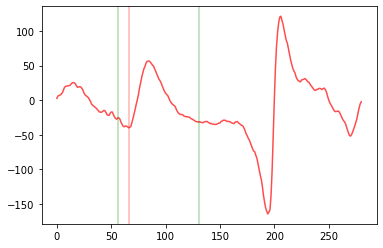

D =  0.35319148936170214 D_index =  66
max 0.3 Cueve[D_index] 68.362564
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 3217.5, 3245.0, 32

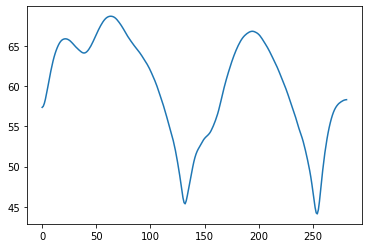

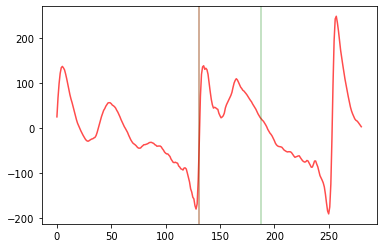

D =  0.7 D_index =  131
max 0.7 Cueve[D_index] 45.512424


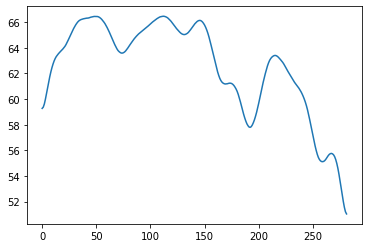

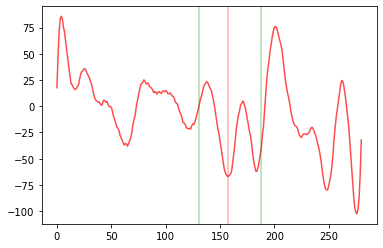

D =  0.8382978723404255 D_index =  157
max 0.7601728723404255 Cueve[D_index] 63.827454


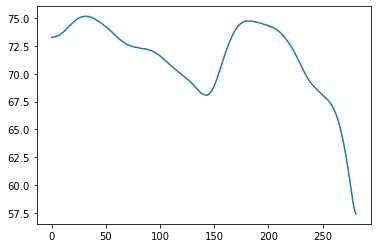

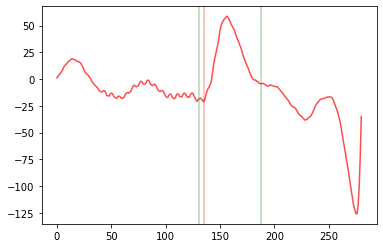

D =  0.7212765957446808 D_index =  135
max 0.7 Cueve[D_index] 68.551704
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 3217.5, 3245.0, 32

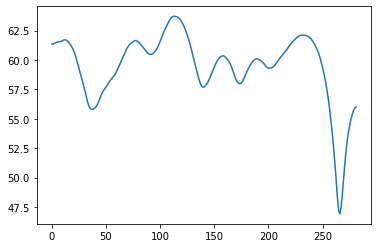

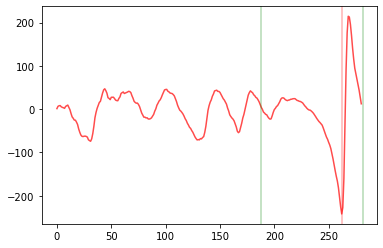

D =  1.3936170212765957 D_index =  262
max 1.3154920212765957 Cueve[D_index] 50.47411


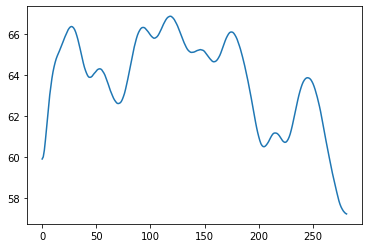

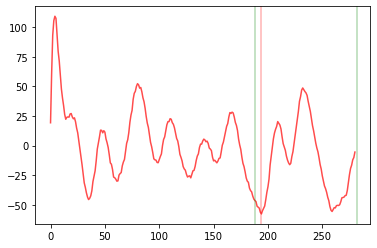

D =  1.0319148936170213 D_index =  194
max 1 Cueve[D_index] 62.569263


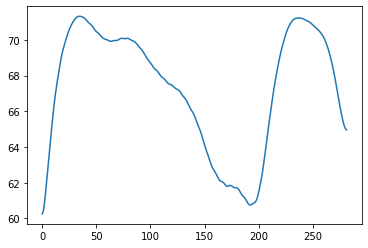

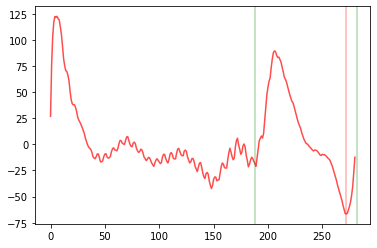

D =  1.4468085106382977 D_index =  272
max 1.3686835106382977 Cueve[D_index] 67.28829
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 3217

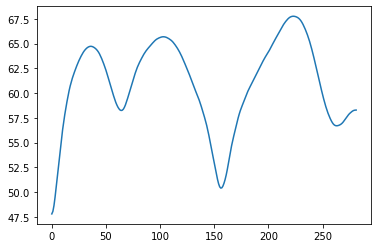

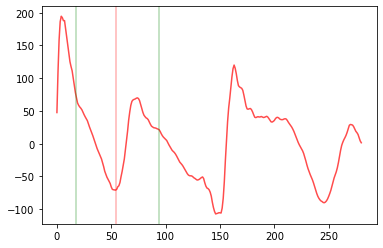

D =  0.2914893617021277 D_index =  54
max 0.2133643617021277 Cueve[D_index] 60.83584


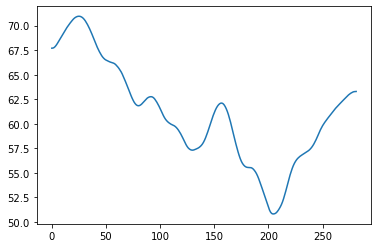

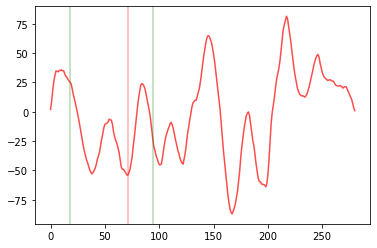

D =  0.38191489361702124 D_index =  71
max 0.30378989361702124 Cueve[D_index] 63.47558


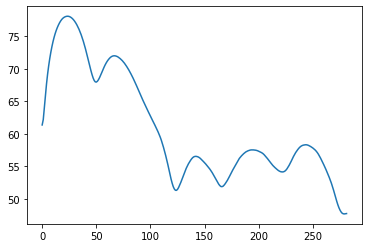

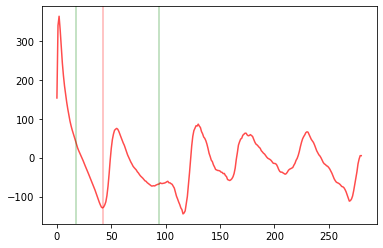

D =  0.2276595744680851 D_index =  42
max 0.1495345744680851 Cueve[D_index] 71.75954
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 3217.

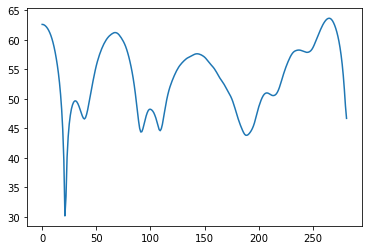

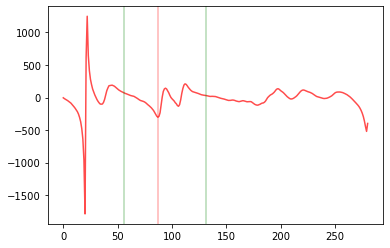

D =  0.4648936170212766 D_index =  87
max 0.3867686170212766 Cueve[D_index] 49.408985


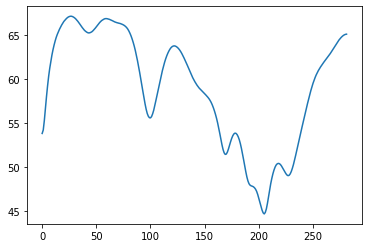

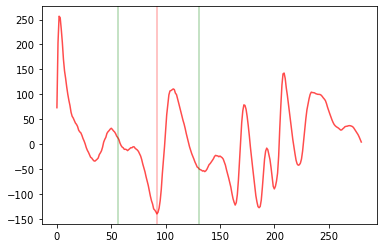

D =  0.49148936170212765 D_index =  92
max 0.41336436170212765 Cueve[D_index] 59.314384


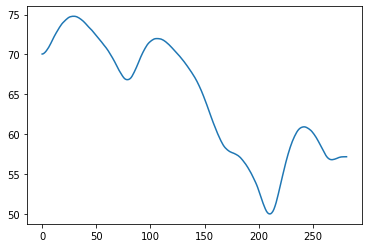

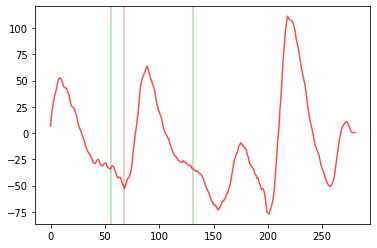

D =  0.3638297872340425 D_index =  68
max 0.3 Cueve[D_index] 68.801865
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 3217.5, 3245.0, 327

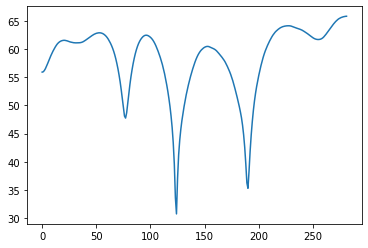

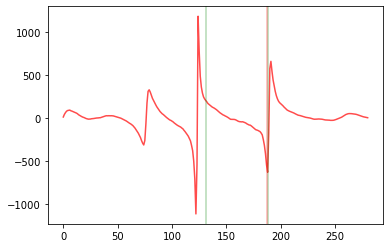

D =  0.9978723404255319 D_index =  187
max 0.9197473404255319 Cueve[D_index] 42.563637


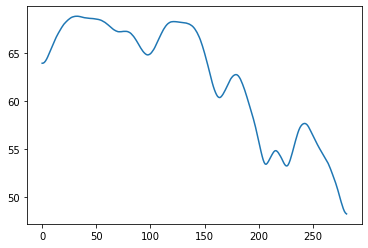

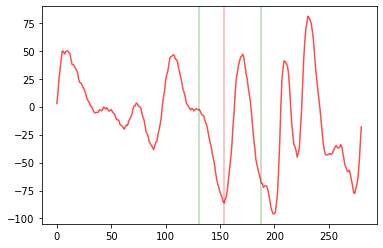

D =  0.8223404255319149 D_index =  154
max 0.7442154255319149 Cueve[D_index] 63.217884


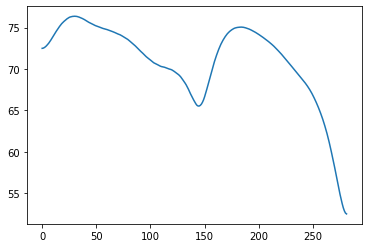

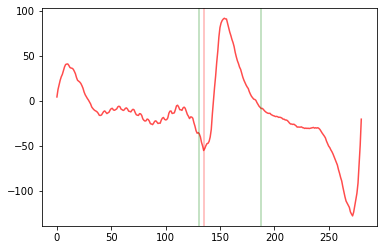

D =  0.7212765957446808 D_index =  135
max 0.7 Cueve[D_index] 67.55383
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 3217.5, 3245.0, 327

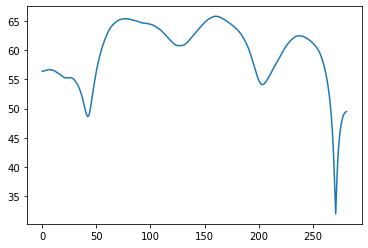

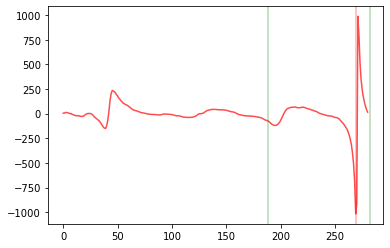

D =  1.4308510638297873 D_index =  269
max 1.3527260638297873 Cueve[D_index] 42.290142


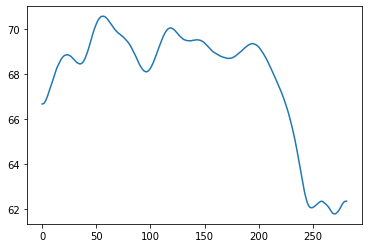

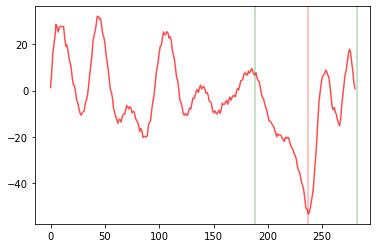

D =  1.2606382978723405 D_index =  237
max 1.1825132978723405 Cueve[D_index] 64.13983


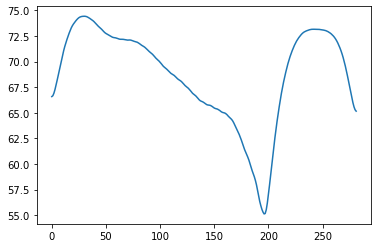

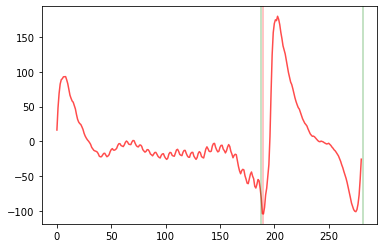

D =  1.0106382978723405 D_index =  190
max 1 Cueve[D_index] 57.3953
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 3217.5, 3245.0, 3272.5

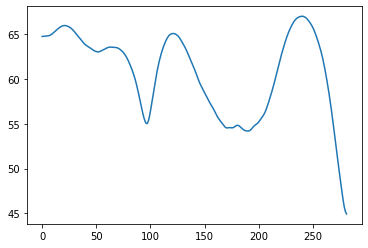

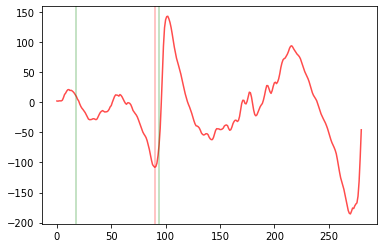

D =  0.4829787234042553 D_index =  90
max 0.4048537234042553 Cueve[D_index] 57.80588


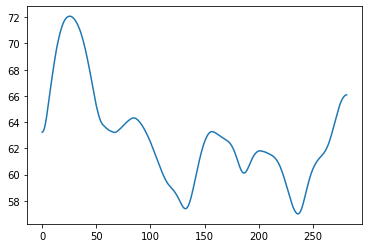

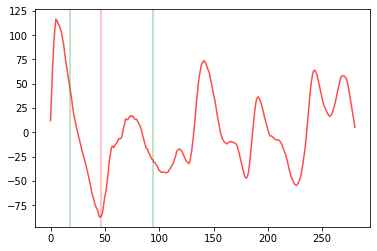

D =  0.24893617021276596 D_index =  46
max 0.17081117021276596 Cueve[D_index] 66.98145


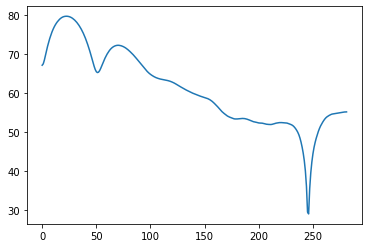

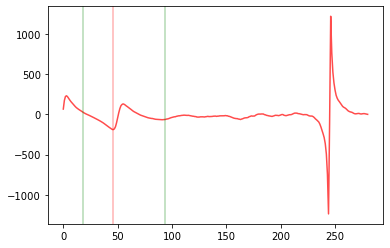

D =  0.24893617021276596 D_index =  46
max 0.17081117021276596 Cueve[D_index] 68.73188
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 321

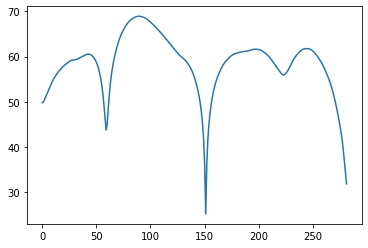

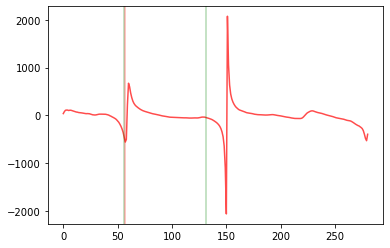

D =  0.3053191489361702 D_index =  57
max 0.3 Cueve[D_index] 49.43988


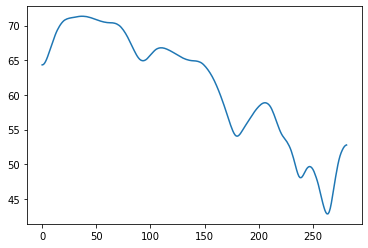

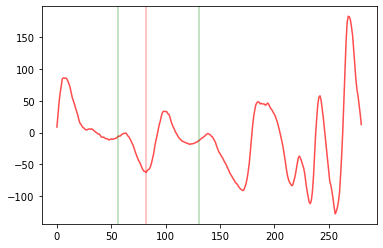

D =  0.4382978723404255 D_index =  82
max 0.3914228723404255 Cueve[D_index] 67.3472


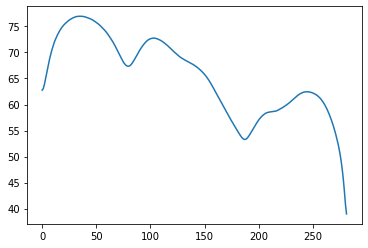

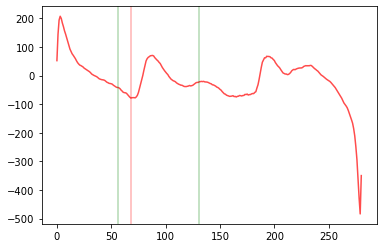

D =  0.3638297872340425 D_index =  68
max 0.3169547872340425 Cueve[D_index] 70.98384
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 3217.

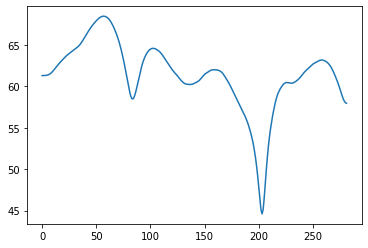

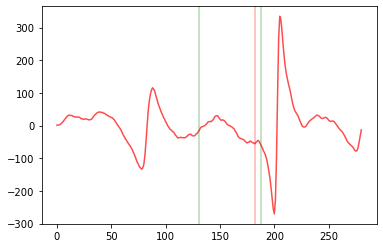

D =  0.9712765957446807 D_index =  182
max 0.9244015957446807 Cueve[D_index] 57.8223


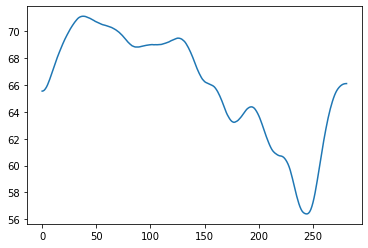

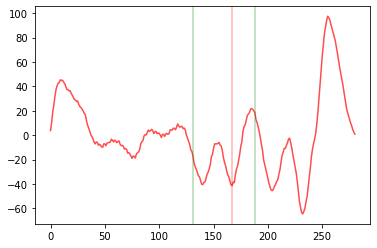

D =  0.8914893617021276 D_index =  167
max 0.8446143617021276 Cueve[D_index] 64.58776


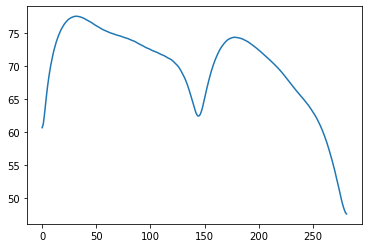

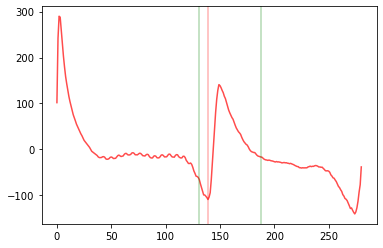

D =  0.7425531914893616 D_index =  139
max 0.7 Cueve[D_index] 64.583855
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 3217.5, 3245.0, 32

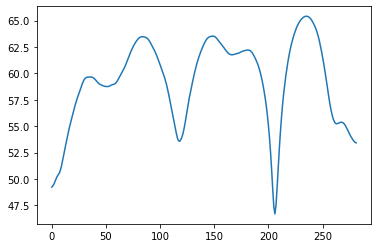

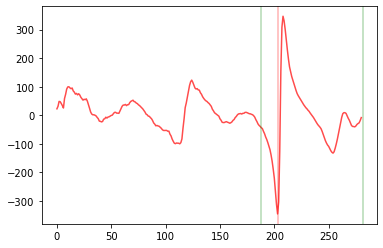

D =  1.0797872340425532 D_index =  203
max 1.0016622340425532 Cueve[D_index] 50.818413


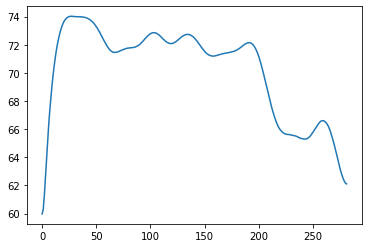

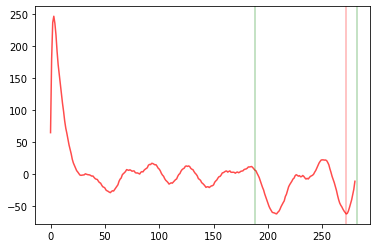

D =  1.4468085106382977 D_index =  272
max 1.3686835106382977 Cueve[D_index] 64.16201


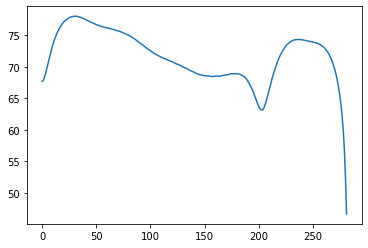

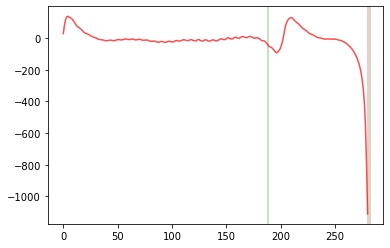

D =  1.4893617021276595 D_index =  280
max 1.4112367021276595 Cueve[D_index] 52.56958
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 3217

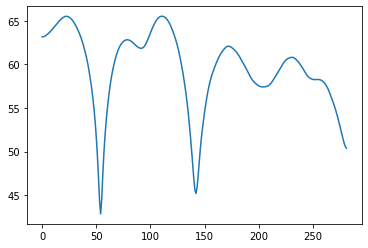

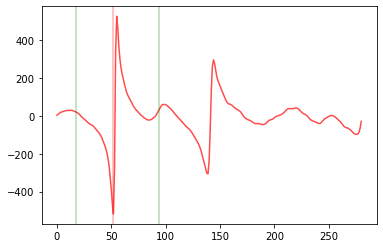

D =  0.2808510638297872 D_index =  52
max 0.2339760638297872 Cueve[D_index] 47.04715


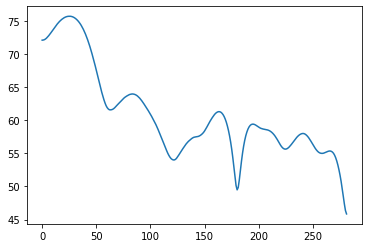

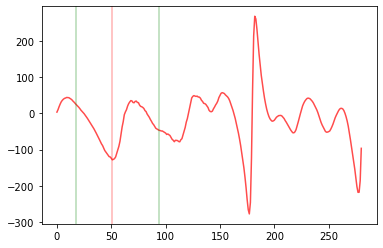

D =  0.27553191489361706 D_index =  51
max 0.22865691489361706 Cueve[D_index] 66.888176


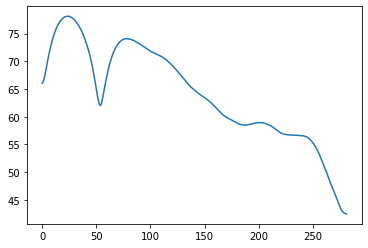

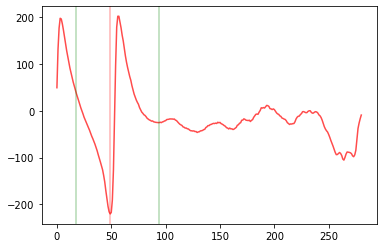

D =  0.26489361702127656 D_index =  49
max 0.21801861702127656 Cueve[D_index] 66.15781
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 321

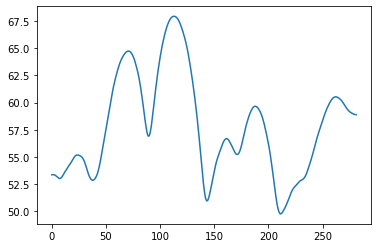

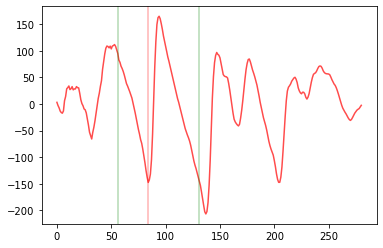

D =  0.44893617021276594 D_index =  84
max 0.40206117021276594 Cueve[D_index] 60.013004


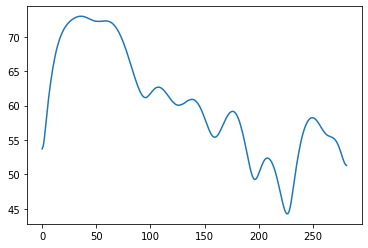

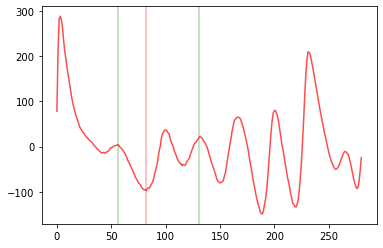

D =  0.4382978723404255 D_index =  82
max 0.3914228723404255 Cueve[D_index] 65.83785


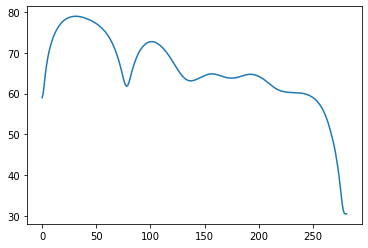

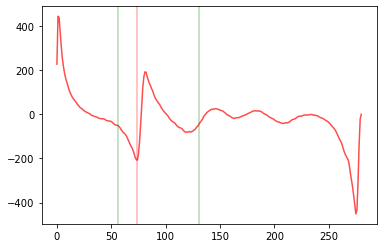

D =  0.39574468085106385 D_index =  74
max 0.34886968085106385 Cueve[D_index] 64.75065
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 321

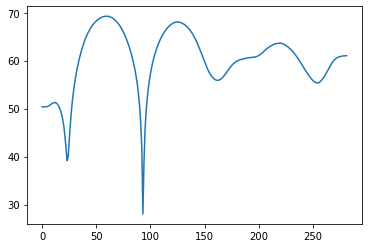

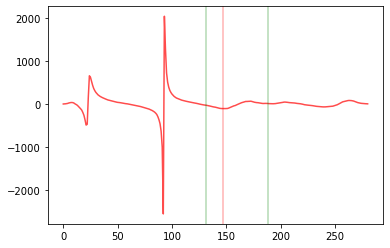

D =  0.7851063829787234 D_index =  147
max 0.7382313829787234 Cueve[D_index] 61.52852


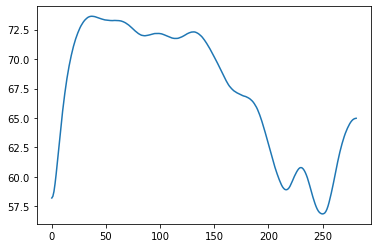

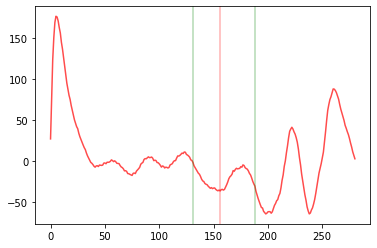

D =  0.8329787234042553 D_index =  156
max 0.7861037234042553 Cueve[D_index] 69.08176


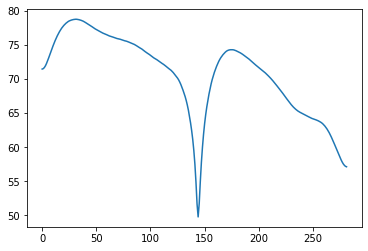

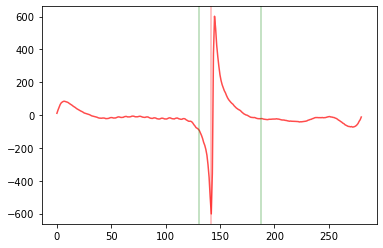

D =  0.7585106382978724 D_index =  142
max 0.7116356382978724 Cueve[D_index] 54.822746
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 321

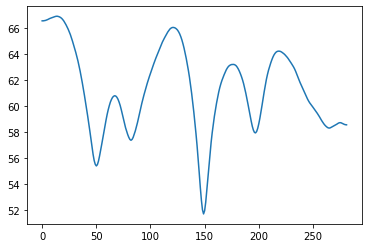

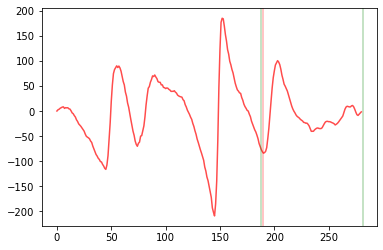

D =  1.0106382978723405 D_index =  190
max 1 Cueve[D_index] 60.1604


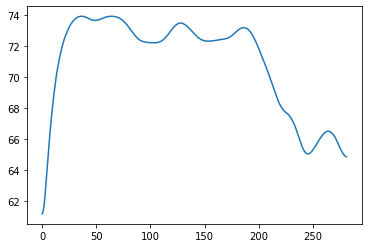

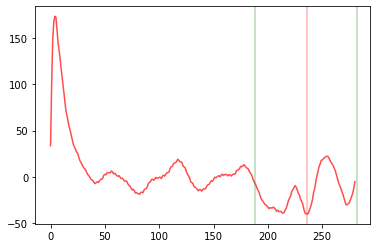

D =  1.2553191489361701 D_index =  236
max 1.2084441489361701 Cueve[D_index] 66.314


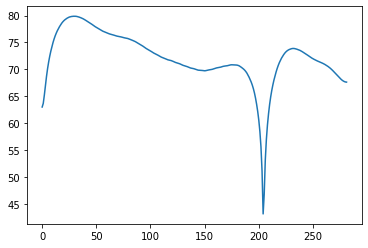

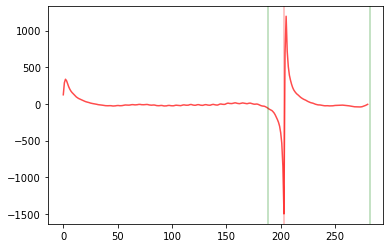

D =  1.0797872340425532 D_index =  203
max 1.0329122340425532 Cueve[D_index] 51.070595
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 321

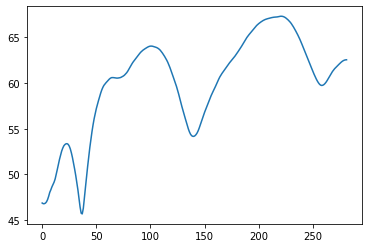

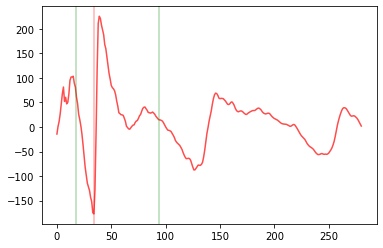

D =  0.1851063829787234 D_index =  34
max 0.1382313829787234 Cueve[D_index] 47.374527


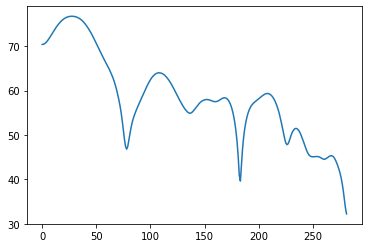

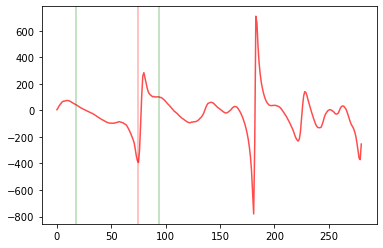

D =  0.4031914893617021 D_index =  75
max 0.3563164893617021 Cueve[D_index] 51.05441


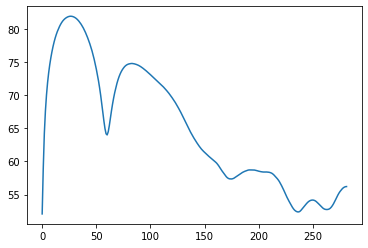

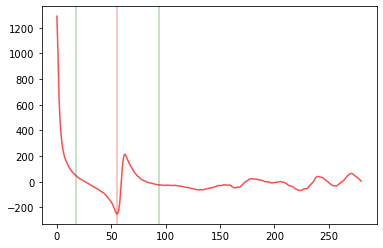

D =  0.2968085106382979 D_index =  55
max 0.24993351063829788 Cueve[D_index] 68.769196
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 321

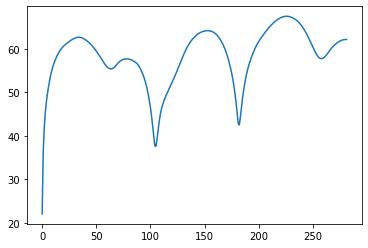

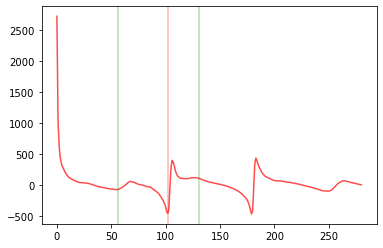

D =  0.5446808510638298 D_index =  102
max 0.4978058510638298 Cueve[D_index] 42.220566


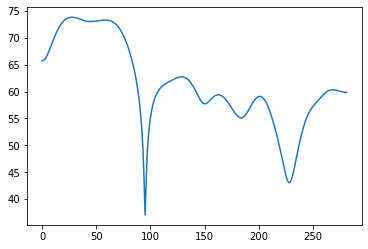

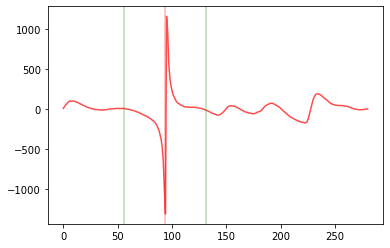

D =  0.502127659574468 D_index =  94
max 0.45525265957446803 Cueve[D_index] 44.05802


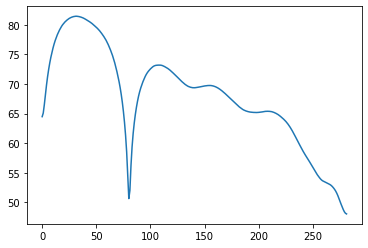

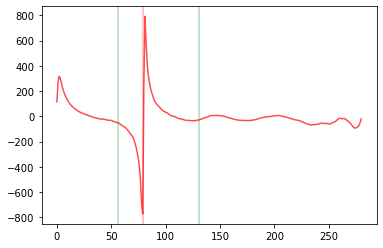

D =  0.42234042553191486 D_index =  79
max 0.37546542553191486 Cueve[D_index] 54.74478
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 321

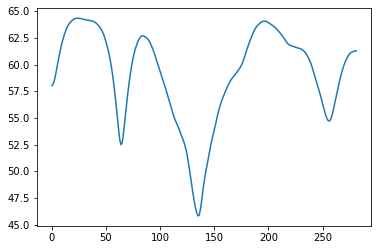

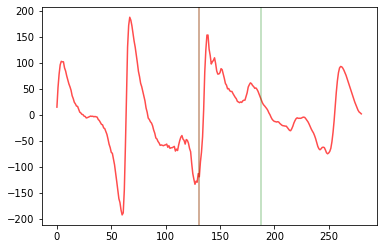

D =  0.7 D_index =  131
max 0.7 Cueve[D_index] 47.548645


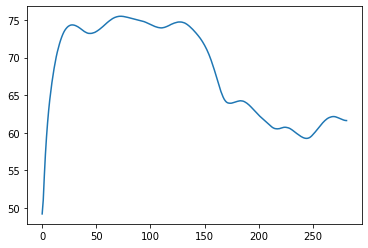

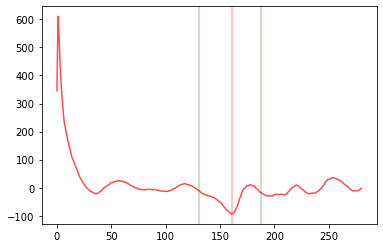

D =  0.8595744680851063 D_index =  161
max 0.7814494680851063 Cueve[D_index] 67.378944


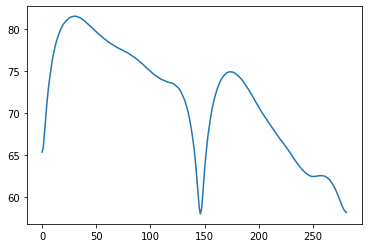

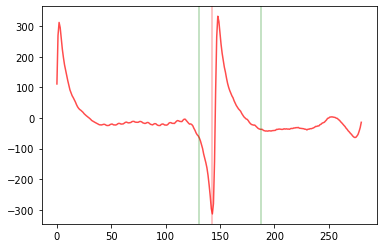

D =  0.7638297872340425 D_index =  143
max 0.7 Cueve[D_index] 61.91781
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 3217.5, 3245.0, 327

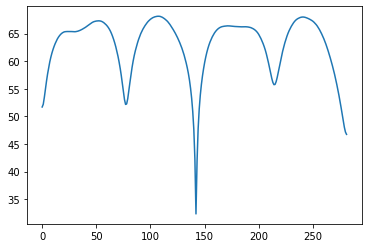

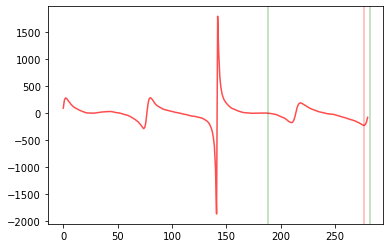

D =  1.4734042553191489 D_index =  277
max 1.3952792553191489 Cueve[D_index] 50.366005


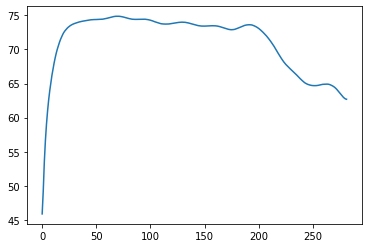

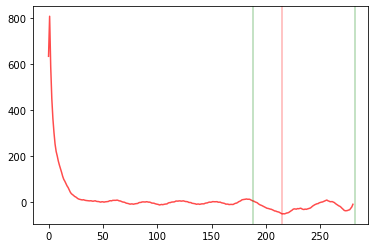

D =  1.1436170212765957 D_index =  215
max 1.0654920212765957 Cueve[D_index] 70.21014


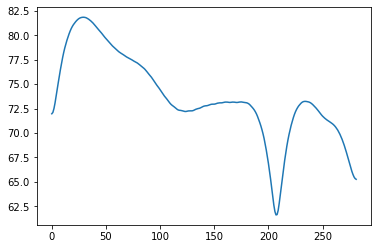

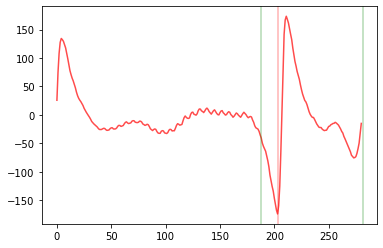

D =  1.0797872340425532 D_index =  203
max 1.0016622340425532 Cueve[D_index] 64.38224
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 3217

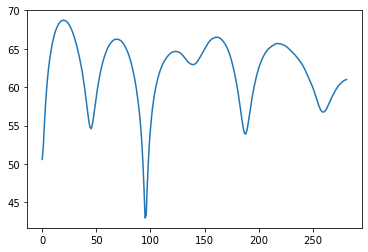

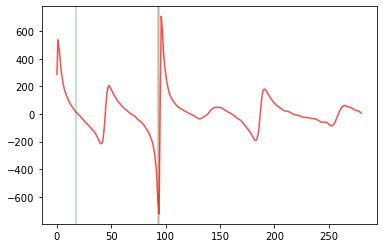

D =  0.49893617021276593 D_index =  93
max 0.45206117021276593 Cueve[D_index] 50.225006


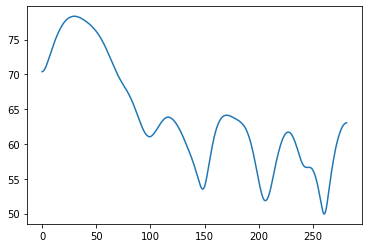

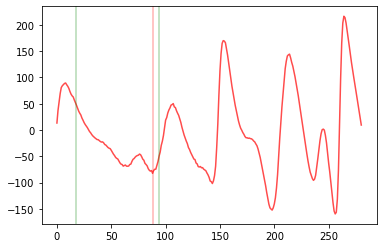

D =  0.4723404255319149 D_index =  88
max 0.4254654255319149 Cueve[D_index] 64.159164


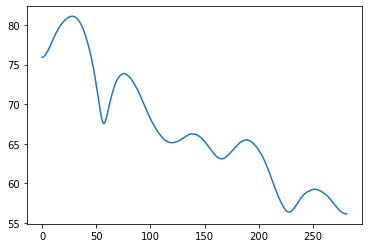

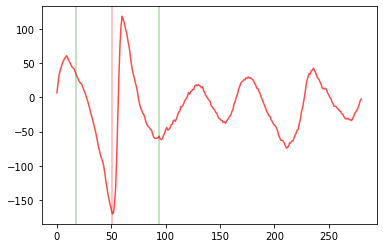

D =  0.27553191489361706 D_index =  51
max 0.22865691489361706 Cueve[D_index] 71.53071
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 321

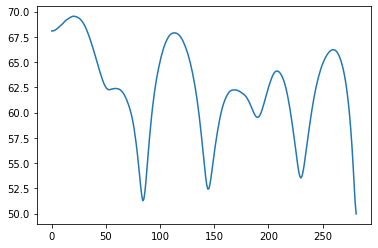

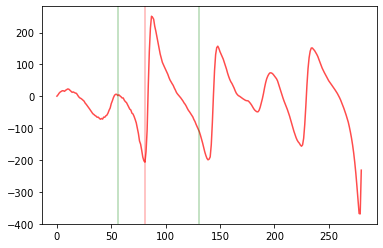

D =  0.4329787234042553 D_index =  81
max 0.3861037234042553 Cueve[D_index] 53.85651


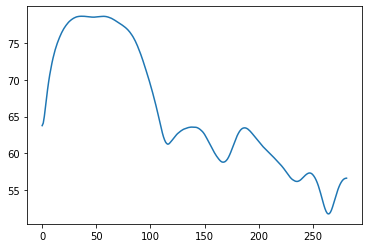

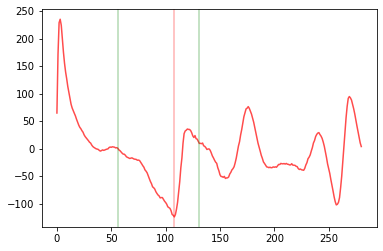

D =  0.5765957446808511 D_index =  108
max 0.5297207446808511 Cueve[D_index] 64.65663


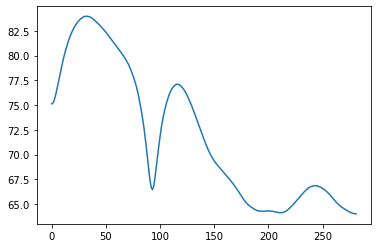

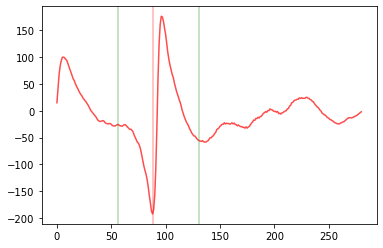

D =  0.47021276595744677 D_index =  88
max 0.42333776595744677 Cueve[D_index] 70.00647
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 321

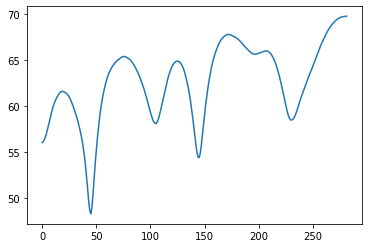

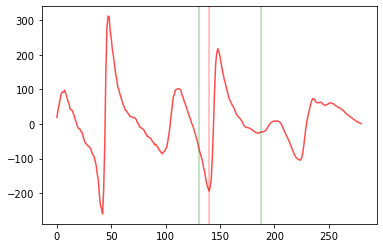

D =  0.7478723404255319 D_index =  140
max 0.7009973404255319 Cueve[D_index] 57.756023


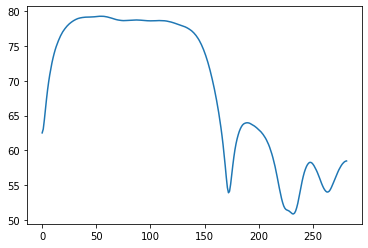

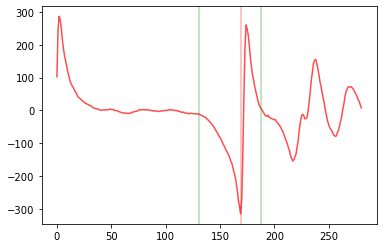

D =  0.902127659574468 D_index =  169
max 0.855252659574468 Cueve[D_index] 57.800774


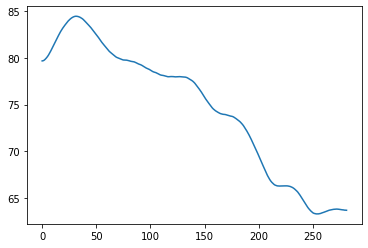

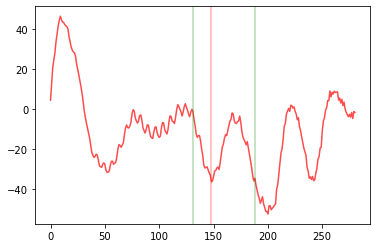

D =  0.7904255319148936 D_index =  148
max 0.7435505319148936 Cueve[D_index] 76.15219
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 3217

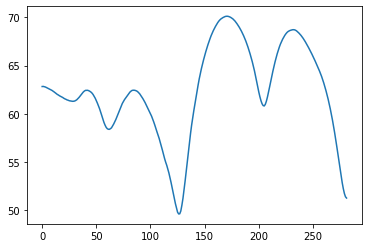

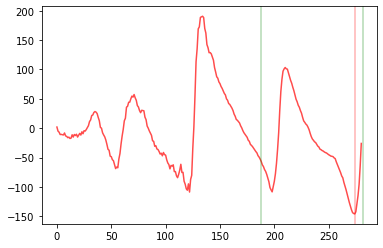

D =  1.4574468085106382 D_index =  274
max 1.4105718085106382 Cueve[D_index] 55.06819


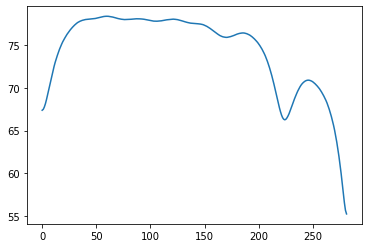

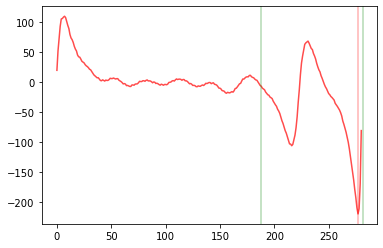

D =  1.4734042553191489 D_index =  277
max 1.4265292553191489 Cueve[D_index] 58.883522


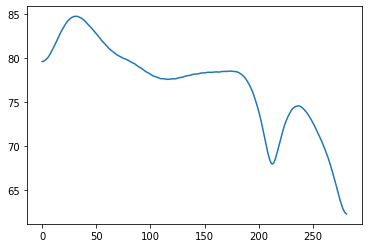

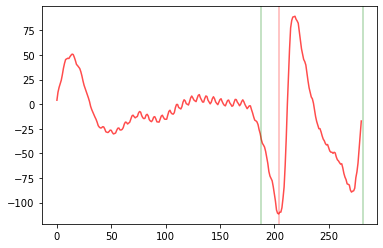

D =  1.0851063829787233 D_index =  204
max 1.0382313829787233 Cueve[D_index] 71.752335
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 321

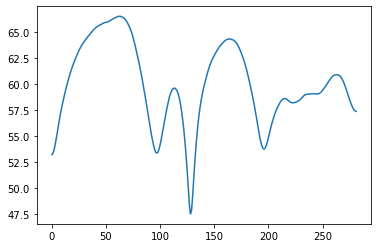

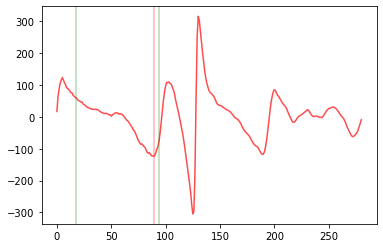

D =  0.47765957446808516 D_index =  89
max 0.43078457446808516 Cueve[D_index] 57.02145


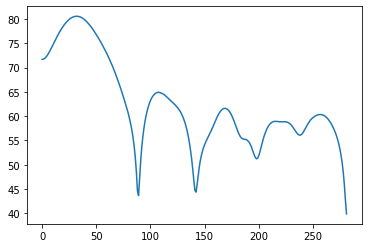

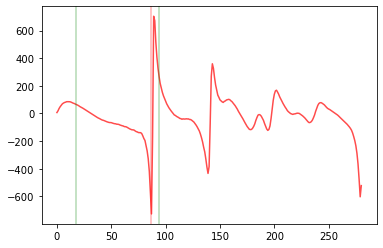

D =  0.46702127659574466 D_index =  87
max 0.42014627659574466 Cueve[D_index] 48.421158


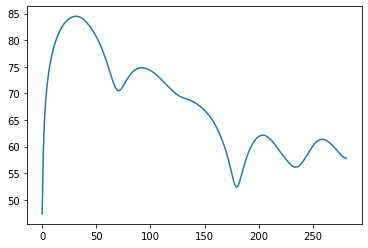

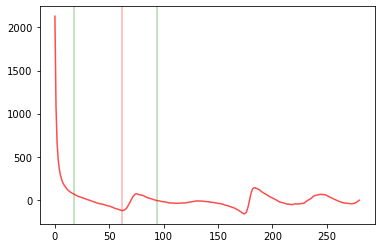

D =  0.33404255319148934 D_index =  62
max 0.28716755319148934 Cueve[D_index] 74.39046
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 321

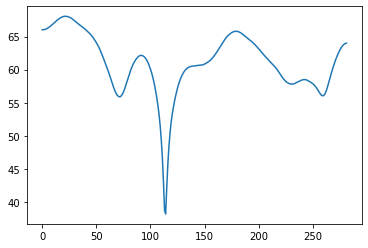

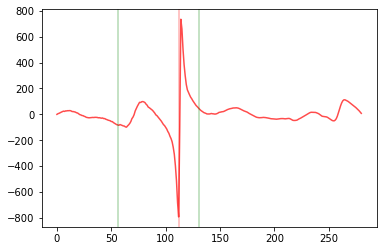

D =  0.597872340425532 D_index =  112
max 0.550997340425532 Cueve[D_index] 42.943474


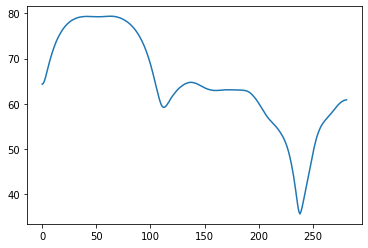

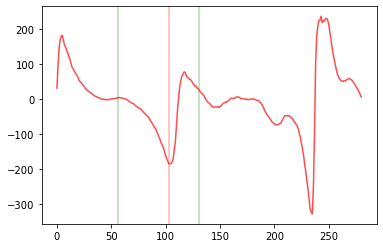

D =  0.55 D_index =  103
max 0.503125 Cueve[D_index] 66.03533


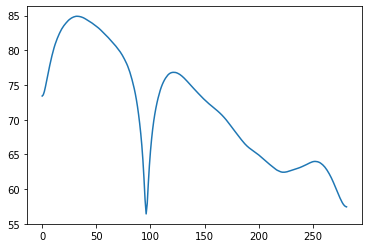

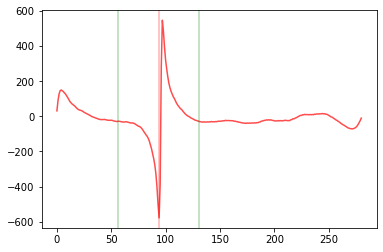

D =  0.502127659574468 D_index =  94
max 0.45525265957446803 Cueve[D_index] 61.5394
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 3217.5

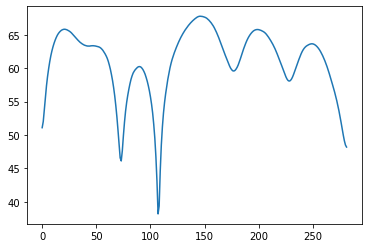

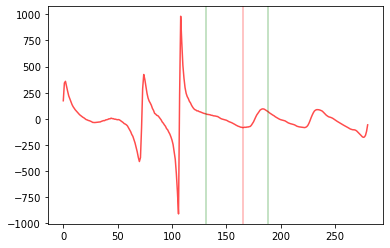

D =  0.8808510638297872 D_index =  165
max 0.8339760638297872 Cueve[D_index] 63.7155


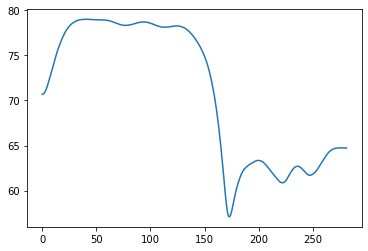

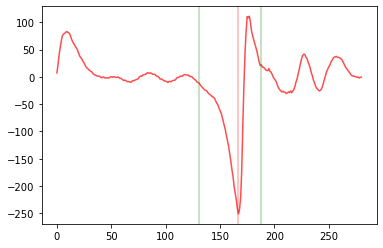

D =  0.8914893617021276 D_index =  167
max 0.8446143617021276 Cueve[D_index] 62.37121


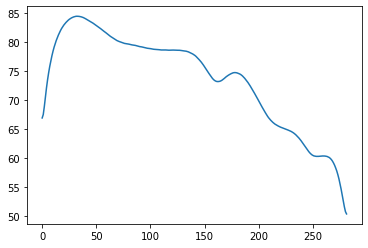

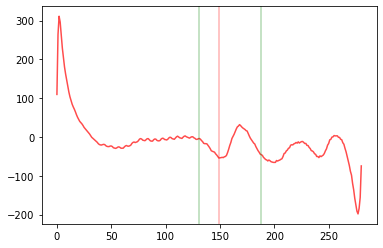

D =  0.7957446808510638 D_index =  149
max 0.7488696808510638 Cueve[D_index] 76.03256
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 3217

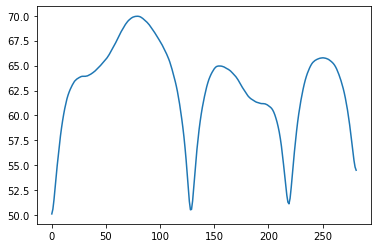

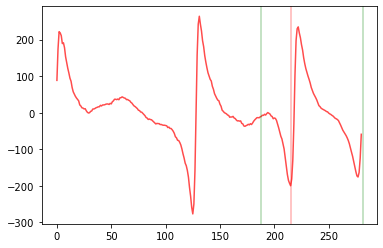

D =  1.1436170212765957 D_index =  215
max 1.0967420212765957 Cueve[D_index] 54.015003


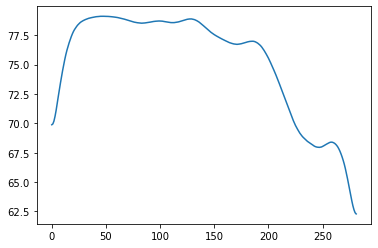

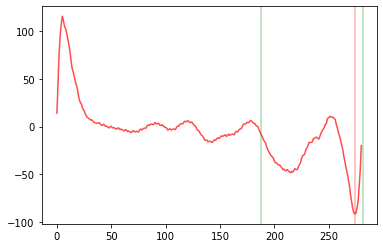

D =  1.4574468085106382 D_index =  274
max 1.4105718085106382 Cueve[D_index] 64.81735


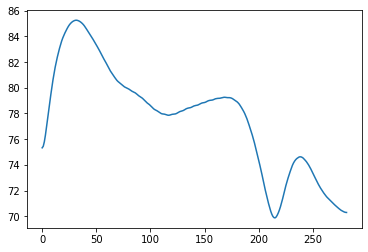

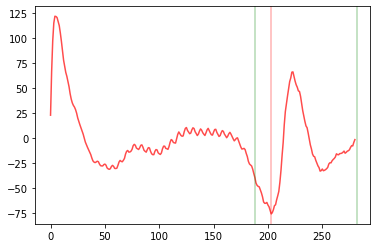

D =  1.0797872340425532 D_index =  203
max 1.0329122340425532 Cueve[D_index] 73.2169
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 3217.

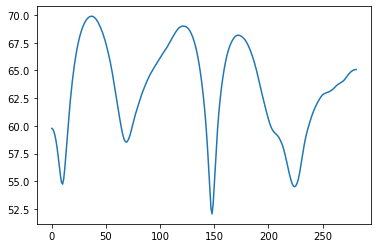

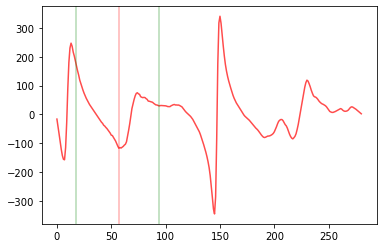

D =  0.3074468085106383 D_index =  57
max 0.2605718085106383 Cueve[D_index] 64.12612


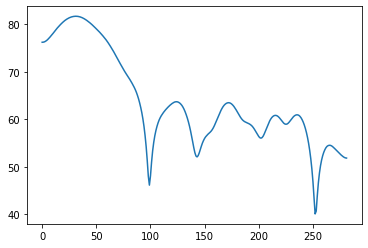

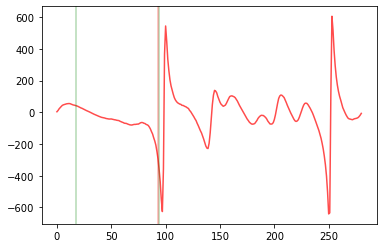

D =  0.49893617021276593 D_index =  93
max 0.45206117021276593 Cueve[D_index] 60.094345


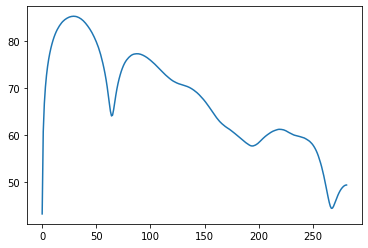

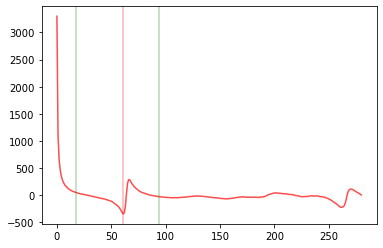

D =  0.32872340425531915 D_index =  61
max 0.28184840425531915 Cueve[D_index] 68.64507
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 321

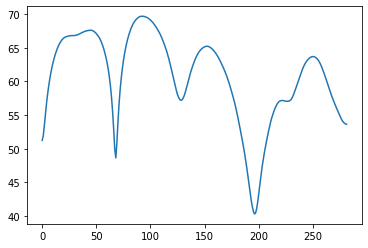

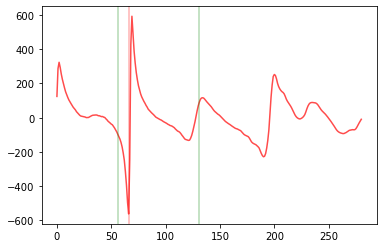

D =  0.35319148936170214 D_index =  66
max 0.30631648936170214 Cueve[D_index] 52.947685


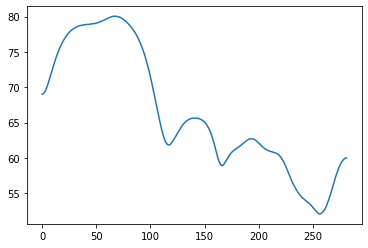

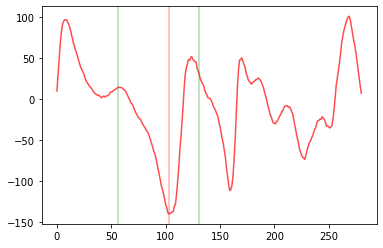

D =  0.55 D_index =  103
max 0.503125 Cueve[D_index] 69.319176


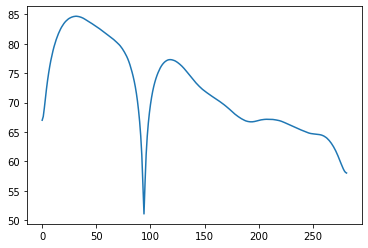

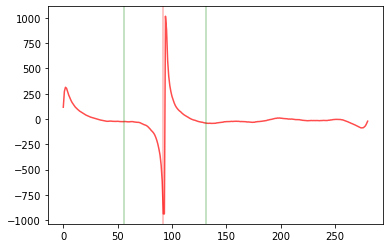

D =  0.49148936170212765 D_index =  92
max 0.44461436170212765 Cueve[D_index] 61.037815
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 32

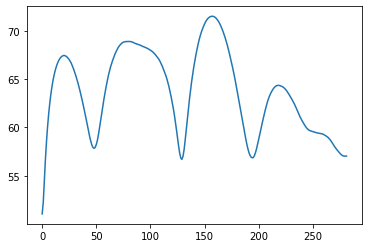

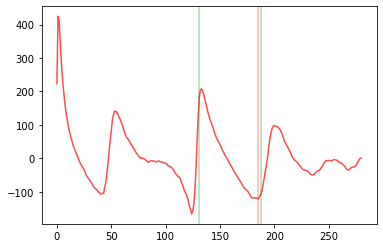

D =  0.9872340425531914 D_index =  185
max 0.9403590425531914 Cueve[D_index] 60.657524


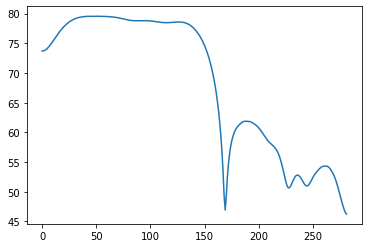

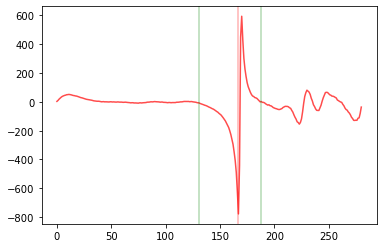

D =  0.8914893617021276 D_index =  167
max 0.8446143617021276 Cueve[D_index] 53.422813


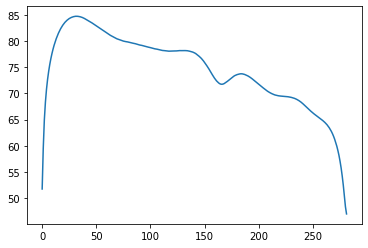

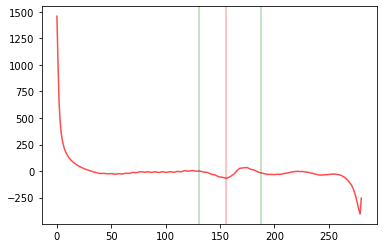

D =  0.8329787234042553 D_index =  156
max 0.7861037234042553 Cueve[D_index] 73.97221
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 3217

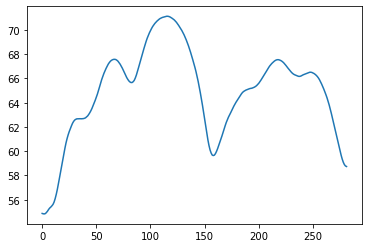

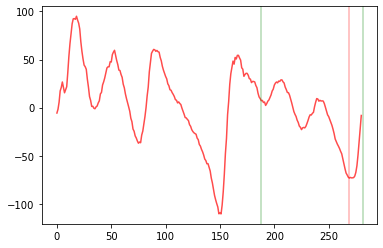

D =  1.4308510638297873 D_index =  269
max 1.3839760638297873 Cueve[D_index] 62.352547


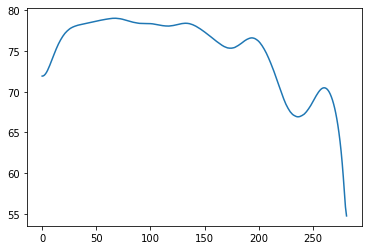

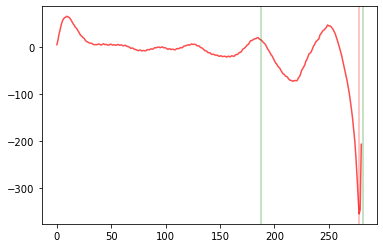

D =  1.478723404255319 D_index =  278
max 1.431848404255319 Cueve[D_index] 59.547565


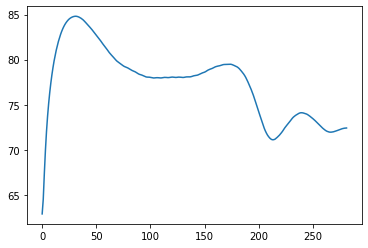

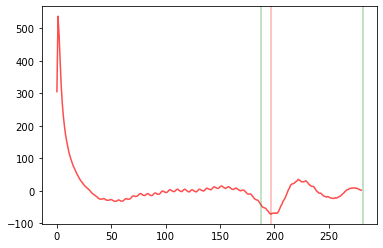

D =  1.047872340425532 D_index =  197
max 1.000997340425532 Cueve[D_index] 75.30348
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 3217.5

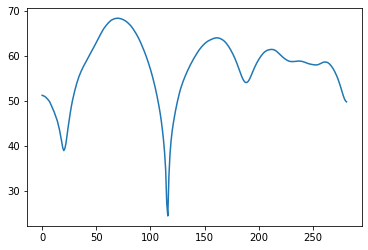

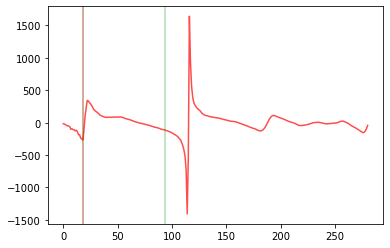

D =  0.1 D_index =  18
max 0.1 Cueve[D_index] 40.991425


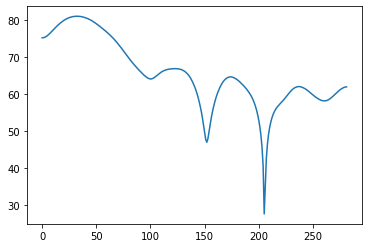

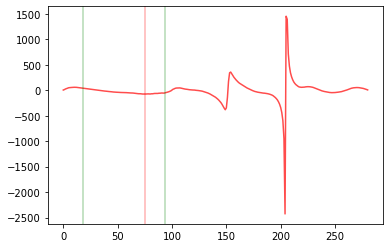

D =  0.4031914893617021 D_index =  75
max 0.3563164893617021 Cueve[D_index] 71.58413


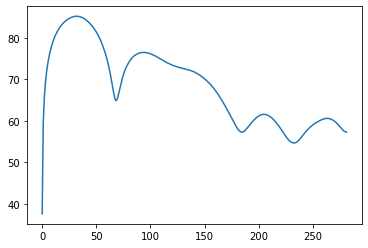

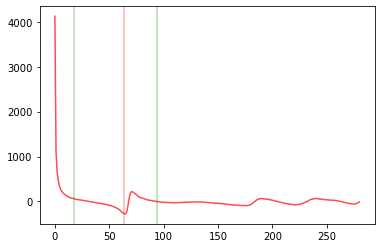

D =  0.3446808510638298 D_index =  64
max 0.2978058510638298 Cueve[D_index] 69.740616
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 3217

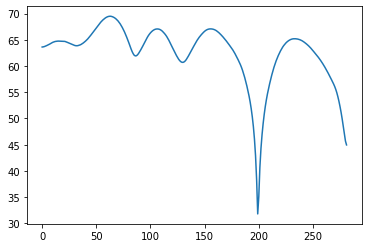

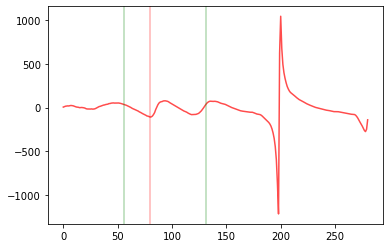

D =  0.4276595744680851 D_index =  80
max 0.3807845744680851 Cueve[D_index] 64.435936


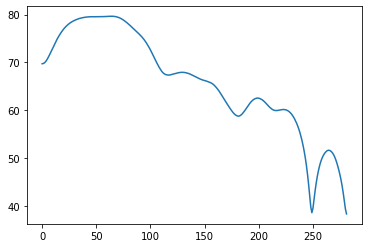

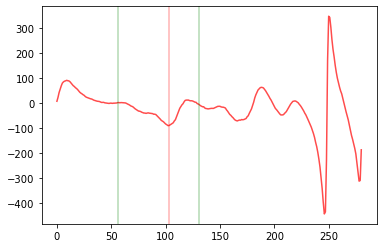

D =  0.55 D_index =  103
max 0.503125 Cueve[D_index] 71.22264


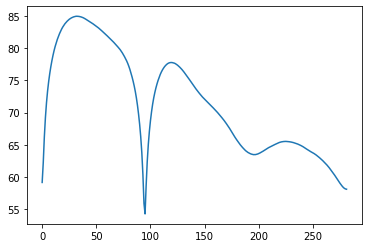

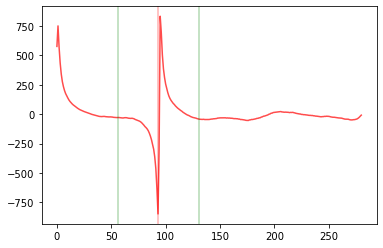

D =  0.4968085106382979 D_index =  93
max 0.4499335106382979 Cueve[D_index] 60.37478
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 3217.

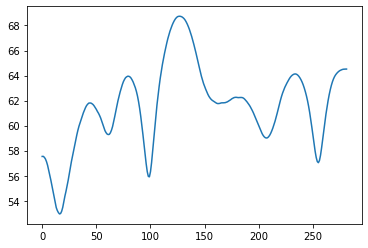

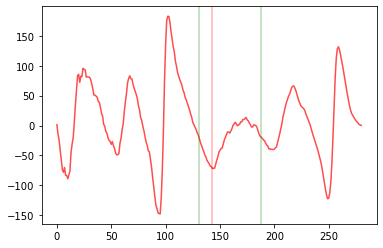

D =  0.7638297872340425 D_index =  143
max 0.7169547872340425 Cueve[D_index] 65.435486


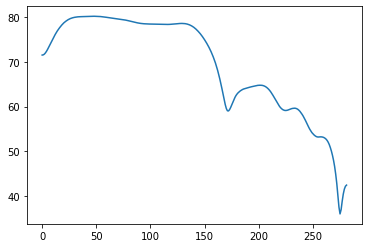

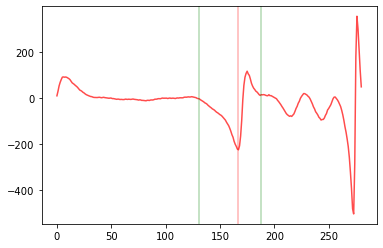

D =  0.8914893617021276 D_index =  167
max 0.8446143617021276 Cueve[D_index] 62.786724


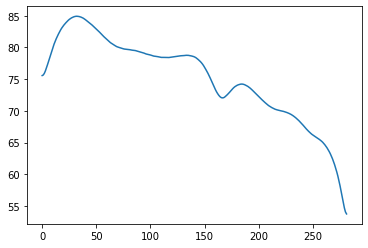

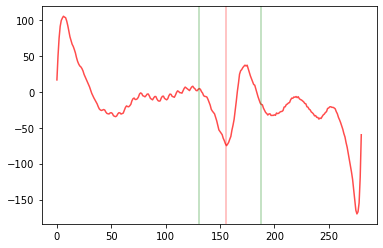

D =  0.8329787234042553 D_index =  156
max 0.7861037234042553 Cueve[D_index] 74.84162
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 3217

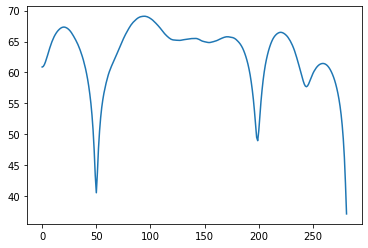

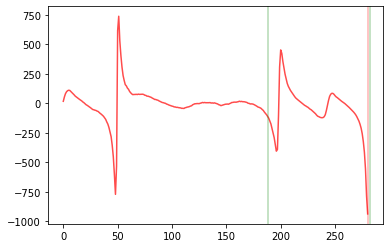

D =  1.4893617021276595 D_index =  280
max 1.4424867021276595 Cueve[D_index] 42.115402


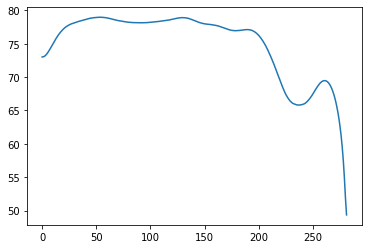

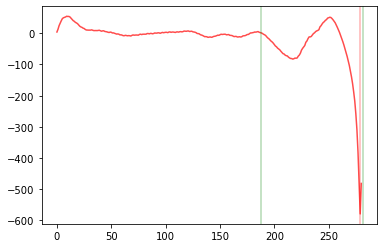

D =  1.4840425531914894 D_index =  279
max 1.4371675531914894 Cueve[D_index] 54.982082


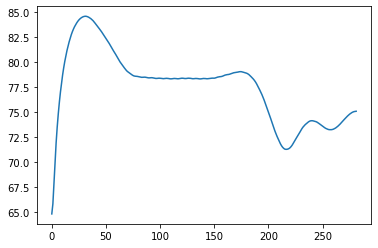

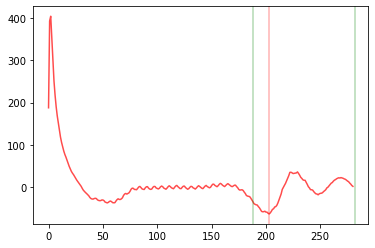

D =  1.0797872340425532 D_index =  203
max 1.0329122340425532 Cueve[D_index] 74.08071
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 3217

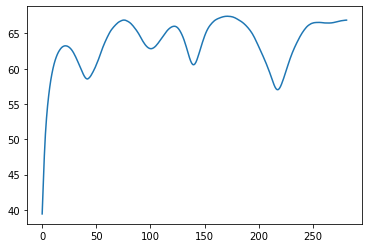

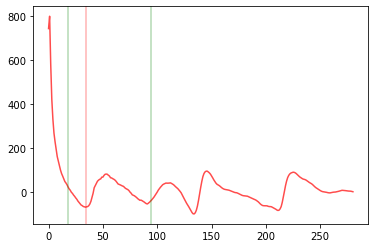

D =  0.1851063829787234 D_index =  34
max 0.1382313829787234 Cueve[D_index] 60.61013


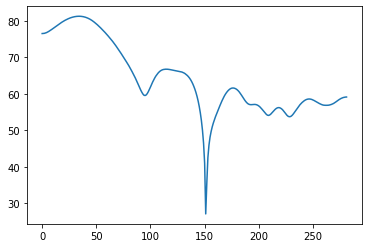

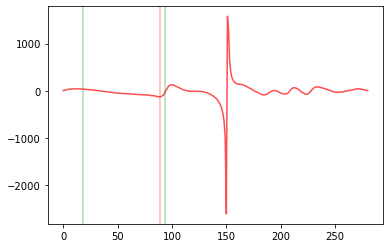

D =  0.47765957446808516 D_index =  89
max 0.43078457446808516 Cueve[D_index] 62.34978


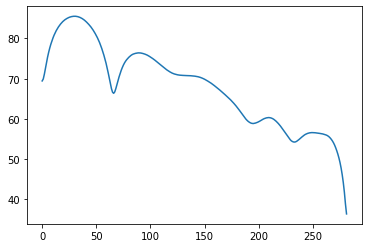

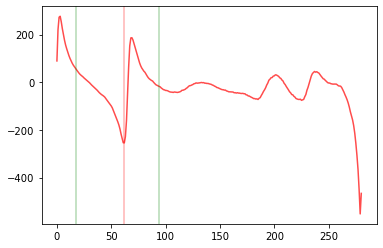

D =  0.33404255319148934 D_index =  62
max 0.28716755319148934 Cueve[D_index] 70.05904
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 321

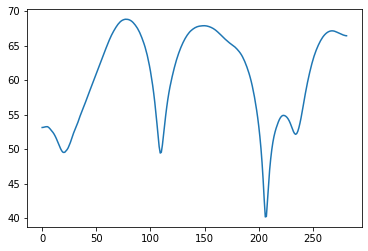

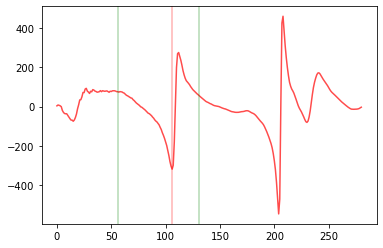

D =  0.5659574468085107 D_index =  106
max 0.5190824468085107 Cueve[D_index] 53.65747


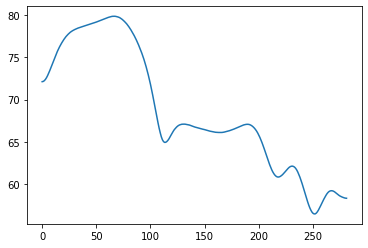

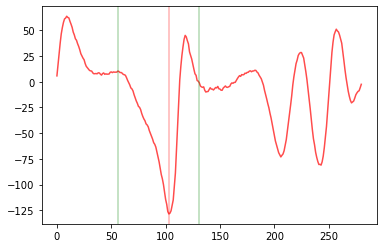

D =  0.55 D_index =  103
max 0.503125 Cueve[D_index] 69.89577


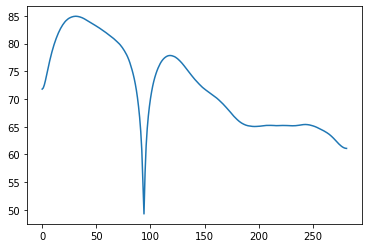

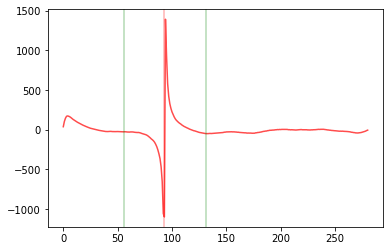

D =  0.4968085106382979 D_index =  93
max 0.4499335106382979 Cueve[D_index] 55.08511
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 3217.

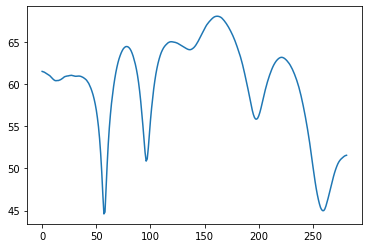

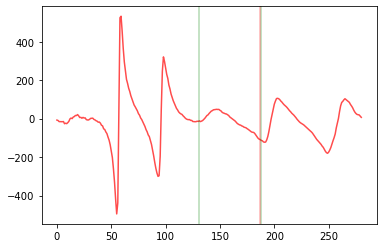

D =  0.9978723404255319 D_index =  187
max 0.9509973404255319 Cueve[D_index] 61.224743


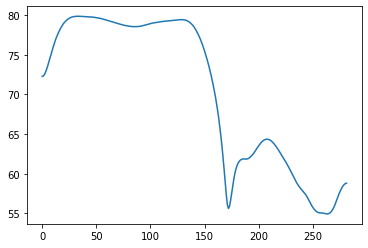

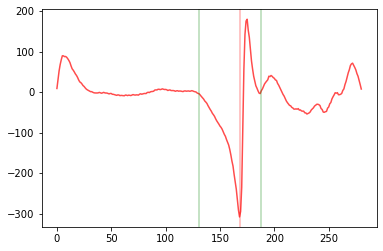

D =  0.8968085106382978 D_index =  168
max 0.8499335106382978 Cueve[D_index] 60.516087


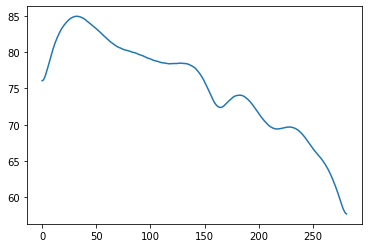

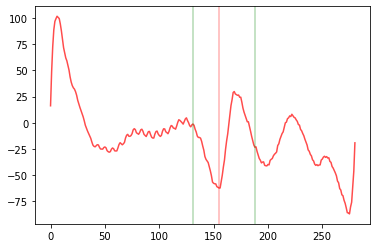

D =  0.827659574468085 D_index =  155
max 0.780784574468085 Cueve[D_index] 74.31764
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 3217.5

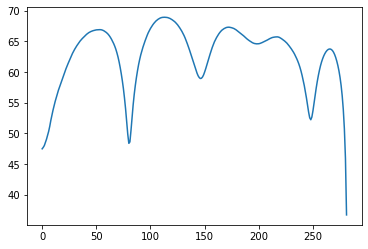

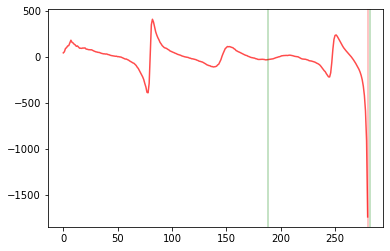

D =  1.4893617021276595 D_index =  280
max 1.4424867021276595 Cueve[D_index] 45.953636


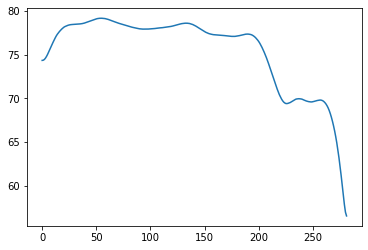

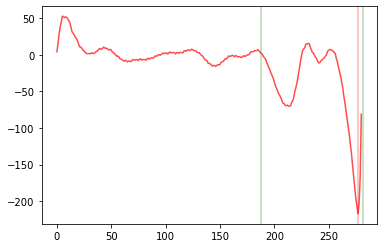

D =  1.4734042553191489 D_index =  277
max 1.4265292553191489 Cueve[D_index] 60.090244


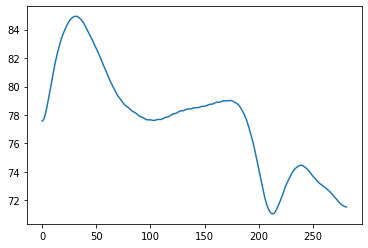

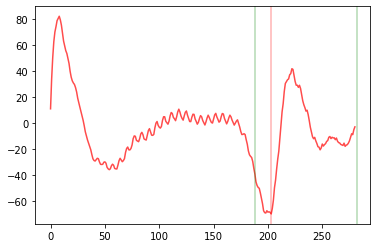

D =  1.0797872340425532 D_index =  203
max 1.0329122340425532 Cueve[D_index] 73.09937
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 3217

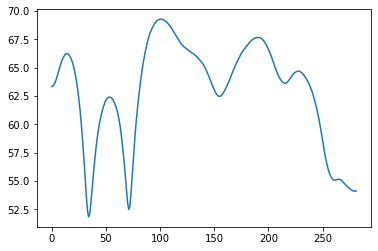

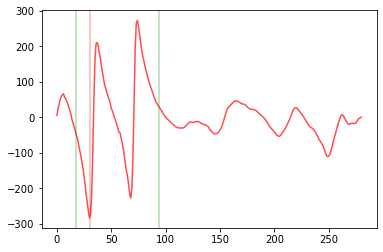

D =  0.16382978723404257 D_index =  30
max 0.11695478723404257 Cueve[D_index] 56.44697


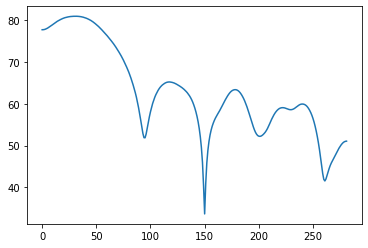

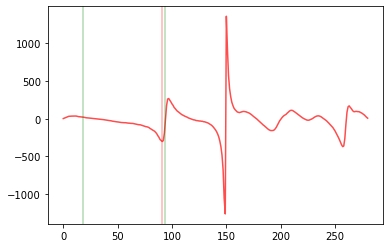

D =  0.48829787234042554 D_index =  91
max 0.44142287234042554 Cueve[D_index] 56.075993


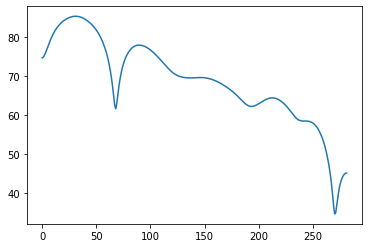

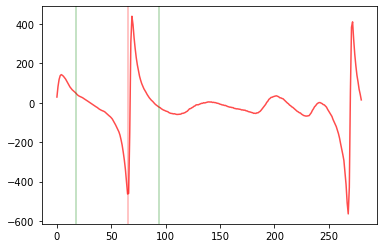

D =  0.35 D_index =  65
max 0.303125 Cueve[D_index] 67.26937
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 3217.5, 3245.0, 3272.5, 3300.

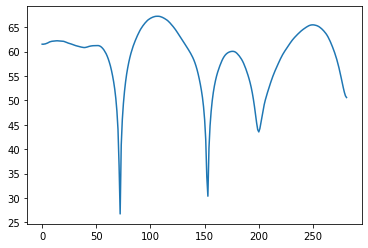

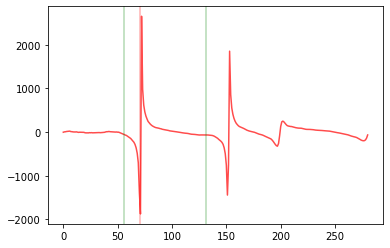

D =  0.3797872340425532 D_index =  71
max 0.3016622340425532 Cueve[D_index] 36.693363


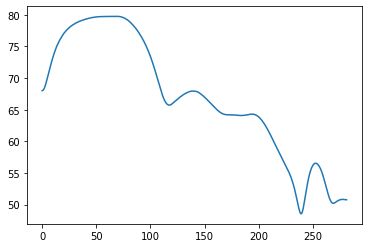

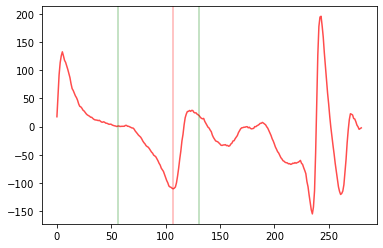

D =  0.5712765957446808 D_index =  107
max 0.4931515957446808 Cueve[D_index] 69.59042


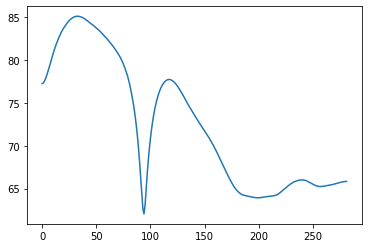

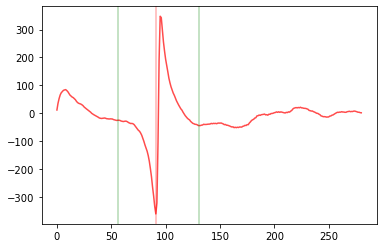

D =  0.4861702127659574 D_index =  91
max 0.4080452127659574 Cueve[D_index] 66.246895
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 3217

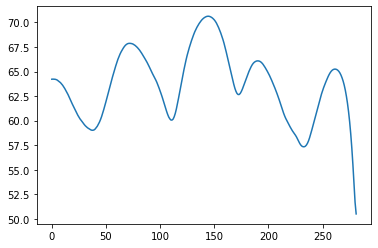

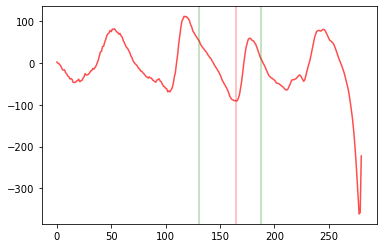

D =  0.8808510638297872 D_index =  165
max 0.8339760638297872 Cueve[D_index] 65.114716


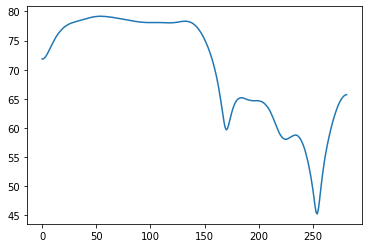

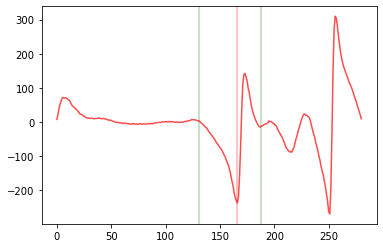

D =  0.8861702127659574 D_index =  166
max 0.8392952127659574 Cueve[D_index] 63.344254


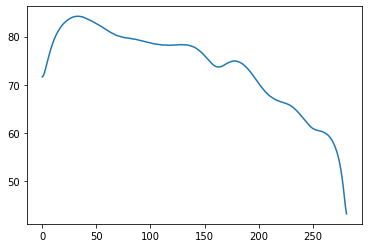

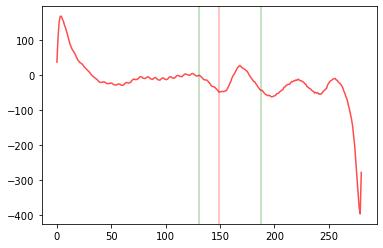

D =  0.7957446808510638 D_index =  149
max 0.7488696808510638 Cueve[D_index] 76.28677
calc_overtone_index [27.5, 55.0, 82.5, 110.0, 137.5, 165.0, 192.5, 220.0, 247.5, 275.0, 302.5, 330.0, 357.5, 385.0, 412.5, 440.0, 467.5, 495.0, 522.5, 550.0, 577.5, 605.0, 632.5, 660.0, 687.5, 715.0, 742.5, 770.0, 797.5, 825.0, 852.5, 880.0, 907.5, 935.0, 962.5, 990.0, 1017.5, 1045.0, 1072.5, 1100.0, 1127.5, 1155.0, 1182.5, 1210.0, 1237.5, 1265.0, 1292.5, 1320.0, 1347.5, 1375.0, 1402.5, 1430.0, 1457.5, 1485.0, 1512.5, 1540.0, 1567.5, 1595.0, 1622.5, 1650.0, 1677.5, 1705.0, 1732.5, 1760.0, 1787.5, 1815.0, 1842.5, 1870.0, 1897.5, 1925.0, 1952.5, 1980.0, 2007.5, 2035.0, 2062.5, 2090.0, 2117.5, 2145.0, 2172.5, 2200.0, 2227.5, 2255.0, 2282.5, 2310.0, 2337.5, 2365.0, 2392.5, 2420.0, 2447.5, 2475.0, 2502.5, 2530.0, 2557.5, 2585.0, 2612.5, 2640.0, 2667.5, 2695.0, 2722.5, 2750.0, 2777.5, 2805.0, 2832.5, 2860.0, 2887.5, 2915.0, 2942.5, 2970.0, 2997.5, 3025.0, 3052.5, 3080.0, 3107.5, 3135.0, 3162.5, 3190.0, 3217

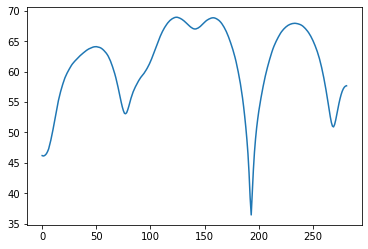

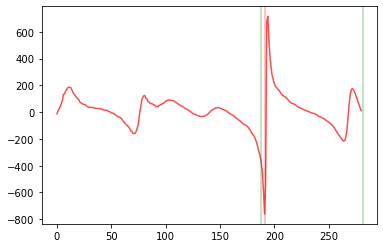

D =  1.0159574468085106 D_index =  191
max 1 Cueve[D_index] 43.332623


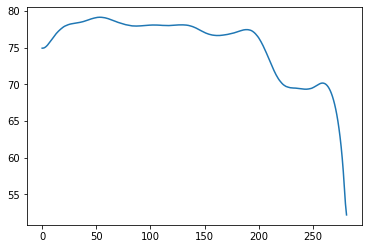

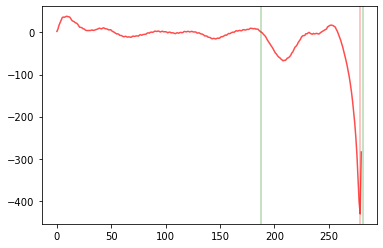

D =  1.4840425531914894 D_index =  279
max 1.4371675531914894 Cueve[D_index] 55.988297


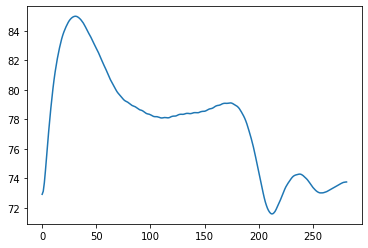

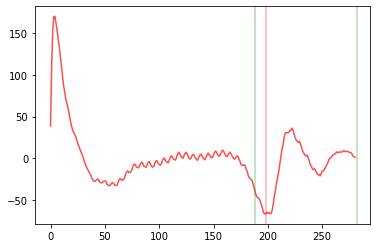

D =  1.053191489361702 D_index =  198
max 1.006316489361702 Cueve[D_index] 75.11336
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.35604

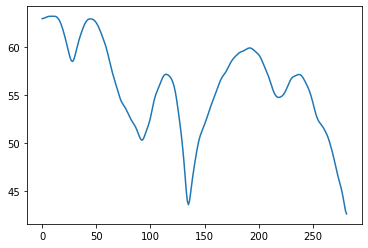

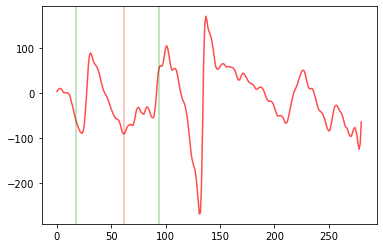

D =  0.33404255319148934 D_index =  62
max 0.27154255319148934 Cueve[D_index] 58.63296


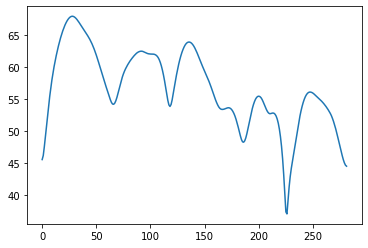

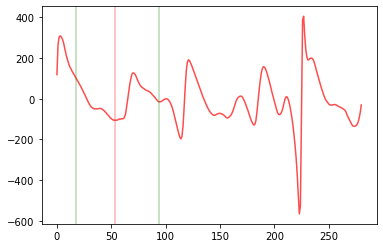

D =  0.28617021276595744 D_index =  53
max 0.22367021276595744 Cueve[D_index] 60.203636


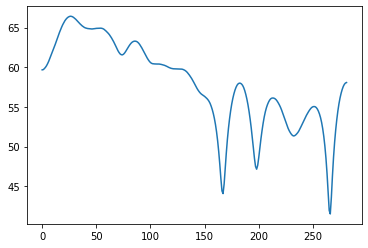

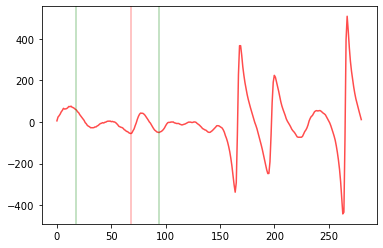

D =  0.3659574468085106 D_index =  68
max 0.3034574468085106 Cueve[D_index] 62.647114
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.356

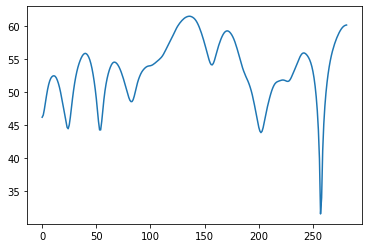

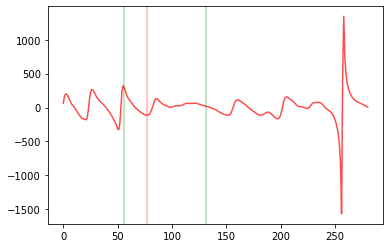

D =  0.4117021276595745 D_index =  77
max 0.3335771276595745 Cueve[D_index] 50.844017


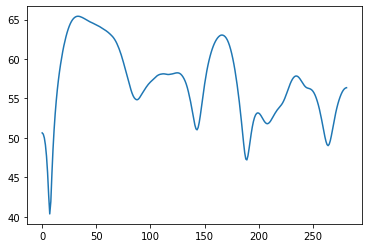

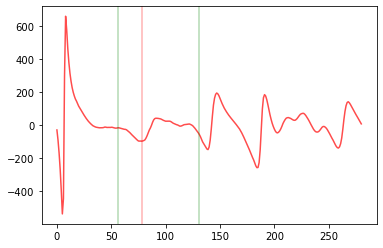

D =  0.41702127659574467 D_index =  78
max 0.33889627659574467 Cueve[D_index] 58.05421


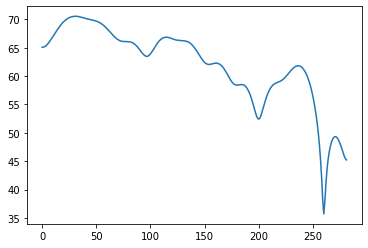

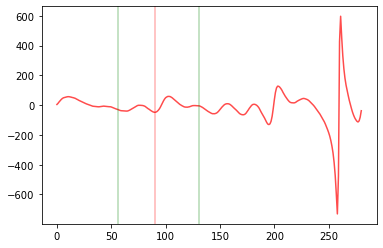

D =  0.4808510638297872 D_index =  90
max 0.4027260638297872 Cueve[D_index] 64.64877
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.3560

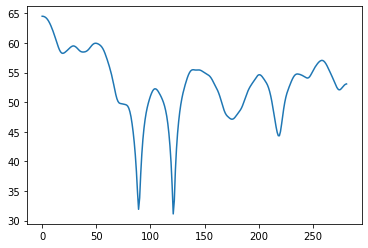

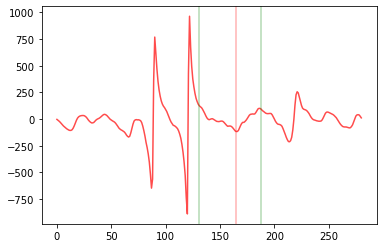

D =  0.8808510638297872 D_index =  165
max 0.8027260638297872 Cueve[D_index] 50.407898


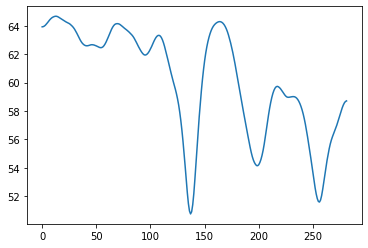

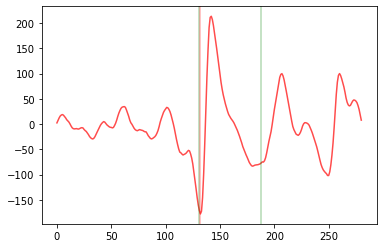

D =  0.7053191489361702 D_index =  132
max 0.7 Cueve[D_index] 54.12867


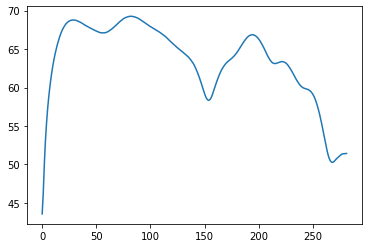

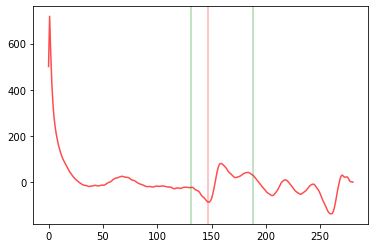

D =  0.7851063829787234 D_index =  147
max 0.7069813829787234 Cueve[D_index] 60.5006
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.3560

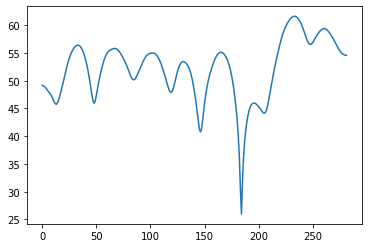

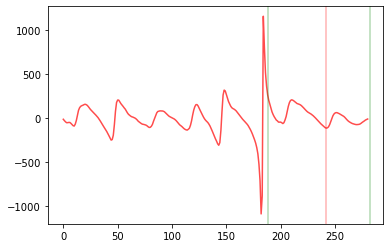

D =  1.2872340425531914 D_index =  242
max 1.2091090425531914 Cueve[D_index] 58.781746


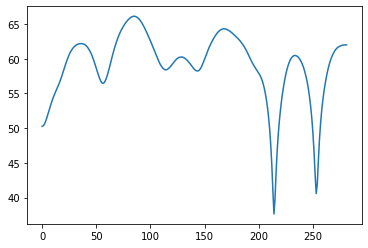

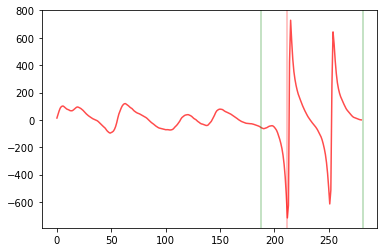

D =  1.127659574468085 D_index =  212
max 1.049534574468085 Cueve[D_index] 44.780727


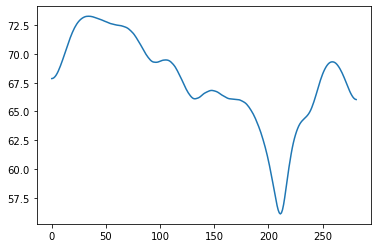

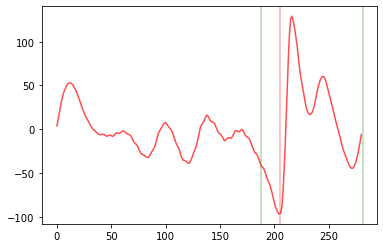

D =  1.0904255319148937 D_index =  205
max 1.0123005319148937 Cueve[D_index] 58.31124
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.356

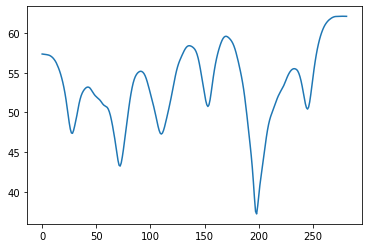

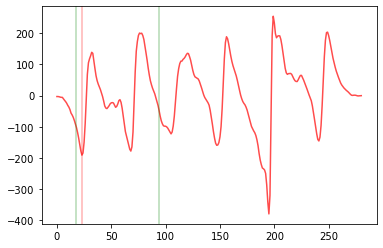

D =  0.12659574468085108 D_index =  23
max 0.1 Cueve[D_index] 50.68863


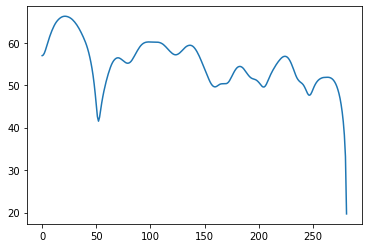

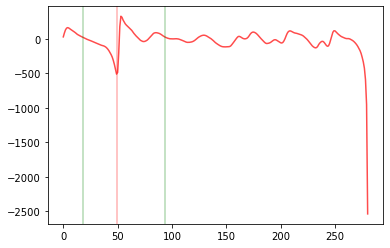

D =  0.26489361702127656 D_index =  49
max 0.18676861702127656 Cueve[D_index] 47.908173


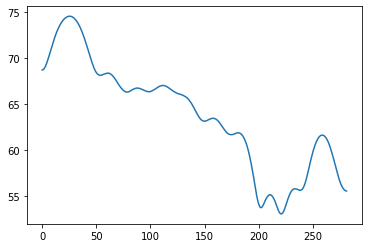

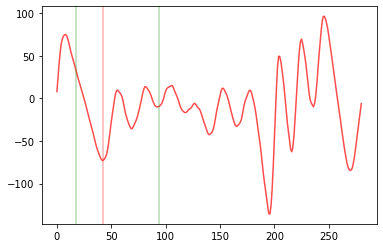

D =  0.2276595744680851 D_index =  42
max 0.1495345744680851 Cueve[D_index] 71.02984
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.3560

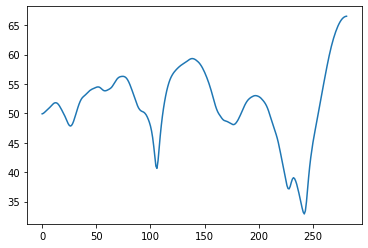

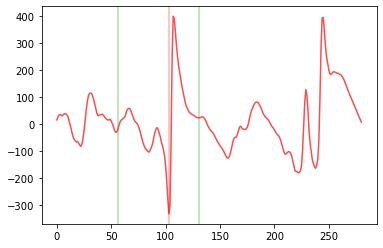

D =  0.55 D_index =  103
max 0.47187500000000004 Cueve[D_index] 44.410393


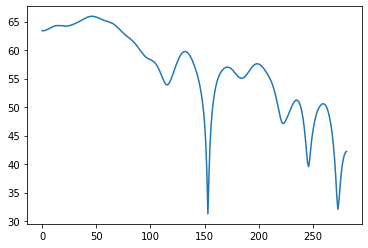

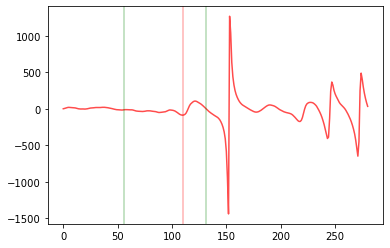

D =  0.5872340425531914 D_index =  110
max 0.5091090425531914 Cueve[D_index] 55.65881


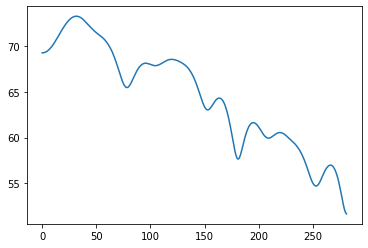

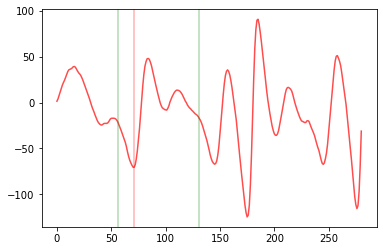

D =  0.3797872340425532 D_index =  71
max 0.3016622340425532 Cueve[D_index] 67.23889
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.3560

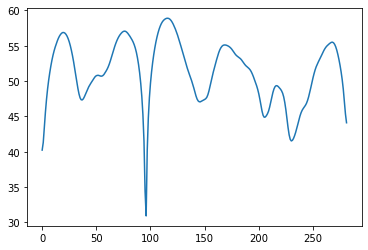

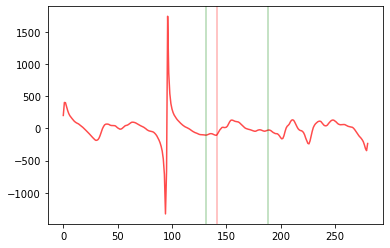

D =  0.7531914893617021 D_index =  141
max 0.7 Cueve[D_index] 48.467052


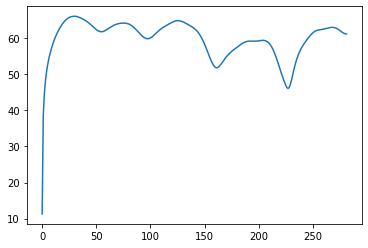

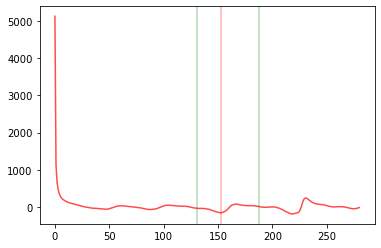

D =  0.8170212765957446 D_index =  153
max 0.7388962765957446 Cueve[D_index] 56.055668


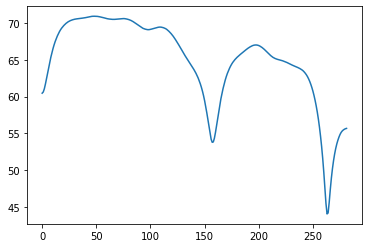

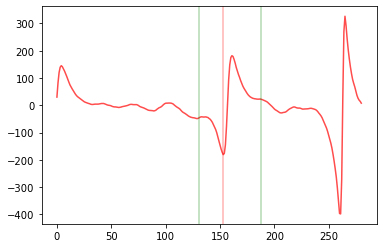

D =  0.8170212765957446 D_index =  153
max 0.7388962765957446 Cueve[D_index] 56.869675
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.35

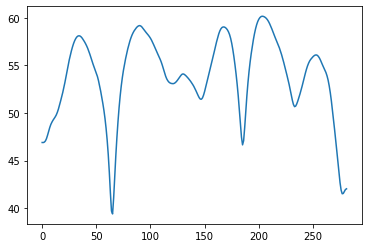

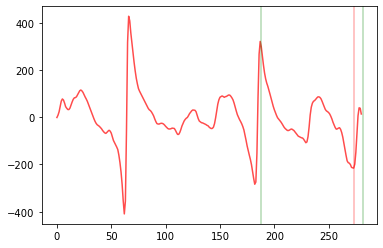

D =  1.452127659574468 D_index =  273
max 1.374002659574468 Cueve[D_index] 44.89138


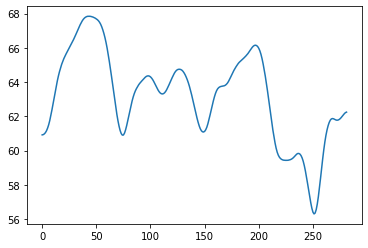

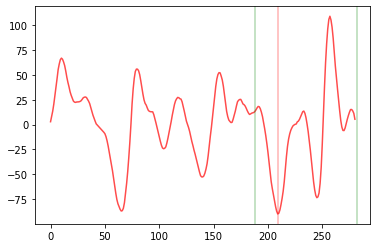

D =  1.1117021276595744 D_index =  209
max 1.0335771276595744 Cueve[D_index] 63.03699


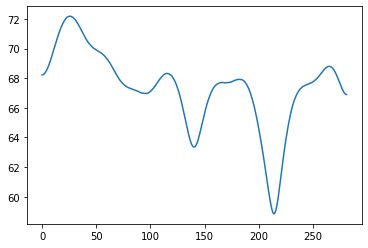

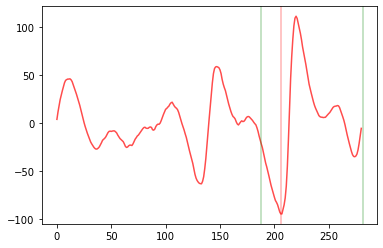

D =  1.0957446808510638 D_index =  206
max 1.0176196808510638 Cueve[D_index] 61.87979
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.356

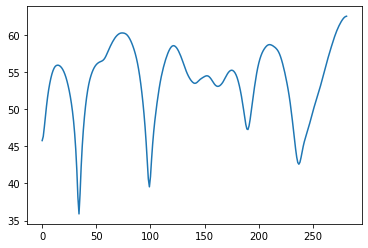

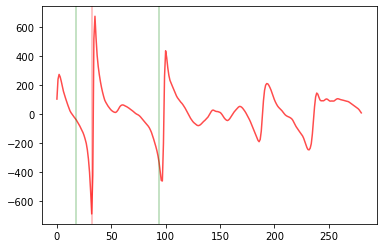

D =  0.17446808510638298 D_index =  32
max 0.1 Cueve[D_index] 41.79146


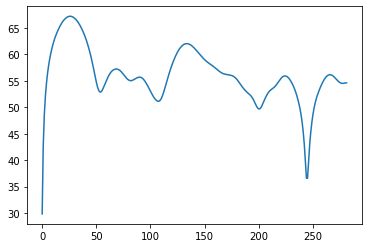

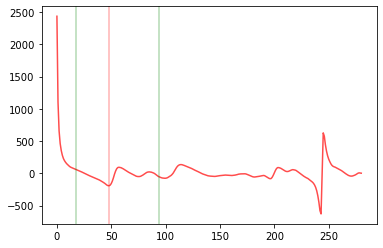

D =  0.2595744680851064 D_index =  48
max 0.15019946808510642 Cueve[D_index] 56.75056


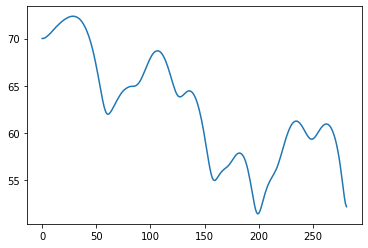

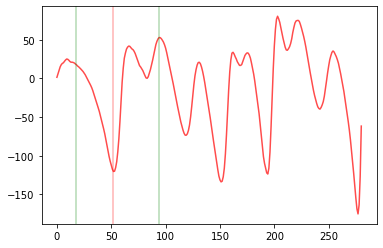

D =  0.2808510638297872 D_index =  52
max 0.1714760638297872 Cueve[D_index] 65.83684
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.3560

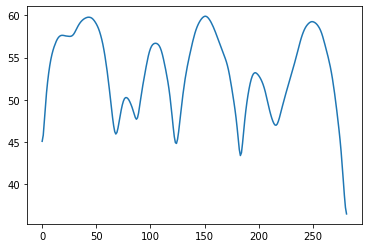

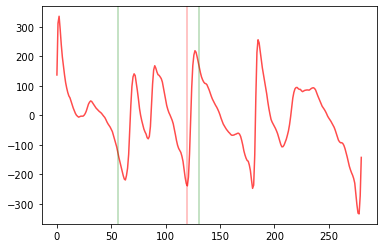

D =  0.6404255319148936 D_index =  120
max 0.5623005319148936 Cueve[D_index] 48.01902


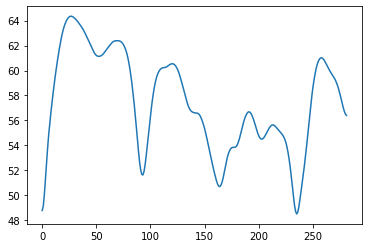

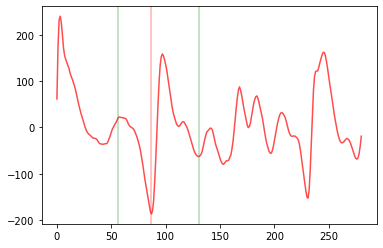

D =  0.4648936170212766 D_index =  87
max 0.3867686170212766 Cueve[D_index] 55.412884


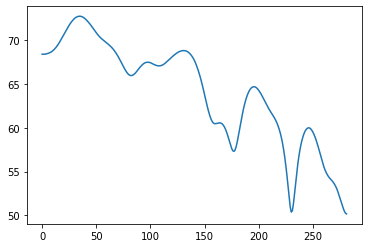

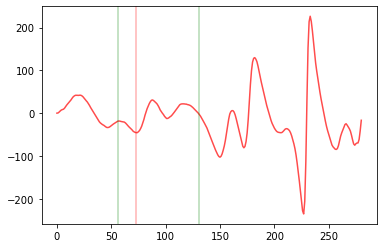

D =  0.3904255319148936 D_index =  73
max 0.3123005319148936 Cueve[D_index] 67.4689
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.35604

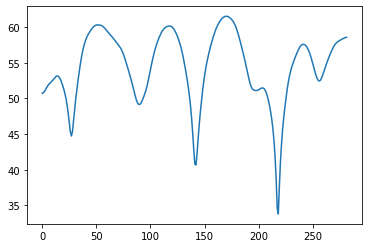

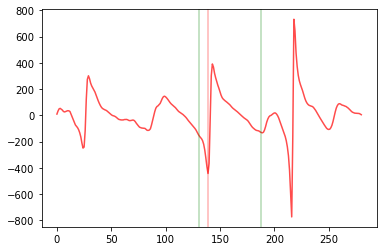

D =  0.7425531914893616 D_index =  139
max 0.7 Cueve[D_index] 45.077667


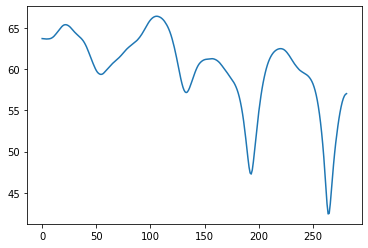

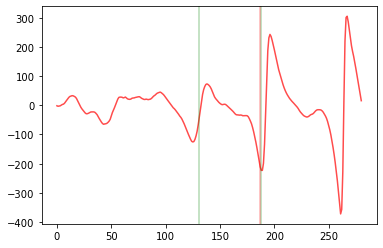

D =  0.9978723404255319 D_index =  187
max 0.9197473404255319 Cueve[D_index] 52.67273


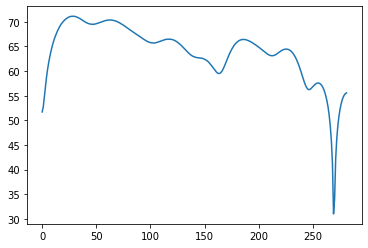

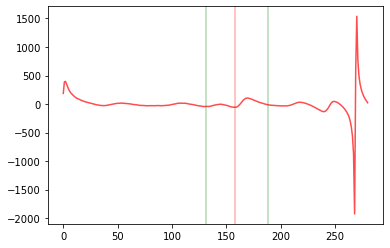

D =  0.8436170212765957 D_index =  158
max 0.7654920212765957 Cueve[D_index] 60.610043
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.35

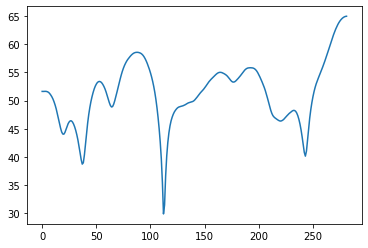

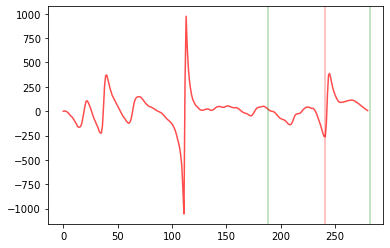

D =  1.2819148936170213 D_index =  241
max 1.2037898936170213 Cueve[D_index] 42.198166


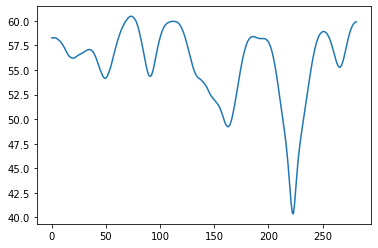

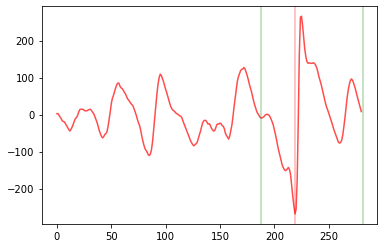

D =  1.1648936170212765 D_index =  219
max 1.0867686170212765 Cueve[D_index] 44.22866


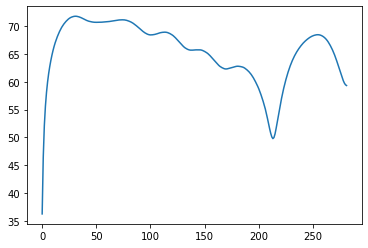

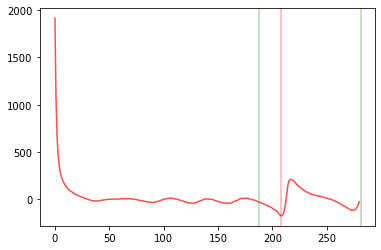

D =  1.1063829787234043 D_index =  208
max 1.0282579787234043 Cueve[D_index] 53.41654
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.356

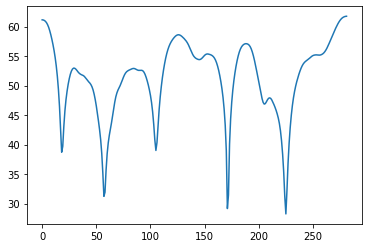

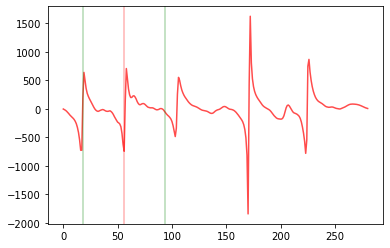

D =  0.3021276595744681 D_index =  56
max 0.22400265957446808 Cueve[D_index] 35.19035


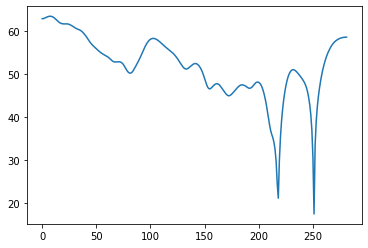

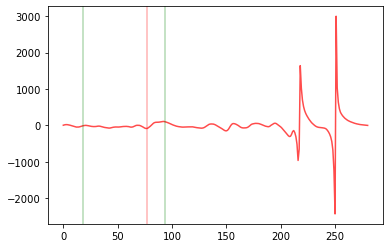

D =  0.4138297872340425 D_index =  77
max 0.3357047872340425 Cueve[D_index] 51.33871


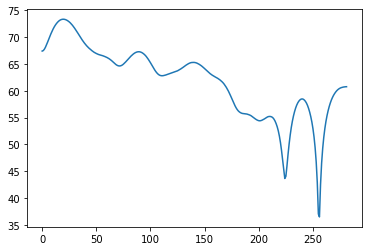

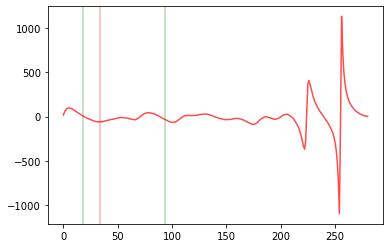

D =  0.1851063829787234 D_index =  34
max 0.1069813829787234 Cueve[D_index] 70.43719
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.3560

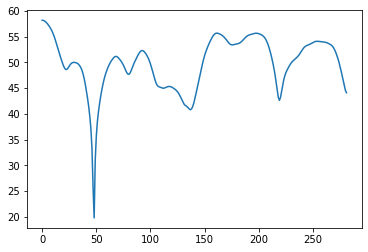

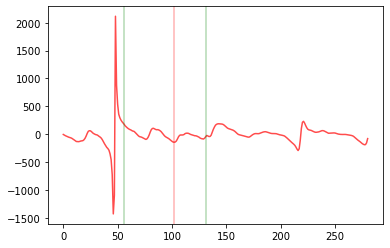

D =  0.5446808510638298 D_index =  102
max 0.4665558510638298 Cueve[D_index] 48.25863


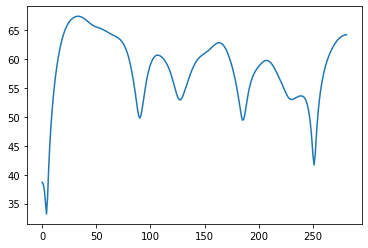

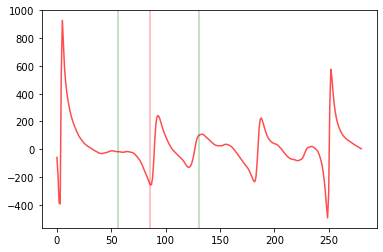

D =  0.4595744680851064 D_index =  86
max 0.3814494680851064 Cueve[D_index] 54.075455


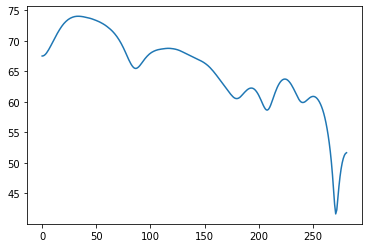

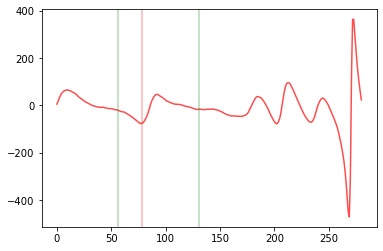

D =  0.41702127659574467 D_index =  78
max 0.33889627659574467 Cueve[D_index] 67.70098
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.35

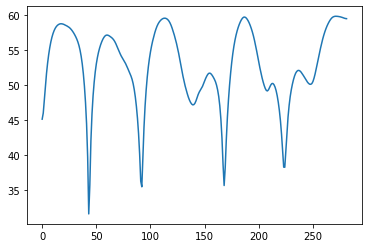

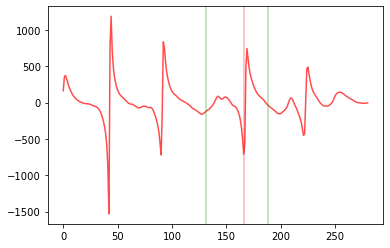

D =  0.8861702127659574 D_index =  166
max 0.8080452127659574 Cueve[D_index] 42.43564


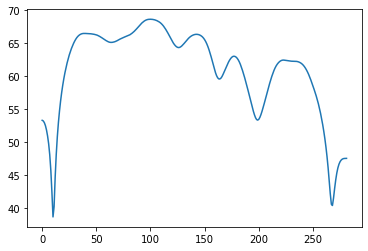

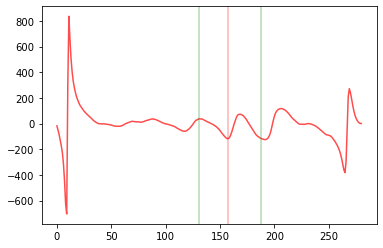

D =  0.8382978723404255 D_index =  157
max 0.7601728723404255 Cueve[D_index] 62.338284


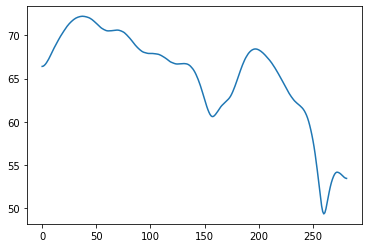

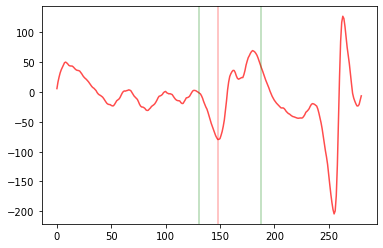

D =  0.7904255319148936 D_index =  148
max 0.7123005319148936 Cueve[D_index] 63.4102
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.3560

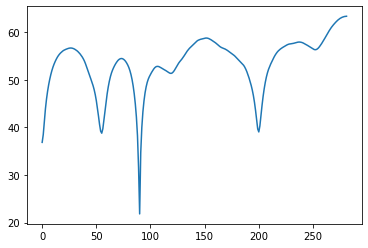

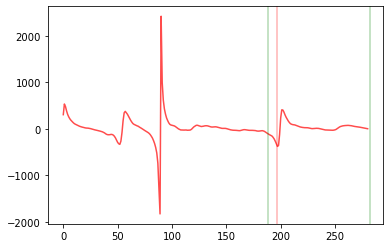

D =  1.047872340425532 D_index =  197
max 1 Cueve[D_index] 43.590664


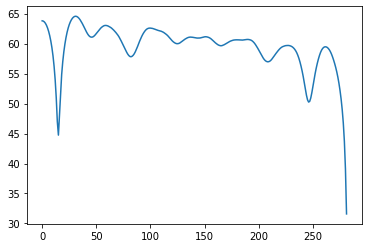

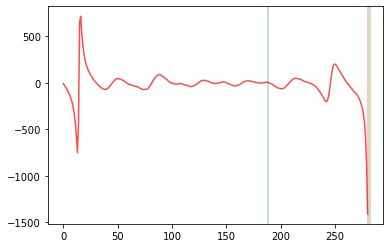

D =  1.4893617021276595 D_index =  280
max 1.4112367021276595 Cueve[D_index] 39.087543


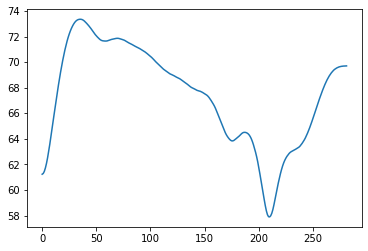

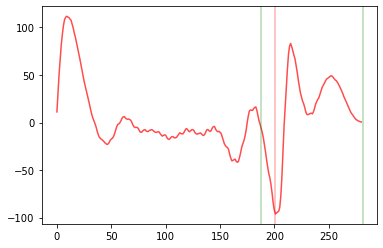

D =  1.0691489361702127 D_index =  201
max 1 Cueve[D_index] 61.261166
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.3560494593892, 1398

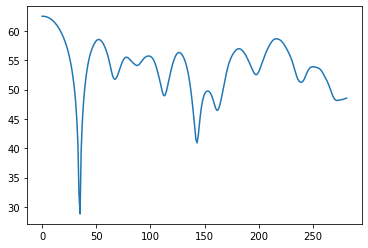

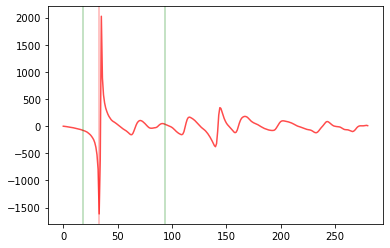

D =  0.1797872340425532 D_index =  33
max 0.1016622340425532 Cueve[D_index] 40.667564


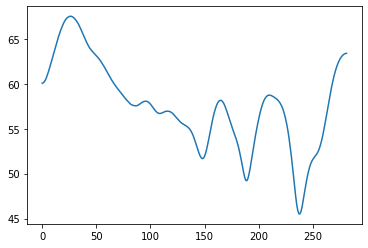

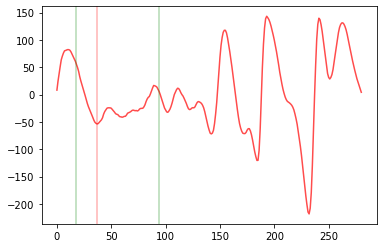

D =  0.20106382978723403 D_index =  37
max 0.12293882978723403 Cueve[D_index] 65.74118


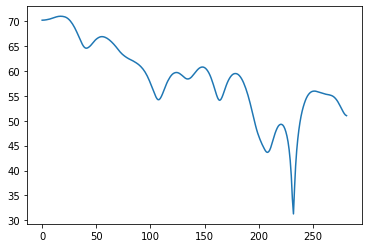

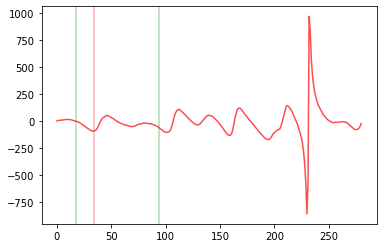

D =  0.1851063829787234 D_index =  34
max 0.1069813829787234 Cueve[D_index] 66.81684
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.3560

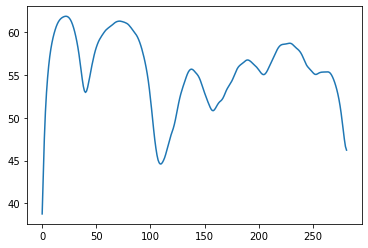

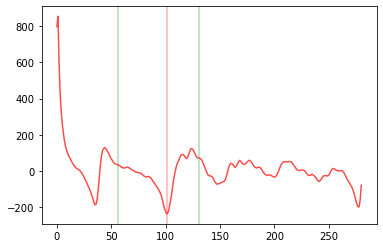

D =  0.5393617021276595 D_index =  101
max 0.46123670212765955 Cueve[D_index] 51.03203


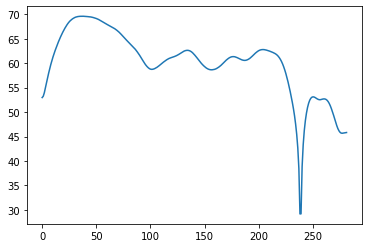

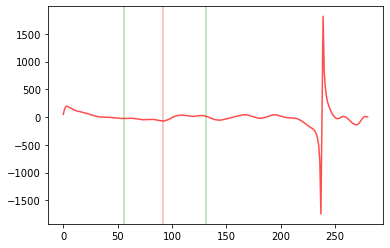

D =  0.49148936170212765 D_index =  92
max 0.41336436170212765 Cueve[D_index] 60.891155


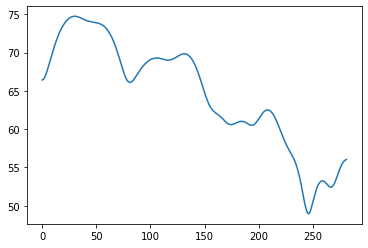

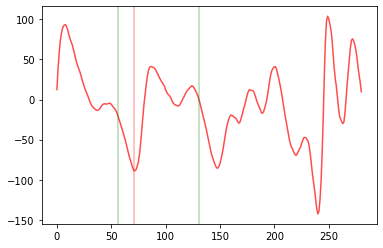

D =  0.3797872340425532 D_index =  71
max 0.3016622340425532 Cueve[D_index] 69.37372
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.3560

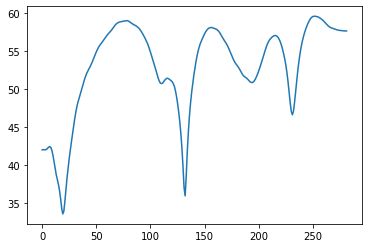

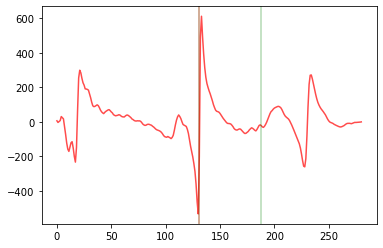

D =  0.7 D_index =  131
max 0.7 Cueve[D_index] 37.03102


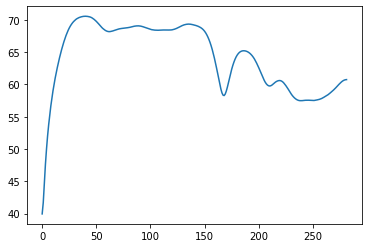

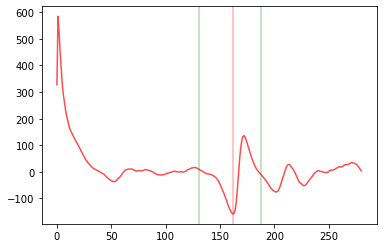

D =  0.8648936170212765 D_index =  162
max 0.7867686170212765 Cueve[D_index] 61.711605


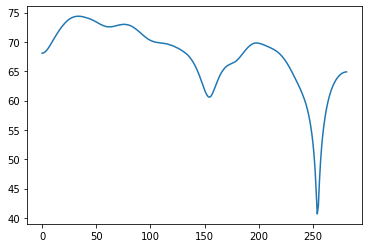

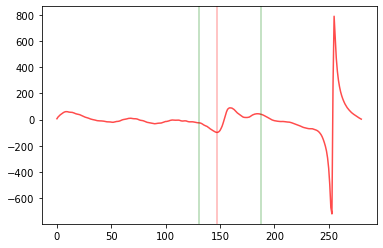

D =  0.7851063829787234 D_index =  147
max 0.7069813829787234 Cueve[D_index] 63.344967
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.35

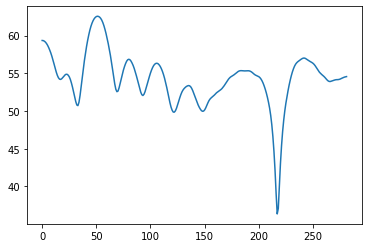

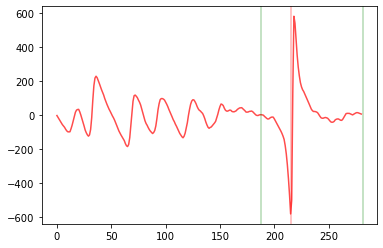

D =  1.1436170212765957 D_index =  215
max 1.0654920212765957 Cueve[D_index] 42.12824


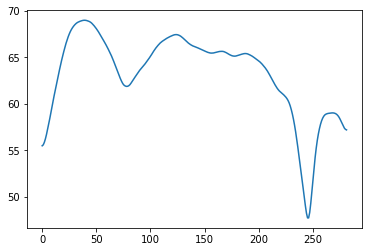

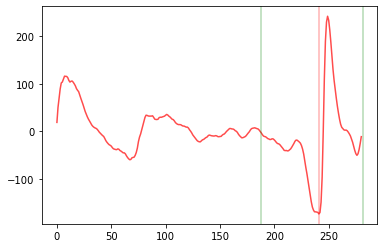

D =  1.2819148936170213 D_index =  241
max 1.2037898936170213 Cueve[D_index] 50.893845


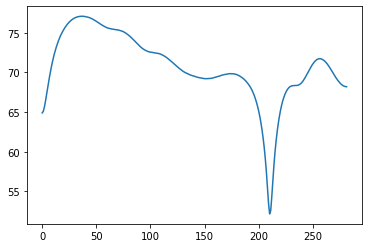

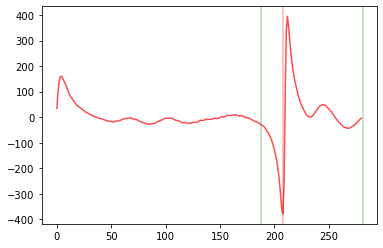

D =  1.1063829787234043 D_index =  208
max 1.0282579787234043 Cueve[D_index] 55.49461
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.356

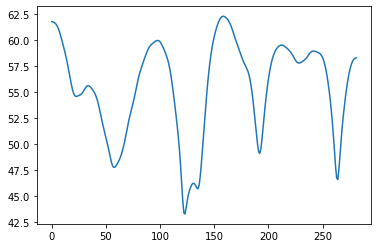

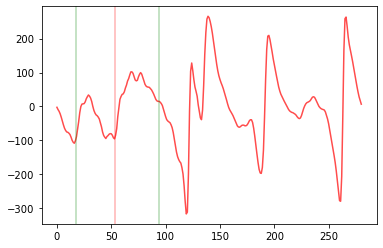

D =  0.28617021276595744 D_index =  53
max 0.20804521276595744 Cueve[D_index] 49.23845


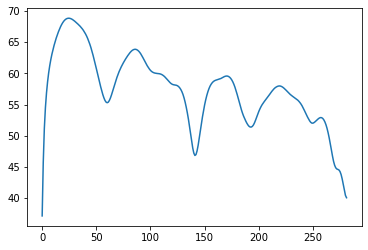

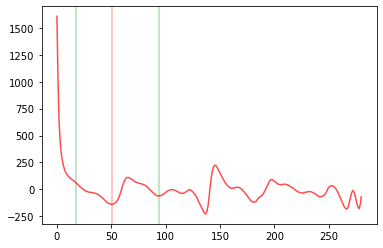

D =  0.27553191489361706 D_index =  51
max 0.19740691489361706 Cueve[D_index] 60.04898


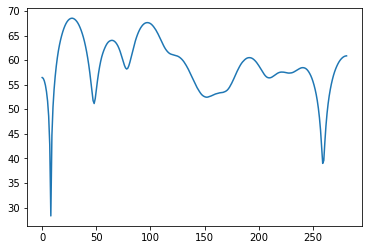

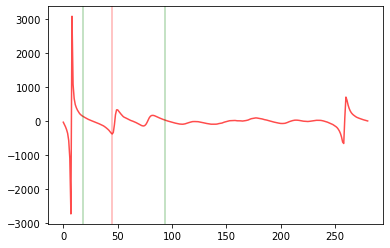

D =  0.24361702127659574 D_index =  45
max 0.16549202127659574 Cueve[D_index] 55.54631
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.35

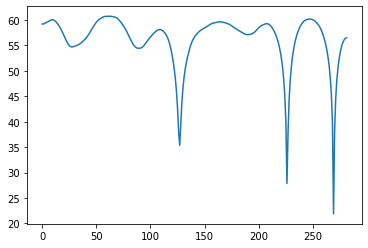

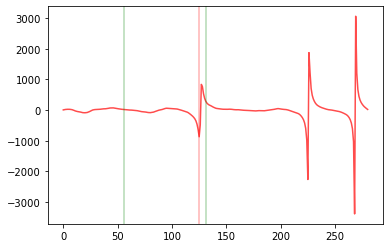

D =  0.6670212765957446 D_index =  125
max 0.5888962765957446 Cueve[D_index] 42.56919


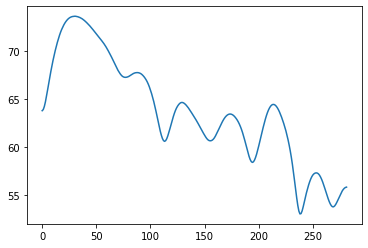

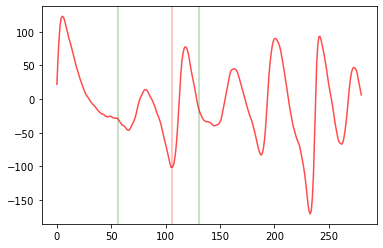

D =  0.5659574468085107 D_index =  106
max 0.4878324468085107 Cueve[D_index] 63.249763


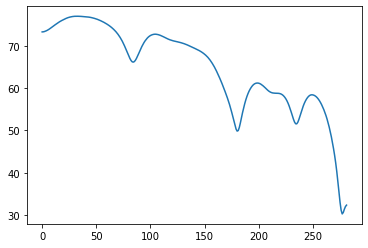

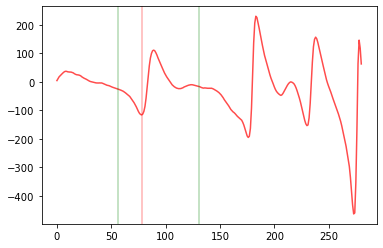

D =  0.41702127659574467 D_index =  78
max 0.33889627659574467 Cueve[D_index] 68.77568
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.35

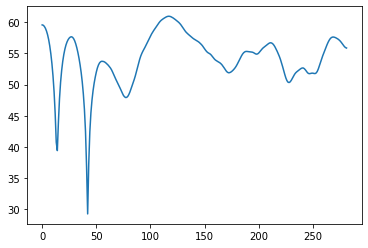

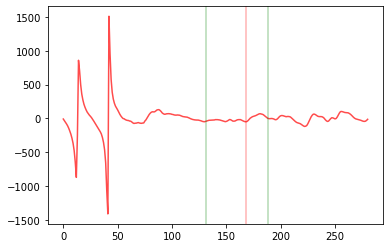

D =  0.8968085106382978 D_index =  168
max 0.8186835106382978 Cueve[D_index] 52.669426


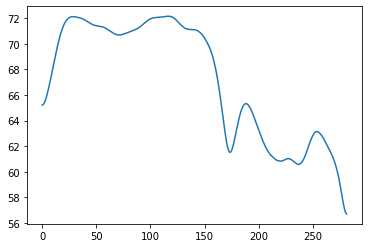

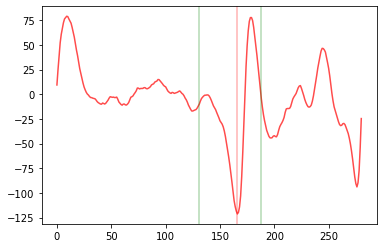

D =  0.8861702127659574 D_index =  166
max 0.8080452127659574 Cueve[D_index] 64.87766


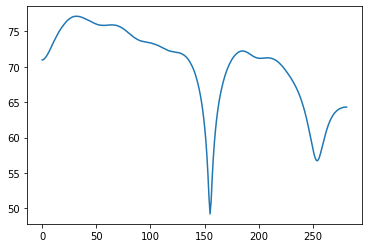

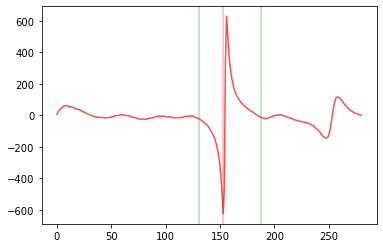

D =  0.8170212765957446 D_index =  153
max 0.7388962765957446 Cueve[D_index] 54.975445
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.35

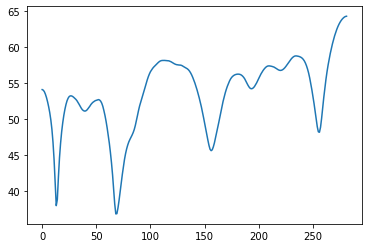

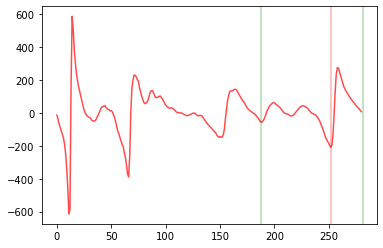

D =  1.3404255319148937 D_index =  252
max 1.2623005319148937 Cueve[D_index] 51.05808


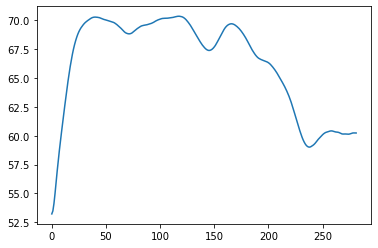

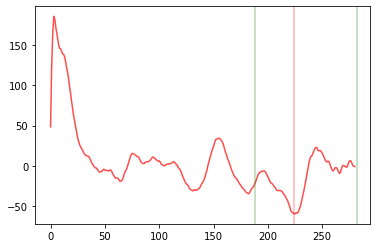

D =  1.1914893617021276 D_index =  224
max 1.1133643617021276 Cueve[D_index] 61.98808


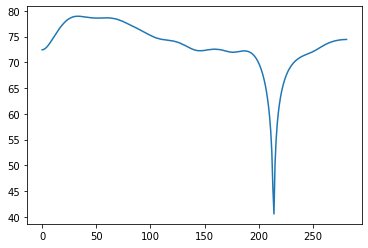

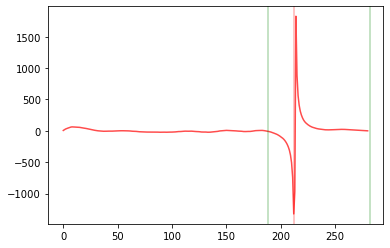

D =  1.127659574468085 D_index =  212
max 1.049534574468085 Cueve[D_index] 52.730618
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.3560

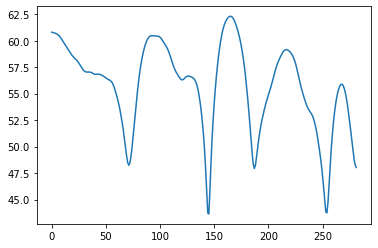

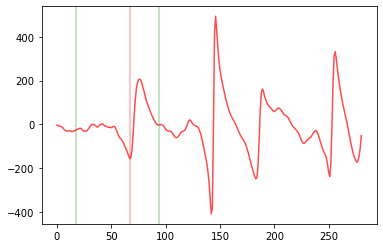

D =  0.3606382978723405 D_index =  67
max 0.2825132978723405 Cueve[D_index] 50.797516


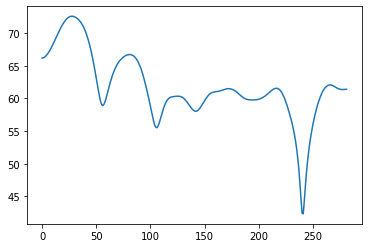

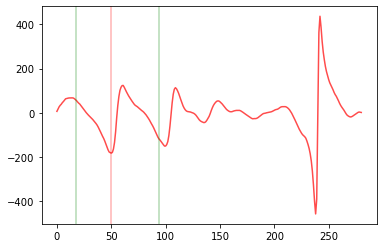

D =  0.2702127659574468 D_index =  50
max 0.1920877659574468 Cueve[D_index] 63.02059


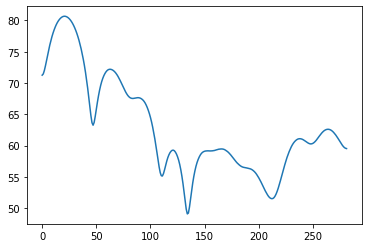

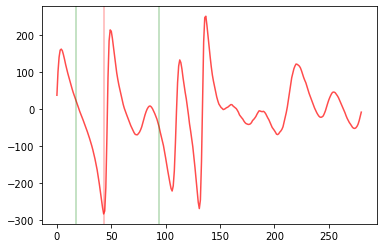

D =  0.23297872340425532 D_index =  43
max 0.15485372340425532 Cueve[D_index] 67.76988
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.35

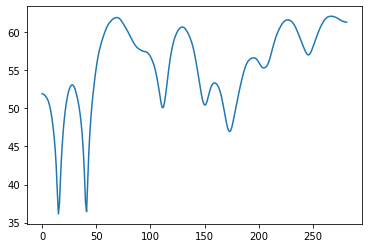

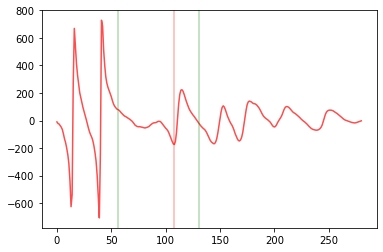

D =  0.5765957446808511 D_index =  108
max 0.49847074468085106 Cueve[D_index] 52.2796


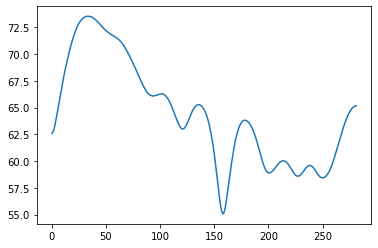

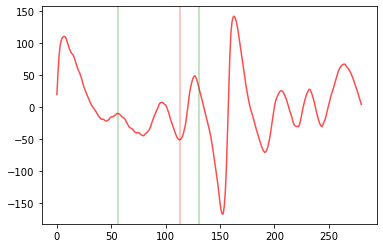

D =  0.6031914893617021 D_index =  113
max 0.5250664893617021 Cueve[D_index] 64.49527


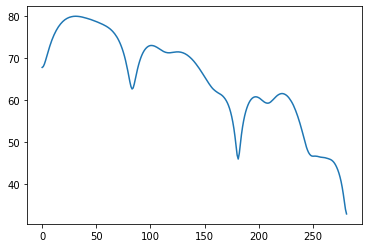

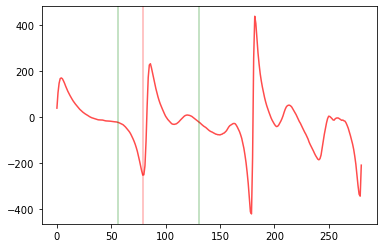

D =  0.42234042553191486 D_index =  79
max 0.34421542553191486 Cueve[D_index] 66.96638
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.35

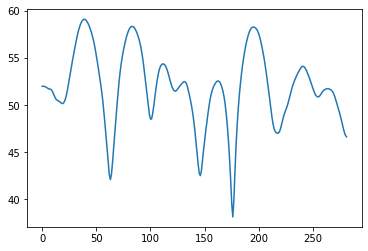

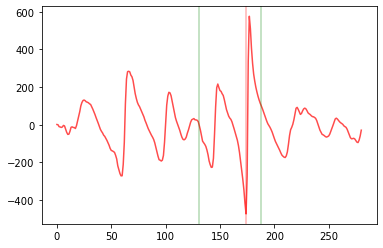

D =  0.9287234042553191 D_index =  174
max 0.8505984042553191 Cueve[D_index] 42.12917


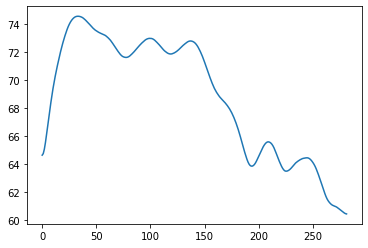

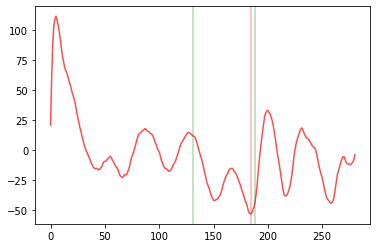

D =  0.9819148936170212 D_index =  184
max 0.9037898936170212 Cueve[D_index] 65.678665


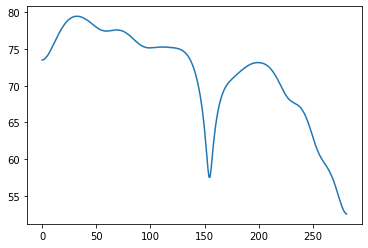

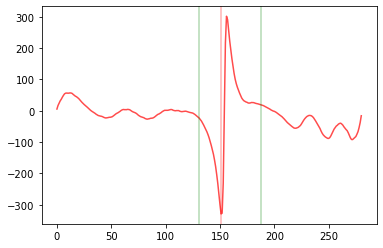

D =  0.8063829787234043 D_index =  151
max 0.7282579787234043 Cueve[D_index] 62.266926
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.35

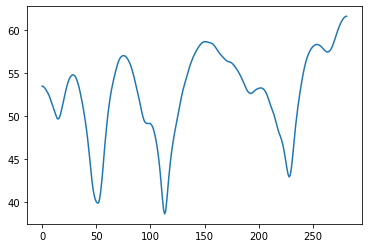

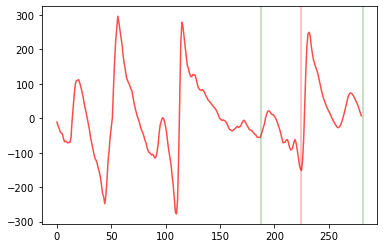

D =  1.196808510638298 D_index =  225
max 1.118683510638298 Cueve[D_index] 44.667377


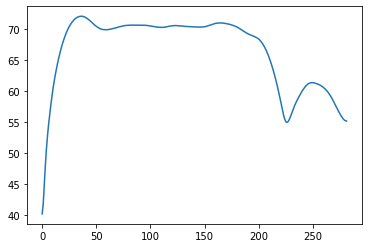

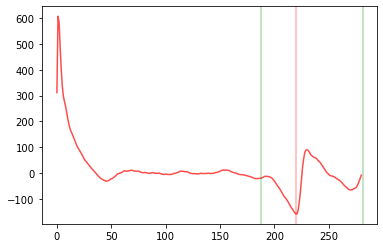

D =  1.1702127659574468 D_index =  220
max 1.0920877659574468 Cueve[D_index] 58.461803


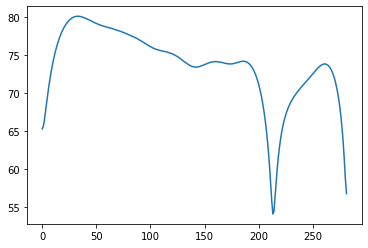

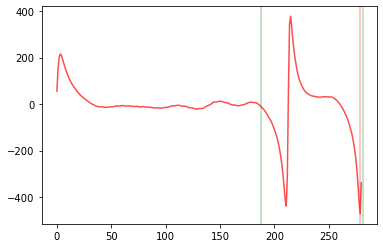

D =  1.4840425531914894 D_index =  279
max 1.4059175531914894 Cueve[D_index] 61.05138
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.356

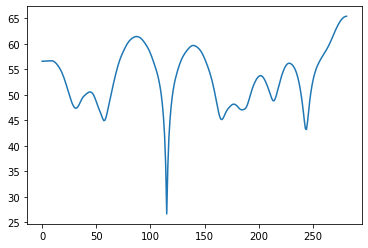

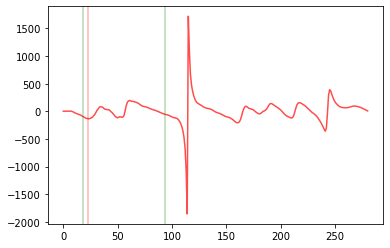

D =  0.12659574468085108 D_index =  23
max 0.1 Cueve[D_index] 51.422848


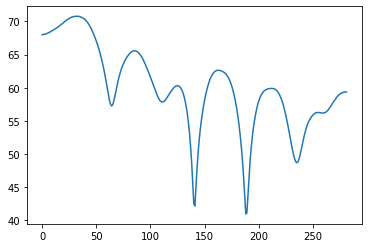

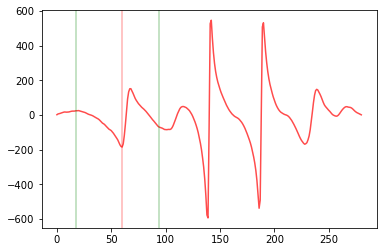

D =  0.32340425531914896 D_index =  60
max 0.24527925531914896 Cueve[D_index] 60.039017


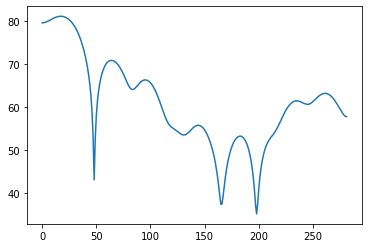

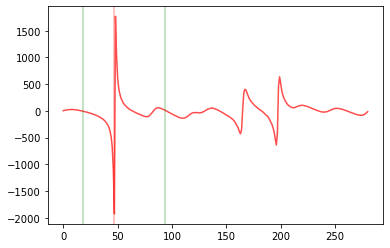

D =  0.2542553191489362 D_index =  47
max 0.17613031914893618 Cueve[D_index] 53.375614
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.35

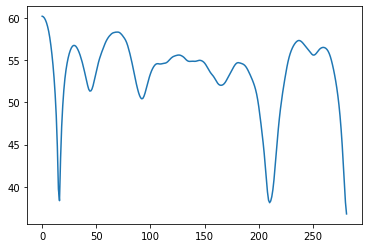

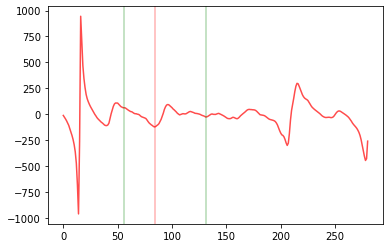

D =  0.44893617021276594 D_index =  84
max 0.37081117021276594 Cueve[D_index] 54.039753


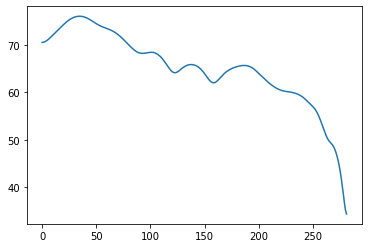

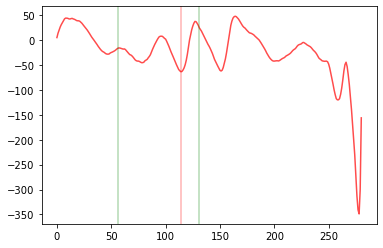

D =  0.6085106382978723 D_index =  114
max 0.5303856382978723 Cueve[D_index] 66.16976


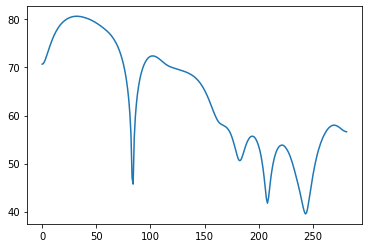

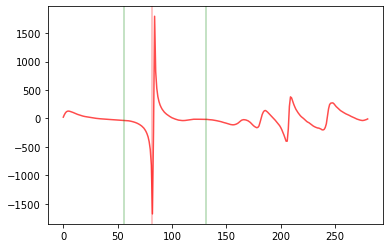

D =  0.4382978723404255 D_index =  82
max 0.3601728723404255 Cueve[D_index] 55.929417
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.356

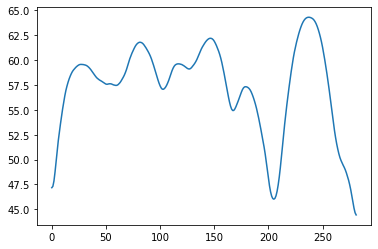

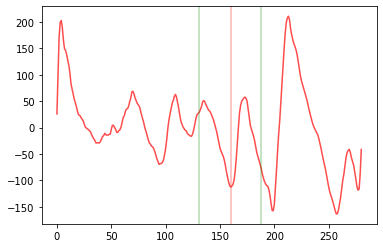

D =  0.8542553191489362 D_index =  160
max 0.7761303191489362 Cueve[D_index] 58.10401


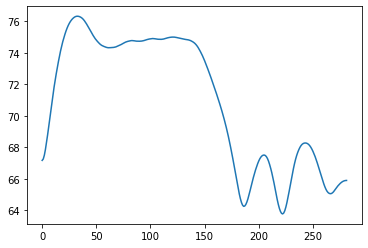

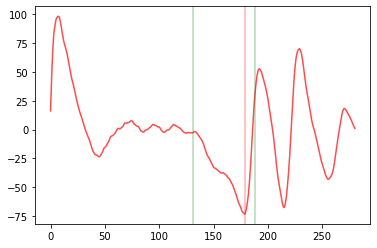

D =  0.9553191489361701 D_index =  179
max 0.8771941489361701 Cueve[D_index] 66.143814


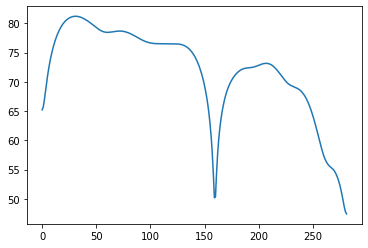

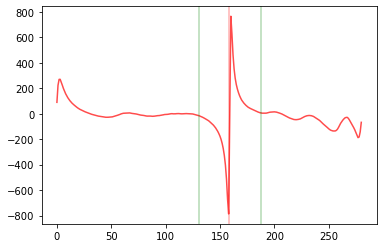

D =  0.8436170212765957 D_index =  158
max 0.7654920212765957 Cueve[D_index] 54.36538
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.356

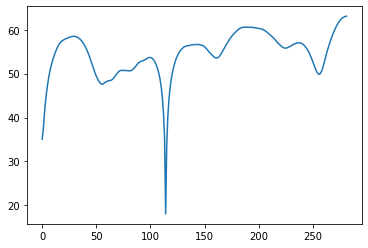

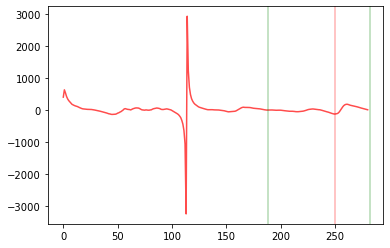

D =  1.3297872340425532 D_index =  250
max 1.2516622340425532 Cueve[D_index] 52.617805


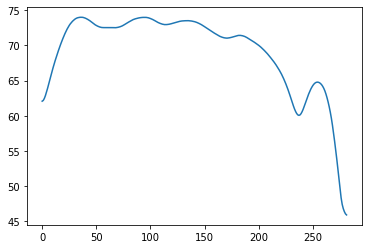

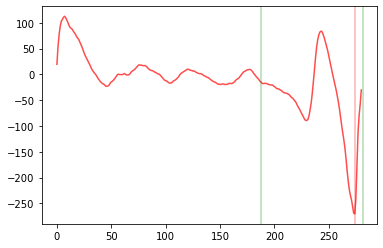

D =  1.4574468085106382 D_index =  274
max 1.3793218085106382 Cueve[D_index] 51.023148


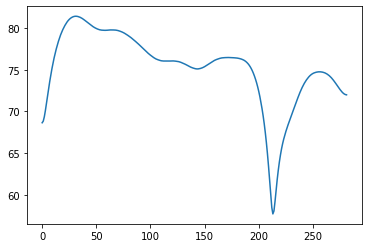

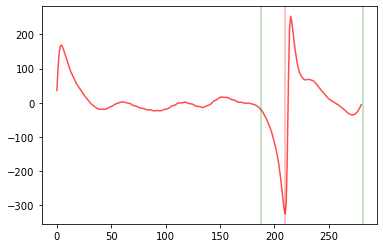

D =  1.1170212765957448 D_index =  210
max 1.0388962765957448 Cueve[D_index] 61.732864
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.35

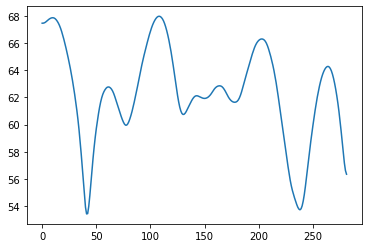

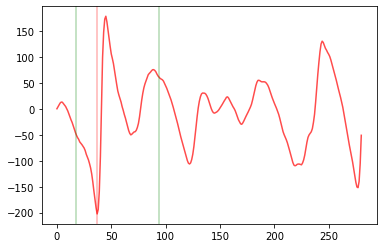

D =  0.20106382978723403 D_index =  37
max 0.12293882978723403 Cueve[D_index] 56.868416


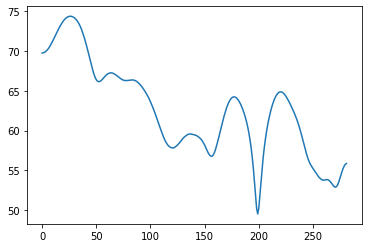

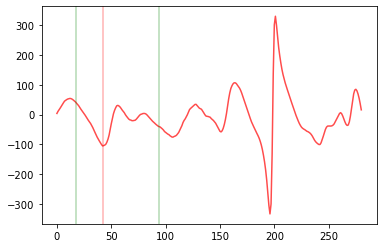

D =  0.2276595744680851 D_index =  42
max 0.1495345744680851 Cueve[D_index] 70.12723


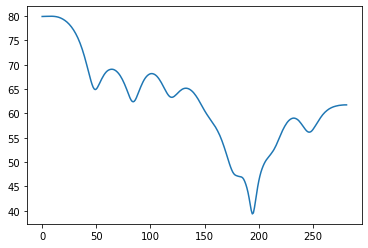

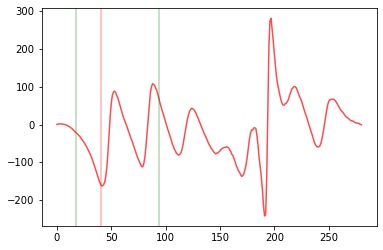

D =  0.2223404255319149 D_index =  41
max 0.1442154255319149 Cueve[D_index] 70.105934
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.356

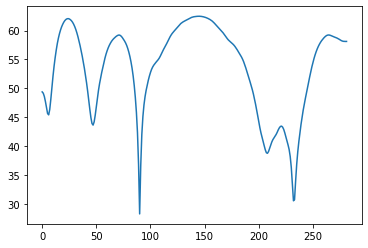

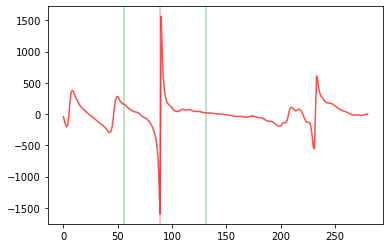

D =  0.475531914893617 D_index =  89
max 0.397406914893617 Cueve[D_index] 36.76979


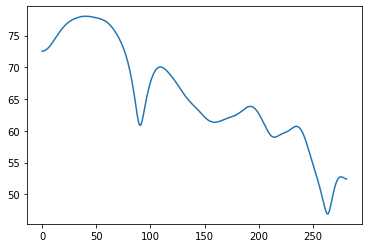

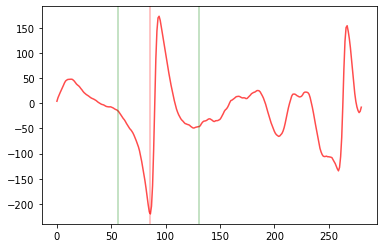

D =  0.4595744680851064 D_index =  86
max 0.3814494680851064 Cueve[D_index] 64.51529


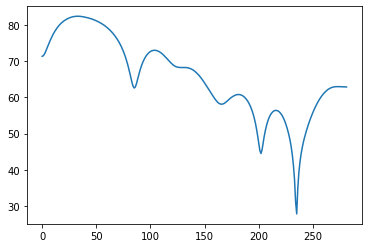

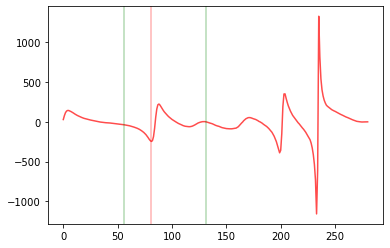

D =  0.4329787234042553 D_index =  81
max 0.3548537234042553 Cueve[D_index] 66.59859
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.3560

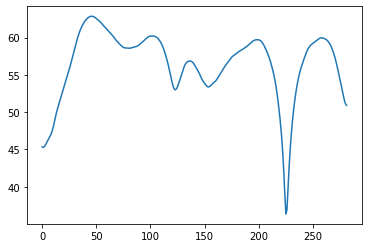

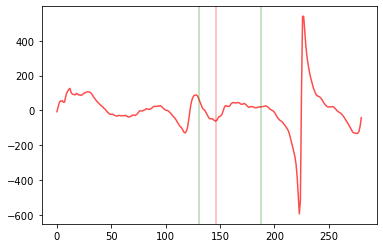

D =  0.7797872340425531 D_index =  146
max 0.7016622340425531 Cueve[D_index] 54.90014


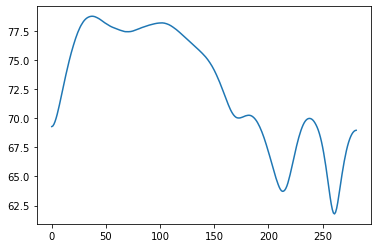

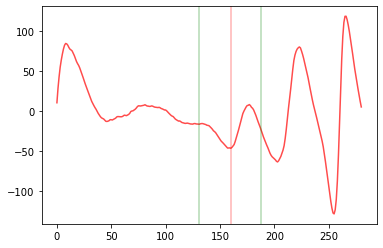

D =  0.8542553191489362 D_index =  160
max 0.7761303191489362 Cueve[D_index] 71.890564


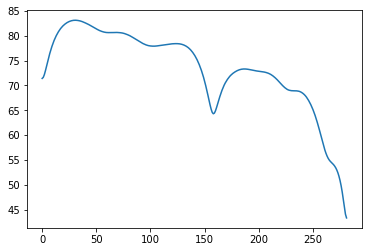

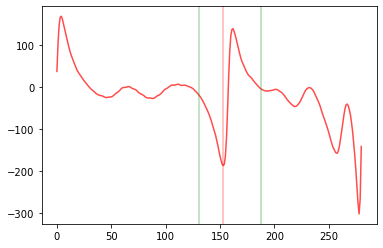

D =  0.8170212765957446 D_index =  153
max 0.7388962765957446 Cueve[D_index] 68.04852
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.356

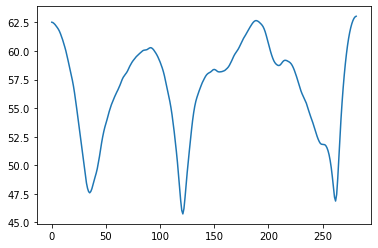

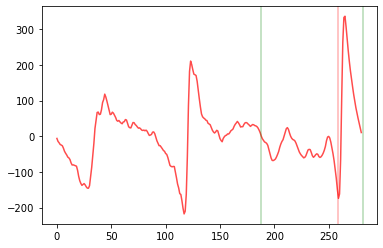

D =  1.377659574468085 D_index =  259
max 1.299534574468085 Cueve[D_index] 49.006645


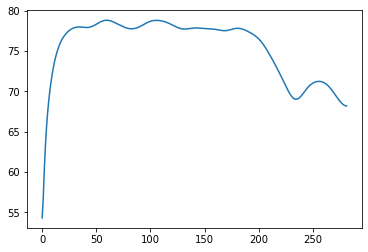

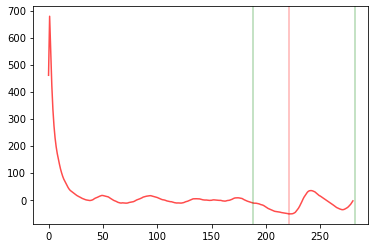

D =  1.175531914893617 D_index =  221
max 1.097406914893617 Cueve[D_index] 71.76416


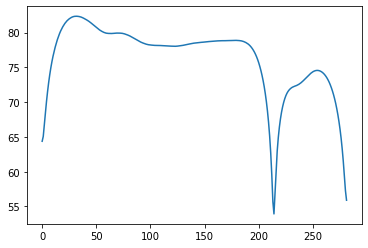

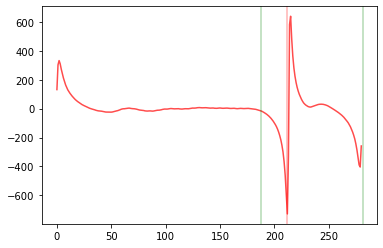

D =  1.127659574468085 D_index =  212
max 1.049534574468085 Cueve[D_index] 59.541042
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.3560

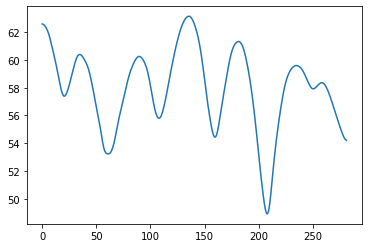

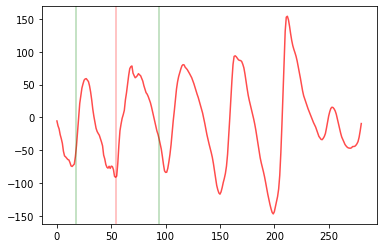

D =  0.2914893617021277 D_index =  54
max 0.2133643617021277 Cueve[D_index] 54.95025


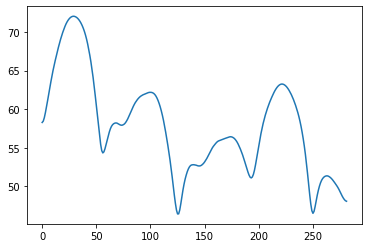

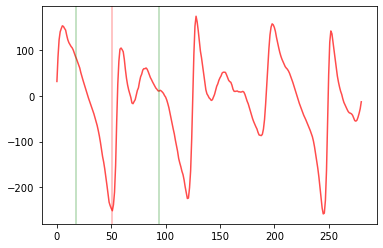

D =  0.27553191489361706 D_index =  51
max 0.19740691489361706 Cueve[D_index] 59.174503


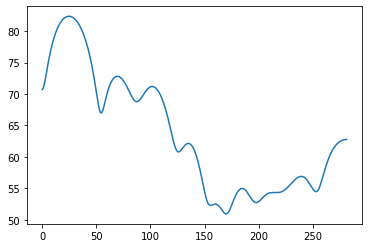

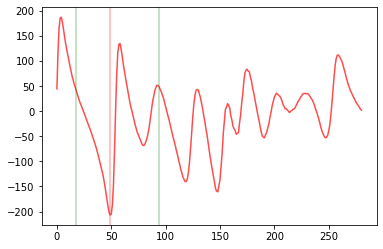

D =  0.26489361702127656 D_index =  49
max 0.18676861702127656 Cueve[D_index] 71.394356
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.3

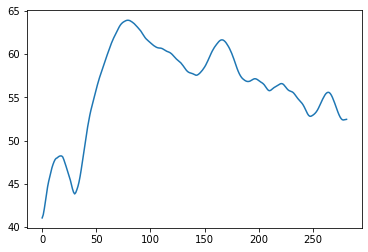

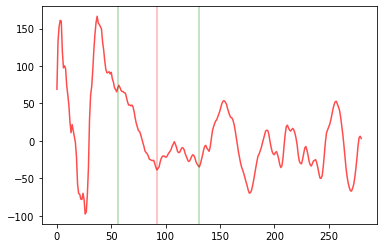

D =  0.49148936170212765 D_index =  92
max 0.41336436170212765 Cueve[D_index] 62.499237


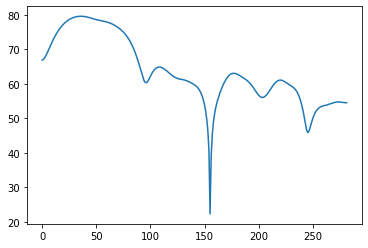

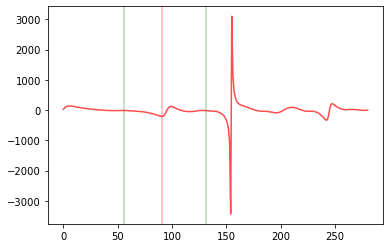

D =  0.4861702127659574 D_index =  91
max 0.4080452127659574 Cueve[D_index] 64.00326


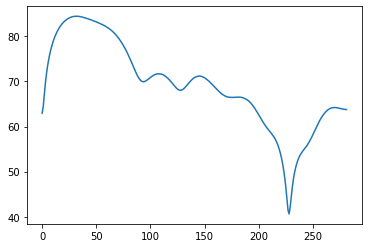

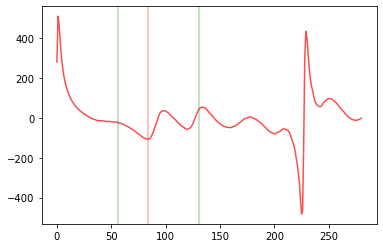

D =  0.44893617021276594 D_index =  84
max 0.37081117021276594 Cueve[D_index] 73.39894
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.35

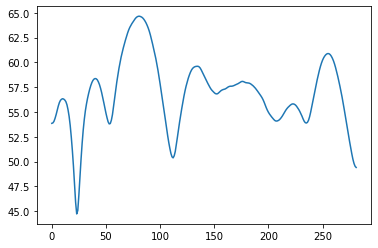

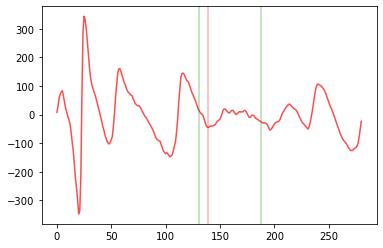

D =  0.7425531914893616 D_index =  139
max 0.7 Cueve[D_index] 59.00931


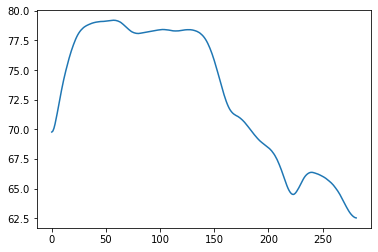

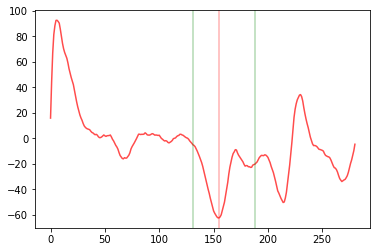

D =  0.827659574468085 D_index =  155
max 0.749534574468085 Cueve[D_index] 74.212654


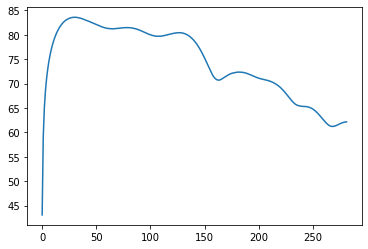

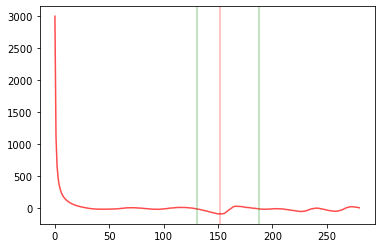

D =  0.8117021276595744 D_index =  152
max 0.7335771276595744 Cueve[D_index] 74.2558
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.3560

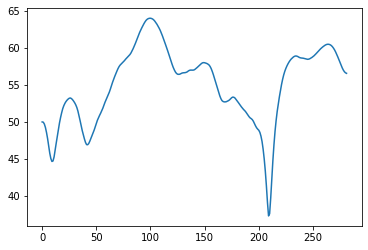

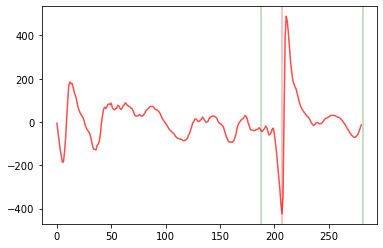

D =  1.101063829787234 D_index =  207
max 1.022938829787234 Cueve[D_index] 41.353294


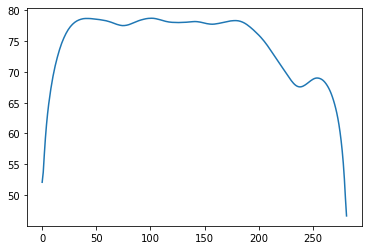

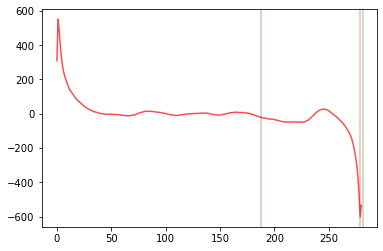

D =  1.4840425531914894 D_index =  279
max 1.4059175531914894 Cueve[D_index] 52.6471


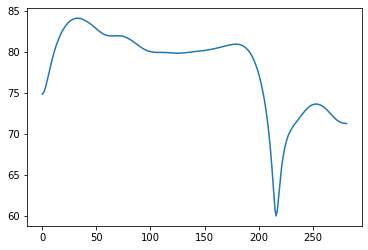

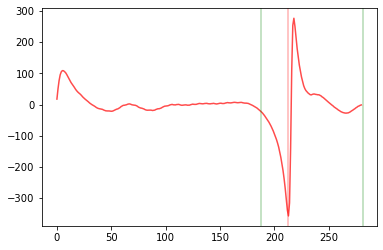

D =  1.1329787234042552 D_index =  213
max 1.0548537234042552 Cueve[D_index] 64.3102
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.3560

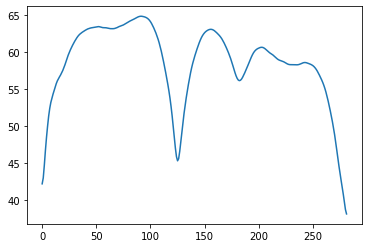

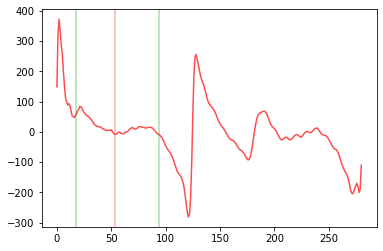

D =  0.28617021276595744 D_index =  53
max 0.19242021276595744 Cueve[D_index] 63.441765


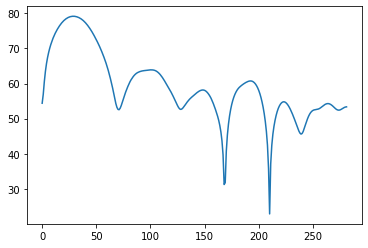

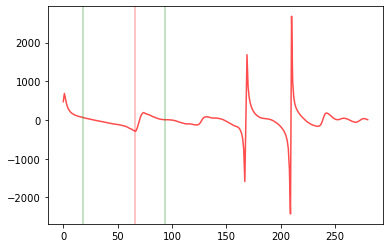

D =  0.3553191489361702 D_index =  66
max 0.2615691489361702 Cueve[D_index] 57.32753


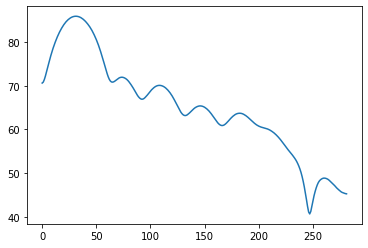

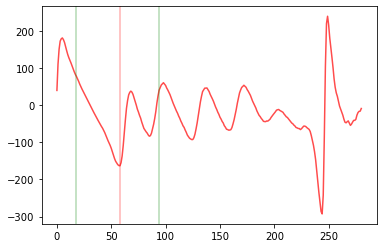

D =  0.3127659574468085 D_index =  58
max 0.21901595744680852 Cueve[D_index] 74.460365
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.35

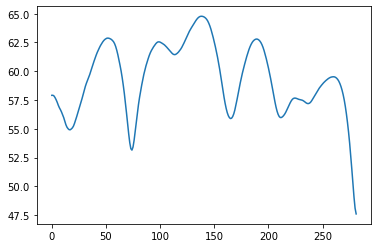

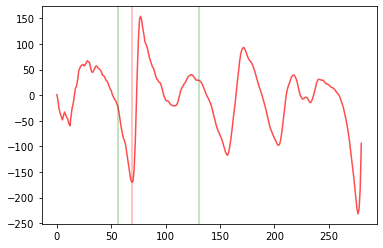

D =  0.36914893617021277 D_index =  69
max 0.3 Cueve[D_index] 56.351833


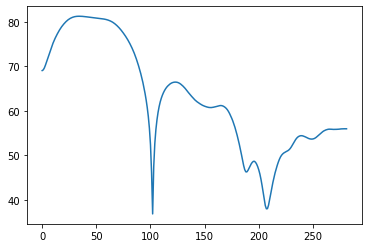

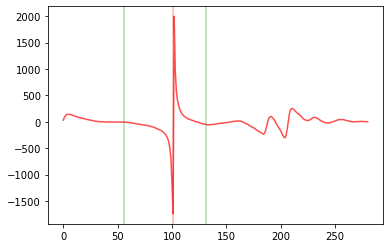

D =  0.5393617021276595 D_index =  101
max 0.46123670212765955 Cueve[D_index] 46.184284


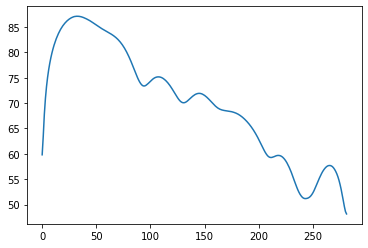

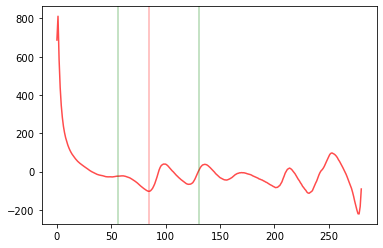

D =  0.45425531914893613 D_index =  85
max 0.37613031914893613 Cueve[D_index] 76.6205
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.356

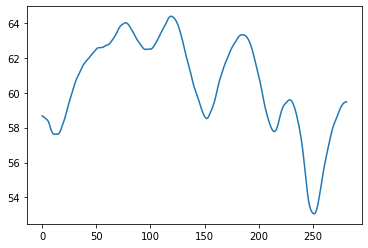

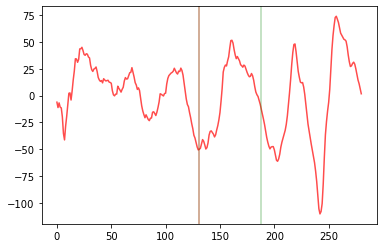

D =  0.7 D_index =  131
max 0.7 Cueve[D_index] 62.60597


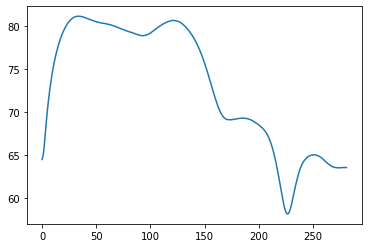

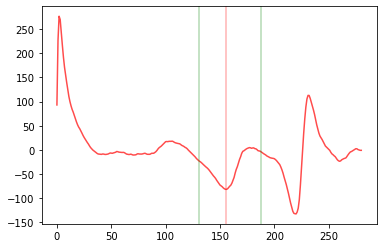

D =  0.8329787234042553 D_index =  156
max 0.7548537234042553 Cueve[D_index] 73.21834


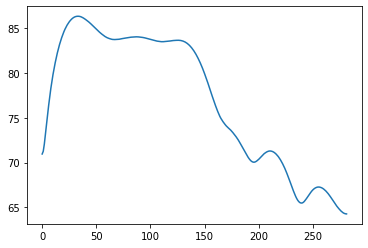

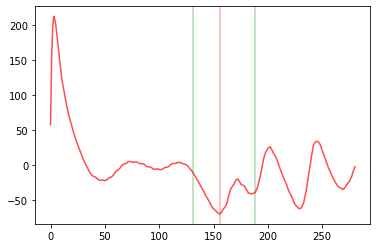

D =  0.8329787234042553 D_index =  156
max 0.7548537234042553 Cueve[D_index] 77.79771
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.356

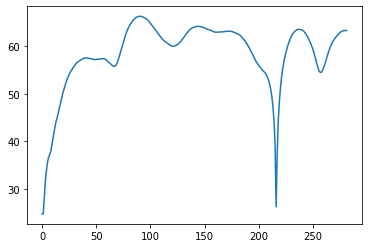

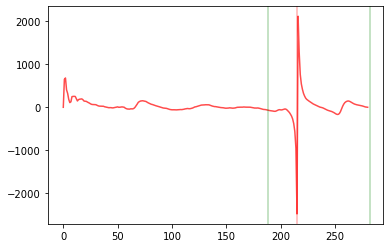

D =  1.1436170212765957 D_index =  215
max 1.0654920212765957 Cueve[D_index] 39.411312


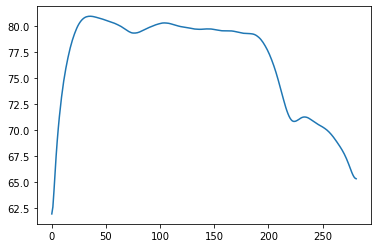

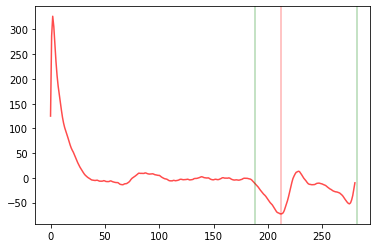

D =  1.127659574468085 D_index =  212
max 1.049534574468085 Cueve[D_index] 73.69954


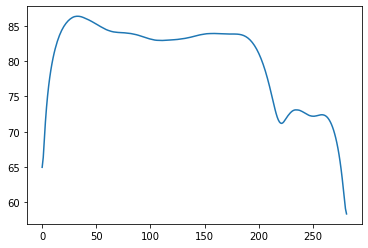

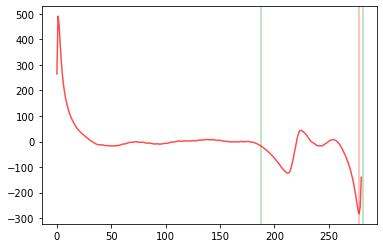

D =  1.478723404255319 D_index =  278
max 1.400598404255319 Cueve[D_index] 61.946114
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.3560

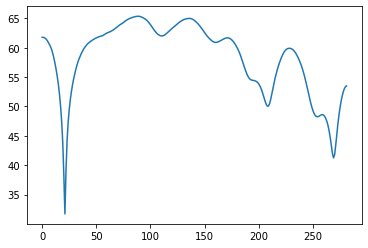

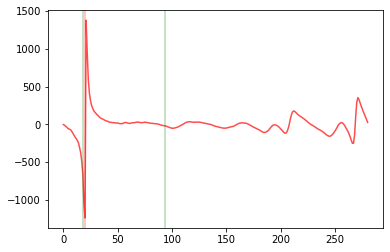

D =  0.11063829787234043 D_index =  20
max 0.1 Cueve[D_index] 38.302334


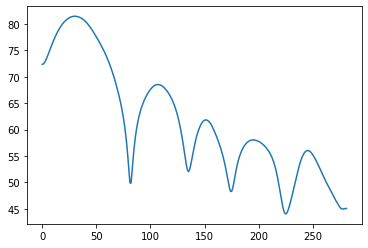

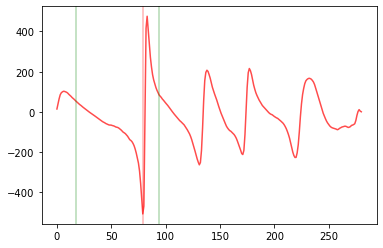

D =  0.424468085106383 D_index =  79
max 0.330718085106383 Cueve[D_index] 55.11373


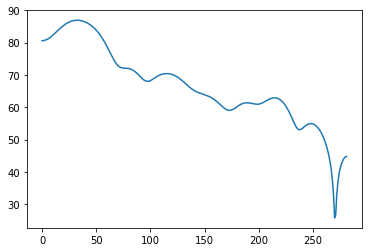

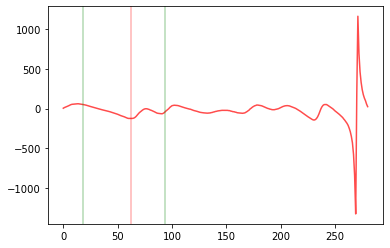

D =  0.33404255319148934 D_index =  62
max 0.24029255319148934 Cueve[D_index] 77.39722
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.35

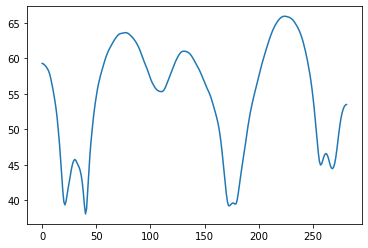

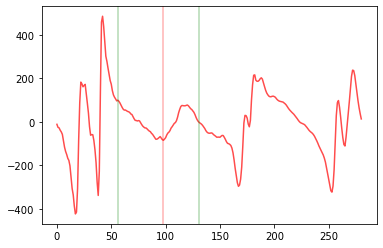

D =  0.5234042553191489 D_index =  98
max 0.4452792553191489 Cueve[D_index] 58.00977


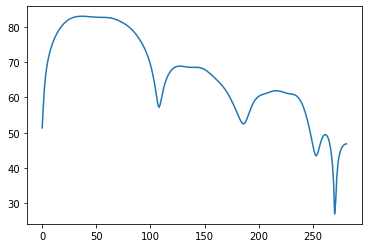

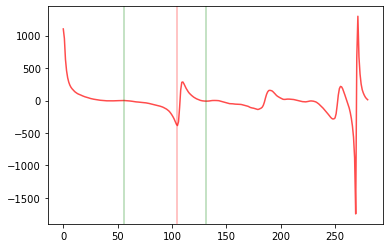

D =  0.5606382978723404 D_index =  105
max 0.48251329787234043 Cueve[D_index] 61.558067


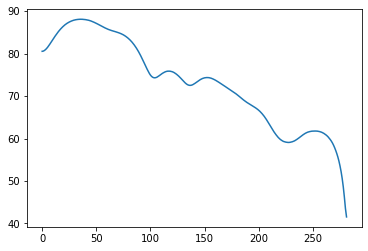

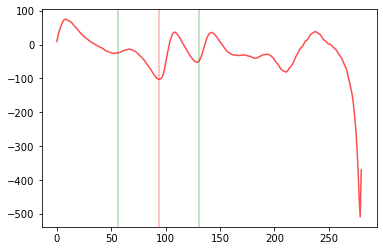

D =  0.502127659574468 D_index =  94
max 0.42400265957446803 Cueve[D_index] 77.88527
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.3560

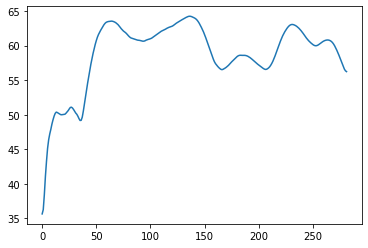

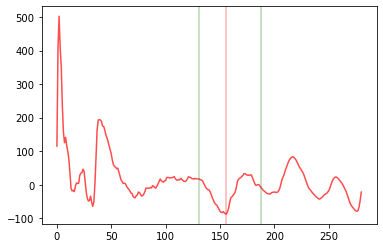

D =  0.8329787234042553 D_index =  156
max 0.7548537234042553 Cueve[D_index] 58.925526


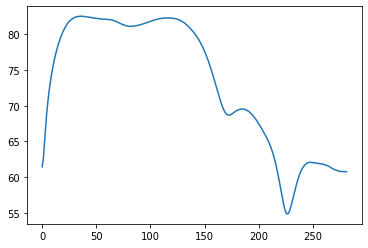

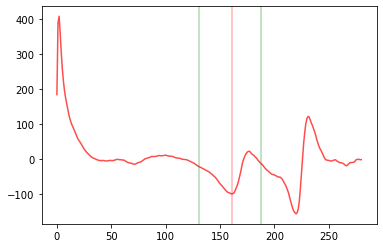

D =  0.8595744680851063 D_index =  161
max 0.7814494680851063 Cueve[D_index] 72.52428


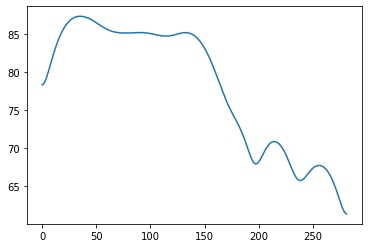

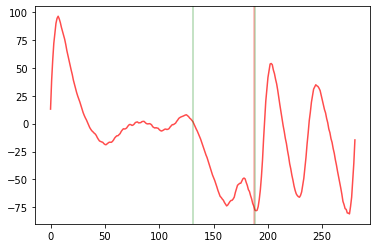

D =  0.9978723404255319 D_index =  187
max 0.9197473404255319 Cueve[D_index] 71.10367
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.356

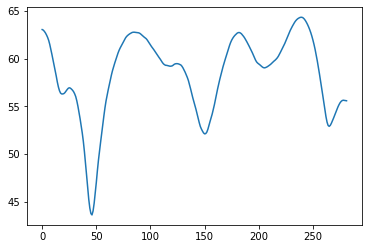

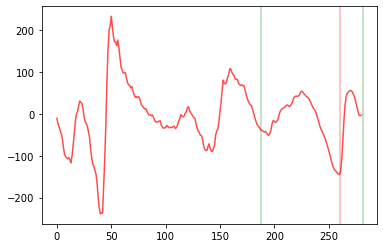

D =  1.3829787234042552 D_index =  260
max 1.3048537234042552 Cueve[D_index] 55.44254


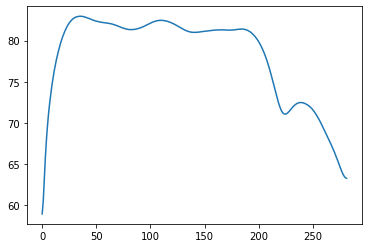

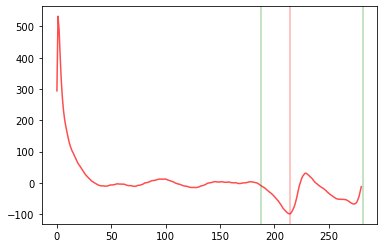

D =  1.1382978723404256 D_index =  214
max 1.0601728723404256 Cueve[D_index] 74.51246


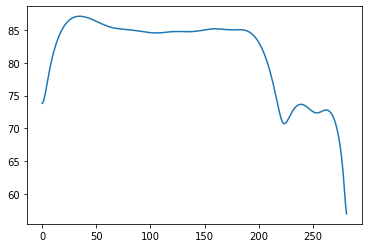

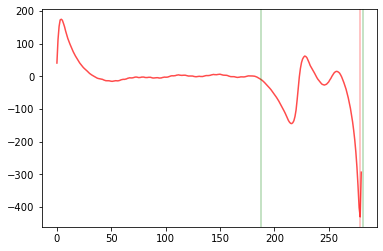

D =  1.4840425531914894 D_index =  279
max 1.4059175531914894 Cueve[D_index] 60.751205
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.35

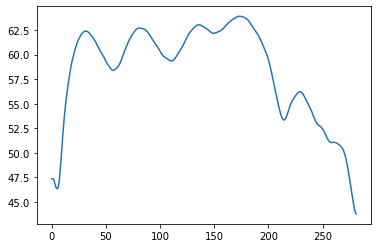

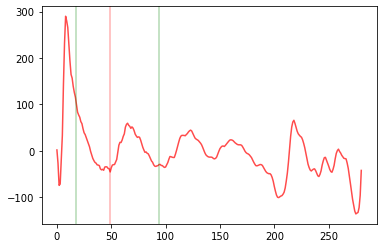

D =  0.26489361702127656 D_index =  49
max 0.18676861702127656 Cueve[D_index] 59.546703


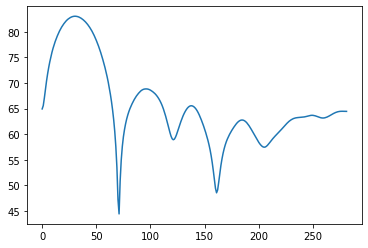

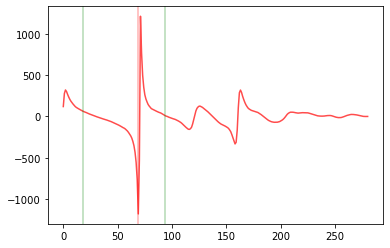

D =  0.37127659574468086 D_index =  69
max 0.29315159574468086 Cueve[D_index] 53.524334


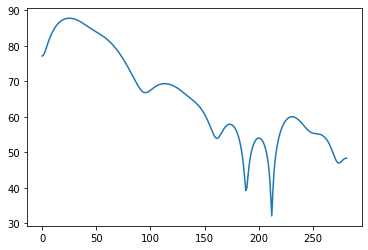

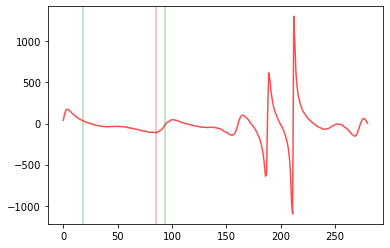

D =  0.4563829787234043 D_index =  85
max 0.3782579787234043 Cueve[D_index] 70.73258
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.3560

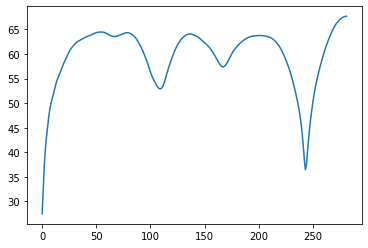

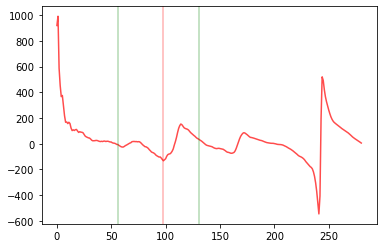

D =  0.5234042553191489 D_index =  98
max 0.4452792553191489 Cueve[D_index] 57.69126


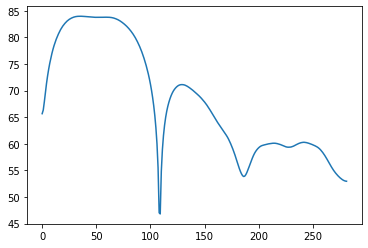

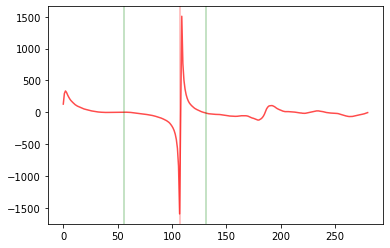

D =  0.5712765957446808 D_index =  107
max 0.4931515957446808 Cueve[D_index] 55.515823


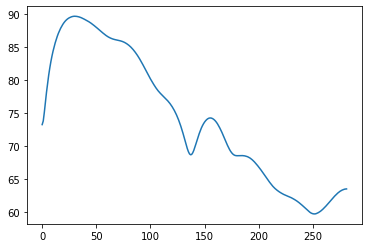

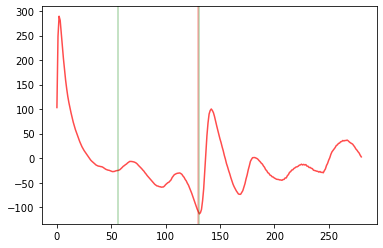

D =  0.6936170212765957 D_index =  130
max 0.6154920212765957 Cueve[D_index] 71.939835
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.35

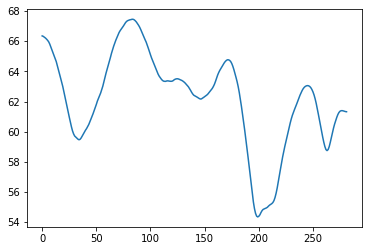

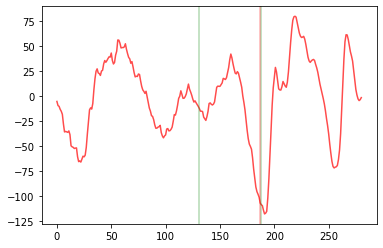

D =  0.9978723404255319 D_index =  187
max 0.9197473404255319 Cueve[D_index] 60.096966


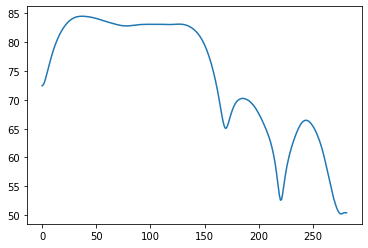

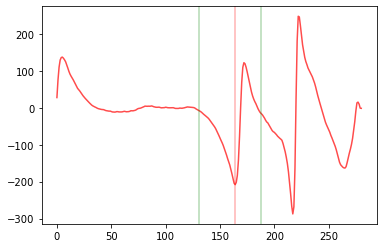

D =  0.8755319148936169 D_index =  164
max 0.7974069148936169 Cueve[D_index] 69.40753


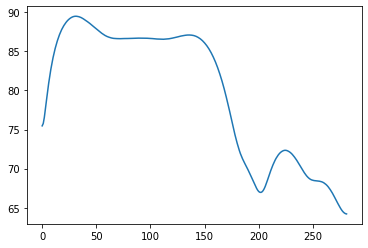

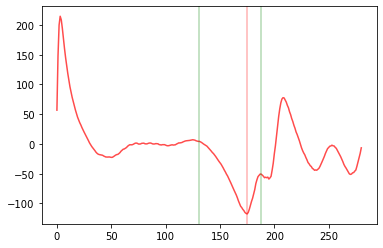

D =  0.9340425531914893 D_index =  175
max 0.8559175531914893 Cueve[D_index] 76.15773
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.356

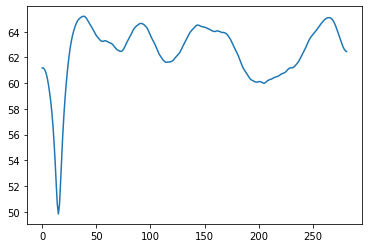

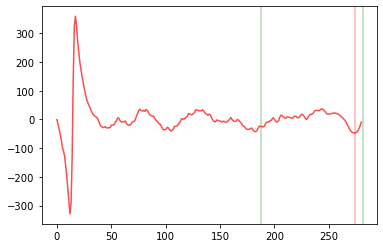

D =  1.4574468085106382 D_index =  274
max 1.3793218085106382 Cueve[D_index] 63.71391


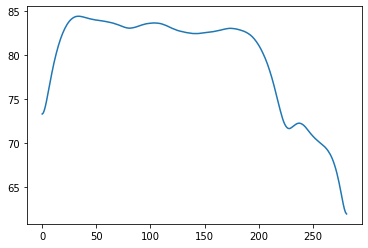

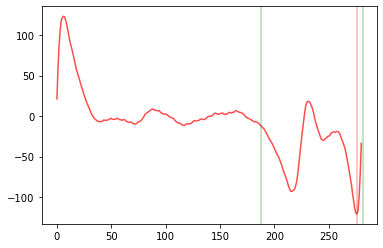

D =  1.4680851063829787 D_index =  276
max 1.3899601063829787 Cueve[D_index] 64.34335


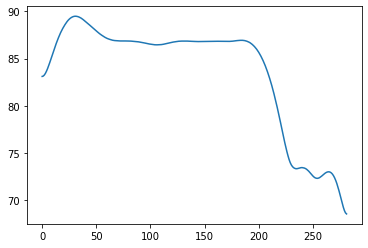

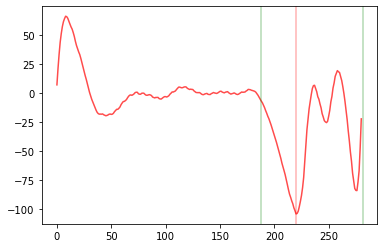

D =  1.1702127659574468 D_index =  220
max 1.0920877659574468 Cueve[D_index] 78.2666
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.3560

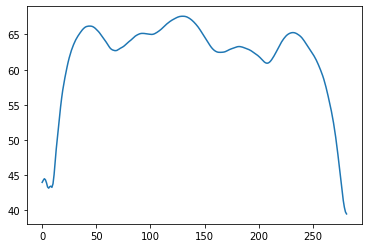

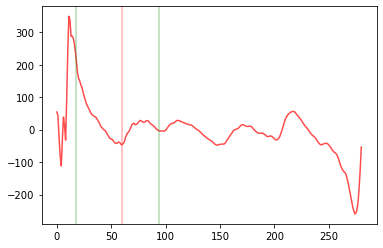

D =  0.32340425531914896 D_index =  60
max 0.24527925531914896 Cueve[D_index] 63.69253


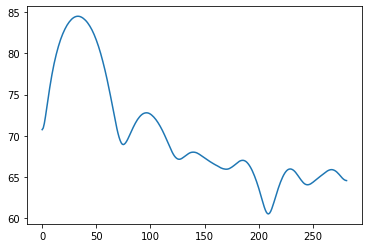

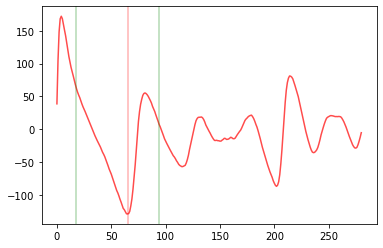

D =  0.35 D_index =  65
max 0.271875 Cueve[D_index] 73.52964


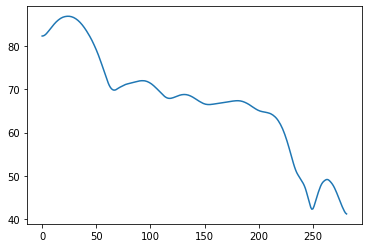

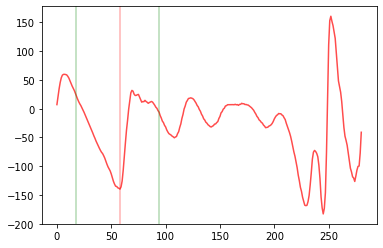

D =  0.3127659574468085 D_index =  58
max 0.23464095744680852 Cueve[D_index] 73.58993
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.356

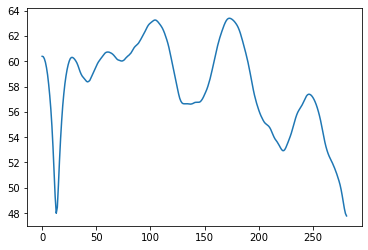

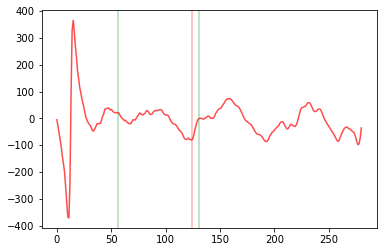

D =  0.6617021276595745 D_index =  124
max 0.5835771276595745 Cueve[D_index] 58.23816


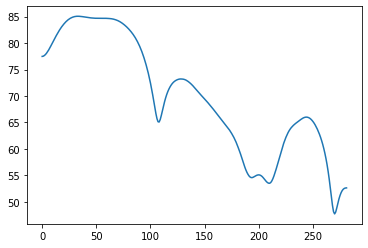

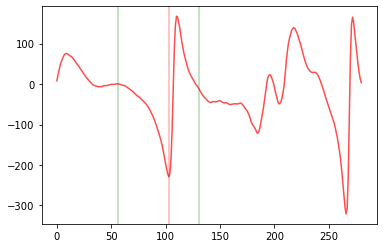

D =  0.55 D_index =  103
max 0.47187500000000004 Cueve[D_index] 69.08035


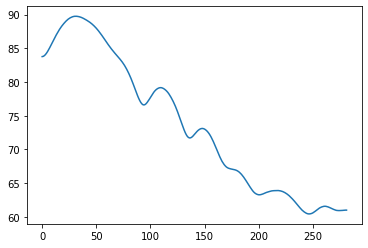

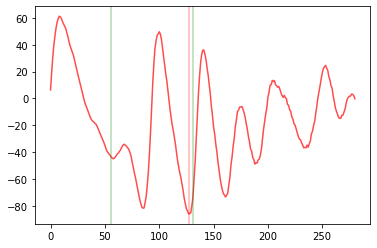

D =  0.6776595744680851 D_index =  127
max 0.5995345744680851 Cueve[D_index] 74.69542
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.356

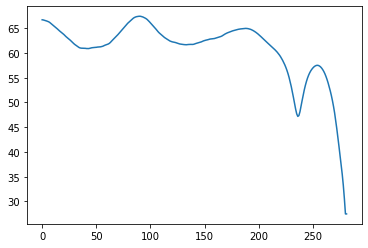

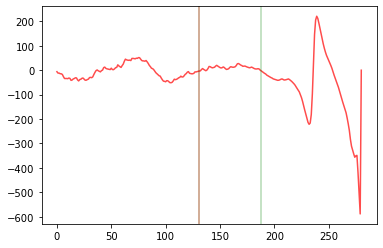

D =  0.7 D_index =  131
max 0.7 Cueve[D_index] 61.70561


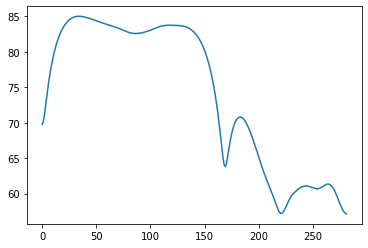

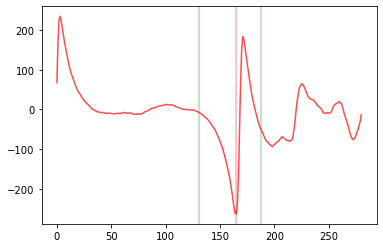

D =  0.8808510638297872 D_index =  165
max 0.8027260638297872 Cueve[D_index] 67.66145


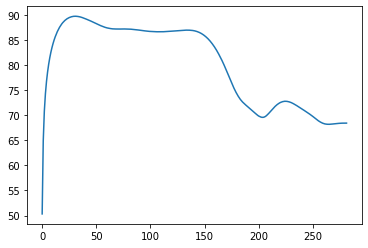

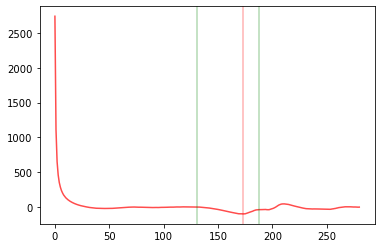

D =  0.9234042553191488 D_index =  173
max 0.8452792553191488 Cueve[D_index] 77.42395
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.356

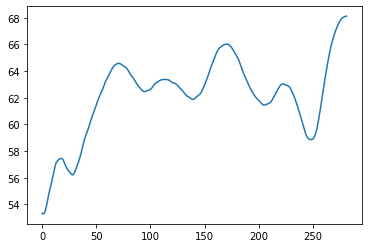

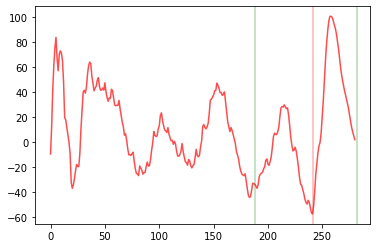

D =  1.2819148936170213 D_index =  241
max 1.2037898936170213 Cueve[D_index] 59.945824


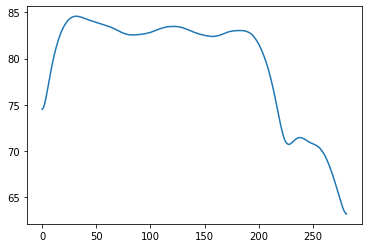

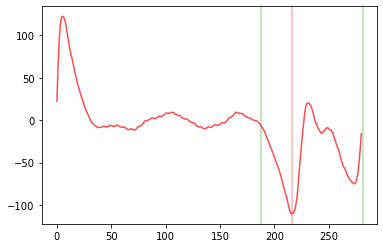

D =  1.148936170212766 D_index =  216
max 1.070811170212766 Cueve[D_index] 75.20621


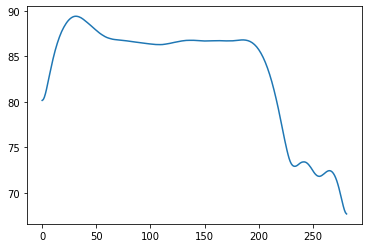

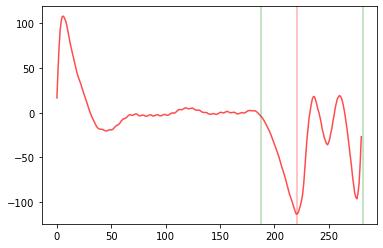

D =  1.175531914893617 D_index =  221
max 1.097406914893617 Cueve[D_index] 77.51967
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.35604

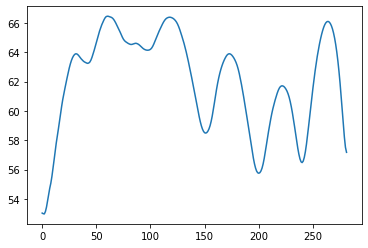

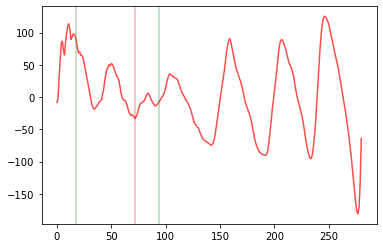

D =  0.3872340425531915 D_index =  72
max 0.3091090425531915 Cueve[D_index] 65.37274


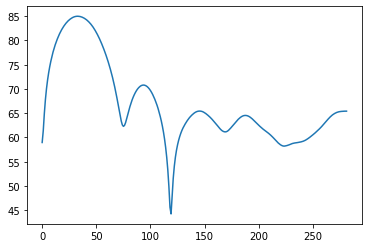

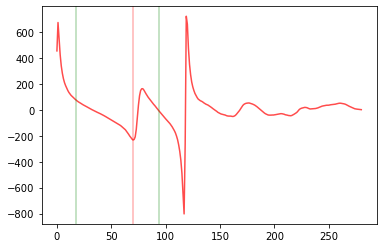

D =  0.3765957446808511 D_index =  70
max 0.2984707446808511 Cueve[D_index] 66.9737


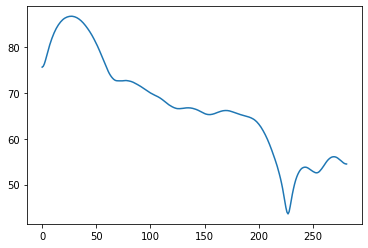

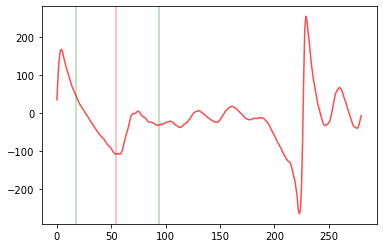

D =  0.2914893617021277 D_index =  54
max 0.2133643617021277 Cueve[D_index] 78.66533
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.3560

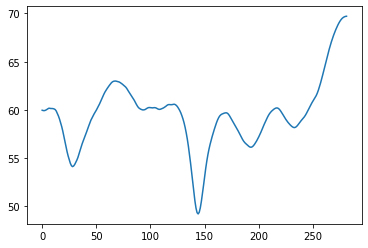

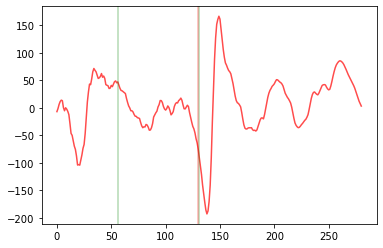

D =  0.6936170212765957 D_index =  130
max 0.6154920212765957 Cueve[D_index] 59.05563


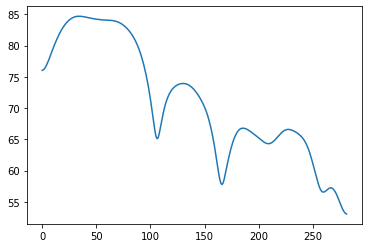

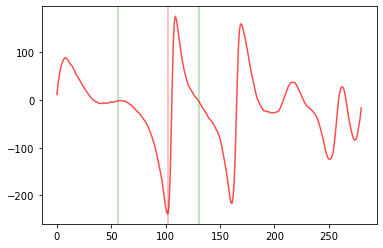

D =  0.5446808510638298 D_index =  102
max 0.4665558510638298 Cueve[D_index] 68.92427


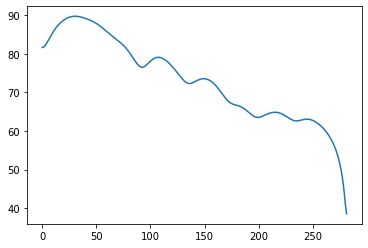

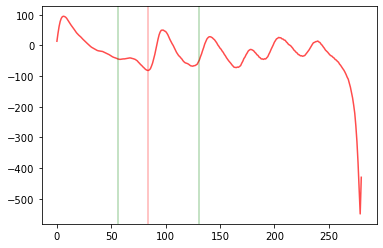

D =  0.44893617021276594 D_index =  84
max 0.37081117021276594 Cueve[D_index] 78.93719
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.35

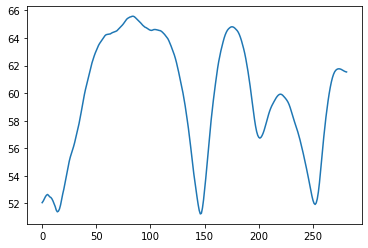

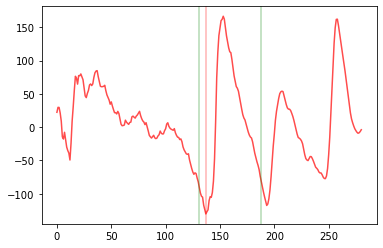

D =  0.7319148936170212 D_index =  137
max 0.7 Cueve[D_index] 56.175


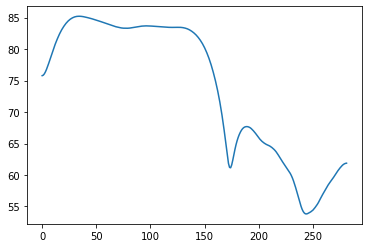

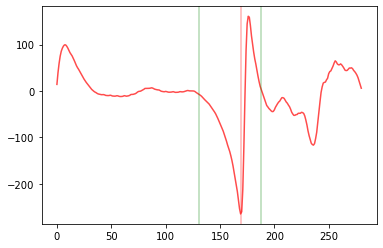

D =  0.902127659574468 D_index =  169
max 0.824002659574468 Cueve[D_index] 65.76599


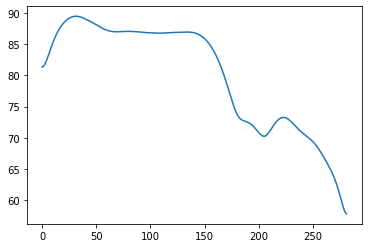

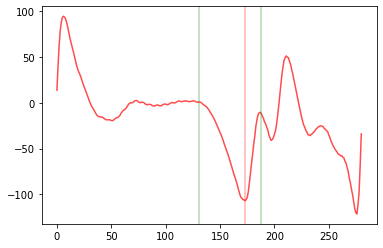

D =  0.9234042553191488 D_index =  173
max 0.8452792553191488 Cueve[D_index] 77.19903
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.356

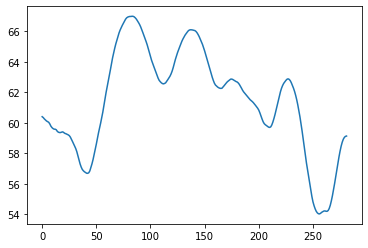

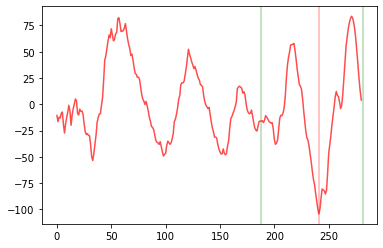

D =  1.2819148936170213 D_index =  241
max 1.2037898936170213 Cueve[D_index] 58.926014


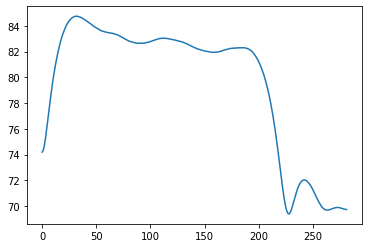

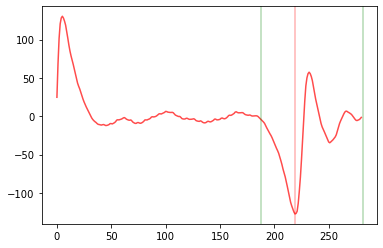

D =  1.1648936170212765 D_index =  219
max 1.0867686170212765 Cueve[D_index] 73.4404


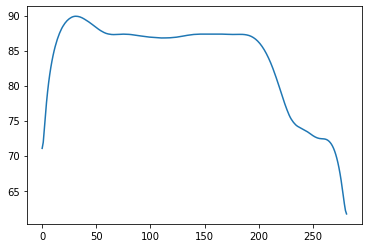

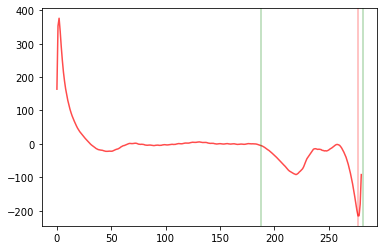

D =  1.4734042553191489 D_index =  277
max 1.3952792553191489 Cueve[D_index] 65.41495
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.356

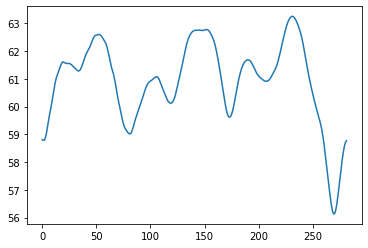

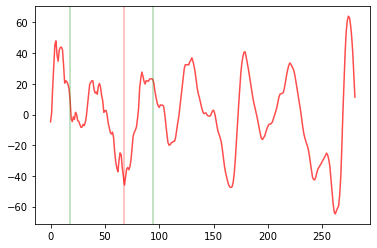

D =  0.3659574468085106 D_index =  68
max 0.2878324468085106 Cueve[D_index] 60.74252


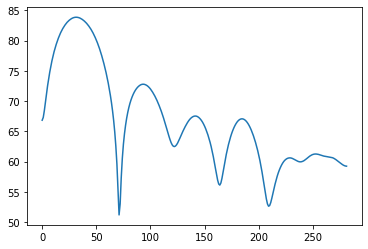

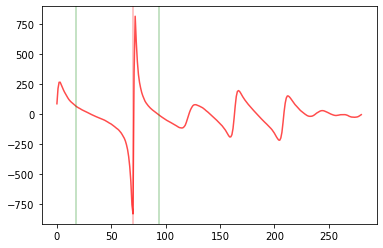

D =  0.3765957446808511 D_index =  70
max 0.2984707446808511 Cueve[D_index] 55.587097


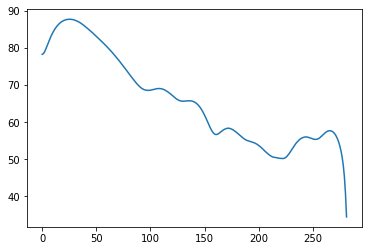

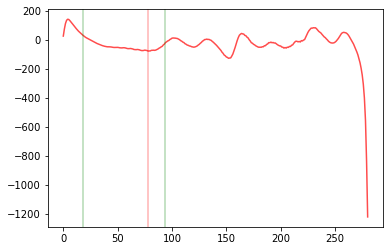

D =  0.41914893617021276 D_index =  78
max 0.34102393617021276 Cueve[D_index] 73.8602
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.356

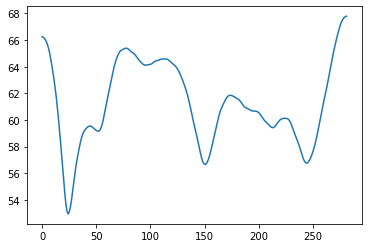

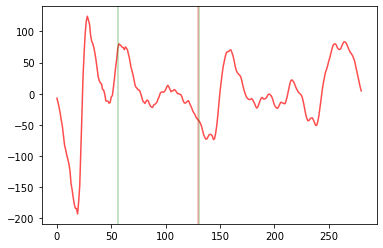

D =  0.6936170212765957 D_index =  130
max 0.6154920212765957 Cueve[D_index] 62.91212


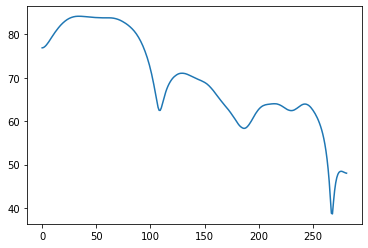

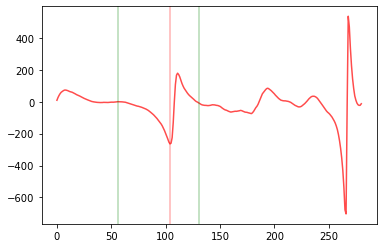

D =  0.5553191489361702 D_index =  104
max 0.4771941489361702 Cueve[D_index] 67.16617


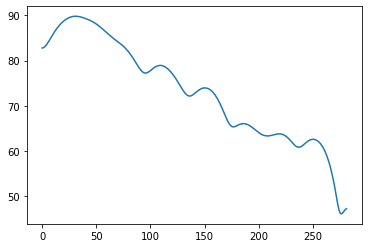

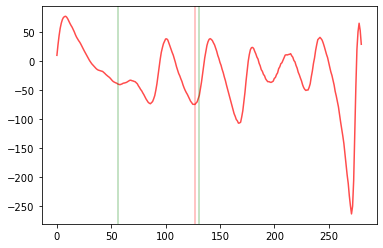

D =  0.6776595744680851 D_index =  127
max 0.5995345744680851 Cueve[D_index] 74.59115
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.356

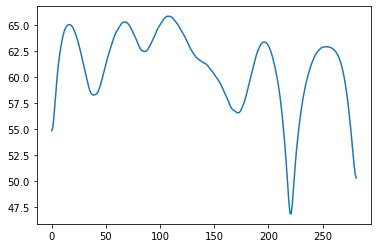

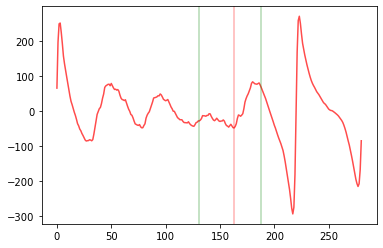

D =  0.8702127659574468 D_index =  163
max 0.7920877659574468 Cueve[D_index] 57.677258


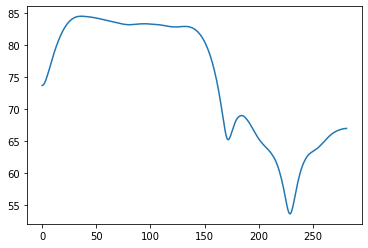

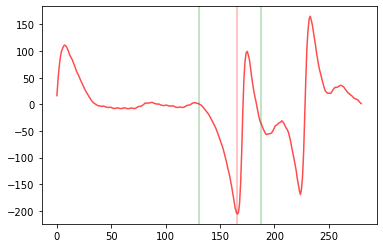

D =  0.8861702127659574 D_index =  166
max 0.8080452127659574 Cueve[D_index] 69.66028


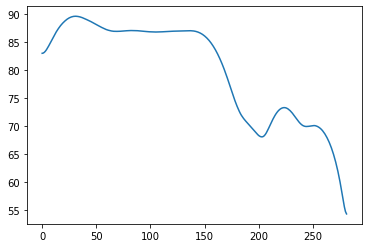

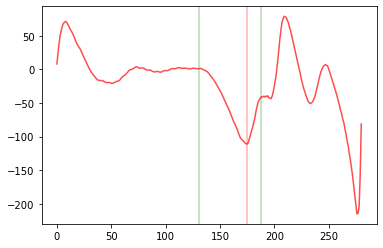

D =  0.9340425531914893 D_index =  175
max 0.8559175531914893 Cueve[D_index] 76.23643
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.356

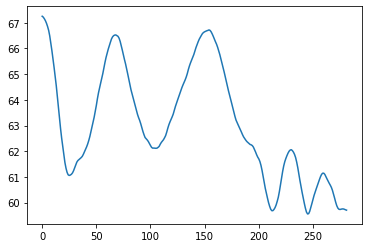

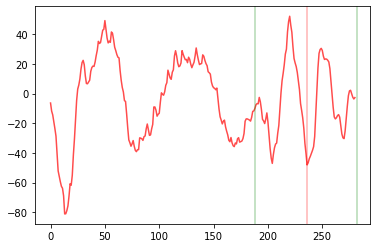

D =  1.2553191489361701 D_index =  236
max 1.1771941489361701 Cueve[D_index] 61.359505


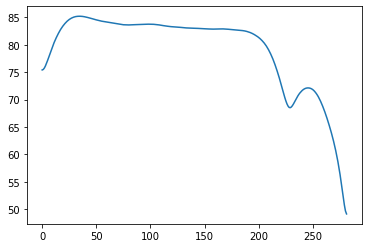

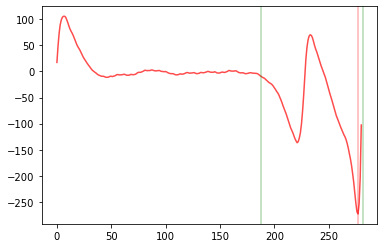

D =  1.4734042553191489 D_index =  277
max 1.3952792553191489 Cueve[D_index] 53.57184


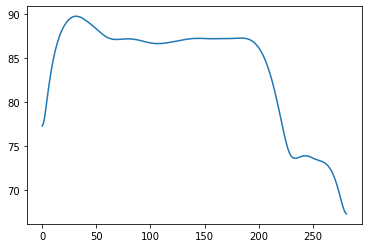

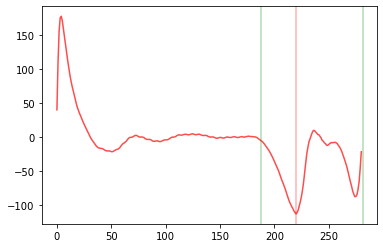

D =  1.1702127659574468 D_index =  220
max 1.0920877659574468 Cueve[D_index] 78.29277
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.356

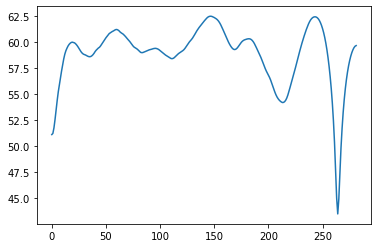

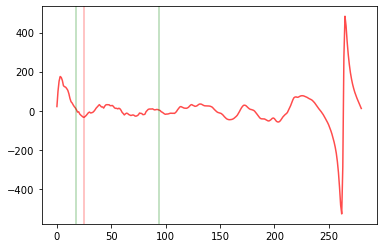

D =  0.1372340425531915 D_index =  25
max 0.1 Cueve[D_index] 59.404217


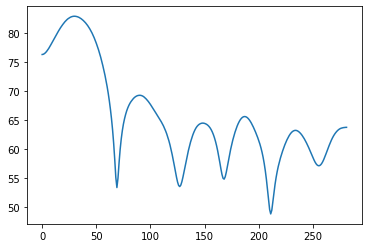

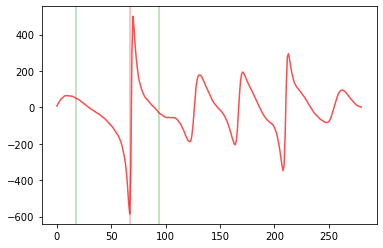

D =  0.3606382978723405 D_index =  67
max 0.2825132978723405 Cueve[D_index] 58.224636


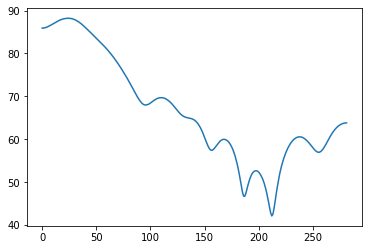

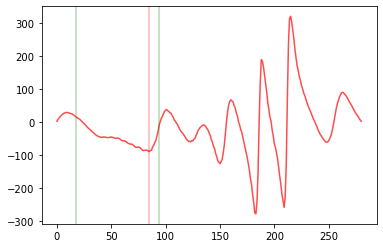

D =  0.4563829787234043 D_index =  85
max 0.3782579787234043 Cueve[D_index] 71.21414
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.3560

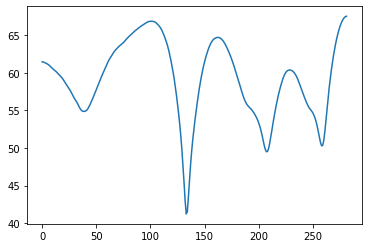

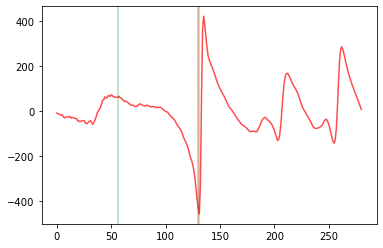

D =  0.6936170212765957 D_index =  130
max 0.6154920212765957 Cueve[D_index] 47.67402


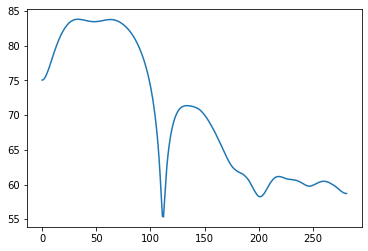

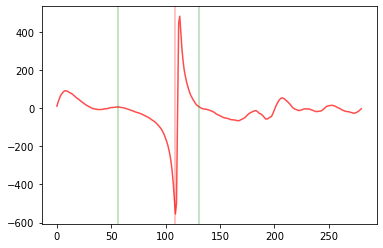

D =  0.5819148936170213 D_index =  109
max 0.5037898936170213 Cueve[D_index] 61.05481


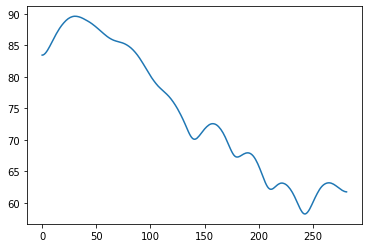

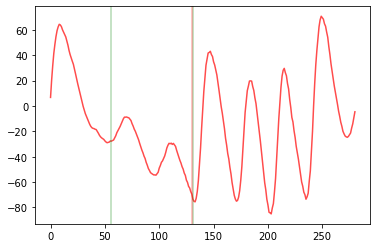

D =  0.6936170212765957 D_index =  130
max 0.6154920212765957 Cueve[D_index] 73.24954
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.356

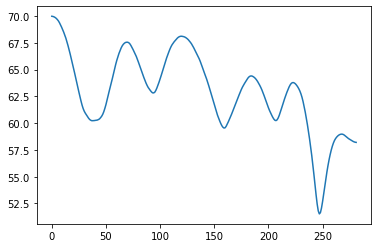

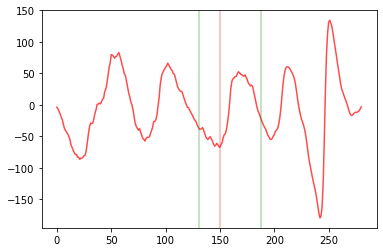

D =  0.801063829787234 D_index =  150
max 0.722938829787234 Cueve[D_index] 61.754528


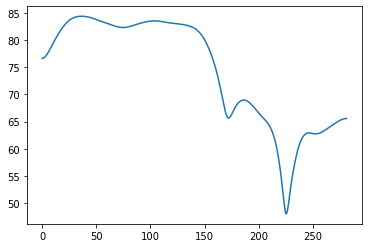

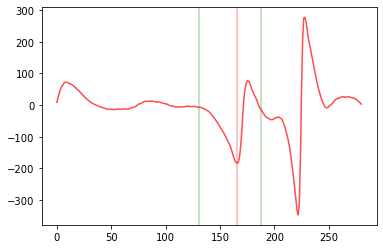

D =  0.8861702127659574 D_index =  166
max 0.8080452127659574 Cueve[D_index] 69.74308


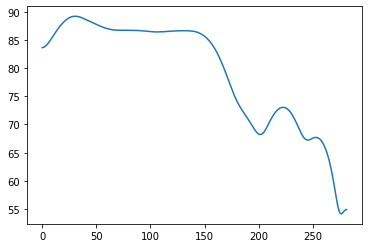

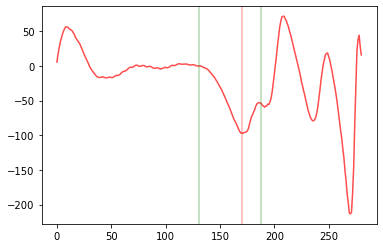

D =  0.9074468085106382 D_index =  170
max 0.8293218085106382 Cueve[D_index] 78.88798
calc_overtone_index [29.13523509488062, 58.27047018976124, 87.40570528464187, 116.54094037952248, 145.6761754744031, 174.81141056928374, 203.94664566416435, 233.08188075904496, 262.2171158539256, 291.3523509488062, 320.4875860436868, 349.6228211385675, 378.7580562334481, 407.8932913283287, 437.0285264232093, 466.1637615180899, 495.29899661297054, 524.4342317078512, 553.5694668027318, 582.7047018976124, 611.839936992493, 640.9751720873736, 670.1104071822542, 699.245642277135, 728.3808773720156, 757.5161124668962, 786.6513475617768, 815.7865826566574, 844.921817751538, 874.0570528464186, 903.1922879412992, 932.3275230361799, 961.4627581310605, 990.5979932259411, 1019.7332283208217, 1048.8684634157023, 1078.003698510583, 1107.1389336054635, 1136.2741687003443, 1165.4094037952248, 1194.5446388901055, 1223.679873984986, 1252.8151090798667, 1281.9503441747472, 1311.085579269628, 1340.2208143645084, 1369.356

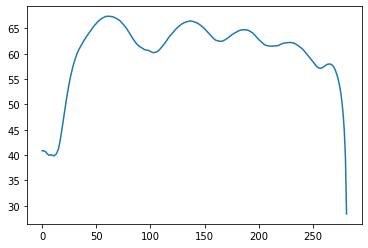

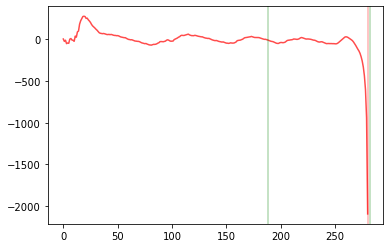

D =  1.4893617021276595 D_index =  280
max 1.4112367021276595 Cueve[D_index] 39.526154


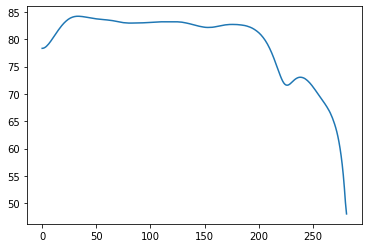

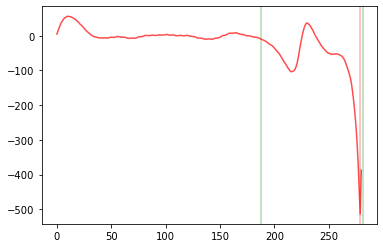

D =  1.4840425531914894 D_index =  279
max 1.4059175531914894 Cueve[D_index] 52.832317


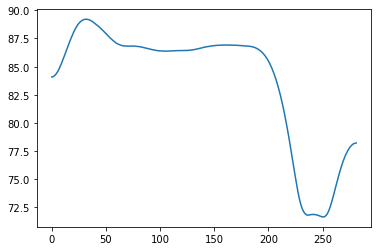

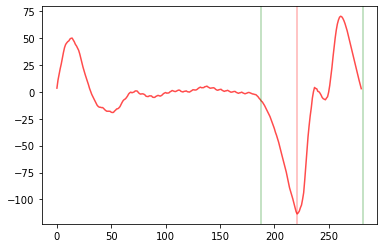

D =  1.175531914893617 D_index =  221
max 1.097406914893617 Cueve[D_index] 77.48456
calc_overtone_index [30.86770632850775, 61.7354126570155, 92.60311898552325, 123.470825314031, 154.33853164253875, 185.2062379710465, 216.07394429955426, 246.941650628062, 277.8093569565698, 308.6770632850775, 339.54476961358523, 370.412475942093, 401.2801822706008, 432.1478885991085, 463.01559492761623, 493.883301256124, 524.7510075846318, 555.6187139131396, 586.4864202416472, 617.354126570155, 648.2218328986628, 679.0895392271705, 709.9572455556782, 740.824951884186, 771.6926582126938, 802.5603645412016, 833.4280708697092, 864.295777198217, 895.1634835267248, 926.0311898552325, 956.8988961837402, 987.766602512248, 1018.6343088407558, 1049.5020151692636, 1080.3697214977713, 1111.2374278262791, 1142.1051341547868, 1172.9728404832945, 1203.8405468118024, 1234.70825314031, 1265.5759594688177, 1296.4436657973256, 1327.3113721258333, 1358.179078454341, 1389.0467847828488, 1419.9144911113565, 1450.7821974398

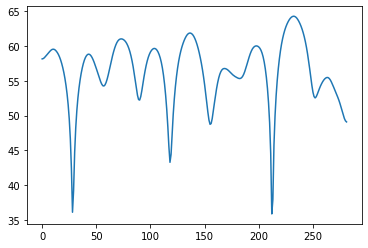

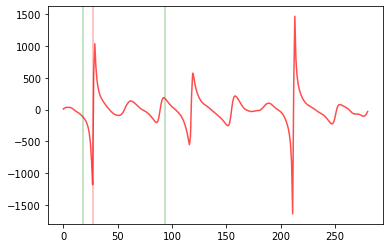

D =  0.14787234042553193 D_index =  27
max 0.11662234042553193 Cueve[D_index] 42.37638


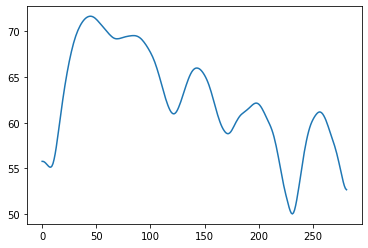

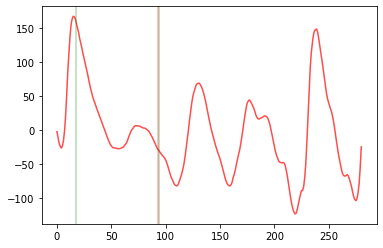

D =  0.49893617021276593 D_index =  93
max 0.46768617021276593 Cueve[D_index] 68.97323


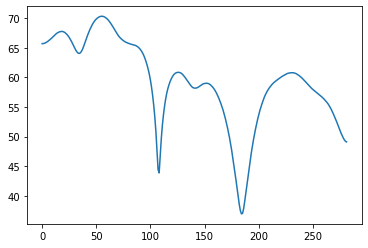

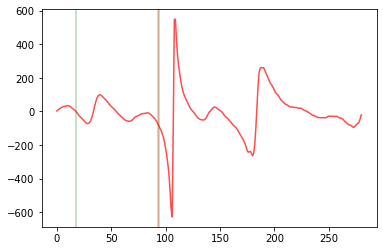

D =  0.49893617021276593 D_index =  93
max 0.46768617021276593 Cueve[D_index] 64.00379
calc_overtone_index [30.86770632850775, 61.7354126570155, 92.60311898552325, 123.470825314031, 154.33853164253875, 185.2062379710465, 216.07394429955426, 246.941650628062, 277.8093569565698, 308.6770632850775, 339.54476961358523, 370.412475942093, 401.2801822706008, 432.1478885991085, 463.01559492761623, 493.883301256124, 524.7510075846318, 555.6187139131396, 586.4864202416472, 617.354126570155, 648.2218328986628, 679.0895392271705, 709.9572455556782, 740.824951884186, 771.6926582126938, 802.5603645412016, 833.4280708697092, 864.295777198217, 895.1634835267248, 926.0311898552325, 956.8988961837402, 987.766602512248, 1018.6343088407558, 1049.5020151692636, 1080.3697214977713, 1111.2374278262791, 1142.1051341547868, 1172.9728404832945, 1203.8405468118024, 1234.70825314031, 1265.5759594688177, 1296.4436657973256, 1327.3113721258333, 1358.179078454341, 1389.0467847828488, 1419.9144911113565, 1450.7821974

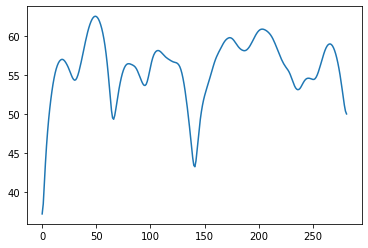

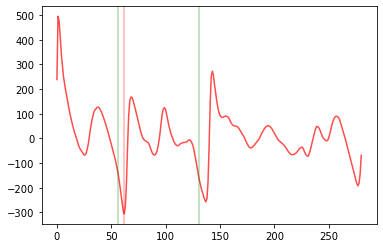

D =  0.33191489361702126 D_index =  62
max 0.3 Cueve[D_index] 53.526443


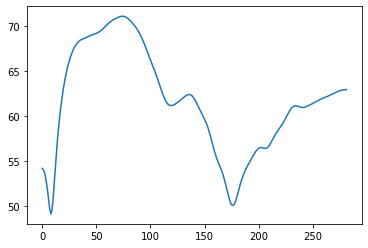

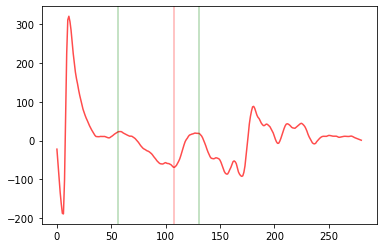

D =  0.5765957446808511 D_index =  108
max 0.49847074468085106 Cueve[D_index] 63.616573


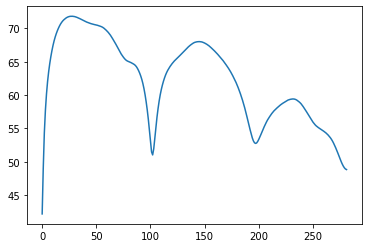

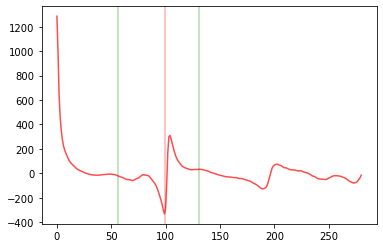

D =  0.5287234042553192 D_index =  99
max 0.45059840425531916 Cueve[D_index] 54.754593
calc_overtone_index [30.86770632850775, 61.7354126570155, 92.60311898552325, 123.470825314031, 154.33853164253875, 185.2062379710465, 216.07394429955426, 246.941650628062, 277.8093569565698, 308.6770632850775, 339.54476961358523, 370.412475942093, 401.2801822706008, 432.1478885991085, 463.01559492761623, 493.883301256124, 524.7510075846318, 555.6187139131396, 586.4864202416472, 617.354126570155, 648.2218328986628, 679.0895392271705, 709.9572455556782, 740.824951884186, 771.6926582126938, 802.5603645412016, 833.4280708697092, 864.295777198217, 895.1634835267248, 926.0311898552325, 956.8988961837402, 987.766602512248, 1018.6343088407558, 1049.5020151692636, 1080.3697214977713, 1111.2374278262791, 1142.1051341547868, 1172.9728404832945, 1203.8405468118024, 1234.70825314031, 1265.5759594688177, 1296.4436657973256, 1327.3113721258333, 1358.179078454341, 1389.0467847828488, 1419.9144911113565, 1450.7821974

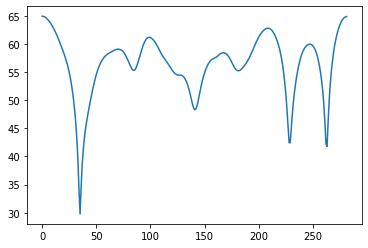

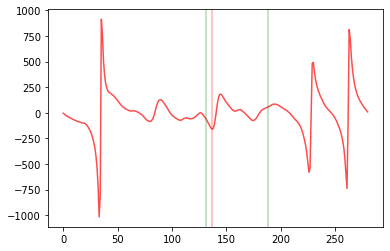

D =  0.7319148936170212 D_index =  137
max 0.7 Cueve[D_index] 50.786964


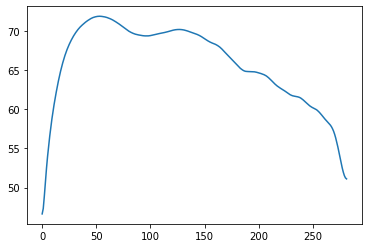

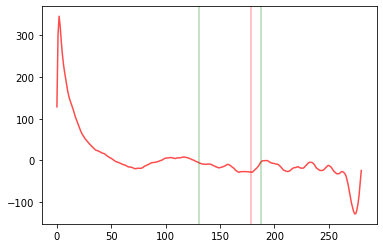

D =  0.9553191489361701 D_index =  179
max 0.8771941489361701 Cueve[D_index] 65.770424


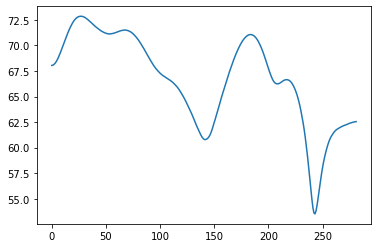

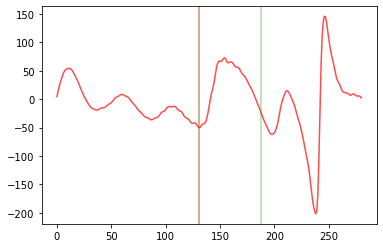

D =  0.7 D_index =  131
max 0.7 Cueve[D_index] 62.84017
calc_overtone_index [30.86770632850775, 61.7354126570155, 92.60311898552325, 123.470825314031, 154.33853164253875, 185.2062379710465, 216.07394429955426, 246.941650628062, 277.8093569565698, 308.6770632850775, 339.54476961358523, 370.412475942093, 401.2801822706008, 432.1478885991085, 463.01559492761623, 493.883301256124, 524.7510075846318, 555.6187139131396, 586.4864202416472, 617.354126570155, 648.2218328986628, 679.0895392271705, 709.9572455556782, 740.824951884186, 771.6926582126938, 802.5603645412016, 833.4280708697092, 864.295777198217, 895.1634835267248, 926.0311898552325, 956.8988961837402, 987.766602512248, 1018.6343088407558, 1049.5020151692636, 1080.3697214977713, 1111.2374278262791, 1142.1051341547868, 1172.9728404832945, 1203.8405468118024, 1234.70825314031, 1265.5759594688177, 1296.4436657973256, 1327.3113721258333, 1358.179078454341, 1389.0467847828488, 1419.9144911113565, 1450.7821974398644, 1481.649903768372, 1512

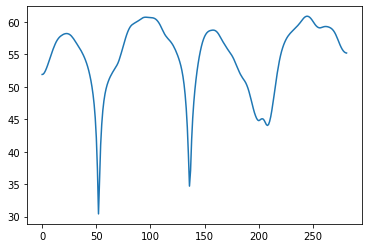

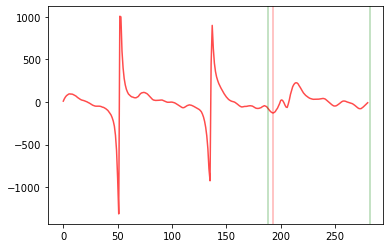

D =  1.0265957446808511 D_index =  193
max 1 Cueve[D_index] 47.955482


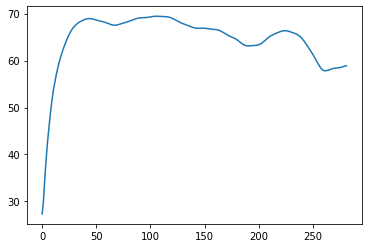

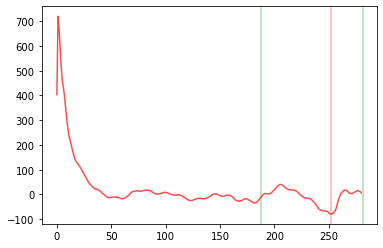

D =  1.3404255319148937 D_index =  252
max 1.2623005319148937 Cueve[D_index] 60.473507


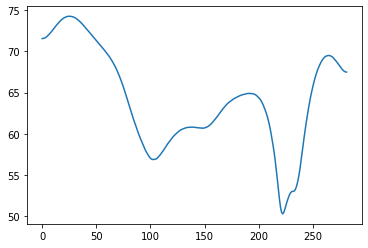

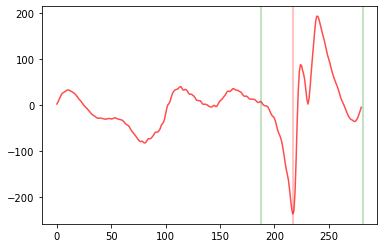

D =  1.1542553191489362 D_index =  217
max 1.0761303191489362 Cueve[D_index] 54.605797
calc_overtone_index [30.86770632850775, 61.7354126570155, 92.60311898552325, 123.470825314031, 154.33853164253875, 185.2062379710465, 216.07394429955426, 246.941650628062, 277.8093569565698, 308.6770632850775, 339.54476961358523, 370.412475942093, 401.2801822706008, 432.1478885991085, 463.01559492761623, 493.883301256124, 524.7510075846318, 555.6187139131396, 586.4864202416472, 617.354126570155, 648.2218328986628, 679.0895392271705, 709.9572455556782, 740.824951884186, 771.6926582126938, 802.5603645412016, 833.4280708697092, 864.295777198217, 895.1634835267248, 926.0311898552325, 956.8988961837402, 987.766602512248, 1018.6343088407558, 1049.5020151692636, 1080.3697214977713, 1111.2374278262791, 1142.1051341547868, 1172.9728404832945, 1203.8405468118024, 1234.70825314031, 1265.5759594688177, 1296.4436657973256, 1327.3113721258333, 1358.179078454341, 1389.0467847828488, 1419.9144911113565, 1450.7821974

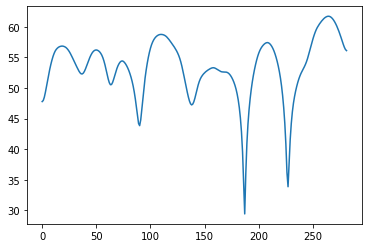

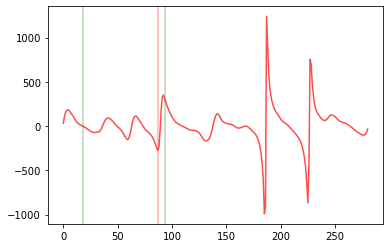

D =  0.46702127659574466 D_index =  87
max 0.38889627659574466 Cueve[D_index] 46.910503


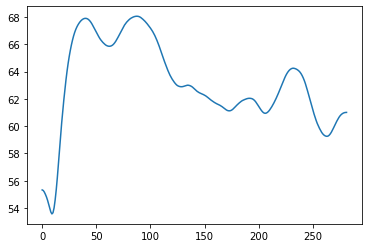

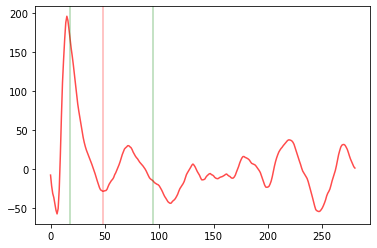

D =  0.2595744680851064 D_index =  48
max 0.18144946808510642 Cueve[D_index] 67.19323


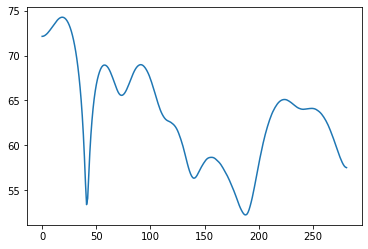

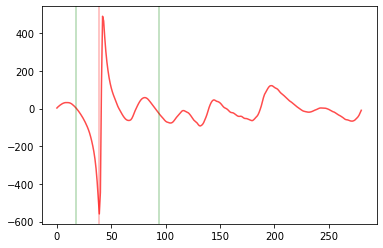

D =  0.21170212765957447 D_index =  39
max 0.13357712765957447 Cueve[D_index] 58.736668
calc_overtone_index [30.86770632850775, 61.7354126570155, 92.60311898552325, 123.470825314031, 154.33853164253875, 185.2062379710465, 216.07394429955426, 246.941650628062, 277.8093569565698, 308.6770632850775, 339.54476961358523, 370.412475942093, 401.2801822706008, 432.1478885991085, 463.01559492761623, 493.883301256124, 524.7510075846318, 555.6187139131396, 586.4864202416472, 617.354126570155, 648.2218328986628, 679.0895392271705, 709.9572455556782, 740.824951884186, 771.6926582126938, 802.5603645412016, 833.4280708697092, 864.295777198217, 895.1634835267248, 926.0311898552325, 956.8988961837402, 987.766602512248, 1018.6343088407558, 1049.5020151692636, 1080.3697214977713, 1111.2374278262791, 1142.1051341547868, 1172.9728404832945, 1203.8405468118024, 1234.70825314031, 1265.5759594688177, 1296.4436657973256, 1327.3113721258333, 1358.179078454341, 1389.0467847828488, 1419.9144911113565, 1450.782197

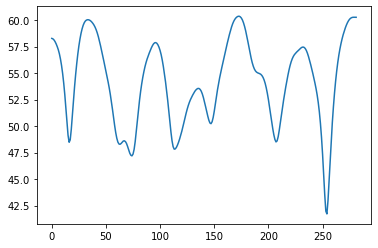

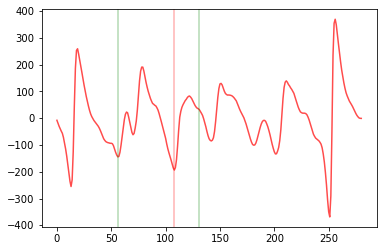

D =  0.5765957446808511 D_index =  108
max 0.49847074468085106 Cueve[D_index] 51.452957


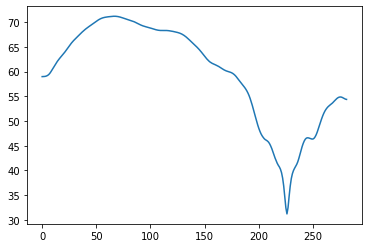

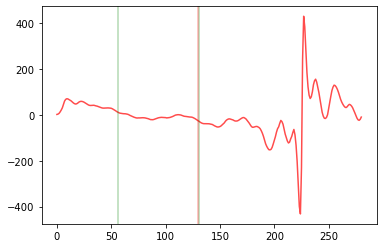

D =  0.6936170212765957 D_index =  130
max 0.6154920212765957 Cueve[D_index] 67.441185


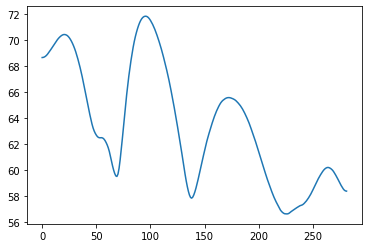

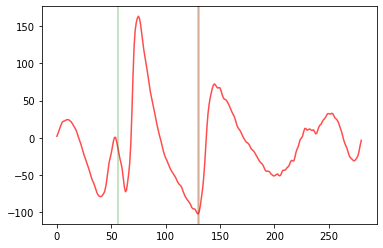

D =  0.6936170212765957 D_index =  130
max 0.6154920212765957 Cueve[D_index] 60.732975
calc_overtone_index [30.86770632850775, 61.7354126570155, 92.60311898552325, 123.470825314031, 154.33853164253875, 185.2062379710465, 216.07394429955426, 246.941650628062, 277.8093569565698, 308.6770632850775, 339.54476961358523, 370.412475942093, 401.2801822706008, 432.1478885991085, 463.01559492761623, 493.883301256124, 524.7510075846318, 555.6187139131396, 586.4864202416472, 617.354126570155, 648.2218328986628, 679.0895392271705, 709.9572455556782, 740.824951884186, 771.6926582126938, 802.5603645412016, 833.4280708697092, 864.295777198217, 895.1634835267248, 926.0311898552325, 956.8988961837402, 987.766602512248, 1018.6343088407558, 1049.5020151692636, 1080.3697214977713, 1111.2374278262791, 1142.1051341547868, 1172.9728404832945, 1203.8405468118024, 1234.70825314031, 1265.5759594688177, 1296.4436657973256, 1327.3113721258333, 1358.179078454341, 1389.0467847828488, 1419.9144911113565, 1450.7821974

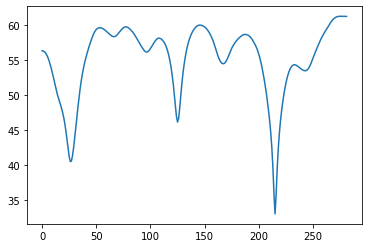

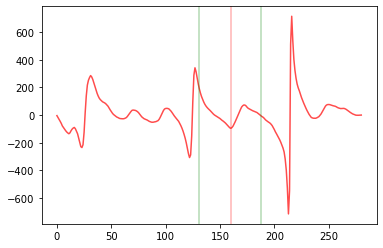

D =  0.8542553191489362 D_index =  160
max 0.7761303191489362 Cueve[D_index] 56.69956


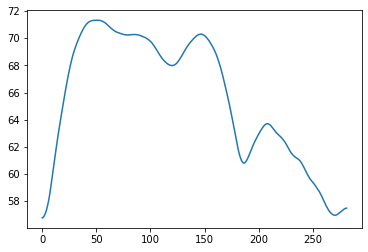

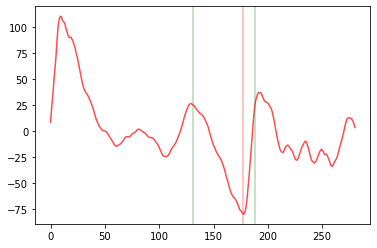

D =  0.9446808510638297 D_index =  177
max 0.8665558510638297 Cueve[D_index] 63.448074


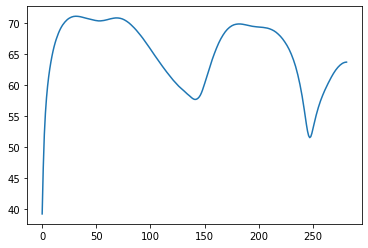

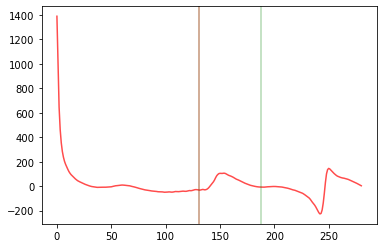

D =  0.7 D_index =  131
max 0.7 Cueve[D_index] 59.08173
calc_overtone_index [30.86770632850775, 61.7354126570155, 92.60311898552325, 123.470825314031, 154.33853164253875, 185.2062379710465, 216.07394429955426, 246.941650628062, 277.8093569565698, 308.6770632850775, 339.54476961358523, 370.412475942093, 401.2801822706008, 432.1478885991085, 463.01559492761623, 493.883301256124, 524.7510075846318, 555.6187139131396, 586.4864202416472, 617.354126570155, 648.2218328986628, 679.0895392271705, 709.9572455556782, 740.824951884186, 771.6926582126938, 802.5603645412016, 833.4280708697092, 864.295777198217, 895.1634835267248, 926.0311898552325, 956.8988961837402, 987.766602512248, 1018.6343088407558, 1049.5020151692636, 1080.3697214977713, 1111.2374278262791, 1142.1051341547868, 1172.9728404832945, 1203.8405468118024, 1234.70825314031, 1265.5759594688177, 1296.4436657973256, 1327.3113721258333, 1358.179078454341, 1389.0467847828488, 1419.9144911113565, 1450.7821974398644, 1481.649903768372, 1512

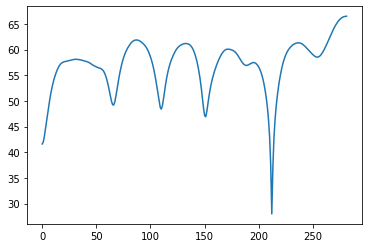

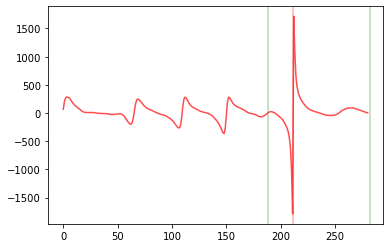

D =  1.122340425531915 D_index =  211
max 1.044215425531915 Cueve[D_index] 37.492447


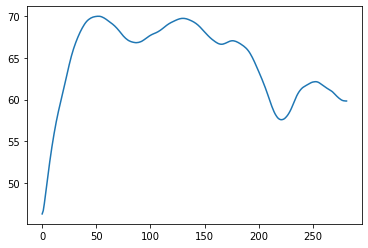

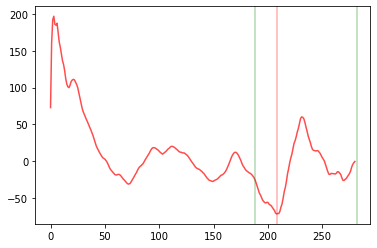

D =  1.1063829787234043 D_index =  208
max 1.0282579787234043 Cueve[D_index] 60.694942


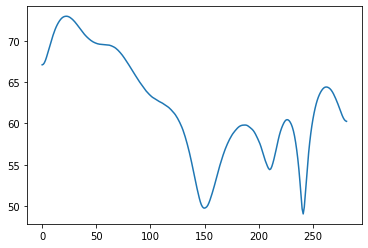

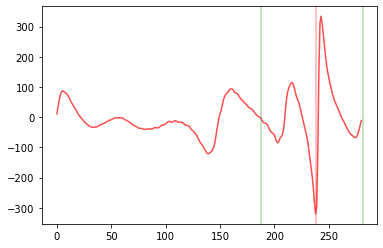

D =  1.2659574468085106 D_index =  238
max 1.1878324468085106 Cueve[D_index] 52.922577
calc_overtone_index [30.86770632850775, 61.7354126570155, 92.60311898552325, 123.470825314031, 154.33853164253875, 185.2062379710465, 216.07394429955426, 246.941650628062, 277.8093569565698, 308.6770632850775, 339.54476961358523, 370.412475942093, 401.2801822706008, 432.1478885991085, 463.01559492761623, 493.883301256124, 524.7510075846318, 555.6187139131396, 586.4864202416472, 617.354126570155, 648.2218328986628, 679.0895392271705, 709.9572455556782, 740.824951884186, 771.6926582126938, 802.5603645412016, 833.4280708697092, 864.295777198217, 895.1634835267248, 926.0311898552325, 956.8988961837402, 987.766602512248, 1018.6343088407558, 1049.5020151692636, 1080.3697214977713, 1111.2374278262791, 1142.1051341547868, 1172.9728404832945, 1203.8405468118024, 1234.70825314031, 1265.5759594688177, 1296.4436657973256, 1327.3113721258333, 1358.179078454341, 1389.0467847828488, 1419.9144911113565, 1450.7821974

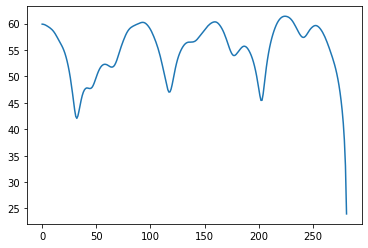

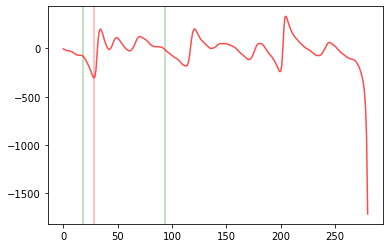

D =  0.15319148936170213 D_index =  28
max 0.1 Cueve[D_index] 46.84657


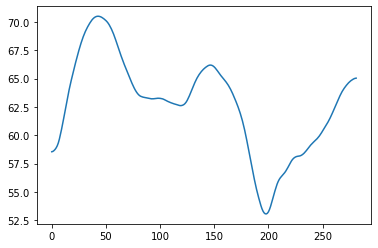

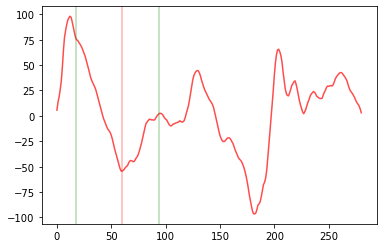

D =  0.32340425531914896 D_index =  60
max 0.19840425531914896 Cueve[D_index] 68.119026


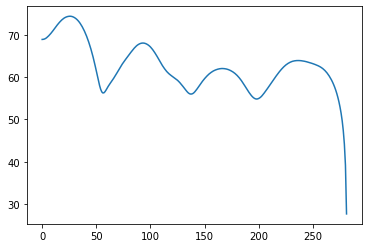

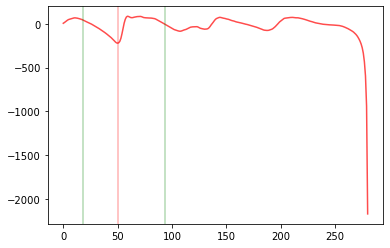

D =  0.2702127659574468 D_index =  50
max 0.1452127659574468 Cueve[D_index] 61.430214
calc_overtone_index [30.86770632850775, 61.7354126570155, 92.60311898552325, 123.470825314031, 154.33853164253875, 185.2062379710465, 216.07394429955426, 246.941650628062, 277.8093569565698, 308.6770632850775, 339.54476961358523, 370.412475942093, 401.2801822706008, 432.1478885991085, 463.01559492761623, 493.883301256124, 524.7510075846318, 555.6187139131396, 586.4864202416472, 617.354126570155, 648.2218328986628, 679.0895392271705, 709.9572455556782, 740.824951884186, 771.6926582126938, 802.5603645412016, 833.4280708697092, 864.295777198217, 895.1634835267248, 926.0311898552325, 956.8988961837402, 987.766602512248, 1018.6343088407558, 1049.5020151692636, 1080.3697214977713, 1111.2374278262791, 1142.1051341547868, 1172.9728404832945, 1203.8405468118024, 1234.70825314031, 1265.5759594688177, 1296.4436657973256, 1327.3113721258333, 1358.179078454341, 1389.0467847828488, 1419.9144911113565, 1450.78219743

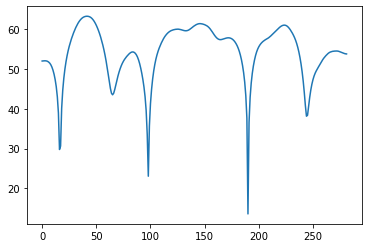

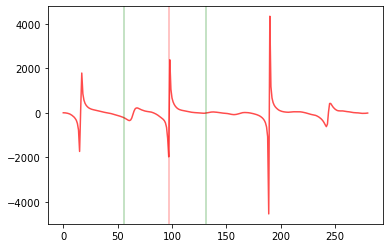

D =  0.5180851063829787 D_index =  97
max 0.43996010638297867 Cueve[D_index] 33.530045


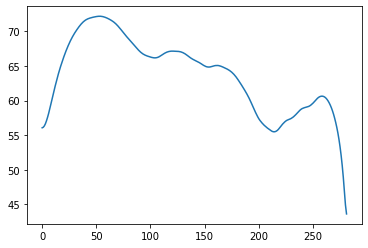

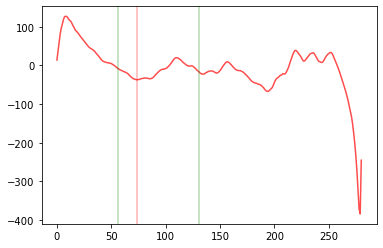

D =  0.39574468085106385 D_index =  74
max 0.31761968085106385 Cueve[D_index] 70.0256


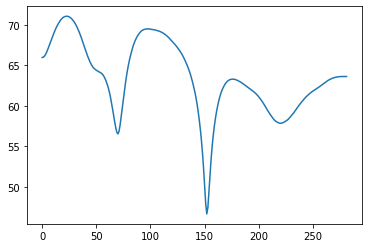

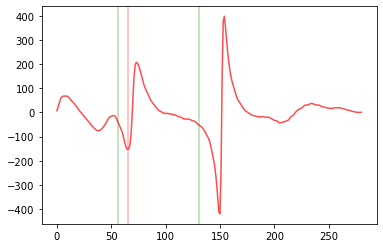

D =  0.3478723404255319 D_index =  65
max 0.3 Cueve[D_index] 59.595654
calc_overtone_index [30.86770632850775, 61.7354126570155, 92.60311898552325, 123.470825314031, 154.33853164253875, 185.2062379710465, 216.07394429955426, 246.941650628062, 277.8093569565698, 308.6770632850775, 339.54476961358523, 370.412475942093, 401.2801822706008, 432.1478885991085, 463.01559492761623, 493.883301256124, 524.7510075846318, 555.6187139131396, 586.4864202416472, 617.354126570155, 648.2218328986628, 679.0895392271705, 709.9572455556782, 740.824951884186, 771.6926582126938, 802.5603645412016, 833.4280708697092, 864.295777198217, 895.1634835267248, 926.0311898552325, 956.8988961837402, 987.766602512248, 1018.6343088407558, 1049.5020151692636, 1080.3697214977713, 1111.2374278262791, 1142.1051341547868, 1172.9728404832945, 1203.8405468118024, 1234.70825314031, 1265.5759594688177, 1296.4436657973256, 1327.3113721258333, 1358.179078454341, 1389.0467847828488, 1419.9144911113565, 1450.7821974398644, 1481.649

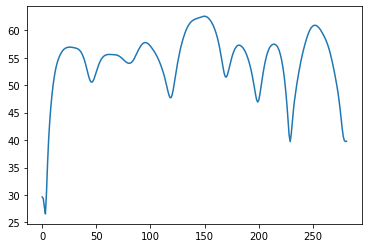

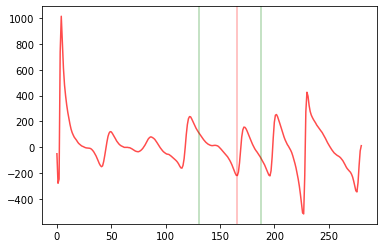

D =  0.8861702127659574 D_index =  166
max 0.8080452127659574 Cueve[D_index] 54.41881


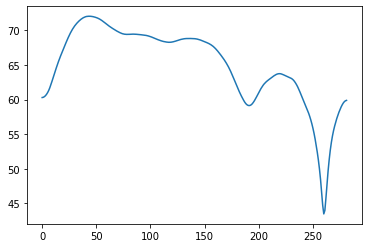

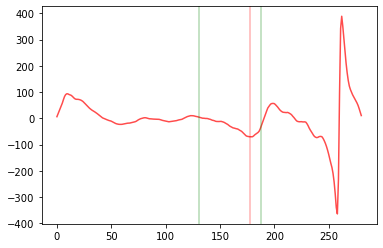

D =  0.95 D_index =  178
max 0.871875 Cueve[D_index] 62.630215


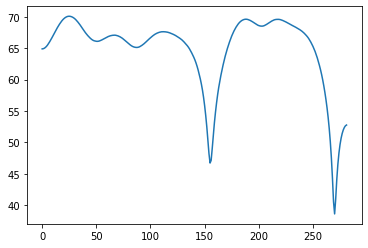

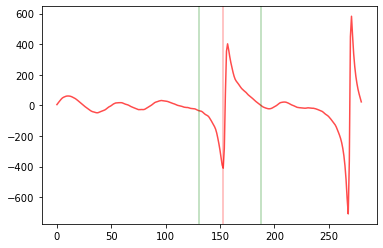

D =  0.8170212765957446 D_index =  153
max 0.7388962765957446 Cueve[D_index] 50.395615
calc_overtone_index [30.86770632850775, 61.7354126570155, 92.60311898552325, 123.470825314031, 154.33853164253875, 185.2062379710465, 216.07394429955426, 246.941650628062, 277.8093569565698, 308.6770632850775, 339.54476961358523, 370.412475942093, 401.2801822706008, 432.1478885991085, 463.01559492761623, 493.883301256124, 524.7510075846318, 555.6187139131396, 586.4864202416472, 617.354126570155, 648.2218328986628, 679.0895392271705, 709.9572455556782, 740.824951884186, 771.6926582126938, 802.5603645412016, 833.4280708697092, 864.295777198217, 895.1634835267248, 926.0311898552325, 956.8988961837402, 987.766602512248, 1018.6343088407558, 1049.5020151692636, 1080.3697214977713, 1111.2374278262791, 1142.1051341547868, 1172.9728404832945, 1203.8405468118024, 1234.70825314031, 1265.5759594688177, 1296.4436657973256, 1327.3113721258333, 1358.179078454341, 1389.0467847828488, 1419.9144911113565, 1450.7821974

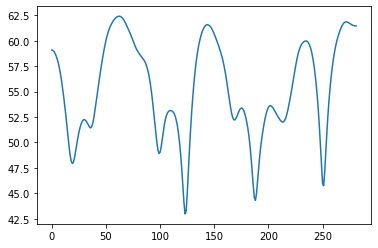

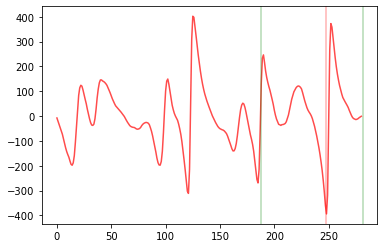

D =  1.3191489361702127 D_index =  248
max 1.2410239361702127 Cueve[D_index] 49.723152


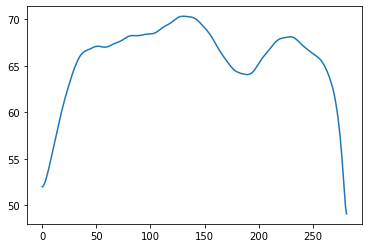

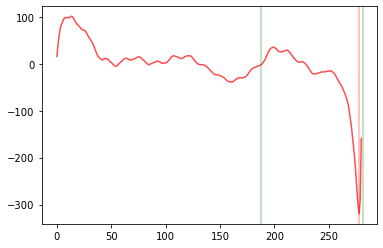

D =  1.478723404255319 D_index =  278
max 1.400598404255319 Cueve[D_index] 53.169086


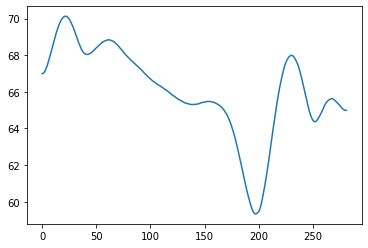

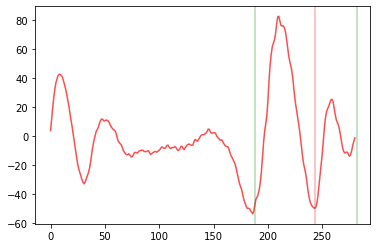

D =  1.2925531914893618 D_index =  243
max 1.2144281914893618 Cueve[D_index] 65.86081
calc_overtone_index [30.86770632850775, 61.7354126570155, 92.60311898552325, 123.470825314031, 154.33853164253875, 185.2062379710465, 216.07394429955426, 246.941650628062, 277.8093569565698, 308.6770632850775, 339.54476961358523, 370.412475942093, 401.2801822706008, 432.1478885991085, 463.01559492761623, 493.883301256124, 524.7510075846318, 555.6187139131396, 586.4864202416472, 617.354126570155, 648.2218328986628, 679.0895392271705, 709.9572455556782, 740.824951884186, 771.6926582126938, 802.5603645412016, 833.4280708697092, 864.295777198217, 895.1634835267248, 926.0311898552325, 956.8988961837402, 987.766602512248, 1018.6343088407558, 1049.5020151692636, 1080.3697214977713, 1111.2374278262791, 1142.1051341547868, 1172.9728404832945, 1203.8405468118024, 1234.70825314031, 1265.5759594688177, 1296.4436657973256, 1327.3113721258333, 1358.179078454341, 1389.0467847828488, 1419.9144911113565, 1450.78219743

KeyboardInterrupt: 

In [212]:
print(compute_delay('lab'))

# -------------------------------------------------------------- -->

In [24]:
pitch = 88
vel_level = 2
dur_level = 3
notetype = 'lab'
ref_value = 1e-3

##get_D_matrices##
path = '/Users/yutianqin/Downloads/SchoolWork/Piano/recordings/'
#     if notetype == 'audi':
#         path = '/Users/yutianqin/Downloads/SchoolWork/Piano/new_npz/'
#     else:
#         path = '/Users/yutianqin/Downloads/SchoolWork/Piano/new_npz_lab/'
dur = [0.1, 0.3, 0.7, 1]
vel = list(range(1,127,8))+[127]
sr = 48000
name = 'dictwave_' + notetype + '_pitch-' + str(pitch) + '_vel-' + str(vel[vel_level]) +\
'_dur-' + str(dur[dur_level]) + '_idx-' + str(dur_level + 4 * vel_level + 4 * len(vel) * (pitch - 21))

wave, sr = librosa.load(path + name + '.wav', sr = 48000)
# wave1 = np.load('/Users/yutianqin/Downloads/SchoolWork/Piano/new_npz_lab/' + name + '.npy')
#     y_resample = librosa.resample(wave, sr, 22050) # resample to rate = 22050

D = librosa.stft(wave, n_fft = 16384, hop_length = 256) # set n_fft = 16384, 
Ddb = librosa.amplitude_to_db(np.abs(D), ref = ref_value)
    
# print(wave[:200])
# print(wave1[:200])



[ 8.87215137e-04  7.98344612e-04  6.90937042e-04  1.00237131e-03
  5.70476055e-04  9.34362411e-04  7.66694546e-04  6.83963299e-04
  8.62061977e-04  5.67078590e-04  8.86738300e-04  6.01530075e-04
  8.19742680e-04  8.45611095e-04  5.64455986e-04  9.51647758e-04
  5.56170940e-04  8.16226006e-04  7.49647617e-04  5.61296940e-04
  8.07821751e-04  4.73737717e-04  7.87854195e-04  5.59091568e-04
  6.51061535e-04  8.53180885e-04  4.75108624e-04  8.97049904e-04
  5.96106052e-04  7.29322433e-04  8.04722309e-04  5.17487526e-04
  8.96036625e-04  5.40256500e-04  7.62403011e-04  7.12633133e-04
  5.78224659e-04  8.73982906e-04  4.61161137e-04  8.02993774e-04
  5.72562218e-04  4.85539436e-04  7.69495964e-04  4.10199165e-04
  7.48395920e-04  4.38034534e-04  5.54144382e-04  6.41703606e-04
  3.75330448e-04  7.88390636e-04  2.92479992e-04  4.61220741e-04
  4.85956669e-04  2.19702721e-04  5.33938408e-04  1.76370144e-04
  3.86834145e-04  2.51889229e-04  1.14202499e-04  4.15384769e-04
 -8.88109207e-06  3.27229